In [1]:
#Marioni lab data utilized, sample number 19- 6996 cells in E7.5 data 
import numpy as np
import time
import random
import os

import plotly.express as px
from sklearn.decomposition import PCA
import itertools
from sklearn.cluster import KMeans # Our clustering algorithm
from sklearn.decomposition import PCA # Needed for dimension reduction
from sklearn.datasets import load_wine # Dataset that I will be using
import matplotlib.pyplot as plt # Plotting 

from sklearn.preprocessing import normalize 
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

import matplotlib.pyplot as plt
from matplotlib import gridspec
#active SVC 
from activeSVC import min_complexity, min_acquisition
import pandas as pd
import pickle
import os, psutil
import resource
import urllib.request
import shutil

from umap import UMAP
import random

#Random forest classifier libraries
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics

#heatmap libraries
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
#activeSVC functions
#function to create .pickle files for ActiveSVC in results folder
def text_create(path, name, msg):
    full_path = path + "/" + name + '.pickle'
    f=open(full_path,'wb') 
    pickle.dump(msg,f)
    f.close()

#timer error during activeSVC
class TimerError(Exception):
     """A custom exception used to report errors in use of Timer class"""

#establishes timer for ActiveSVC
class Timer:
    def __init__(self):
        self._start_time = None

    def start(self):
        if self._start_time is not None:
            raise TimerError(f"Timer is running. Use .stop() to stop it")

        self._start_time = time.perf_counter()

    def stop(self):
        if self._start_time is None:
            raise TimerError(f"Timer is not running. Use .start() to start it")

        elapsed_time = time.perf_counter() - self._start_time
        self._start_time = None
        print(f"Total run time: {elapsed_time:0.4f} seconds")
        return elapsed_time

In [3]:
#import data
def data_reader(path):
    #read in data from csv file
    data_df = pd.read_csv(path)
    #fix data formatting for SVC probe search
    #remove any unwanted columns from data set
    data_df = data_df.drop(['Unnamed: 0'], axis = 1)
    #normalization function to normalize data_df
    data_df = data_df.apply(lambda iterator: ((iterator - iterator.mean())/iterator.std()).round(2))
    #for the cell analyzer to sort properly, we need to get rid of any header 
    new_header = data_df.iloc[0] #grab the first row for the header
    data_df = data_df[1:] #take the data less the header row
    data_df.columns = new_header #set the header row as the df header
    #final data set to be used 
    return data_df
#import genes
def gene_reader(gene_path, data_path):
    gene_df_og=pd.read_csv(gene_path)
    data_df_og=pd.read_csv(data_path)
    #format gene_df
    temp = pd.merge(gene_df_og,data_df_og, left_index = True, right_index = True)
    li= temp['SYMBOL'].tolist()
    gene_df = pd.DataFrame(li)
    new_header = gene_df.iloc[0] #grab the first row for the header
    gene_df = gene_df[1:] #take the data less the header row
    gene_df.columns = new_header #set the header row as the df header
    return gene_df
#import cell type data
def cell_reader(path):
    cell_type_df_og=pd.read_csv(path, header = None)
    #format cell_type_df
    cell_type_df = cell_type_df_og.drop([0], axis = 1)
    cell_type_df = cell_type_df.T
    cell_type_df.drop([0], axis = 1, inplace = True)
    return cell_type_df

In [4]:
#normalization functions
def mean_normalize(dataframe):
    df = (dataframe-dataframe.mean())/dataframe.std()
    return df
def min_max_normalize(dataframe):
    df = (dataframe-dataframe.min())/(dataframe.max()-dataframe.min())
    return df


In [5]:
#Data set functions, ie- removal of certain cell type, etc. 
def get_labels(buckets, label_df):
    label_df_buckets = []

    for label in label_df.iloc[0]:
        for j in buckets:
            if label in buckets[j]:
                label_df_buckets.append(j)
    return label_df_buckets

def removeNAN(data_df, labels):
    data_df.columns = labels
    data_df = data_df.drop(["nan"], axis =1)
    return data_df
def removeNAN_with_labels(data_df):
    data_df = data_df.drop(["nan"], axis =1)
    return data_df

In [6]:
#UMAP and PCA functionality
def two_dimensional_UMAP(data_df, colors, title):
    X = data_df.T
    X = X.fillna(0)
    umap_2d = UMAP(n_components=2, init='random', random_state=0)
    components = umap_2d.fit_transform(X)
    fig = px.scatter(components, x=0, y=1, color = colors, title = title )
    fig.update_xaxes(title = "UMAP 1")
    fig.update_yaxes(title = "UMAP 0")
    fig.show()
    
def two_and_three_dimensional_PCA(data_df, gene, colors, title):
    X = data_df.T[gene]
    
    pca = PCA(n_components = 2)
    components = pca.fit_transform(X)
    fig = px.scatter(components, x=0, y=1, color = colors)
    fig.show()

    pca = PCA(n_components =3)
    components = pca.fit_transform(X)
    fig = px.scatter_3d(components, x = 0, y = 1, z = 2, color = colors)
    fig.show()

In [77]:
#random forest classifier functions
def randomForestClassifier(genes):
    import random
    rand_nums = []
    if len(genes) > 150:
        for i in range(1,100,3):
            for j in range(200):
                rand_nums.append(i)
                
    else: 
        for i in range(1, len(genes), 3):
            for j in range(200):
                rand_nums.append(i)
    
    
    print("{} seconds to finish".format((len(rand_nums)*4)))
    print("{} minutes to finish".format((len(rand_nums)*4)/60)) 
    print("{} hours to finish".format((len(rand_nums)*4)/60/60))
    
    data_df_minusNAN_norm = data_df_minusNAN.apply(lambda iterator: ((iterator - iterator.mean())/iterator.std()).round(2))
    data_df_minusNAN_norm.index = RNA_genes
    
    
    genes_final = pd.DataFrame(genes)
    genes_final.set_index([0], inplace = True)
    
    combined = genes_final.join(data_df_minusNAN_norm)
    combined_norm = combined.apply(lambda iterator: ((iterator - iterator.mean())/iterator.std()).round(2))
    combined_norm_transposed = combined_norm.T 
    combined_norm_transposed = combined_norm_transposed.fillna(0)
    combined_norm_transposed['labels'] = labels_SVM
    combined_norm_transposed.index = cell_type_df_minusNAN
    #print(combined_norm_transposed)
    
    
    misclassification_nums = []
    misclassification_counters = {}
    misclassified_as_counters = {}
    counter = 0
    confusion_matrix_true = []
    confusion_matrix_test = []

    for i in rand_nums:
        t=Timer()
        t.start()
        print("\niteration number: {}".format(counter))
        print("{} genes used".format(i))
        counter = counter + 1
        X = combined_norm_transposed.sample(n=i, axis = 1)
        y = combined_norm_transposed['labels']



        X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.1)
        clf = RandomForestClassifier(n_estimators=100)
        clf.fit(X_train,y_train)
        y_pred = clf.predict(X_test)
        #print (X_test) #test dataset (without the actual outcome)
        #print (y_pred) #predicted values
        y_error = y_pred.tolist()
        x_error = []
        from sklearn import metrics 
        #print()

        # using metrics module for accuracy calculation
        print("ACCURACY OF THE MODEL: ", metrics.accuracy_score(y_test, y_pred))
        for i in X_test.T:
            x_error.append(i)

        #print(y_error)
        misclassification_names = []
        misclassified_as = []
        misclassification_buckets = []
        misclassification_buckets_final = []

        
        #print(x_error)
        for cell in x_error:
            if type(cell)== float:
                cell = 'nan'
            misclassification_names.append(numbers[cell])
            #print(misclassification_names)
        for cells in misclassification_names:
            for j in buckets:
                if cells in buckets[j]:
                    misclassification_buckets.append(j)
        for g in misclassification_buckets:
            if g == 'Ectoderm':
                misclassification_buckets_final.append(0)
            elif g == 'Endoderm':
                misclassification_buckets_final.append(1)
            elif g == 'Mesoderm':
                misclassification_buckets_final.append(2)
            elif g == 'Exe endoderm':
                misclassification_buckets_final.append(3)
            elif g == 'Exe mesoderm':
                misclassification_buckets_final.append(4)
            elif g == 'Exe ectoderm':
                misclassification_buckets_final.append(5)
            elif g == 'nan':
                misclassification_buckets_final.append(6)
            elif g == 'Epiblast, PS, others':
                misclassification_buckets_final.append(7)
        #print(misclassification_buckets_final)
        for i in misclassification_buckets_final:
            confusion_matrix_test.append(i)
        for j in y_error:
            confusion_matrix_true.append(j)
        misclassification = 0
        misclassification_names = {'Ectoderm':0, 'Endoderm':0, 'Mesoderm':0, 'Exe endoderm':0, 'Exe mesoderm':0, 
                                  'Exe ectoderm':0, 'nan':0, 'Epiblast, PS, others':0 }
        misclassified_as = {'Ectoderm':0, 'Endoderm':0, 'Mesoderm':0, 'Exe endoderm':0, 'Exe mesoderm':0, 
                                  'Exe ectoderm':0, 'nan':0, 'Epiblast, PS, others':0 }
        for i in range(0, len(misclassification_buckets_final)):
            if misclassification_buckets_final[i] != y_error[i]:
                misclassification += 1
                if misclassification_buckets_final[i] == 0:
                    misclassification_names['Ectoderm'] += 1
                if misclassification_buckets_final[i] == 1:
                    misclassification_names['Endoderm'] += 1
                if misclassification_buckets_final[i] == 2:
                    misclassification_names['Mesoderm'] += 1
                if misclassification_buckets_final[i] == 3:
                    misclassification_names['Exe endoderm'] += 1
                if misclassification_buckets_final[i] == 4:
                    misclassification_names['Exe mesoderm'] += 1
                if misclassification_buckets_final[i] == 5:
                    misclassification_names['Exe ectoderm'] += 1
                if misclassification_buckets_final[i] == 6:
                    misclassification_names['nan'] += 1
                if misclassification_buckets_final[i] == 7:
                    misclassification_names['Epiblast, PS, others'] += 1

                if y_error[i] == 0:
                    misclassified_as['Ectoderm'] += 1
                if y_error[i] == 1:
                    misclassified_as['Endoderm'] += 1
                if y_error[i] == 2:
                    misclassified_as['Mesoderm'] += 1
                if y_error[i] == 3:
                    misclassified_as['Exe endoderm'] += 1
                if y_error[i] == 4:
                    misclassified_as['Exe mesoderm'] += 1
                if y_error[i] == 5:
                    misclassified_as['Exe ectoderm'] += 1
                if y_error[i] == 6:
                    misclassified_as['nan'] += 1
                if y_error[i] == 7:
                    misclassified_as['Epiblast, PS, others'] += 1
        print("{} cells misclassified".format(misclassification))
        misclassification_counters[counter] = misclassification_names
        misclassified_as_counters[counter] = misclassified_as
        elapsed_time=t.stop()


        misclassification_nums.append(misclassification/len(y_error))
        print("cells misclassified:")
        print(misclassification_names)
        print("cells being misclassified as:")
        print(misclassified_as)
        

    return [misclassification_nums, misclassification_counters, misclassified_as_counters, confusion_matrix_true, confusion_matrix_test]
    


def heatmaps(confusion_matrix_true, confusion_matrix_test, chunk_size, vmin = None, vmax = None):
    #true
    #creates list of all sample tests
    chunked_list_true = list()
    #number of cells in each sample
    chunk_size_true = chunk_size
    #creates individual lists for all samples
    for i in range(0, len(confusion_matrix_true), chunk_size_true):
        chunked_list_true.append(confusion_matrix_true[i:i+chunk_size_true])

    print(len(chunked_list_true))

    #populates true_list with blank lists that will be used to average each # of genes datasets 
    true_list = []
    for i in range(len(chunked_list_true)):
        true_list.append([])

    counter_true = 0 

    for j in range(len(chunked_list_true)):

        true_list[j]=true_list[j]+(chunked_list_true[counter_true])
        counter_true = counter_true+1

    #test      
    chunked_list_test = list()
    chunk_size_test = chunk_size
    for i in range(0, len(confusion_matrix_test), chunk_size_test):
        chunked_list_test.append(confusion_matrix_test[i:i+chunk_size_test])

    test_list = []
    for i in range(len(chunked_list_test)):
        test_list.append([])
    counter_test = 0 

    for j in range(len(chunked_list_test)):
        test_list[j]=test_list[j]+(chunked_list_test[counter_test])
        counter_test = counter_test+1

    heatmaps = []
    for i in range(len(chunked_list_test)):        
        cf_matrix = confusion_matrix(true_list[i],test_list[i])
        cf_matrix_pd = pd.DataFrame(cf_matrix, columns = ['Ectoderm', 'Endoerm', 'Mesoderm', 'ExE endoderm', 'Exe mesoderm', 'Exe ectoderm', 'Epiblast, PS, others'])
        cf_matrix_pd_scaled = (cf_matrix_pd - cf_matrix_pd.mean()) / cf_matrix_pd.std()
        heatmaps.append(cf_matrix_pd_scaled)
        

    counter = 1

    for i in heatmaps:
        print(counter)
        print("genes used")
        labels = ['Ectoderm', 'Endoderm', 'Mesoderm', 'ExE endoderm', 'Exe mesoderm', 'Exe ectoderm', 'Epiblast, PS, others']
        ax = sns.heatmap(i, xticklabels=labels, 
                    yticklabels = labels, vmin = vmin, vmax = vmax )
        plt.show()
        counter = counter + 3
        
def scatter(genes, misclassification_nums):
    rand_nums = []
    if len(genes) > 150:
        for i in range(1,100,3):
            for j in range(200):
                rand_nums.append(i)

    else: 
        for i in range(1, len(genes), 3):
            for j in range(200):
                rand_nums.append(i)
                
    scatterlist = []
    scatterlist_final = []
    for i in range(0,len(misclassification_nums)):
        if misclassification_nums[i]>0.1:
            scatterlist.append([rand_nums[i],misclassification_nums[i]])
    for j in scatterlist:
        if j[1] > 0:
            scatterlist_final.append(j)
    x, y = zip(*scatterlist_final)
    plt.scatter(x, y)
    plt.ylim(ymin=0)
    plt.ylim(ymax=1)
    plt.xlim(xmin=0)
    plt.xlabel('Number of genes used for identification')
    plt.ylabel('Percent of cells misclassified')

    plt.show() 
    
def misclassifiedCells(misclassifcation_counter, genes):
    misclassification_counters_pd = pd.DataFrame(misclassifcation_counter)
    final_dict = {}
    for i in range(0,16):
        a = misclassification_counters_pd.T.iloc[i::16, :]
        a = a.replace(0, np.NaN)
        #print(a)
        df2 = a.mean()
        #print(df2)
        df2_dict = df2.to_dict()
        #print(df2_dict)
        final_dict[i] = df2_dict
    final_dict_pd = pd.DataFrame(final_dict)
    #print(final_dict_pd)
    fig = px.bar(final_dict_pd.T,title="number of misclassified cells per gene count")
    fig.update_xaxes(title = "gene count")
    fig.update_yaxes(title = "number of misclassified cell")
    fig.show()

In [8]:
#load in all data for future usage 
data_df = data_reader('./data.csv')
print(data_df)

0      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13  \
1      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
2      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
3      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
4      -0.13  -0.14   2.23  -0.12   2.06   3.73  -0.14   0.79  -0.13  -0.13   
5      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
...      ...    ...    ...    ...    ...    ...    ...    ...    ...    ...   
13994  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
13995  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
13996  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
13997  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
13998  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   

0      ...  -0.13  -0.12  -0.12  -0.13  -0.12  -0.1

In [9]:
gene_df = gene_reader('./genes.csv', './data.csv')
print(gene_df)

0         Xkr4
1       Gm1992
2      Gm37381
3          Rp1
4        Sox17
5      Gm37323
...        ...
13994      Nps
13995  Gm45339
13996    Foxi2
13997  Gm45340
13998    Clrn3

[13998 rows x 1 columns]


In [10]:
cell_type_df = cell_reader('./cellType.csv')
print(cell_type_df)

           1           2             3                     4             5     \
1  ExE ectoderm  Mesenchyme  ExE endoderm  Rostral neurectoderm  ExE endoderm   

                6           7             8             9     \
1  Visceral endoderm  Mesenchyme  ExE endoderm  ExE endoderm   

                             10    ... 6987              6988  \
1  Haematoendothelial progenitors  ...  NaN  Primitive Streak   

               6989          6990      6991          6992               6993  \
1  Primitive Streak  ExE endoderm  Epiblast  ExE endoderm  Parietal endoderm   

  6994          6995          6996  
1  NaN  ExE endoderm  ExE ectoderm  

[1 rows x 6996 columns]


In [11]:
#create index of cell types you want to use
names = []
for i in cell_type_df.loc[1]:
    names.append(i)
se = set()
for i in names:
    if type(i) == float:
        se.add('nan')
    else:
        se.add(i)
se = list(se)
#creates dictionary of the cell types in use and their respective numbers
numbers = {}
for i in range(1,len(se)+1):
    numbers[se[i-1]]=i
print(numbers)
#create the label for the active svc 
label_df = []
for i in names:
    if type(i) == float:
        label_df.append(numbers['nan'])
    elif type(i) == str:
        for j in numbers:
            if j == i:
                label_df.append(numbers[j])

label_df = pd.DataFrame(label_df).T
print(label_df)

{'Mixed mesoderm': 1, 'nan': 2, 'Epiblast': 3, 'Blood progenitors 2': 4, 'PGC': 5, 'Paraxial mesoderm': 6, 'Pharyngeal mesoderm': 7, 'ExE mesoderm': 8, 'ExE endoderm': 9, 'Gut': 10, 'Rostral neurectoderm': 11, 'Def. endoderm': 12, 'Caudal neurectoderm': 13, 'Endothelium': 14, 'ExE ectoderm': 15, 'Haematoendothelial progenitors': 16, 'Primitive Streak': 17, 'Visceral endoderm': 18, 'Caudal Mesoderm': 19, 'Mesenchyme': 20, 'Notochord': 21, 'Surface ectoderm': 22, 'Anterior Primitive Streak': 23, 'Somitic mesoderm': 24, 'Caudal epiblast': 25, 'Erythroid1': 26, 'Intermediate mesoderm': 27, 'Blood progenitors 1': 28, 'Nascent mesoderm': 29, 'Allantois': 30, 'Parietal endoderm': 31}
   0     1     2     3     4     5     6     7     8     9     ...  6986  \
0    15    20     9    11     9    18    20     9     9    16  ...     2   

   6987  6988  6989  6990  6991  6992  6993  6994  6995  
0    17    17     9     3     9    31     2     9    15  

[1 rows x 6996 columns]


In [12]:
#create buckets here based on numbers from above:
#buckets created with Reza and David
buckets = {'Ectoderm':[numbers['Caudal epiblast'], numbers['Caudal neurectoderm'], numbers['Surface ectoderm'],
                      numbers['Rostral neurectoderm']], 
           
           'Endoderm':[numbers['Visceral endoderm'], numbers['Def. endoderm'], numbers['Gut']], 
           
           'Mesoderm':[numbers['Intermediate mesoderm'], numbers['Endothelium'], numbers['Blood progenitors 1'],
                       numbers['Somitic mesoderm'], numbers['Erythroid1'], numbers['Allantois'], numbers['Mesenchyme'],
                       numbers['Caudal Mesoderm'], numbers['Mixed mesoderm'], numbers['Haematoendothelial progenitors'],
                       numbers['Notochord'], numbers['Anterior Primitive Streak'], numbers['Pharyngeal mesoderm'],
                       numbers['Paraxial mesoderm'], numbers['Nascent mesoderm'],
                       numbers['Blood progenitors 2']
                      ],
           
           'Exe endoderm':[numbers['ExE endoderm']],
           
           'Exe mesoderm':[numbers['ExE mesoderm']],
           
           'Exe ectoderm':[numbers['ExE ectoderm']],
           
           'nan': [numbers['nan']],
           
           'Epiblast, PS, others':[numbers['Primitive Streak'], numbers['Epiblast'], numbers['PGC']
                                  ,numbers['Parietal endoderm']]
          }
print(buckets)

{'Ectoderm': [25, 13, 22, 11], 'Endoderm': [18, 12, 10], 'Mesoderm': [27, 14, 28, 24, 26, 30, 20, 19, 1, 16, 21, 23, 7, 6, 29, 4], 'Exe endoderm': [9], 'Exe mesoderm': [8], 'Exe ectoderm': [15], 'nan': [2], 'Epiblast, PS, others': [17, 3, 5, 31]}


In [13]:
#Get names of all cell types based on bucket- take in all the cell types and essentially group them by bucket 
label_df_buckets = get_labels(buckets, label_df)
print(label_df_buckets)

['Exe ectoderm', 'Mesoderm', 'Exe endoderm', 'Ectoderm', 'Exe endoderm', 'Endoderm', 'Mesoderm', 'Exe endoderm', 'Exe endoderm', 'Mesoderm', 'Endoderm', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Exe endoderm', 'Mesoderm', 'Exe endoderm', 'Epiblast, PS, others', 'Mesoderm', 'Mesoderm', 'Mesoderm', 'Exe endoderm', 'nan', 'Mesoderm', 'Exe endoderm', 'Ectoderm', 'Ectoderm', 'Epiblast, PS, others', 'Endoderm', 'Mesoderm', 'Mesoderm', 'Mesoderm', 'Exe endoderm', 'Exe ectoderm', 'Ectoderm', 'nan', 'Exe endoderm', 'Mesoderm', 'Exe ectoderm', 'Ectoderm', 'Exe endoderm', 'Mesoderm', 'Mesoderm', 'Exe ectoderm', 'Endoderm', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Mesoderm', 'Ectoderm', 'Exe endoderm', 'Exe ectoderm', 'Ectoderm', 'Mesoderm', 'Epiblast, PS, others', 'Ectoderm', 'Exe endoderm', 'Endoderm', 'Epiblast, PS, others', 'nan', 'Mesoderm', 'Mesoderm', 'Exe ectoderm', 'Exe endoderm', 'nan', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Exe ectoderm', 'Ectoderm', 'Mesoderm', 'Exe ectoderm', 'Exe ectoderm', 'Ec

In [14]:
two_dimensional_UMAP(data_df, label_df_buckets, "UMAP of Cells with all RNAseq Data")

In [15]:
data_df_minusNAN = removeNAN(data_df, label_df_buckets)

In [16]:
#for the cell analyzer to sort properly, we need to get rid of any header 
labels_minus_nan = data_df.columns
new_header = data_df.iloc[0] #grab the first row for the header
data_df = data_df[1:] #take the data less the header row
data_df.columns = new_header #set the header row as the df header
print(data_df)
print(labels_minus_nan)

1      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13  \
2      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
3      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
4      -0.13  -0.14   2.23  -0.12   2.06   3.73  -0.14   0.79  -0.13  -0.13   
5      -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
6       1.95   1.53   0.26   0.82   4.99   1.24   1.66   2.64   2.05   0.98   
...      ...    ...    ...    ...    ...    ...    ...    ...    ...    ...   
13994  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
13995  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
13996  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
13997  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   
13998  -0.13  -0.14  -0.13  -0.12  -0.13  -0.14  -0.14  -0.14  -0.13  -0.13   

1      ...  -0.13  -0.12  -0.12  -0.13  -0.12  -0.1

In [17]:
print(data_df_minusNAN)

       Exe ectoderm  Mesoderm  Exe endoderm  Ectoderm  Exe endoderm  Endoderm  \
1             -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
2             -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
3             -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
4             -0.13     -0.14          2.23     -0.12          2.06      3.73   
5             -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
...             ...       ...           ...       ...           ...       ...   
13994         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
13995         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
13996         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
13997         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
13998         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   

       Mesoderm  Exe endode

In [18]:
labels_minus_nan = labels_minus_nan.values 

In [19]:
labels_final = []
for i in labels_minus_nan:
    labels_final.append(i)
print(labels_final)
print(len(labels_final))

['Exe ectoderm', 'Mesoderm', 'Exe endoderm', 'Ectoderm', 'Exe endoderm', 'Endoderm', 'Mesoderm', 'Exe endoderm', 'Exe endoderm', 'Mesoderm', 'Endoderm', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Exe endoderm', 'Mesoderm', 'Exe endoderm', 'Epiblast, PS, others', 'Mesoderm', 'Mesoderm', 'Mesoderm', 'Exe endoderm', 'nan', 'Mesoderm', 'Exe endoderm', 'Ectoderm', 'Ectoderm', 'Epiblast, PS, others', 'Endoderm', 'Mesoderm', 'Mesoderm', 'Mesoderm', 'Exe endoderm', 'Exe ectoderm', 'Ectoderm', 'nan', 'Exe endoderm', 'Mesoderm', 'Exe ectoderm', 'Ectoderm', 'Exe endoderm', 'Mesoderm', 'Mesoderm', 'Exe ectoderm', 'Endoderm', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Mesoderm', 'Ectoderm', 'Exe endoderm', 'Exe ectoderm', 'Ectoderm', 'Mesoderm', 'Epiblast, PS, others', 'Ectoderm', 'Exe endoderm', 'Endoderm', 'Epiblast, PS, others', 'nan', 'Mesoderm', 'Mesoderm', 'Exe ectoderm', 'Exe endoderm', 'nan', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Exe ectoderm', 'Ectoderm', 'Mesoderm', 'Exe ectoderm', 'Exe ectoderm', 'Ec

In [20]:
two_dimensional_UMAP(data_df, labels_final, "UMAP of Cells with all RNAseq Data without NaN")

In [21]:
print(buckets)

{'Ectoderm': [25, 13, 22, 11], 'Endoderm': [18, 12, 10], 'Mesoderm': [27, 14, 28, 24, 26, 30, 20, 19, 1, 16, 21, 23, 7, 6, 29, 4], 'Exe endoderm': [9], 'Exe mesoderm': [8], 'Exe ectoderm': [15], 'nan': [2], 'Epiblast, PS, others': [17, 3, 5, 31]}


In [22]:
buckets_SVM = {}
counter = 0 
for i in buckets:
    print(i)
    buckets_SVM[i] = counter
    counter +=1
    

Ectoderm
Endoderm
Mesoderm
Exe endoderm
Exe mesoderm
Exe ectoderm
nan
Epiblast, PS, others


In [23]:
print(buckets_SVM)

{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 3, 'Exe mesoderm': 4, 'Exe ectoderm': 5, 'nan': 6, 'Epiblast, PS, others': 7}


In [24]:
print(labels_final)

['Exe ectoderm', 'Mesoderm', 'Exe endoderm', 'Ectoderm', 'Exe endoderm', 'Endoderm', 'Mesoderm', 'Exe endoderm', 'Exe endoderm', 'Mesoderm', 'Endoderm', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Exe endoderm', 'Mesoderm', 'Exe endoderm', 'Epiblast, PS, others', 'Mesoderm', 'Mesoderm', 'Mesoderm', 'Exe endoderm', 'nan', 'Mesoderm', 'Exe endoderm', 'Ectoderm', 'Ectoderm', 'Epiblast, PS, others', 'Endoderm', 'Mesoderm', 'Mesoderm', 'Mesoderm', 'Exe endoderm', 'Exe ectoderm', 'Ectoderm', 'nan', 'Exe endoderm', 'Mesoderm', 'Exe ectoderm', 'Ectoderm', 'Exe endoderm', 'Mesoderm', 'Mesoderm', 'Exe ectoderm', 'Endoderm', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Mesoderm', 'Ectoderm', 'Exe endoderm', 'Exe ectoderm', 'Ectoderm', 'Mesoderm', 'Epiblast, PS, others', 'Ectoderm', 'Exe endoderm', 'Endoderm', 'Epiblast, PS, others', 'nan', 'Mesoderm', 'Mesoderm', 'Exe ectoderm', 'Exe endoderm', 'nan', 'Mesoderm', 'Ectoderm', 'Mesoderm', 'Exe ectoderm', 'Ectoderm', 'Mesoderm', 'Exe ectoderm', 'Exe ectoderm', 'Ec

In [25]:
labels_SVM = []
for i in labels_final:
    if i != 'nan':
        labels_SVM.append(buckets_SVM[i])
    
#print(labels_SVM)
labels_SVM_final = pd.DataFrame(labels_SVM).T
print(labels_SVM_final)

   0     1     2     3     4     5     6     7     8     9     ...  5910  \
0     5     2     3     0     3     1     2     3     3     2  ...     0   

   5911  5912  5913  5914  5915  5916  5917  5918  5919  
0     0     7     7     3     7     3     7     3     5  

[1 rows x 5920 columns]


In [26]:
print(len(labels_minus_nan))

6996


In [27]:
import urllib.request
import shutil

data_df = data_df_minusNAN
label_df=labels_SVM_final
gene_df=gene_df
classes=[0,1,2,3,4,5,6,7]
keys=['Ectoderm',
    'Mesoderm',
    'Endoderm',
    'Exe endoderm',
    'Exe mesoderm',
    'Exe ectoderm',
    'nan',
    'Epiblast, PS, others']

raw_data=data_df.values
target=label_df.values.reshape((raw_data.shape[1],)).astype(np.uint8)
gene=gene_df.values.reshape((raw_data.shape[0],))
data=normalize(np.transpose(raw_data),axis=1, norm='l2')



idx = np.arange(np.shape(data)[0])
random.shuffle(idx)
X_train = data[idx[:int(np.shape(data)[0]*4/5)],:]
y_train = target[idx[:int(np.shape(data)[0]*4/5)]]
X_test = data[idx[int(np.shape(data)[0]*4/5):],:]
y_test = target[idx[int(np.shape(data)[0]*4/5):]]

        

print(type(data))
print(np.shape(data),np.shape(target),len(np.unique(target)))
print(np.shape(X_train))
print(np.shape(X_test))
print(np.unique(target))
for i in np.unique(target):
    print('class '+keys[i]+': '+str(np.count_nonzero((target==i)*1)))

<class 'numpy.ndarray'>
(5920, 13998) (5920,) 7
(4736, 13998)
(1184, 13998)
[0 1 2 3 4 5 7]
class Ectoderm: 978
class Mesoderm: 307
class Endoderm: 1882
class Exe endoderm: 919
class Exe mesoderm: 77
class Exe ectoderm: 936
class Epiblast, PS, others: 821


In [28]:
'''
Parameters
'''
num_features = 100
num_samples=50
init_samples=1000
#balance=True

folder='results/min_complexity'
path=folder+'/test_'+str(num_features)+'_'+str(num_samples)

try:
    os.mkdir('results')
except OSError:
    print ("Creation of the directory %s failed" % 'results')
else:
    print ("Successfully created the directory %s " % 'results')
try:
    os.mkdir(folder)
except OSError:
    print ("Creation of the directory %s failed" % folder)
else:
    print ("Successfully created the directory %s " % folder)
try:
    os.mkdir(path)
except OSError:
    print ("Creation of the directory %s failed" % path)
else:
    print ("Successfully created the directory %s " % path)

Creation of the directory results failed
Creation of the directory results/min_complexity failed
Creation of the directory results/min_complexity/test_100_50 failed


Elapsed time: 27.2020 seconds
feature 0 : gene [674]  1000 samples
training error=4.85472972972973 test error=4.918918918918919
training accuracy=0.4987331081081081 test accuracy=0.49493243243243246
Elapsed time: 4.4571 seconds
feature 1 : gene 12725  1043 samples
training error=4.524070945945946 test error=4.52195945945946
training accuracy=0.5939611486486487 test accuracy=0.5954391891891891
Elapsed time: 4.4080 seconds
feature 2 : gene 12027  1085 samples
training error=4.330236486486487 test error=4.44679054054054
training accuracy=0.6169763513513513 test accuracy=0.6131756756756757
Elapsed time: 4.2958 seconds
feature 3 : gene 4932  1125 samples
training error=4.3688766891891895 test error=4.476351351351352
training accuracy=0.6176097972972973 test accuracy=0.612331081081081
Elapsed time: 4.2168 seconds
feature 4 : gene 10759  1161 samples
training error=5.804898648648648 test error=5.766047297297297
training accuracy=0.667018581081081 test accuracy=0.6765202702702703
Elapsed time:

Elapsed time: 8.5611 seconds
feature 42 : gene 224  1867 samples
training error=3.4972550675675675 test error=3.7474662162162162
training accuracy=0.8519847972972973 test accuracy=0.8353040540540541
Elapsed time: 8.3973 seconds
feature 43 : gene 12698  1872 samples
training error=3.512035472972973 test error=3.7246621621621623
training accuracy=0.8530405405405406 test accuracy=0.8353040540540541
Elapsed time: 8.6246 seconds
feature 44 : gene 5059  1883 samples
training error=3.5232263513513513 test error=3.76097972972973
training accuracy=0.8532516891891891 test accuracy=0.8369932432432432
Elapsed time: 8.6139 seconds
feature 45 : gene 340  1888 samples
training error=3.472550675675676 test error=3.7440878378378377
training accuracy=0.8543074324324325 test accuracy=0.8378378378378378
Elapsed time: 9.4190 seconds
feature 46 : gene 10923  1895 samples
training error=3.465160472972973 test error=3.9239864864864864
training accuracy=0.8553631756756757 test accuracy=0.8344594594594594
Elaps

Elapsed time: 13.3717 seconds
feature 84 : gene 10700  1959 samples
training error=3.09691722972973 test error=3.3302364864864864
training accuracy=0.886402027027027 test accuracy=0.8682432432432432
Elapsed time: 13.4967 seconds
feature 85 : gene 7852  1959 samples
training error=3.0918496621621623 test error=3.3091216216216215
training accuracy=0.885768581081081 test accuracy=0.8690878378378378
Elapsed time: 13.6514 seconds
feature 86 : gene 7550  1961 samples
training error=2.9769847972972974 test error=3.2736486486486487
training accuracy=0.8885135135135135 test accuracy=0.8690878378378378
Elapsed time: 13.3448 seconds
feature 87 : gene 13677  1962 samples
training error=2.9683277027027026 test error=3.2525337837837838
training accuracy=0.8883023648648649 test accuracy=0.8699324324324325
Elapsed time: 13.5184 seconds
feature 88 : gene 5193  1962 samples
training error=2.9370777027027026 test error=3.2255067567567566
training accuracy=0.8897804054054054 test accuracy=0.87162162162162

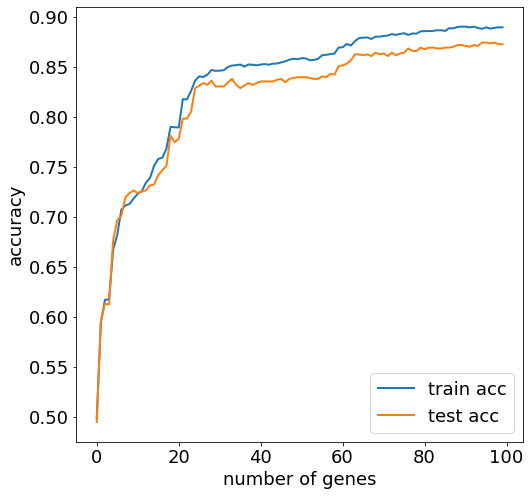

In [29]:
t=Timer()
t.start()
feature_selected, num_samples_list, train_errors,test_errors,train_scores,test_scores, step_times= min_complexity(
    X_train,y_train,X_test,y_test,num_features=num_features,num_samples=num_samples,init_samples=init_samples)
elapsed_time=t.stop()

memorys=[]
memorys.append(psutil.Process(os.getpid()).memory_info().rss / 1024 ** 2)
memorys.append(resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/ 1024 ** 2)

text_create(path,'feature_selected',feature_selected)
text_create(path,'error',train_errors+test_errors)
text_create(path,'accuracy',train_scores+test_scores)
text_create(path,'num_samples_list',num_samples_list)
text_create(path,'genes_name',gene[feature_selected])
text_create(path,'elapsed_time',elapsed_time)
text_create(path,'memory',memorys)

plt.figure(figsize=(8,8))
plt.plot(train_scores,linewidth=2)
plt.plot(test_scores,linewidth=2)
plt.legend(['train acc','test acc'],prop = {'size':18})
plt.xlabel('number of genes',fontdict={'weight':'normal','size': 18})
plt.ylabel('accuracy',fontdict={'weight':'normal','size': 18})
plt.tick_params(labelsize=18)
plt.savefig(path+'/acc.pdf', bbox_inches="tight")

Elapsed time: 29.7205 seconds
feature 0 : gene [12027]  1000 samples
training error=5.680532094594595 test error=5.7863175675675675
training accuracy=0.47423986486486486 test accuracy=0.46621621621621623
Elapsed time: 30.0352 seconds
feature 1 : gene 4926  1000 samples
training error=6.367398648648648 test error=6.141047297297297
training accuracy=0.5124577702702703 test accuracy=0.504222972972973
Elapsed time: 31.2675 seconds
feature 2 : gene 4359  1000 samples
training error=4.949324324324325 test error=4.715371621621622
training accuracy=0.6585726351351351 test accuracy=0.6537162162162162
Elapsed time: 31.6934 seconds
feature 3 : gene 10759  1000 samples
training error=5.6796875 test error=5.507601351351352
training accuracy=0.6822212837837838 test accuracy=0.6875
Elapsed time: 31.7592 seconds
feature 4 : gene 674  1000 samples
training error=5.801731418918919 test error=5.938344594594595
training accuracy=0.7115709459459459 test accuracy=0.7103040540540541
Elapsed time: 33.2605 sec

Elapsed time: 96.1549 seconds
feature 42 : gene 9444  1000 samples
training error=3.3367820945945947 test error=3.3530405405405403
training accuracy=0.8809121621621622 test accuracy=0.870777027027027
Elapsed time: 98.5766 seconds
feature 43 : gene 7753  1000 samples
training error=3.337204391891892 test error=3.3496621621621623
training accuracy=0.8809121621621622 test accuracy=0.8716216216216216
Elapsed time: 99.0525 seconds
feature 44 : gene 11353  1000 samples
training error=3.311233108108108 test error=3.4070945945945947
training accuracy=0.8815456081081081 test accuracy=0.8724662162162162
Elapsed time: 101.0804 seconds
feature 45 : gene 5878  1000 samples
training error=3.3448057432432434 test error=3.389358108108108
training accuracy=0.8815456081081081 test accuracy=0.8724662162162162
Elapsed time: 108.7010 seconds
feature 46 : gene 13676  1000 samples
training error=3.3914695945945947 test error=3.470439189189189
training accuracy=0.8802787162162162 test accuracy=0.8699324324324

feature 83 : gene 4010  1000 samples
training error=2.60620777027027 test error=2.8885135135135136
training accuracy=0.8997043918918919 test accuracy=0.8842905405405406
Elapsed time: 182.1503 seconds
feature 84 : gene 7727  1000 samples
training error=2.60620777027027 test error=2.902027027027027
training accuracy=0.8997043918918919 test accuracy=0.8859797297297297
Elapsed time: 184.7266 seconds
feature 85 : gene 11330  1000 samples
training error=2.5962837837837838 test error=2.923141891891892
training accuracy=0.9001266891891891 test accuracy=0.8851351351351351
Elapsed time: 186.3501 seconds
feature 86 : gene 5112  1000 samples
training error=2.5356841216216215 test error=3.0236486486486487
training accuracy=0.9011824324324325 test accuracy=0.8834459459459459
Elapsed time: 183.6093 seconds
feature 87 : gene 4432  1000 samples
training error=2.554054054054054 test error=3.0675675675675675
training accuracy=0.9011824324324325 test accuracy=0.8826013513513513
Elapsed time: 187.8412 seco

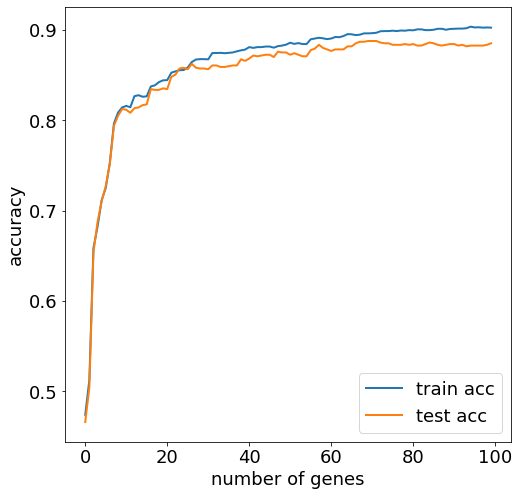

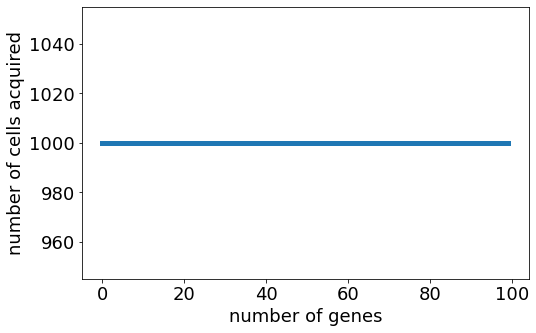

In [30]:

t=Timer()
t.start()
feature_selected, num_samples_list, samples_global, train_errors,test_errors,train_scores,test_scores,step_times= min_acquisition(
    X_train,y_train,X_test,y_test,num_features=num_features,num_samples=num_samples, init_samples=init_samples)
elapsed_time=t.stop()

memorys=[]
memorys.append(psutil.Process(os.getpid()).memory_info().rss / 1024 ** 2)
memorys.append(resource.getrusage(resource.RUSAGE_SELF).ru_maxrss/ 1024 ** 2)

text_create(path,'feature_selected',feature_selected)
text_create(path,'error',train_errors+test_errors)
text_create(path,'accuracy',train_scores+test_scores)
text_create(path,'num_samples_list',num_samples_list)
text_create(path,'samples_global',samples_global)
text_create(path,'genes_name',gene[feature_selected])
text_create(path,'elapsed_time',elapsed_time)
text_create(path,'memory',memorys)

plt.figure(figsize=(8,8))
plt.plot(train_scores,linewidth=2)
plt.plot(test_scores,linewidth=2)
plt.legend(['train acc','test acc'],prop = {'size':18})
plt.xlabel('number of genes',fontdict={'weight':'normal','size': 18})
plt.ylabel('accuracy',fontdict={'weight':'normal','size': 18})
plt.tick_params(labelsize=18)
plt.savefig(path+'/acc.pdf', bbox_inches="tight")

plt.figure(figsize=(8,5))
plt.plot(num_samples_list,linewidth=5)
plt.xlabel('number of genes',fontdict={'weight':'normal','size': 18})
plt.ylabel('number of cells acquired',fontdict={'weight':'normal','size': 18})
plt.tick_params(labelsize=18)
plt.savefig(path+'/cells.pdf', bbox_inches="tight")

/opt/miniconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/opt/miniconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



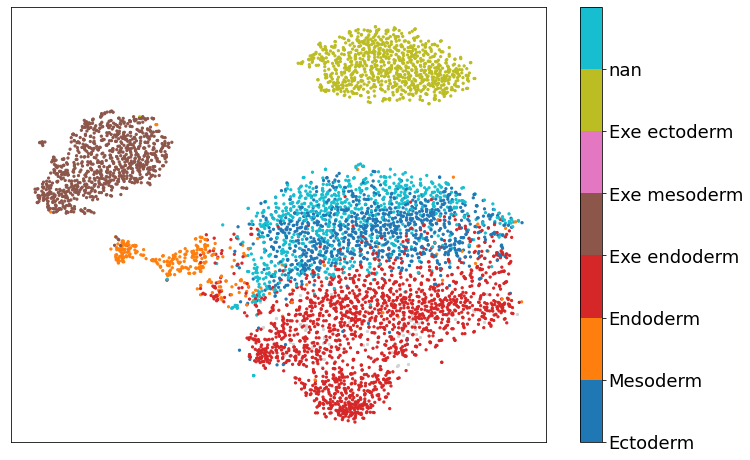

In [31]:
plt.figure(figsize=(12,8))
pca=PCA(n_components=74,
       copy=True,
       whiten=False,
       svd_solver='auto',
       tol=0.0,
       iterated_power='auto',
       random_state=None)

pcaproj=pca.fit_transform(data)

Y=TSNE(n_components=2).fit_transform(pcaproj)

others=list(np.where(target==4)[0])
cells=list(np.where(target!=4)[0])

c_cmap = plt.get_cmap('tab10', len(classes)-1)
plt.scatter(Y[others,0], Y[others,1], c='lightgray', s=5)
plt.scatter(Y[cells,0],Y[cells,1],c=target[cells],s=5,cmap=c_cmap)
cbar=plt.colorbar(ticks=np.arange(len(classes)-1))
plt.xticks([])
plt.yticks([])
cbar.ax.set_yticklabels(keys[:-1],fontdict={'weight':'normal','size': 18})
plt.savefig(path+'/tsne.pdf',bbox_inches="tight")

f=open(path+'/tsne.pickle','wb') 
pickle.dump(Y,f)
f.close()

/opt/miniconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/opt/miniconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



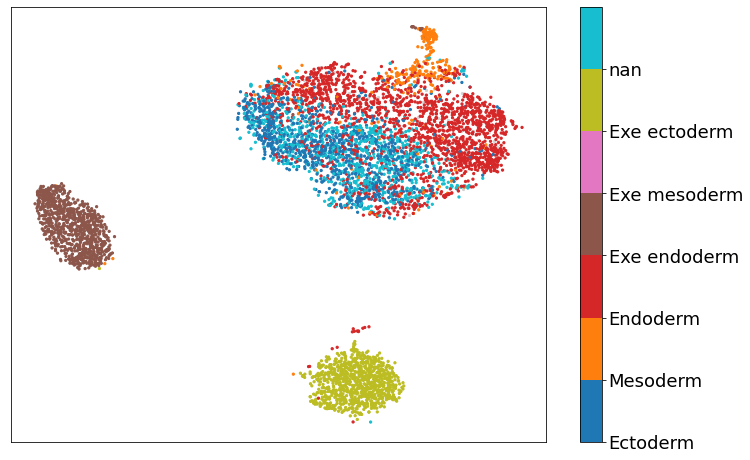

In [32]:
plt.figure(figsize=(12,8))
data_selected=data[:,feature_selected]

pca=PCA(n_components=7,
       copy=True,
       whiten=False,
       svd_solver='auto',
       tol=0.0,
       iterated_power='auto',
       random_state=None)
pcaproj=pca.fit_transform(data_selected)

Y_selected=TSNE(n_components=2,perplexity=200,early_exaggeration=1).fit_transform(pcaproj)

others=list(np.where(target==4)[0])
cells=list(np.where(target!=4)[0])

c_cmap = plt.get_cmap('tab10', len(classes)-1)
plt.scatter(Y_selected[others,0], Y_selected[others,1], c='lightgray', s=5)
plt.scatter(Y_selected[cells,0],Y_selected[cells,1],c=target[cells],s=5,cmap=c_cmap)
cbar=plt.colorbar(ticks=np.arange(len(classes)-1))
plt.xticks([])
plt.yticks([])
cbar.ax.set_yticklabels(keys[:-1],fontdict={'weight':'normal','size': 18})
plt.savefig(path+'/tsne_selected_wPCA.pdf',bbox_inches="tight")

f=open(path+'/tsne_selected_wPCA.pickle','wb') 
pickle.dump(Y_selected,f)
f.close()

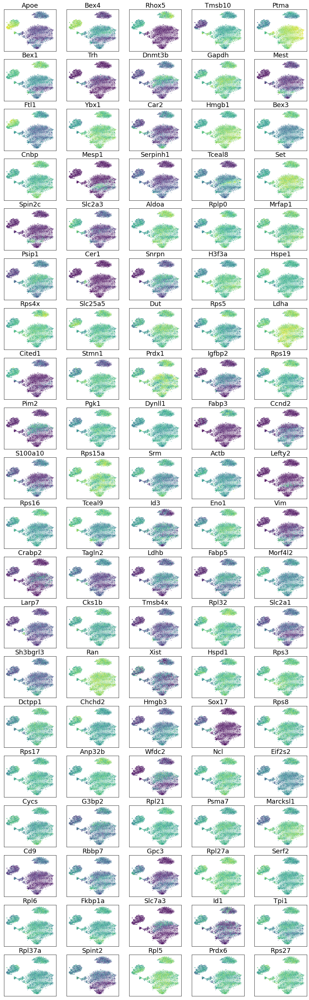

In [33]:
alpha = 100
data_show = np.log1p(data*alpha)

size=len(feature_selected)
plt.figure(figsize=(15,2.5*int(size/5)))
gs = gridspec.GridSpec(int(size/5), 5, width_ratios=[7,7,7,7,7])

genes = []
for i in range(size):
    f=feature_selected[i]
    ax0 = plt.subplot(gs[i])
    ax0.set_title(gene[f],fontdict={'weight':'normal','size': 18})
    genes.append(gene[f])
    plt.scatter(Y[:,0],Y[:,1],c=data_show[:,f],s=0.05)
    ax0.set_xticks([])
    ax0.set_yticks([])
plt.savefig(path+'/gene.png',dpi=300,  bbox_inches="tight") 

In [34]:
david_genes = ['Slc2a1', 'Avp', 'Negr1', 'Klf3', 'Slc25a4', 'Sox6', 'Ezr', 'Psme1', 'Lgals1', 'Hoxd9', 'Cldn6', 'Krt18', 'Apom', 'Cldn7', 'Myl7', 'Mxi1', 'Actb', 'Pim2', 'Hoxa10', 'Igfbp2', 'Krt8', 'Klf1', 'Mif', 'Cdx2', 'Spink2', 'Mt2', 'Epcam', 'Pou5f1', 'Foxa2', 'Tuba1a', 'Gata1', 'Inka1', 'Apoe', 'Psme2', 'Nfix', 'Sox17', 'Mesp1', 'Ifitm2', 'Id2', 'Ifitm3', 'Ifitm1', 'Mt1', 'Dnmt3b', 'Slc25a37', 'Lefty2', 'Wfdc2', 'Fcer1a', 'Cer1', 'Foxf1']
SVM_genes = genes
print(SVM_genes)

['Apoe', 'Bex4', 'Rhox5', 'Tmsb10', 'Ptma', 'Bex1', 'Trh', 'Dnmt3b', 'Gapdh', 'Mest', 'Ftl1', 'Ybx1', 'Car2', 'Hmgb1', 'Bex3', 'Cnbp', 'Mesp1', 'Serpinh1', 'Tceal8', 'Set', 'Spin2c', 'Slc2a3', 'Aldoa', 'Rplp0', 'Mrfap1', 'Psip1', 'Cer1', 'Snrpn', 'H3f3a', 'Hspe1', 'Rps4x', 'Slc25a5', 'Dut', 'Rps5', 'Ldha', 'Cited1', 'Stmn1', 'Prdx1', 'Igfbp2', 'Rps19', 'Pim2', 'Pgk1', 'Dynll1', 'Fabp3', 'Ccnd2', 'S100a10', 'Rps15a', 'Srm', 'Actb', 'Lefty2', 'Rps16', 'Tceal9', 'Id3', 'Eno1', 'Vim', 'Crabp2', 'Tagln2', 'Ldhb', 'Fabp5', 'Morf4l2', 'Larp7', 'Cks1b', 'Tmsb4x', 'Rpl32', 'Slc2a1', 'Sh3bgrl3', 'Ran', 'Xist', 'Hspd1', 'Rps3', 'Dctpp1', 'Chchd2', 'Hmgb3', 'Sox17', 'Rps8', 'Rps17', 'Anp32b', 'Wfdc2', 'Ncl', 'Eif2s2', 'Cycs', 'G3bp2', 'Rpl21', 'Psma7', 'Marcksl1', 'Cd9', 'Rbbp7', 'Gpc3', 'Rpl27a', 'Serf2', 'Rpl6', 'Fkbp1a', 'Slc7a3', 'Id1', 'Tpi1', 'Rpl37a', 'Spint2', 'Rpl5', 'Prdx6', 'Rps27']


In [35]:
data_df = data_reader('./data.csv')

In [36]:
data_df.columns = label_df_buckets

In [37]:
print(data_df)

       Exe ectoderm  Mesoderm  Exe endoderm  Ectoderm  Exe endoderm  Endoderm  \
1             -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
2             -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
3             -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
4             -0.13     -0.14          2.23     -0.12          2.06      3.73   
5             -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
...             ...       ...           ...       ...           ...       ...   
13994         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
13995         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
13996         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
13997         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   
13998         -0.13     -0.14         -0.13     -0.12         -0.13     -0.14   

       Mesoderm  Exe endode

In [38]:
genes = gene_df.values

In [39]:
RNA_genes =[]
for i in genes:
    RNA_genes.append(i[0])

In [40]:
data_df.index = RNA_genes

In [41]:
print(data_df)

         Exe ectoderm  Mesoderm  Exe endoderm  Ectoderm  Exe endoderm  \
Gm1992          -0.13     -0.14         -0.13     -0.12         -0.13   
Gm37381         -0.13     -0.14         -0.13     -0.12         -0.13   
Rp1             -0.13     -0.14         -0.13     -0.12         -0.13   
Sox17           -0.13     -0.14          2.23     -0.12          2.06   
Gm37323         -0.13     -0.14         -0.13     -0.12         -0.13   
...               ...       ...           ...       ...           ...   
Nps             -0.13     -0.14         -0.13     -0.12         -0.13   
Gm45339         -0.13     -0.14         -0.13     -0.12         -0.13   
Foxi2           -0.13     -0.14         -0.13     -0.12         -0.13   
Gm45340         -0.13     -0.14         -0.13     -0.12         -0.13   
Clrn3           -0.13     -0.14         -0.13     -0.12         -0.13   

         Endoderm  Mesoderm  Exe endoderm  Exe endoderm  Mesoderm  ...   nan  \
Gm1992      -0.14     -0.14         -0.14  

In [42]:
#print(data_df)
SVM_genes_df = pd.DataFrame(SVM_genes)
SVM_genes_df.set_index([0], inplace = True)

print(SVM_genes_df)

Empty DataFrame
Columns: []
Index: [Apoe, Bex4, Rhox5, Tmsb10, Ptma, Bex1, Trh, Dnmt3b, Gapdh, Mest, Ftl1, Ybx1, Car2, Hmgb1, Bex3, Cnbp, Mesp1, Serpinh1, Tceal8, Set, Spin2c, Slc2a3, Aldoa, Rplp0, Mrfap1, Psip1, Cer1, Snrpn, H3f3a, Hspe1, Rps4x, Slc25a5, Dut, Rps5, Ldha, Cited1, Stmn1, Prdx1, Igfbp2, Rps19, Pim2, Pgk1, Dynll1, Fabp3, Ccnd2, S100a10, Rps15a, Srm, Actb, Lefty2, Rps16, Tceal9, Id3, Eno1, Vim, Crabp2, Tagln2, Ldhb, Fabp5, Morf4l2, Larp7, Cks1b, Tmsb4x, Rpl32, Slc2a1, Sh3bgrl3, Ran, Xist, Hspd1, Rps3, Dctpp1, Chchd2, Hmgb3, Sox17, Rps8, Rps17, Anp32b, Wfdc2, Ncl, Eif2s2, Cycs, G3bp2, Rpl21, Psma7, Marcksl1, Cd9, Rbbp7, Gpc3, Rpl27a, Serf2, Rpl6, Fkbp1a, Slc7a3, Id1, Tpi1, Rpl37a, Spint2, Rpl5, Prdx6, Rps27]

[100 rows x 0 columns]


In [43]:
combined_SVM = pd.DataFrame(SVM_genes_df).join(data_df)
combined_SVM.index.name = "Genes"
print(combined_SVM)

        Exe ectoderm  Mesoderm  Exe endoderm  Ectoderm  Exe endoderm  \
Genes                                                                  
Actb            4.03      7.56          5.77      2.70          2.06   
Aldoa          12.35      9.90          4.59      8.57          1.33   
Anp32b          5.51      8.89          6.56      5.99          1.33   
Apoe            4.03      2.54         58.90      0.82         67.99   
Bex1            9.68      8.89          8.13      5.05          5.73   
...              ...       ...           ...       ...           ...   
Trh            -0.13     -0.14         -0.13     -0.12         -0.13   
Vim            -0.13      2.20         -0.13     -0.12         -0.13   
Wfdc2          -0.13     -0.14         -0.13      1.06         -0.13   
Xist            1.35     -0.14          2.62     -0.12          9.39   
Ybx1           12.95     17.93         12.85     13.04          8.66   

        Endoderm  Mesoderm  Exe endoderm  Exe endoderm  Mesoder

In [44]:
SVM_names = []
for i in combined_SVM:
    SVM_names.append(i)

In [45]:
two_dimensional_UMAP(combined_SVM, SVM_names, "UMAP of SVM genes")


In [46]:
two_and_three_dimensional_PCA(combined_SVM, SVM_genes, SVM_names, "PCA of SVM genes")

In [47]:
combined_SVM_removedNAN = removeNAN_with_labels(combined_SVM)

In [48]:
removedNAN_names = []
for i in combined_SVM_removedNAN:
    removedNAN_names.append(i)

In [49]:
two_dimensional_UMAP(combined_SVM_removedNAN, removedNAN_names, "UMAP of SVM genes without NaN")


In [50]:
two_and_three_dimensional_PCA(combined_SVM_removedNAN, SVM_genes, removedNAN_names, "PCA of SVM genes without Nan")

In [51]:
print(SVM_genes)
print(david_genes)
print(RNA_genes)
SVM_genes_final = pd.DataFrame(SVM_genes)
SVM_genes_final.set_index([0], inplace = True)
david_genes_final = pd.DataFrame()

print(SVM_genes_final)

['Apoe', 'Bex4', 'Rhox5', 'Tmsb10', 'Ptma', 'Bex1', 'Trh', 'Dnmt3b', 'Gapdh', 'Mest', 'Ftl1', 'Ybx1', 'Car2', 'Hmgb1', 'Bex3', 'Cnbp', 'Mesp1', 'Serpinh1', 'Tceal8', 'Set', 'Spin2c', 'Slc2a3', 'Aldoa', 'Rplp0', 'Mrfap1', 'Psip1', 'Cer1', 'Snrpn', 'H3f3a', 'Hspe1', 'Rps4x', 'Slc25a5', 'Dut', 'Rps5', 'Ldha', 'Cited1', 'Stmn1', 'Prdx1', 'Igfbp2', 'Rps19', 'Pim2', 'Pgk1', 'Dynll1', 'Fabp3', 'Ccnd2', 'S100a10', 'Rps15a', 'Srm', 'Actb', 'Lefty2', 'Rps16', 'Tceal9', 'Id3', 'Eno1', 'Vim', 'Crabp2', 'Tagln2', 'Ldhb', 'Fabp5', 'Morf4l2', 'Larp7', 'Cks1b', 'Tmsb4x', 'Rpl32', 'Slc2a1', 'Sh3bgrl3', 'Ran', 'Xist', 'Hspd1', 'Rps3', 'Dctpp1', 'Chchd2', 'Hmgb3', 'Sox17', 'Rps8', 'Rps17', 'Anp32b', 'Wfdc2', 'Ncl', 'Eif2s2', 'Cycs', 'G3bp2', 'Rpl21', 'Psma7', 'Marcksl1', 'Cd9', 'Rbbp7', 'Gpc3', 'Rpl27a', 'Serf2', 'Rpl6', 'Fkbp1a', 'Slc7a3', 'Id1', 'Tpi1', 'Rpl37a', 'Spint2', 'Rpl5', 'Prdx6', 'Rps27']
['Slc2a1', 'Avp', 'Negr1', 'Klf3', 'Slc25a4', 'Sox6', 'Ezr', 'Psme1', 'Lgals1', 'Hoxd9', 'Cldn6', 'Krt18'

In [52]:
data_df_minusNAN_norm = data_df_minusNAN.apply(lambda iterator: ((iterator - iterator.mean())/iterator.std()).round(2))
data_df_minusNAN_norm.index = RNA_genes


In [53]:
print(data_df_minusNAN_norm)
combined_SVM = SVM_genes_final.join(data_df_minusNAN_norm)
combined_SVM_norm = combined_SVM.apply(lambda iterator: ((iterator - iterator.mean())/iterator.std()).round(2))
combined_SVM_norm_transposed = combined_SVM_norm.T 
combined_SVM_norm_transposed['labels'] = labels_SVM
print(combined_SVM_norm_transposed)

         Exe ectoderm  Mesoderm  Exe endoderm  Ectoderm  Exe endoderm  \
Gm1992          -0.13     -0.14         -0.13     -0.12         -0.13   
Gm37381         -0.13     -0.14         -0.13     -0.12         -0.13   
Rp1             -0.13     -0.14         -0.13     -0.12         -0.13   
Sox17           -0.13     -0.14          2.23     -0.12          2.06   
Gm37323         -0.13     -0.14         -0.13     -0.12         -0.13   
...               ...       ...           ...       ...           ...   
Nps             -0.13     -0.14         -0.13     -0.12         -0.13   
Gm45339         -0.13     -0.14         -0.13     -0.12         -0.13   
Foxi2           -0.13     -0.14         -0.13     -0.12         -0.13   
Gm45340         -0.13     -0.14         -0.13     -0.12         -0.13   
Clrn3           -0.13     -0.14         -0.13     -0.12         -0.13   

         Endoderm  Mesoderm  Exe endoderm  Exe endoderm  Mesoderm  ...  \
Gm1992      -0.14     -0.14         -0.14        

In [54]:
print(data_df_minusNAN_norm)

         Exe ectoderm  Mesoderm  Exe endoderm  Ectoderm  Exe endoderm  \
Gm1992          -0.13     -0.14         -0.13     -0.12         -0.13   
Gm37381         -0.13     -0.14         -0.13     -0.12         -0.13   
Rp1             -0.13     -0.14         -0.13     -0.12         -0.13   
Sox17           -0.13     -0.14          2.23     -0.12          2.06   
Gm37323         -0.13     -0.14         -0.13     -0.12         -0.13   
...               ...       ...           ...       ...           ...   
Nps             -0.13     -0.14         -0.13     -0.12         -0.13   
Gm45339         -0.13     -0.14         -0.13     -0.12         -0.13   
Foxi2           -0.13     -0.14         -0.13     -0.12         -0.13   
Gm45340         -0.13     -0.14         -0.13     -0.12         -0.13   
Clrn3           -0.13     -0.14         -0.13     -0.12         -0.13   

         Endoderm  Mesoderm  Exe endoderm  Exe endoderm  Mesoderm  ...  \
Gm1992      -0.14     -0.14         -0.14        

In [55]:
cell_type_df_minusNAN = []
cell_types_specific = cell_type_df.values[0]
print(cell_types_specific)
for i in cell_types_specific:
    if type(i) == str: 
        cell_type_df_minusNAN.append(i)
        
print(cell_type_df_minusNAN)

['ExE ectoderm' 'Mesenchyme' 'ExE endoderm' ... nan 'ExE endoderm'
 'ExE ectoderm']
['ExE ectoderm', 'Mesenchyme', 'ExE endoderm', 'Rostral neurectoderm', 'ExE endoderm', 'Visceral endoderm', 'Mesenchyme', 'ExE endoderm', 'ExE endoderm', 'Haematoendothelial progenitors', 'Visceral endoderm', 'Haematoendothelial progenitors', 'Rostral neurectoderm', 'Haematoendothelial progenitors', 'ExE endoderm', 'Nascent mesoderm', 'ExE endoderm', 'Primitive Streak', 'Haematoendothelial progenitors', 'Mesenchyme', 'Nascent mesoderm', 'ExE endoderm', 'Blood progenitors 1', 'ExE endoderm', 'Surface ectoderm', 'Rostral neurectoderm', 'Primitive Streak', 'Def. endoderm', 'Mesenchyme', 'Mixed mesoderm', 'Mesenchyme', 'ExE endoderm', 'ExE ectoderm', 'Rostral neurectoderm', 'ExE endoderm', 'Notochord', 'ExE ectoderm', 'Caudal epiblast', 'ExE endoderm', 'Somitic mesoderm', 'Blood progenitors 2', 'ExE ectoderm', 'Gut', 'Blood progenitors 2', 'Caudal epiblast', 'Mixed mesoderm', 'Anterior Primitive Streak', 'R

In [56]:
david_info = randomForestClassifier(david_genes)

12800 seconds to finish
213.33333333333334 minutes to finish
3.555555555555556 hours to finish

iteration number: 0
1 genes used
ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 0.2960 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 26, 'Mesoderm': 66, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 69, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 1, 'Mesoderm': 95, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 73}

iteration number: 1
1 genes used
ACCURACY OF THE MODEL:  0.5557432432432432
263 cells misclassified
Total run time: 0.2898 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 20, 'Mesoderm': 54, 'Exe endoderm': 6, 'Exe mesoderm': 5, 'Exe ectoderm': 70, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 17, 'Endoderm': 0, 'Mesoderm': 88, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 

ACCURACY OF THE MODEL:  0.32094594594594594
402 cells misclassified
Total run time: 0.2212 seconds
cells misclassified:
{'Ectoderm': 106, 'Endoderm': 23, 'Mesoderm': 0, 'Exe endoderm': 106, 'Exe mesoderm': 3, 'Exe ectoderm': 91, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 402, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 19
1 genes used
ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run time: 0.3033 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 21, 'Mesoderm': 66, 'Exe endoderm': 7, 'Exe mesoderm': 7, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 13, 'Mesoderm': 87, 'Exe endoderm': 23, 'Exe mesoderm': 0, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 63}

iteration number: 20
1 genes used
ACCURACY OF THE MODEL:  0.3277027027027027
398 cells

ACCURACY OF THE MODEL:  0.3344594594594595
394 cells misclassified
Total run time: 0.2219 seconds
cells misclassified:
{'Ectoderm': 95, 'Endoderm': 23, 'Mesoderm': 0, 'Exe endoderm': 91, 'Exe mesoderm': 6, 'Exe ectoderm': 98, 'nan': 0, 'Epiblast, PS, others': 81}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 394, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 37
1 genes used
ACCURACY OF THE MODEL:  0.5557432432432432
263 cells misclassified
Total run time: 0.3429 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 34, 'Mesoderm': 51, 'Exe endoderm': 12, 'Exe mesoderm': 6, 'Exe ectoderm': 69, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 4, 'Mesoderm': 114, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 38
1 genes used
ACCURACY OF THE MODEL:  0.42905405405405406
338 cells

ACCURACY OF THE MODEL:  0.31925675675675674
403 cells misclassified
Total run time: 0.2208 seconds
cells misclassified:
{'Ectoderm': 104, 'Endoderm': 32, 'Mesoderm': 0, 'Exe endoderm': 100, 'Exe mesoderm': 5, 'Exe ectoderm': 95, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 403, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 55
1 genes used
ACCURACY OF THE MODEL:  0.49155405405405406
301 cells misclassified
Total run time: 0.2902 seconds
cells misclassified:
{'Ectoderm': 91, 'Endoderm': 26, 'Mesoderm': 55, 'Exe endoderm': 10, 'Exe mesoderm': 6, 'Exe ectoderm': 73, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 0, 'Mesoderm': 105, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 68, 'nan': 0, 'Epiblast, PS, others': 90}

iteration number: 56
1 genes used
ACCURACY OF THE MODEL:  0.3108108108108108
408 ce

ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 0.2862 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 33, 'Mesoderm': 52, 'Exe endoderm': 14, 'Exe mesoderm': 7, 'Exe ectoderm': 67, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 0, 'Mesoderm': 103, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 81}

iteration number: 73
1 genes used
ACCURACY OF THE MODEL:  0.5658783783783784
257 cells misclassified
Total run time: 0.2916 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 27, 'Mesoderm': 33, 'Exe endoderm': 5, 'Exe mesoderm': 6, 'Exe ectoderm': 68, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 1, 'Mesoderm': 99, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 70}

iteration number: 74
1 genes used
ACCURACY OF THE MODEL:  0.5608108108108109
260 cel

ACCURACY OF THE MODEL:  0.2922297297297297
419 cells misclassified
Total run time: 0.2224 seconds
cells misclassified:
{'Ectoderm': 99, 'Endoderm': 33, 'Mesoderm': 0, 'Exe endoderm': 101, 'Exe mesoderm': 7, 'Exe ectoderm': 81, 'nan': 0, 'Epiblast, PS, others': 98}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 419, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 91
1 genes used
ACCURACY OF THE MODEL:  0.2972972972972973
416 cells misclassified
Total run time: 0.2214 seconds
cells misclassified:
{'Ectoderm': 103, 'Endoderm': 32, 'Mesoderm': 0, 'Exe endoderm': 99, 'Exe mesoderm': 6, 'Exe ectoderm': 93, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 416, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 92
1 genes used
ACCURACY OF THE MODEL:  0.48817567567567566
303 cells mi

ACCURACY OF THE MODEL:  0.5067567567567568
292 cells misclassified
Total run time: 0.3080 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 16, 'Mesoderm': 54, 'Exe endoderm': 10, 'Exe mesoderm': 14, 'Exe ectoderm': 73, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 10, 'Mesoderm': 107, 'Exe endoderm': 23, 'Exe mesoderm': 0, 'Exe ectoderm': 61, 'nan': 0, 'Epiblast, PS, others': 55}

iteration number: 109
1 genes used
ACCURACY OF THE MODEL:  0.31925675675675674
403 cells misclassified
Total run time: 0.2200 seconds
cells misclassified:
{'Ectoderm': 103, 'Endoderm': 36, 'Mesoderm': 0, 'Exe endoderm': 71, 'Exe mesoderm': 6, 'Exe ectoderm': 105, 'nan': 0, 'Epiblast, PS, others': 82}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 403, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 110
1 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282

ACCURACY OF THE MODEL:  0.33952702702702703
391 cells misclassified
Total run time: 0.2189 seconds
cells misclassified:
{'Ectoderm': 93, 'Endoderm': 36, 'Mesoderm': 0, 'Exe endoderm': 74, 'Exe mesoderm': 5, 'Exe ectoderm': 101, 'nan': 0, 'Epiblast, PS, others': 82}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 391, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 127
1 genes used
ACCURACY OF THE MODEL:  0.3141891891891892
406 cells misclassified
Total run time: 0.2247 seconds
cells misclassified:
{'Ectoderm': 97, 'Endoderm': 28, 'Mesoderm': 0, 'Exe endoderm': 87, 'Exe mesoderm': 13, 'Exe ectoderm': 106, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 406, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 128
1 genes used
ACCURACY OF THE MODEL:  0.49493243243243246
299 cell

ACCURACY OF THE MODEL:  0.5709459459459459
254 cells misclassified
Total run time: 0.3078 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 30, 'Mesoderm': 42, 'Exe endoderm': 7, 'Exe mesoderm': 5, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 0, 'Mesoderm': 73, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 66, 'nan': 0, 'Epiblast, PS, others': 70}

iteration number: 145
1 genes used
ACCURACY OF THE MODEL:  0.44425675675675674
329 cells misclassified
Total run time: 0.4044 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 22, 'Mesoderm': 94, 'Exe endoderm': 6, 'Exe mesoderm': 7, 'Exe ectoderm': 54, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 0, 'Mesoderm': 112, 'Exe endoderm': 64, 'Exe mesoderm': 0, 'Exe ectoderm': 68, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 146
1 genes used
ACCURACY OF THE MODEL:  0.33783783783783783
392 

ACCURACY OF THE MODEL:  0.2972972972972973
416 cells misclassified
Total run time: 0.2212 seconds
cells misclassified:
{'Ectoderm': 93, 'Endoderm': 34, 'Mesoderm': 0, 'Exe endoderm': 100, 'Exe mesoderm': 6, 'Exe ectoderm': 88, 'nan': 0, 'Epiblast, PS, others': 95}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 416, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 163
1 genes used
ACCURACY OF THE MODEL:  0.4560810810810811
322 cells misclassified
Total run time: 0.4983 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 29, 'Mesoderm': 59, 'Exe endoderm': 13, 'Exe mesoderm': 8, 'Exe ectoderm': 70, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 4, 'Mesoderm': 147, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 58, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 164
1 genes used
ACCURACY OF THE MODEL:  0.5726351351351351
253 cel

ACCURACY OF THE MODEL:  0.5219594594594594
283 cells misclassified
Total run time: 0.2826 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 38, 'Mesoderm': 50, 'Exe endoderm': 6, 'Exe mesoderm': 7, 'Exe ectoderm': 66, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 1, 'Mesoderm': 100, 'Exe endoderm': 20, 'Exe mesoderm': 2, 'Exe ectoderm': 63, 'nan': 0, 'Epiblast, PS, others': 68}

iteration number: 181
1 genes used
ACCURACY OF THE MODEL:  0.42736486486486486
339 cells misclassified
Total run time: 0.5000 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 28, 'Mesoderm': 52, 'Exe endoderm': 8, 'Exe mesoderm': 9, 'Exe ectoderm': 99, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 6, 'Mesoderm': 170, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 182
1 genes used
ACCURACY OF THE MODEL:  0.5101351351351351
290 

ACCURACY OF THE MODEL:  0.4847972972972973
305 cells misclassified
Total run time: 0.4174 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 29, 'Mesoderm': 76, 'Exe endoderm': 16, 'Exe mesoderm': 6, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 0, 'Mesoderm': 89, 'Exe endoderm': 57, 'Exe mesoderm': 0, 'Exe ectoderm': 63, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 199
1 genes used
ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run time: 0.3446 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 18, 'Mesoderm': 52, 'Exe endoderm': 11, 'Exe mesoderm': 9, 'Exe ectoderm': 76, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 0, 'Mesoderm': 123, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 53}

iteration number: 200
4 genes used
ACCURACY OF THE MODEL:  0.5726351351351351
253 c

ACCURACY OF THE MODEL:  0.5506756756756757
266 cells misclassified
Total run time: 0.3594 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 20, 'Mesoderm': 45, 'Exe endoderm': 5, 'Exe mesoderm': 8, 'Exe ectoderm': 70, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 7, 'Mesoderm': 100, 'Exe endoderm': 8, 'Exe mesoderm': 1, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 80}

iteration number: 217
4 genes used
ACCURACY OF THE MODEL:  0.6233108108108109
223 cells misclassified
Total run time: 0.6892 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 37, 'Mesoderm': 48, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 14, 'Mesoderm': 72, 'Exe endoderm': 8, 'Exe mesoderm': 4, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 218
4 genes used
ACCURACY OF THE MODEL:  0.5489864864864865
267 cel

ACCURACY OF THE MODEL:  0.5253378378378378
281 cells misclassified
Total run time: 0.3045 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 34, 'Mesoderm': 49, 'Exe endoderm': 14, 'Exe mesoderm': 9, 'Exe ectoderm': 75, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 1, 'Mesoderm': 111, 'Exe endoderm': 19, 'Exe mesoderm': 1, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 60}

iteration number: 235
4 genes used
ACCURACY OF THE MODEL:  0.5540540540540541
264 cells misclassified
Total run time: 0.5555 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 18, 'Mesoderm': 63, 'Exe endoderm': 5, 'Exe mesoderm': 3, 'Exe ectoderm': 58, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 15, 'Mesoderm': 85, 'Exe endoderm': 8, 'Exe mesoderm': 8, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 236
4 genes used
ACCURACY OF THE MODEL:  0.5523648648648649
265 c

ACCURACY OF THE MODEL:  0.5472972972972973
268 cells misclassified
Total run time: 0.3316 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 12, 'Mesoderm': 51, 'Exe endoderm': 12, 'Exe mesoderm': 8, 'Exe ectoderm': 65, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 9, 'Mesoderm': 106, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 59, 'nan': 0, 'Epiblast, PS, others': 53}

iteration number: 253
4 genes used
ACCURACY OF THE MODEL:  0.6216216216216216
224 cells misclassified
Total run time: 0.6318 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 20, 'Mesoderm': 40, 'Exe endoderm': 15, 'Exe mesoderm': 6, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 17, 'Mesoderm': 63, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 254
4 genes used
ACCURACY OF THE MODEL:  0.31756756756756754
404

ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 0.7617 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 26, 'Mesoderm': 69, 'Exe endoderm': 3, 'Exe mesoderm': 7, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 13, 'Mesoderm': 84, 'Exe endoderm': 4, 'Exe mesoderm': 4, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 271
4 genes used
ACCURACY OF THE MODEL:  0.5050675675675675
293 cells misclassified
Total run time: 0.3752 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 35, 'Mesoderm': 49, 'Exe endoderm': 8, 'Exe mesoderm': 9, 'Exe ectoderm': 80, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 2, 'Mesoderm': 120, 'Exe endoderm': 10, 'Exe mesoderm': 2, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 94}

iteration number: 272
4 genes used
ACCURACY OF THE MODEL:  0.40202702702702703
354 c

ACCURACY OF THE MODEL:  0.5692567567567568
255 cells misclassified
Total run time: 0.3817 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 21, 'Mesoderm': 78, 'Exe endoderm': 13, 'Exe mesoderm': 3, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 2, 'Mesoderm': 91, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 289
4 genes used
ACCURACY OF THE MODEL:  0.5422297297297297
271 cells misclassified
Total run time: 0.2820 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 31, 'Mesoderm': 52, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 75, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 0, 'Mesoderm': 107, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 59}

iteration number: 290
4 genes used
ACCURACY OF THE MODEL:  0.7027027027027027
176 c

ACCURACY OF THE MODEL:  0.5489864864864865
267 cells misclassified
Total run time: 0.3564 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 20, 'Mesoderm': 47, 'Exe endoderm': 12, 'Exe mesoderm': 10, 'Exe ectoderm': 65, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 13, 'Mesoderm': 102, 'Exe endoderm': 5, 'Exe mesoderm': 2, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 66}

iteration number: 307
4 genes used
ACCURACY OF THE MODEL:  0.5523648648648649
265 cells misclassified
Total run time: 0.3264 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 27, 'Mesoderm': 38, 'Exe endoderm': 5, 'Exe mesoderm': 12, 'Exe ectoderm': 71, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 0, 'Mesoderm': 125, 'Exe endoderm': 8, 'Exe mesoderm': 2, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 59}

iteration number: 308
4 genes used
ACCURACY OF THE MODEL:  0.5168918918918919
286

ACCURACY OF THE MODEL:  0.5743243243243243
252 cells misclassified
Total run time: 0.7141 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 9, 'Mesoderm': 68, 'Exe endoderm': 5, 'Exe mesoderm': 8, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 5, 'Mesoderm': 87, 'Exe endoderm': 2, 'Exe mesoderm': 4, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 325
4 genes used
ACCURACY OF THE MODEL:  0.5641891891891891
258 cells misclassified
Total run time: 0.4789 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 30, 'Mesoderm': 61, 'Exe endoderm': 3, 'Exe mesoderm': 3, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 8, 'Mesoderm': 83, 'Exe endoderm': 8, 'Exe mesoderm': 10, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 68}

iteration number: 326
4 genes used
ACCURACY OF THE MODEL:  0.5337837837837838
276 cells

ACCURACY OF THE MODEL:  0.5726351351351351
253 cells misclassified
Total run time: 0.3818 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 35, 'Mesoderm': 31, 'Exe endoderm': 5, 'Exe mesoderm': 4, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 1, 'Mesoderm': 67, 'Exe endoderm': 12, 'Exe mesoderm': 2, 'Exe ectoderm': 65, 'nan': 0, 'Epiblast, PS, others': 55}

iteration number: 343
4 genes used
ACCURACY OF THE MODEL:  0.5777027027027027
250 cells misclassified
Total run time: 0.3500 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 39, 'Mesoderm': 39, 'Exe endoderm': 9, 'Exe mesoderm': 12, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 0, 'Mesoderm': 81, 'Exe endoderm': 26, 'Exe mesoderm': 2, 'Exe ectoderm': 68, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 344
4 genes used
ACCURACY OF THE MODEL:  0.5929054054054054
241 ce

ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 0.6646 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 14, 'Mesoderm': 72, 'Exe endoderm': 3, 'Exe mesoderm': 13, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 13, 'Mesoderm': 95, 'Exe endoderm': 4, 'Exe mesoderm': 3, 'Exe ectoderm': 71, 'nan': 0, 'Epiblast, PS, others': 55}

iteration number: 361
4 genes used
ACCURACY OF THE MODEL:  0.5506756756756757
266 cells misclassified
Total run time: 0.4808 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 31, 'Mesoderm': 55, 'Exe endoderm': 8, 'Exe mesoderm': 6, 'Exe ectoderm': 66, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 6, 'Mesoderm': 99, 'Exe endoderm': 13, 'Exe mesoderm': 6, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 59}

iteration number: 362
4 genes used
ACCURACY OF THE MODEL:  0.6097972972972973
231 ce

ACCURACY OF THE MODEL:  0.31756756756756754
404 cells misclassified
Total run time: 0.2242 seconds
cells misclassified:
{'Ectoderm': 101, 'Endoderm': 33, 'Mesoderm': 0, 'Exe endoderm': 96, 'Exe mesoderm': 8, 'Exe ectoderm': 89, 'nan': 0, 'Epiblast, PS, others': 77}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 404, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 379
4 genes used
ACCURACY OF THE MODEL:  0.5033783783783784
294 cells misclassified
Total run time: 0.3088 seconds
cells misclassified:
{'Ectoderm': 87, 'Endoderm': 31, 'Mesoderm': 36, 'Exe endoderm': 9, 'Exe mesoderm': 9, 'Exe ectoderm': 80, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 0, 'Mesoderm': 137, 'Exe endoderm': 9, 'Exe mesoderm': 1, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 77}

iteration number: 380
4 genes used
ACCURACY OF THE MODEL:  0.5945945945945946
240 cell

ACCURACY OF THE MODEL:  0.5540540540540541
264 cells misclassified
Total run time: 0.3781 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 22, 'Mesoderm': 65, 'Exe endoderm': 5, 'Exe mesoderm': 9, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 20, 'Mesoderm': 94, 'Exe endoderm': 14, 'Exe mesoderm': 1, 'Exe ectoderm': 57, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 397
4 genes used
ACCURACY OF THE MODEL:  0.48986486486486486
302 cells misclassified
Total run time: 0.2928 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 29, 'Mesoderm': 54, 'Exe endoderm': 8, 'Exe mesoderm': 4, 'Exe ectoderm': 91, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 3, 'Mesoderm': 156, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 70}

iteration number: 398
4 genes used
ACCURACY OF THE MODEL:  0.589527027027027
243 c

ACCURACY OF THE MODEL:  0.5168918918918919
286 cells misclassified
Total run time: 0.5418 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 11, 'Mesoderm': 69, 'Exe endoderm': 5, 'Exe mesoderm': 8, 'Exe ectoderm': 70, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 17, 'Mesoderm': 100, 'Exe endoderm': 10, 'Exe mesoderm': 2, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 60}

iteration number: 415
7 genes used
ACCURACY OF THE MODEL:  0.6402027027027027
213 cells misclassified
Total run time: 0.6242 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 10, 'Mesoderm': 63, 'Exe endoderm': 5, 'Exe mesoderm': 11, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 9, 'Mesoderm': 65, 'Exe endoderm': 7, 'Exe mesoderm': 6, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 416
7 genes used
ACCURACY OF THE MODEL:  0.5101351351351351
290 c

ACCURACY OF THE MODEL:  0.5118243243243243
289 cells misclassified
Total run time: 0.2971 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 39, 'Mesoderm': 45, 'Exe endoderm': 9, 'Exe mesoderm': 5, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 1, 'Mesoderm': 113, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 59, 'nan': 0, 'Epiblast, PS, others': 62}

iteration number: 433
7 genes used
ACCURACY OF THE MODEL:  0.5168918918918919
286 cells misclassified
Total run time: 0.2863 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 20, 'Mesoderm': 60, 'Exe endoderm': 12, 'Exe mesoderm': 9, 'Exe ectoderm': 69, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 0, 'Mesoderm': 118, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 62}

iteration number: 434
7 genes used
ACCURACY OF THE MODEL:  0.5574324324324325
262 

ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 0.4761 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 13, 'Mesoderm': 53, 'Exe endoderm': 4, 'Exe mesoderm': 10, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 5, 'Mesoderm': 64, 'Exe endoderm': 14, 'Exe mesoderm': 4, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 451
7 genes used
ACCURACY OF THE MODEL:  0.6858108108108109
186 cells misclassified
Total run time: 0.6687 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 19, 'Mesoderm': 43, 'Exe endoderm': 1, 'Exe mesoderm': 3, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 8, 'Mesoderm': 55, 'Exe endoderm': 6, 'Exe mesoderm': 3, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 452
7 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
234 cel

ACCURACY OF THE MODEL:  0.5760135135135135
251 cells misclassified
Total run time: 0.4308 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 24, 'Mesoderm': 50, 'Exe endoderm': 16, 'Exe mesoderm': 2, 'Exe ectoderm': 63, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 1, 'Mesoderm': 86, 'Exe endoderm': 29, 'Exe mesoderm': 1, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 469
7 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.3648 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 470
7 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclass

ACCURACY OF THE MODEL:  0.6030405405405406
235 cells misclassified
Total run time: 0.6343 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 15, 'Mesoderm': 52, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 23, 'Mesoderm': 60, 'Exe endoderm': 8, 'Exe mesoderm': 9, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 487
7 genes used
ACCURACY OF THE MODEL:  0.643581081081081
211 cells misclassified
Total run time: 0.6719 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 9, 'Mesoderm': 53, 'Exe endoderm': 6, 'Exe mesoderm': 6, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 15, 'Mesoderm': 68, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 488
7 genes used
ACCURACY OF THE MODEL:  0.6334459459459459
217 cells

ACCURACY OF THE MODEL:  0.6351351351351351
216 cells misclassified
Total run time: 0.6108 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 14, 'Mesoderm': 62, 'Exe endoderm': 11, 'Exe mesoderm': 4, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 8, 'Mesoderm': 74, 'Exe endoderm': 11, 'Exe mesoderm': 3, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 505
7 genes used
ACCURACY OF THE MODEL:  0.3277027027027027
398 cells misclassified
Total run time: 0.2325 seconds
cells misclassified:
{'Ectoderm': 95, 'Endoderm': 33, 'Mesoderm': 0, 'Exe endoderm': 77, 'Exe mesoderm': 7, 'Exe ectoderm': 94, 'nan': 0, 'Epiblast, PS, others': 92}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 398, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 506
7 genes used
ACCURACY OF THE MODEL:  0.4543918918918919
323 cells

ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 0.3528 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 34, 'Mesoderm': 47, 'Exe endoderm': 3, 'Exe mesoderm': 3, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 0, 'Mesoderm': 54, 'Exe endoderm': 16, 'Exe mesoderm': 4, 'Exe ectoderm': 67, 'nan': 0, 'Epiblast, PS, others': 61}

iteration number: 523
7 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.3504 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 524
7 genes used
ACCURACY OF THE MODEL:  0.5658783783783784
257 cells misclassi

ACCURACY OF THE MODEL:  0.6233108108108109
223 cells misclassified
Total run time: 0.7115 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 30, 'Mesoderm': 50, 'Exe endoderm': 4, 'Exe mesoderm': 12, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 6, 'Mesoderm': 93, 'Exe endoderm': 8, 'Exe mesoderm': 1, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 541
7 genes used
ACCURACY OF THE MODEL:  0.5388513513513513
273 cells misclassified
Total run time: 0.3441 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 20, 'Mesoderm': 55, 'Exe endoderm': 12, 'Exe mesoderm': 8, 'Exe ectoderm': 66, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 11, 'Mesoderm': 111, 'Exe endoderm': 15, 'Exe mesoderm': 1, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 542
7 genes used
ACCURACY OF THE MODEL:  0.625
222 cells misclas

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.3688 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 559
7 genes used
ACCURACY OF THE MODEL:  0.643581081081081
211 cells misclassified
Total run time: 0.6567 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 15, 'Mesoderm': 48, 'Exe endoderm': 9, 'Exe mesoderm': 7, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 13, 'Mesoderm': 69, 'Exe endoderm': 12, 'Exe mesoderm': 3, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 560
7 genes used
ACCURACY OF THE MODEL:  0.5084459459459459
291 cells misclassified
Total run 

ACCURACY OF THE MODEL:  0.7094594594594594
172 cells misclassified
Total run time: 0.7125 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 13, 'Mesoderm': 45, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 6, 'Mesoderm': 60, 'Exe endoderm': 4, 'Exe mesoderm': 3, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 577
7 genes used
ACCURACY OF THE MODEL:  0.6976351351351351
179 cells misclassified
Total run time: 0.6779 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 18, 'Mesoderm': 47, 'Exe endoderm': 4, 'Exe mesoderm': 2, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 6, 'Mesoderm': 66, 'Exe endoderm': 5, 'Exe mesoderm': 4, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 578
7 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282 cells

ACCURACY OF THE MODEL:  0.5101351351351351
290 cells misclassified
Total run time: 0.3059 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 35, 'Mesoderm': 51, 'Exe endoderm': 11, 'Exe mesoderm': 7, 'Exe ectoderm': 65, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 0, 'Mesoderm': 128, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 67}

iteration number: 595
7 genes used
ACCURACY OF THE MODEL:  0.5861486486486487
245 cells misclassified
Total run time: 0.4076 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 39, 'Mesoderm': 42, 'Exe endoderm': 4, 'Exe mesoderm': 10, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 0, 'Mesoderm': 61, 'Exe endoderm': 11, 'Exe mesoderm': 3, 'Exe ectoderm': 57, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 596
7 genes used
ACCURACY OF THE MODEL:  0.543918918918919
270 c

ACCURACY OF THE MODEL:  0.660472972972973
201 cells misclassified
Total run time: 0.7038 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 19, 'Mesoderm': 55, 'Exe endoderm': 5, 'Exe mesoderm': 5, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 10, 'Mesoderm': 67, 'Exe endoderm': 15, 'Exe mesoderm': 4, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 613
10 genes used
ACCURACY OF THE MODEL:  0.6587837837837838
202 cells misclassified
Total run time: 0.6829 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 13, 'Mesoderm': 62, 'Exe endoderm': 10, 'Exe mesoderm': 7, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 12, 'Mesoderm': 52, 'Exe endoderm': 11, 'Exe mesoderm': 1, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 614
10 genes used
ACCURACY OF THE MODEL:  0.7466216216216216
150

ACCURACY OF THE MODEL:  0.5422297297297297
271 cells misclassified
Total run time: 0.4741 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 29, 'Mesoderm': 47, 'Exe endoderm': 7, 'Exe mesoderm': 5, 'Exe ectoderm': 68, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 6, 'Mesoderm': 117, 'Exe endoderm': 8, 'Exe mesoderm': 3, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 64}

iteration number: 631
10 genes used
ACCURACY OF THE MODEL:  0.5929054054054054
241 cells misclassified
Total run time: 0.6719 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 11, 'Mesoderm': 63, 'Exe endoderm': 6, 'Exe mesoderm': 6, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 14, 'Mesoderm': 79, 'Exe endoderm': 7, 'Exe mesoderm': 3, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 632
10 genes used
ACCURACY OF THE MODEL:  0.5878378378378378
244 c

ACCURACY OF THE MODEL:  0.6402027027027027
213 cells misclassified
Total run time: 0.6839 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 22, 'Mesoderm': 55, 'Exe endoderm': 3, 'Exe mesoderm': 3, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 14, 'Mesoderm': 59, 'Exe endoderm': 6, 'Exe mesoderm': 7, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 649
10 genes used
ACCURACY OF THE MODEL:  0.7111486486486487
171 cells misclassified
Total run time: 0.7595 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 8, 'Mesoderm': 40, 'Exe endoderm': 5, 'Exe mesoderm': 9, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 10, 'Mesoderm': 48, 'Exe endoderm': 3, 'Exe mesoderm': 3, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 650
10 genes used
ACCURACY OF THE MODEL:  0.7179054054054054
167 ce

ACCURACY OF THE MODEL:  0.5962837837837838
239 cells misclassified
Total run time: 0.4149 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 27, 'Mesoderm': 39, 'Exe endoderm': 7, 'Exe mesoderm': 11, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 4, 'Mesoderm': 66, 'Exe endoderm': 9, 'Exe mesoderm': 1, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 667
10 genes used
ACCURACY OF THE MODEL:  0.6875
185 cells misclassified
Total run time: 0.8221 seconds
cells misclassified:
{'Ectoderm': 51, 'Endoderm': 24, 'Mesoderm': 22, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 9, 'Mesoderm': 54, 'Exe endoderm': 4, 'Exe mesoderm': 1, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 668
10 genes used
ACCURACY OF THE MODEL:  0.6621621621621622
200 cells misclass

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.3532 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 685
10 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.3621 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 686
10 genes used
ACCURACY OF THE MODEL:  0.5625
259 cells misclassified
Total run time: 0.4898 seconds
c

ACCURACY OF THE MODEL:  0.6469594594594594
209 cells misclassified
Total run time: 0.6589 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 10, 'Mesoderm': 47, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 5, 'Mesoderm': 61, 'Exe endoderm': 4, 'Exe mesoderm': 6, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 703
10 genes used
ACCURACY OF THE MODEL:  0.7195945945945946
166 cells misclassified
Total run time: 0.8319 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 6, 'Mesoderm': 50, 'Exe endoderm': 3, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 8, 'Mesoderm': 50, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 704
10 genes used
ACCURACY OF THE MODEL:  0.7381756756756757
155 cell

ACCURACY OF THE MODEL:  0.5709459459459459
254 cells misclassified
Total run time: 0.4275 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 16, 'Mesoderm': 57, 'Exe endoderm': 6, 'Exe mesoderm': 4, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 11, 'Mesoderm': 64, 'Exe endoderm': 23, 'Exe mesoderm': 6, 'Exe ectoderm': 65, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 721
10 genes used
ACCURACY OF THE MODEL:  0.6469594594594594
209 cells misclassified
Total run time: 0.7424 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 16, 'Mesoderm': 41, 'Exe endoderm': 7, 'Exe mesoderm': 10, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 13, 'Mesoderm': 61, 'Exe endoderm': 12, 'Exe mesoderm': 2, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 722
10 genes used
ACCURACY OF THE MODEL:  0.6722972972972973
19

ACCURACY OF THE MODEL:  0.6131756756756757
229 cells misclassified
Total run time: 0.6727 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 12, 'Mesoderm': 55, 'Exe endoderm': 4, 'Exe mesoderm': 8, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 11, 'Mesoderm': 71, 'Exe endoderm': 9, 'Exe mesoderm': 3, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 739
10 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 0.6998 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 28, 'Mesoderm': 58, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 13, 'Mesoderm': 75, 'Exe endoderm': 7, 'Exe mesoderm': 4, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 740
10 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassifie

ACCURACY OF THE MODEL:  0.5760135135135135
251 cells misclassified
Total run time: 0.5507 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 14, 'Mesoderm': 55, 'Exe endoderm': 7, 'Exe mesoderm': 6, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 15, 'Mesoderm': 86, 'Exe endoderm': 7, 'Exe mesoderm': 3, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 757
10 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.3388 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 758
10 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run 

ACCURACY OF THE MODEL:  0.7094594594594594
172 cells misclassified
Total run time: 0.7181 seconds
cells misclassified:
{'Ectoderm': 37, 'Endoderm': 25, 'Mesoderm': 39, 'Exe endoderm': 8, 'Exe mesoderm': 10, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 10, 'Mesoderm': 65, 'Exe endoderm': 6, 'Exe mesoderm': 7, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 775
10 genes used
ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 0.6229 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 17, 'Mesoderm': 53, 'Exe endoderm': 6, 'Exe mesoderm': 7, 'Exe ectoderm': 63, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 9, 'Mesoderm': 69, 'Exe endoderm': 8, 'Exe mesoderm': 2, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 776
10 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassifie

ACCURACY OF THE MODEL:  0.6402027027027027
213 cells misclassified
Total run time: 0.5811 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 28, 'Mesoderm': 44, 'Exe endoderm': 4, 'Exe mesoderm': 6, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 8, 'Mesoderm': 69, 'Exe endoderm': 9, 'Exe mesoderm': 6, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 793
10 genes used
ACCURACY OF THE MODEL:  0.5371621621621622
274 cells misclassified
Total run time: 0.6287 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 13, 'Mesoderm': 76, 'Exe endoderm': 6, 'Exe mesoderm': 5, 'Exe ectoderm': 59, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 10, 'Mesoderm': 79, 'Exe endoderm': 12, 'Exe mesoderm': 9, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 794
10 genes used
ACCURACY OF THE MODEL:  0.7043918918918919
175 c

ACCURACY OF THE MODEL:  0.5996621621621622
237 cells misclassified
Total run time: 0.6186 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 24, 'Mesoderm': 58, 'Exe endoderm': 9, 'Exe mesoderm': 6, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 11, 'Mesoderm': 57, 'Exe endoderm': 7, 'Exe mesoderm': 7, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 811
13 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.3957 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 812
13 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassi

ACCURACY OF THE MODEL:  0.6841216216216216
187 cells misclassified
Total run time: 0.7342 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 5, 'Mesoderm': 54, 'Exe endoderm': 4, 'Exe mesoderm': 1, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 14, 'Mesoderm': 45, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 829
13 genes used
ACCURACY OF THE MODEL:  0.6790540540540541
190 cells misclassified
Total run time: 0.7379 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 10, 'Mesoderm': 45, 'Exe endoderm': 3, 'Exe mesoderm': 7, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 9, 'Mesoderm': 73, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 830
13 genes used
ACCURACY OF THE MODEL:  0.7635135135135135
140 cel

ACCURACY OF THE MODEL:  0.714527027027027
169 cells misclassified
Total run time: 0.6823 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 23, 'Mesoderm': 42, 'Exe endoderm': 3, 'Exe mesoderm': 4, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 11, 'Mesoderm': 35, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 847
13 genes used
ACCURACY OF THE MODEL:  0.5844594594594594
246 cells misclassified
Total run time: 0.5220 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 25, 'Mesoderm': 49, 'Exe endoderm': 3, 'Exe mesoderm': 8, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 3, 'Mesoderm': 98, 'Exe endoderm': 10, 'Exe mesoderm': 6, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 66}

iteration number: 848
13 genes used
ACCURACY OF THE MODEL:  0.7128378378378378
170 ce

ACCURACY OF THE MODEL:  0.7195945945945946
166 cells misclassified
Total run time: 0.7020 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 10, 'Mesoderm': 37, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 6, 'Mesoderm': 44, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 865
13 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.3477 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 866
13 genes used
ACCURACY OF THE MODEL:  0.5641891891891891
258 cells misclass

ACCURACY OF THE MODEL:  0.5743243243243243
252 cells misclassified
Total run time: 0.6881 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 13, 'Mesoderm': 71, 'Exe endoderm': 3, 'Exe mesoderm': 7, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 12, 'Mesoderm': 75, 'Exe endoderm': 4, 'Exe mesoderm': 4, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 883
13 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.4986 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 884
13 genes used
ACCURACY OF THE MODEL:  0.7280405405405406
161 cells misclas

ACCURACY OF THE MODEL:  0.7381756756756757
155 cells misclassified
Total run time: 0.7173 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 15, 'Mesoderm': 38, 'Exe endoderm': 7, 'Exe mesoderm': 9, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 11, 'Mesoderm': 57, 'Exe endoderm': 9, 'Exe mesoderm': 1, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 901
13 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 0.6829 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 27, 'Mesoderm': 66, 'Exe endoderm': 5, 'Exe mesoderm': 7, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 15, 'Mesoderm': 64, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 902
13 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cel

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.4876 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 919
13 genes used
ACCURACY OF THE MODEL:  0.7010135135135135
177 cells misclassified
Total run time: 0.7180 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 17, 'Mesoderm': 31, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 2, 'Mesoderm': 53, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 920
13 genes used
ACCURACY OF THE MODEL:  0.625
222 cells misclassified
Total run time: 0.591

ACCURACY OF THE MODEL:  0.6959459459459459
180 cells misclassified
Total run time: 0.7202 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 13, 'Mesoderm': 40, 'Exe endoderm': 8, 'Exe mesoderm': 6, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 10, 'Mesoderm': 56, 'Exe endoderm': 5, 'Exe mesoderm': 2, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 937
13 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.4364 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 938
13 genes used
ACCURACY OF THE MODEL:  0.6114864864864865
230 cells misclassified
Total ru

ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 0.3694 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 15, 'Mesoderm': 53, 'Exe endoderm': 6, 'Exe mesoderm': 9, 'Exe ectoderm': 65, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 11, 'Mesoderm': 97, 'Exe endoderm': 11, 'Exe mesoderm': 1, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 955
13 genes used
ACCURACY OF THE MODEL:  0.6165540540540541
227 cells misclassified
Total run time: 0.5792 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 22, 'Mesoderm': 59, 'Exe endoderm': 9, 'Exe mesoderm': 6, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 13, 'Mesoderm': 79, 'Exe endoderm': 12, 'Exe mesoderm': 6, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 956
13 genes used
ACCURACY OF THE MODEL:  0.6182432432432432
226

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.3663 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 973
13 genes used
ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 0.6667 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 31, 'Mesoderm': 62, 'Exe endoderm': 5, 'Exe mesoderm': 7, 'Exe ectoderm': 57, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 17, 'Mesoderm': 62, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 62}

iteration number: 974
13 genes used
ACCURACY OF THE MODEL:  0.6469594594594594
209 cells misclas

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.4460 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 991
13 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.4507 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 992
13 genes used
ACCURACY OF THE MODEL:  0.7179054054054054
167 cells misclassified
Total

ACCURACY OF THE MODEL:  0.6199324324324325
225 cells misclassified
Total run time: 0.7605 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 26, 'Mesoderm': 46, 'Exe endoderm': 3, 'Exe mesoderm': 3, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 17, 'Mesoderm': 53, 'Exe endoderm': 7, 'Exe mesoderm': 4, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 1009
16 genes used
ACCURACY OF THE MODEL:  0.5962837837837838
239 cells misclassified
Total run time: 0.6565 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 16, 'Mesoderm': 43, 'Exe endoderm': 7, 'Exe mesoderm': 9, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 13, 'Mesoderm': 64, 'Exe endoderm': 6, 'Exe mesoderm': 6, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 1010
16 genes used
ACCURACY OF THE MODEL:  0.7567567567567568
144

ACCURACY OF THE MODEL:  0.706081081081081
174 cells misclassified
Total run time: 0.7479 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 16, 'Mesoderm': 45, 'Exe endoderm': 2, 'Exe mesoderm': 7, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 16, 'Mesoderm': 58, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 1027
16 genes used
ACCURACY OF THE MODEL:  0.643581081081081
211 cells misclassified
Total run time: 0.7118 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 23, 'Mesoderm': 63, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 9, 'Mesoderm': 66, 'Exe endoderm': 13, 'Exe mesoderm': 3, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1028
16 genes used
ACCURACY OF THE MODEL:  0.5861486486486487
245 c

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.4702 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1045
16 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.4776 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1046
16 genes used
ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 0.7032 seconds
ce

ACCURACY OF THE MODEL:  0.722972972972973
164 cells misclassified
Total run time: 0.7270 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 16, 'Mesoderm': 29, 'Exe endoderm': 11, 'Exe mesoderm': 14, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 9, 'Mesoderm': 61, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 1063
16 genes used
ACCURACY OF THE MODEL:  0.6824324324324325
188 cells misclassified
Total run time: 0.7173 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 20, 'Mesoderm': 33, 'Exe endoderm': 3, 'Exe mesoderm': 9, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 9, 'Mesoderm': 58, 'Exe endoderm': 5, 'Exe mesoderm': 1, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 1064
16 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 c

ACCURACY OF THE MODEL:  0.7331081081081081
158 cells misclassified
Total run time: 0.7805 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 9, 'Mesoderm': 44, 'Exe endoderm': 6, 'Exe mesoderm': 6, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 12, 'Mesoderm': 40, 'Exe endoderm': 11, 'Exe mesoderm': 1, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 1081
16 genes used
ACCURACY OF THE MODEL:  0.7820945945945946
129 cells misclassified
Total run time: 0.9243 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 16, 'Mesoderm': 19, 'Exe endoderm': 5, 'Exe mesoderm': 2, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 6, 'Mesoderm': 38, 'Exe endoderm': 5, 'Exe mesoderm': 1, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1082
16 genes used
ACCURACY OF THE MODEL:  0.6959459459459459
180 

ACCURACY OF THE MODEL:  0.7347972972972973
157 cells misclassified
Total run time: 0.8120 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 15, 'Mesoderm': 32, 'Exe endoderm': 10, 'Exe mesoderm': 6, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 11, 'Mesoderm': 44, 'Exe endoderm': 9, 'Exe mesoderm': 2, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 1099
16 genes used
ACCURACY OF THE MODEL:  0.6773648648648649
191 cells misclassified
Total run time: 0.6635 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 16, 'Mesoderm': 43, 'Exe endoderm': 4, 'Exe mesoderm': 6, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 12, 'Mesoderm': 51, 'Exe endoderm': 8, 'Exe mesoderm': 5, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 1100
16 genes used
ACCURACY OF THE MODEL:  0.7584459459459459
14

ACCURACY OF THE MODEL:  0.6621621621621622
200 cells misclassified
Total run time: 0.6565 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 22, 'Mesoderm': 42, 'Exe endoderm': 7, 'Exe mesoderm': 10, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 11, 'Mesoderm': 65, 'Exe endoderm': 9, 'Exe mesoderm': 5, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1117
16 genes used
ACCURACY OF THE MODEL:  0.7432432432432432
152 cells misclassified
Total run time: 0.8383 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 15, 'Mesoderm': 42, 'Exe endoderm': 4, 'Exe mesoderm': 5, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 9, 'Mesoderm': 36, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 1118
16 genes used
ACCURACY OF THE MODEL:  0.6402027027027027
21

ACCURACY OF THE MODEL:  0.5726351351351351
253 cells misclassified
Total run time: 0.6996 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 7, 'Mesoderm': 63, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 8, 'Mesoderm': 75, 'Exe endoderm': 2, 'Exe mesoderm': 5, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 1135
16 genes used
ACCURACY OF THE MODEL:  0.6554054054054054
204 cells misclassified
Total run time: 0.7887 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 23, 'Mesoderm': 30, 'Exe endoderm': 5, 'Exe mesoderm': 10, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 18, 'Mesoderm': 60, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 1136
16 genes used
ACCURACY OF THE MODEL:  0.7162162162162162
168

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.4215 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1153
16 genes used
ACCURACY OF THE MODEL:  0.7787162162162162
131 cells misclassified
Total run time: 0.7702 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 17, 'Mesoderm': 30, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 5, 'Mesoderm': 36, 'Exe endoderm': 6, 'Exe mesoderm': 1, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 1154
16 genes used
ACCURACY OF THE MODEL:  0.6418918918918919
212 cells miscl

ACCURACY OF THE MODEL:  0.7010135135135135
177 cells misclassified
Total run time: 0.7489 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 13, 'Mesoderm': 46, 'Exe endoderm': 7, 'Exe mesoderm': 5, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 5, 'Mesoderm': 66, 'Exe endoderm': 4, 'Exe mesoderm': 4, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 1171
16 genes used
ACCURACY OF THE MODEL:  0.7432432432432432
152 cells misclassified
Total run time: 0.7412 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 16, 'Mesoderm': 32, 'Exe endoderm': 3, 'Exe mesoderm': 4, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 7, 'Mesoderm': 46, 'Exe endoderm': 2, 'Exe mesoderm': 3, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 1172
16 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cel

ACCURACY OF THE MODEL:  0.7702702702702703
136 cells misclassified
Total run time: 0.7880 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 11, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 7, 'Mesoderm': 41, 'Exe endoderm': 3, 'Exe mesoderm': 3, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 1189
16 genes used
ACCURACY OF THE MODEL:  0.5608108108108109
260 cells misclassified
Total run time: 0.6874 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 12, 'Mesoderm': 58, 'Exe endoderm': 4, 'Exe mesoderm': 8, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 76, 'Endoderm': 12, 'Mesoderm': 75, 'Exe endoderm': 8, 'Exe mesoderm': 3, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 1190
16 genes used
ACCURACY OF THE MODEL:  0.6858108108108109
186 

ACCURACY OF THE MODEL:  0.7618243243243243
141 cells misclassified
Total run time: 0.7966 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 11, 'Mesoderm': 24, 'Exe endoderm': 1, 'Exe mesoderm': 13, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 6, 'Mesoderm': 45, 'Exe endoderm': 5, 'Exe mesoderm': 1, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1207
19 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.5489 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1208
19 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclas

ACCURACY OF THE MODEL:  0.660472972972973
201 cells misclassified
Total run time: 0.6508 seconds
cells misclassified:
{'Ectoderm': 51, 'Endoderm': 7, 'Mesoderm': 53, 'Exe endoderm': 7, 'Exe mesoderm': 6, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 9, 'Mesoderm': 56, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 1225
19 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.6310 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1226
19 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run t

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.5281 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1243
19 genes used
ACCURACY OF THE MODEL:  0.7364864864864865
156 cells misclassified
Total run time: 0.7464 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 16, 'Mesoderm': 27, 'Exe endoderm': 4, 'Exe mesoderm': 8, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 12, 'Mesoderm': 57, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 1244
19 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total ru

ACCURACY OF THE MODEL:  0.668918918918919
196 cells misclassified
Total run time: 0.6848 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 11, 'Mesoderm': 45, 'Exe endoderm': 2, 'Exe mesoderm': 4, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 7, 'Mesoderm': 45, 'Exe endoderm': 4, 'Exe mesoderm': 4, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 1261
19 genes used
ACCURACY OF THE MODEL:  0.7077702702702703
173 cells misclassified
Total run time: 0.7728 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 11, 'Mesoderm': 47, 'Exe endoderm': 2, 'Exe mesoderm': 5, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 7, 'Mesoderm': 62, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1262
19 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified

ACCURACY OF THE MODEL:  0.6891891891891891
184 cells misclassified
Total run time: 0.6684 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 13, 'Mesoderm': 32, 'Exe endoderm': 9, 'Exe mesoderm': 6, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 9, 'Mesoderm': 54, 'Exe endoderm': 7, 'Exe mesoderm': 2, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 1279
19 genes used
ACCURACY OF THE MODEL:  0.6908783783783784
183 cells misclassified
Total run time: 0.7773 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 31, 'Mesoderm': 32, 'Exe endoderm': 8, 'Exe mesoderm': 5, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 6, 'Mesoderm': 67, 'Exe endoderm': 6, 'Exe mesoderm': 2, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 1280
19 genes used
ACCURACY OF THE MODEL:  0.722972972972973
164 ce

ACCURACY OF THE MODEL:  0.7601351351351351
142 cells misclassified
Total run time: 0.7637 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 13, 'Mesoderm': 31, 'Exe endoderm': 6, 'Exe mesoderm': 3, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 5, 'Mesoderm': 39, 'Exe endoderm': 5, 'Exe mesoderm': 3, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 1297
19 genes used
ACCURACY OF THE MODEL:  0.6773648648648649
191 cells misclassified
Total run time: 0.7476 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 21, 'Mesoderm': 40, 'Exe endoderm': 3, 'Exe mesoderm': 7, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 11, 'Mesoderm': 49, 'Exe endoderm': 4, 'Exe mesoderm': 5, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 1298
19 genes used
ACCURACY OF THE MODEL:  0.777027027027027
132 c

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.4717 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1315
19 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.5192 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1316
19 genes used
ACCURACY OF THE MODEL:  0.793918918918919
122 cells misclassified
Total run time: 0.8

ACCURACY OF THE MODEL:  0.6233108108108109
223 cells misclassified
Total run time: 0.4738 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 10, 'Mesoderm': 43, 'Exe endoderm': 5, 'Exe mesoderm': 11, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 13, 'Mesoderm': 52, 'Exe endoderm': 9, 'Exe mesoderm': 3, 'Exe ectoderm': 69, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 1333
19 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.5449 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1334
19 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells miscla

ACCURACY OF THE MODEL:  0.6131756756756757
229 cells misclassified
Total run time: 0.7275 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 10, 'Mesoderm': 32, 'Exe endoderm': 6, 'Exe mesoderm': 11, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 6, 'Mesoderm': 56, 'Exe endoderm': 8, 'Exe mesoderm': 1, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 1351
19 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.4979 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1352
19 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total ru

ACCURACY OF THE MODEL:  0.6841216216216216
187 cells misclassified
Total run time: 0.7050 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 6, 'Mesoderm': 43, 'Exe endoderm': 5, 'Exe mesoderm': 8, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 6, 'Mesoderm': 42, 'Exe endoderm': 8, 'Exe mesoderm': 3, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 1369
19 genes used
ACCURACY OF THE MODEL:  0.6266891891891891
221 cells misclassified
Total run time: 0.6985 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 8, 'Mesoderm': 59, 'Exe endoderm': 4, 'Exe mesoderm': 9, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 9, 'Mesoderm': 72, 'Exe endoderm': 4, 'Exe mesoderm': 2, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 1370
19 genes used
ACCURACY OF THE MODEL:  0.7584459459459459
143 cel

ACCURACY OF THE MODEL:  0.7668918918918919
138 cells misclassified
Total run time: 0.8679 seconds
cells misclassified:
{'Ectoderm': 40, 'Endoderm': 8, 'Mesoderm': 28, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 6, 'Mesoderm': 43, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 1387
19 genes used
ACCURACY OF THE MODEL:  0.6891891891891891
184 cells misclassified
Total run time: 0.6833 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 12, 'Mesoderm': 35, 'Exe endoderm': 0, 'Exe mesoderm': 12, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 7, 'Mesoderm': 49, 'Exe endoderm': 7, 'Exe mesoderm': 3, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 1388
19 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassifie

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.5688 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1405
22 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.5410 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1406
22 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.4734 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1423
22 genes used
ACCURACY OF THE MODEL:  0.768581081081081
137 cells misclassified
Total run time: 0.8068 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 10, 'Mesoderm': 27, 'Exe endoderm': 3, 'Exe mesoderm': 7, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 4, 'Mesoderm': 40, 'Exe endoderm': 3, 'Exe mesoderm': 1, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 1424
22 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassi

ACCURACY OF THE MODEL:  0.7027027027027027
176 cells misclassified
Total run time: 0.7532 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 25, 'Mesoderm': 29, 'Exe endoderm': 3, 'Exe mesoderm': 10, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 7, 'Mesoderm': 74, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 1441
22 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.4757 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1442
22 genes used
ACCURACY OF THE MODEL:  0.7736486486486487
134 cells miscl

ACCURACY OF THE MODEL:  0.8040540540540541
116 cells misclassified
Total run time: 0.8833 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 13, 'Mesoderm': 23, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 5, 'Mesoderm': 39, 'Exe endoderm': 2, 'Exe mesoderm': 2, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1459
22 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.4765 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1460
22 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclass

ACCURACY OF THE MODEL:  0.831081081081081
100 cells misclassified
Total run time: 0.7855 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 3, 'Mesoderm': 20, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 3, 'Mesoderm': 36, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1477
22 genes used
ACCURACY OF THE MODEL:  0.7652027027027027
139 cells misclassified
Total run time: 0.7237 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 8, 'Mesoderm': 34, 'Exe endoderm': 4, 'Exe mesoderm': 4, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 15, 'Mesoderm': 43, 'Exe endoderm': 6, 'Exe mesoderm': 3, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 1478
22 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells

ACCURACY OF THE MODEL:  0.706081081081081
174 cells misclassified
Total run time: 0.7537 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 23, 'Mesoderm': 42, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 5, 'Mesoderm': 59, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 1495
22 genes used
ACCURACY OF THE MODEL:  0.7601351351351351
142 cells misclassified
Total run time: 0.7974 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 21, 'Mesoderm': 21, 'Exe endoderm': 1, 'Exe mesoderm': 12, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 0, 'Mesoderm': 52, 'Exe endoderm': 5, 'Exe mesoderm': 4, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 1496
22 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassifie

ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.5082 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 2, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1513
22 genes used
ACCURACY OF THE MODEL:  0.7263513513513513
162 cells misclassified
Total run time: 0.7633 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 10, 'Mesoderm': 32, 'Exe endoderm': 6, 'Exe mesoderm': 4, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 10, 'Mesoderm': 48, 'Exe endoderm': 7, 'Exe mesoderm': 3, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 1514
22 genes used
ACCURACY OF THE MODEL:  0.660472972972973
201 cells miscla

ACCURACY OF THE MODEL:  0.7179054054054054
167 cells misclassified
Total run time: 0.7027 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 16, 'Mesoderm': 31, 'Exe endoderm': 3, 'Exe mesoderm': 8, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 6, 'Mesoderm': 55, 'Exe endoderm': 4, 'Exe mesoderm': 2, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 1531
22 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.5359 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1532
22 genes used
ACCURACY OF THE MODEL:  0.6925675675675675
182 cells miscla

ACCURACY OF THE MODEL:  0.7702702702702703
136 cells misclassified
Total run time: 0.7959 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 10, 'Mesoderm': 38, 'Exe endoderm': 2, 'Exe mesoderm': 6, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 6, 'Mesoderm': 40, 'Exe endoderm': 7, 'Exe mesoderm': 1, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1549
22 genes used
ACCURACY OF THE MODEL:  0.7533783783783784
146 cells misclassified
Total run time: 0.7653 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 15, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 4, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 5, 'Mesoderm': 46, 'Exe endoderm': 4, 'Exe mesoderm': 2, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1550
22 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cel

ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.5609 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1567
22 genes used
ACCURACY OF THE MODEL:  0.7483108108108109
149 cells misclassified
Total run time: 0.7938 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 11, 'Mesoderm': 27, 'Exe endoderm': 4, 'Exe mesoderm': 9, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 9, 'Mesoderm': 46, 'Exe endoderm': 3, 'Exe mesoderm': 2, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 1568
22 genes used
ACCURACY OF THE MODEL:  0.7618243243243243
141 cells miscla

ACCURACY OF THE MODEL:  0.7043918918918919
175 cells misclassified
Total run time: 0.7294 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 15, 'Mesoderm': 34, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 4, 'Mesoderm': 53, 'Exe endoderm': 2, 'Exe mesoderm': 3, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1585
22 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.5672 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1586
22 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclass

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.5489 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1603
25 genes used
ACCURACY OF THE MODEL:  0.7483108108108109
149 cells misclassified
Total run time: 0.8748 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 11, 'Mesoderm': 26, 'Exe endoderm': 3, 'Exe mesoderm': 8, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 6, 'Mesoderm': 41, 'Exe endoderm': 1, 'Exe mesoderm': 3, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 1604
25 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.5608 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1621
25 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.5899 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1622
25 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.731418918918919
159 cells misclassified
Total run time: 0.8516 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 7, 'Mesoderm': 38, 'Exe endoderm': 2, 'Exe mesoderm': 12, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 8, 'Mesoderm': 45, 'Exe endoderm': 5, 'Exe mesoderm': 3, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 1639
25 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.6128 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1640
25 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassi

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.5938 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1657
25 genes used
ACCURACY OF THE MODEL:  0.7753378378378378
133 cells misclassified
Total run time: 0.8508 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 11, 'Mesoderm': 27, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 4, 'Mesoderm': 42, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 1658
25 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclass

ACCURACY OF THE MODEL:  0.7415540540540541
153 cells misclassified
Total run time: 0.7649 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 14, 'Mesoderm': 42, 'Exe endoderm': 5, 'Exe mesoderm': 6, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 10, 'Mesoderm': 42, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 1675
25 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6213 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 1676
25 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclas

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.5651 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1693
25 genes used
ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Total run time: 0.7868 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 7, 'Mesoderm': 28, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 4, 'Mesoderm': 36, 'Exe endoderm': 2, 'Exe mesoderm': 2, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1694
25 genes used
ACCURACY OF THE MODEL:  0.7432432432432432
152 cells misclas

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.4649 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1711
25 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.4941 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1712
25 genes used
ACCURACY OF THE MODEL:  0.7162162162162162
168 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.7618243243243243
141 cells misclassified
Total run time: 0.8379 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 10, 'Mesoderm': 40, 'Exe endoderm': 2, 'Exe mesoderm': 6, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 4, 'Mesoderm': 44, 'Exe endoderm': 3, 'Exe mesoderm': 1, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1729
25 genes used
ACCURACY OF THE MODEL:  0.7381756756756757
155 cells misclassified
Total run time: 0.7843 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 7, 'Mesoderm': 34, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 10, 'Mesoderm': 34, 'Exe endoderm': 5, 'Exe mesoderm': 2, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 1730
25 genes used
ACCURACY OF THE MODEL:  0.7483108108108109
149 c

ACCURACY OF THE MODEL:  0.7989864864864865
119 cells misclassified
Total run time: 0.9323 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 7, 'Mesoderm': 29, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 2, 'Mesoderm': 38, 'Exe endoderm': 4, 'Exe mesoderm': 2, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1747
25 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.6128 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1748
25 genes used
ACCURACY OF THE MODEL:  0.7398648648648649
154 cells misclassified
Total ru

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.5287 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1765
25 genes used
ACCURACY OF THE MODEL:  0.6858108108108109
186 cells misclassified
Total run time: 0.8188 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 11, 'Mesoderm': 37, 'Exe endoderm': 9, 'Exe mesoderm': 7, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 14, 'Mesoderm': 52, 'Exe endoderm': 11, 'Exe mesoderm': 1, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 1766
25 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.5317

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.6172 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1783
25 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.5380 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1784
25 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.5571 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1801
28 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6327 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 3}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1802
28 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.7466216216216216
150 cells misclassified
Total run time: 0.9002 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 9, 'Mesoderm': 31, 'Exe endoderm': 3, 'Exe mesoderm': 5, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 8, 'Mesoderm': 47, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1819
28 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.5931 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1820
28 genes used
ACCURACY OF THE MODEL:  0.8091216216216216
113 cells misclas

ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Total run time: 0.8285 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 11, 'Mesoderm': 22, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 5, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 2, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1837
28 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.6054 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1838
28 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclass

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6356 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1855
28 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.5766 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1856
28 genes used
ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total

ACCURACY OF THE MODEL:  0.7668918918918919
138 cells misclassified
Total run time: 0.8441 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 10, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 4, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 7, 'Mesoderm': 34, 'Exe endoderm': 5, 'Exe mesoderm': 1, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 1873
28 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.5716 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1874
28 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclass

ACCURACY OF THE MODEL:  0.8175675675675675
108 cells misclassified
Total run time: 0.8941 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 6, 'Mesoderm': 23, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 17, 'Endoderm': 7, 'Mesoderm': 44, 'Exe endoderm': 4, 'Exe mesoderm': 1, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1891
28 genes used
ACCURACY OF THE MODEL:  0.7956081081081081
121 cells misclassified
Total run time: 0.8374 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 5, 'Mesoderm': 30, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 5, 'Mesoderm': 33, 'Exe endoderm': 1, 'Exe mesoderm': 2, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1892
28 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells

ACCURACY OF THE MODEL:  0.785472972972973
127 cells misclassified
Total run time: 0.8280 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 19, 'Mesoderm': 16, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 5, 'Mesoderm': 47, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 1909
28 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.5326 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1910
28 genes used
ACCURACY OF THE MODEL:  0.7837837837837838
128 cells miscla

ACCURACY OF THE MODEL:  0.7871621621621622
126 cells misclassified
Total run time: 0.8630 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 8, 'Mesoderm': 21, 'Exe endoderm': 4, 'Exe mesoderm': 4, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 6, 'Mesoderm': 49, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1927
28 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.6466 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1928
28 genes used
ACCURACY OF THE MODEL:  0.6706081081081081
195 cells misclas

ACCURACY OF THE MODEL:  0.7871621621621622
126 cells misclassified
Total run time: 0.8525 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 4, 'Mesoderm': 26, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 4, 'Mesoderm': 28, 'Exe endoderm': 3, 'Exe mesoderm': 1, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 1945
28 genes used
ACCURACY OF THE MODEL:  0.8108108108108109
112 cells misclassified
Total run time: 0.9112 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 11, 'Mesoderm': 20, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 4, 'Mesoderm': 35, 'Exe endoderm': 3, 'Exe mesoderm': 2, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1946
28 genes used
ACCURACY OF THE MODEL:  0.6841216216216216
187 cel

ACCURACY OF THE MODEL:  0.7601351351351351
142 cells misclassified
Total run time: 0.8539 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 16, 'Mesoderm': 20, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 1, 'Mesoderm': 46, 'Exe endoderm': 3, 'Exe mesoderm': 1, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 1963
28 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6222 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1964
28 genes used
ACCURACY OF THE MODEL:  0.8091216216216216
113 cells miscla

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6093 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 1981
28 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6041 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1982
28 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.75
148 cells misclassified
Total run time: 0.8224 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 17, 'Mesoderm': 34, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 6, 'Mesoderm': 46, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1999
28 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.5866 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2000
31 genes used
ACCURACY OF THE MODEL:  0.8108108108108109
112 cells misclassified
Total

ACCURACY OF THE MODEL:  0.7922297297297297
123 cells misclassified
Total run time: 0.8234 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 8, 'Mesoderm': 22, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 8, 'Mesoderm': 42, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 2017
31 genes used
ACCURACY OF THE MODEL:  0.7550675675675675
145 cells misclassified
Total run time: 0.7894 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 13, 'Mesoderm': 23, 'Exe endoderm': 5, 'Exe mesoderm': 10, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 9, 'Mesoderm': 45, 'Exe endoderm': 6, 'Exe mesoderm': 1, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 2018
31 genes used
ACCURACY OF THE MODEL:  0.7550675675675675
145 

ACCURACY OF THE MODEL:  0.8125
111 cells misclassified
Total run time: 0.8231 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 12, 'Mesoderm': 26, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 3, 'Mesoderm': 29, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 2035
31 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.5485 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2036
31 genes used
ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.5928 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2053
31 genes used
ACCURACY OF THE MODEL:  0.7381756756756757
155 cells misclassified
Total run time: 0.7866 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 29, 'Mesoderm': 35, 'Exe endoderm': 5, 'Exe mesoderm': 6, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 7, 'Mesoderm': 63, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 2054
31 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclass

ACCURACY OF THE MODEL:  0.7956081081081081
121 cells misclassified
Total run time: 0.8269 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 8, 'Mesoderm': 26, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 6, 'Mesoderm': 49, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 2071
31 genes used
ACCURACY OF THE MODEL:  0.777027027027027
132 cells misclassified
Total run time: 0.8415 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 8, 'Mesoderm': 29, 'Exe endoderm': 2, 'Exe mesoderm': 6, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 5, 'Mesoderm': 44, 'Exe endoderm': 5, 'Exe mesoderm': 3, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 2072
31 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells 

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.5695 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2089
31 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.6460 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 6, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2090
31 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8226351351351351
105 cells misclassified
Total run time: 0.8549 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 9, 'Mesoderm': 13, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 4, 'Mesoderm': 36, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2107
31 genes used
ACCURACY OF THE MODEL:  0.8023648648648649
117 cells misclassified
Total run time: 0.8166 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 11, 'Mesoderm': 28, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 7, 'Mesoderm': 36, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 2108
31 genes used
ACCURACY OF THE MODEL:  0.7516891891891891
147 cel

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.5563 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2125
31 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.6079 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 4}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2126
31 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.5846 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 2, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2143
31 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.5571 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2144
31 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.6415 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 5, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2161
31 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.5595 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2162
31 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.5902 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2179
31 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.5896 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2180
31 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8057432432432432
115 cells misclassified
Total run time: 0.8303 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 12, 'Mesoderm': 20, 'Exe endoderm': 2, 'Exe mesoderm': 4, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 5, 'Mesoderm': 39, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 2197
31 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6358 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2198
31 genes used
ACCURACY OF THE MODEL:  0.7922297297297297
123 cells miscla

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6509 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2215
34 genes used
ACCURACY OF THE MODEL:  0.981418918918919
11 cells misclassified
Total run time: 0.6709 seconds
cells misclassified:
{'Ectoderm': 3, 'Endoderm': 5, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 2, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2216
34 genes used
ACCURACY OF THE MODEL:  0.8040540540540541
116 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.6408 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2233
34 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6523 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2234
34 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total run time: 0.5830 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2251
34 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.6322 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2252
34 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.6615 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2269
34 genes used
ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Total run time: 0.8538 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 13, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 4, 'Mesoderm': 31, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2270
34 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclass

ACCURACY OF THE MODEL:  0.7922297297297297
123 cells misclassified
Total run time: 0.8264 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 7, 'Mesoderm': 19, 'Exe endoderm': 6, 'Exe mesoderm': 12, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 12, 'Mesoderm': 37, 'Exe endoderm': 2, 'Exe mesoderm': 2, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 2287
34 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6552 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2288
34 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclas

ACCURACY OF THE MODEL:  0.793918918918919
122 cells misclassified
Total run time: 0.8161 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 8, 'Mesoderm': 26, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 3, 'Mesoderm': 45, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 2305
34 genes used
ACCURACY OF THE MODEL:  0.8361486486486487
97 cells misclassified
Total run time: 0.8909 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 7, 'Mesoderm': 17, 'Exe endoderm': 3, 'Exe mesoderm': 6, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 7, 'Mesoderm': 42, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 2306
34 genes used
ACCURACY OF THE MODEL:  0.7668918918918919
138 cells 

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.6237 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2323
34 genes used
ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total run time: 0.6096 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 3}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 3, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2324
34 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.5603 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2341
34 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6105 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2342
34 genes used
ACCURACY OF THE MODEL:  0.8192567567567568
107 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.7516891891891891
147 cells misclassified
Total run time: 0.7663 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 14, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 2, 'Mesoderm': 43, 'Exe endoderm': 8, 'Exe mesoderm': 2, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 2359
34 genes used
ACCURACY OF THE MODEL:  0.8158783783783784
109 cells misclassified
Total run time: 0.8681 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 11, 'Mesoderm': 18, 'Exe endoderm': 3, 'Exe mesoderm': 5, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 5, 'Mesoderm': 41, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 2360
34 genes used
ACCURACY OF THE MODEL:  0.8057432432432432
115 c

ACCURACY OF THE MODEL:  0.8192567567567568
107 cells misclassified
Total run time: 0.8469 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 12, 'Mesoderm': 20, 'Exe endoderm': 3, 'Exe mesoderm': 9, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 5, 'Mesoderm': 41, 'Exe endoderm': 4, 'Exe mesoderm': 1, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2377
34 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6017 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2378
34 genes used
ACCURACY OF THE MODEL:  0.7719594594594594
135 cells misclas

ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.6060 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2395
34 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.5997 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}

iteration number: 2396
34 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6255 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2413
37 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6606 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2414
37 genes used
ACCURACY OF THE MODEL:  0.9831081081081081
10 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6522 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2431
37 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.6643 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2432
37 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.6608 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2449
37 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6581 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2450
37 genes used
ACCURACY OF THE MODEL:  0.8040540540540541
116 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6487 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 2}

iteration number: 2467
37 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.6261 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2468
37 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.6438 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2485
37 genes used
ACCURACY OF THE MODEL:  0.8192567567567568
107 cells misclassified
Total run time: 0.9041 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 9, 'Mesoderm': 20, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 3, 'Mesoderm': 33, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 2486
37 genes used
ACCURACY OF THE MODEL:  0.8108108108108109
112 cells misclas

ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Total run time: 0.9164 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 5, 'Mesoderm': 22, 'Exe endoderm': 6, 'Exe mesoderm': 4, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 14, 'Mesoderm': 38, 'Exe endoderm': 3, 'Exe mesoderm': 2, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2503
37 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.7208 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2504
37 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclass

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6437 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2521
37 genes used
ACCURACY OF THE MODEL:  0.7347972972972973
157 cells misclassified
Total run time: 0.8481 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 11, 'Mesoderm': 40, 'Exe endoderm': 1, 'Exe mesoderm': 13, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 4, 'Mesoderm': 52, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 2522
37 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclas

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.7101 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2539
37 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.7026 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 3, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2540
37 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.793918918918919
122 cells misclassified
Total run time: 0.9321 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 13, 'Mesoderm': 16, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 3, 'Mesoderm': 46, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 2557
37 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6866 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2558
37 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassi

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.7252 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2575
37 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6358 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2576
37 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.6070 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2593
37 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6678 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 4, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2594
37 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.7168 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2611
40 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6678 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2612
40 genes used
ACCURACY OF THE MODEL:  0.7871621621621622
126 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.7053 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2629
40 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.6953 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2630
40 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.7196 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2647
40 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.6783 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 3}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2648
40 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.6612 seconds
cells misclassified:
{'Ectoderm': 3, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2665
40 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6893 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2666
40 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.7191 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2683
40 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6537 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2684
40 genes used
ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total

ACCURACY OF THE MODEL:  0.7584459459459459
143 cells misclassified
Total run time: 0.8517 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 14, 'Mesoderm': 29, 'Exe endoderm': 5, 'Exe mesoderm': 4, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 5, 'Mesoderm': 43, 'Exe endoderm': 9, 'Exe mesoderm': 2, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 2701
40 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.7360 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2702
40 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclass

ACCURACY OF THE MODEL:  0.8260135135135135
103 cells misclassified
Total run time: 0.9238 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 7, 'Mesoderm': 15, 'Exe endoderm': 2, 'Exe mesoderm': 7, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 3, 'Mesoderm': 42, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2719
40 genes used
ACCURACY OF THE MODEL:  0.8226351351351351
105 cells misclassified
Total run time: 0.9902 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 11, 'Mesoderm': 12, 'Exe endoderm': 3, 'Exe mesoderm': 10, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 3, 'Mesoderm': 44, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 2720
40 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified


ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.6746 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 6, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2737
40 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6617 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2738
40 genes used
ACCURACY OF THE MODEL:  0.777027027027027
132 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.8192567567567568
107 cells misclassified
Total run time: 0.9603 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 13, 'Mesoderm': 24, 'Exe endoderm': 3, 'Exe mesoderm': 8, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 6, 'Mesoderm': 40, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 2755
40 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.6558 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2756
40 genes used
ACCURACY OF THE MODEL:  0.8125
111 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.7989864864864865
119 cells misclassified
Total run time: 0.9043 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 10, 'Mesoderm': 19, 'Exe endoderm': 0, 'Exe mesoderm': 11, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 4, 'Mesoderm': 43, 'Exe endoderm': 4, 'Exe mesoderm': 2, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 2773
40 genes used
ACCURACY OF THE MODEL:  0.7905405405405406
124 cells misclassified
Total run time: 0.9099 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 7, 'Mesoderm': 28, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 6, 'Mesoderm': 46, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 2774
40 genes used
ACCURACY OF THE MODEL:  0.8006756756756757
118 ce

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6875 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2791
40 genes used
ACCURACY OF THE MODEL:  0.7905405405405406
124 cells misclassified
Total run time: 0.9042 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 15, 'Mesoderm': 35, 'Exe endoderm': 1, 'Exe mesoderm': 4, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 5, 'Mesoderm': 36, 'Exe endoderm': 5, 'Exe mesoderm': 1, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 2792
40 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclass

ACCURACY OF THE MODEL:  0.8327702702702703
99 cells misclassified
Total run time: 0.9227 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 7, 'Mesoderm': 16, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 9, 'Mesoderm': 31, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2809
43 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6756 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2810
43 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassif

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.6811 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2827
43 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.6977 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 2}

iteration number: 2828
43 genes used
ACCURACY OF THE MODEL:  0.981418918918919
11 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6616 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2845
43 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6954 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2846
43 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8293918918918919
101 cells misclassified
Total run time: 0.9066 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 11, 'Mesoderm': 14, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 2, 'Mesoderm': 38, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2863
43 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.6513 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2864
43 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclass

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6997 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2881
43 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6755 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2882
43 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.6754 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2899
43 genes used
ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total run time: 0.6949 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 3}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2900
43 genes used
ACCURACY OF THE MODEL:  0.8175675675675675
108 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total run time: 0.6791 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2917
43 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.6858 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2918
43 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.6656 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2935
43 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.7260 seconds
cells misclassified:
{'Ectoderm': 3, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2936
43 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.6330 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2953
43 genes used
ACCURACY OF THE MODEL:  0.9831081081081081
10 cells misclassified
Total run time: 0.6125 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 4}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2954
43 genes used
ACCURACY OF THE MODEL:  0.8361486486486487
97 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.7046 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2971
43 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6823 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2972
43 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8175675675675675
108 cells misclassified
Total run time: 0.9869 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 10, 'Mesoderm': 24, 'Exe endoderm': 2, 'Exe mesoderm': 3, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 7, 'Mesoderm': 43, 'Exe endoderm': 6, 'Exe mesoderm': 2, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 2989
43 genes used
ACCURACY OF THE MODEL:  0.8091216216216216
113 cells misclassified
Total run time: 0.8549 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 11, 'Mesoderm': 17, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 6, 'Mesoderm': 35, 'Exe endoderm': 5, 'Exe mesoderm': 1, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2990
43 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cel

ACCURACY OF THE MODEL:  0.9763513513513513
14 cells misclassified
Total run time: 0.7371 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 7, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3007
46 genes used
ACCURACY OF THE MODEL:  0.981418918918919
11 cells misclassified
Total run time: 0.7111 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3008
46 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.7043 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 4, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3025
46 genes used
ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total run time: 0.6683 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 2, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3026
46 genes used
ACCURACY OF THE MODEL:  0.9831081081081081
10 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.981418918918919
11 cells misclassified
Total run time: 0.7036 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 5, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 4, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3043
46 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.6757 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3044
46 genes used
ACCURACY OF THE MODEL:  0.8293918918918919
101 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.7434 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3061
46 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.6790 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3062
46 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.7135 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 3}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3079
46 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.6683 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3080
46 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6776 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3097
46 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.6975 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 3, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3098
46 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 0.7179 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 3115
46 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6995 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3116
46 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 0.6935 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3133
46 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6579 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3134
46 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.6472 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 3}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3151
46 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 0.7041 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 3}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3152
46 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6800 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3169
46 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 0.7274 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3170
46 genes used
ACCURACY OF THE MODEL:  0.9797297297297297
12 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 0.6923 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3187
46 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 0.6816 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3188
46 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

16
1
genes used


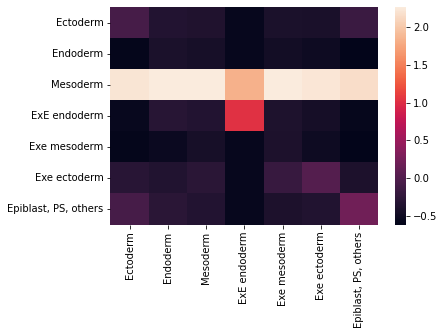

4
genes used


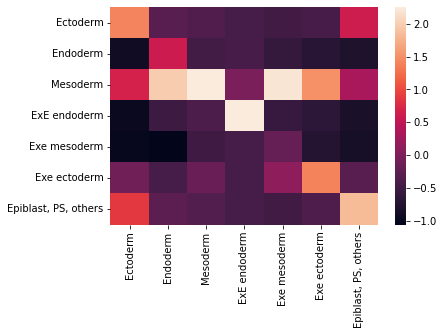

7
genes used


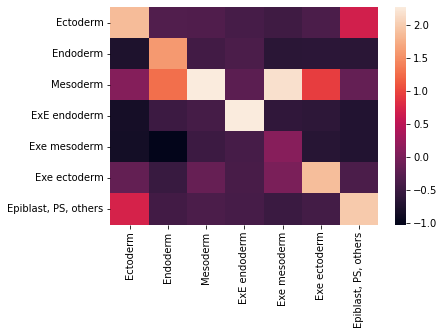

10
genes used


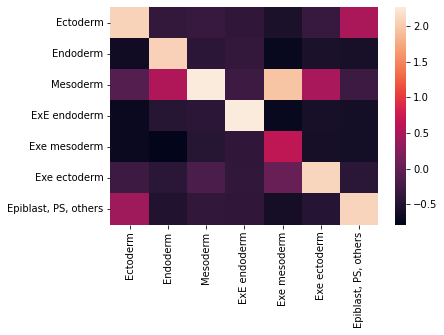

13
genes used


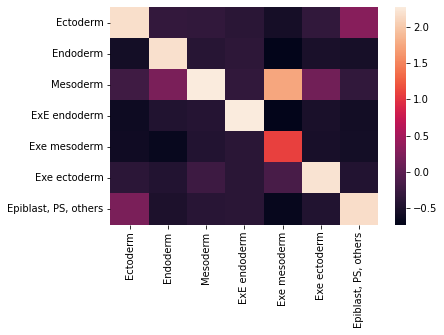

16
genes used


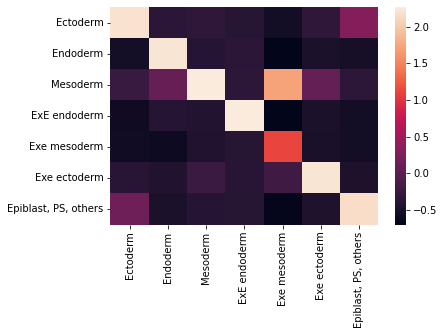

19
genes used


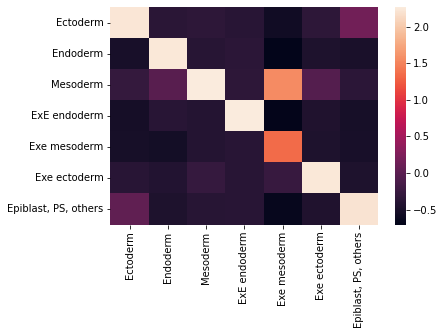

22
genes used


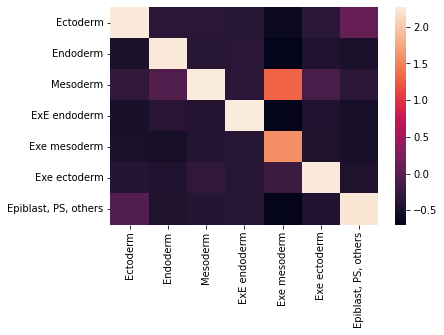

25
genes used


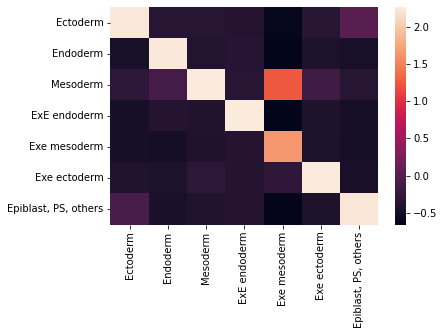

28
genes used


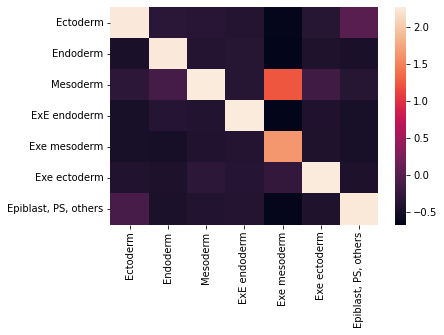

31
genes used


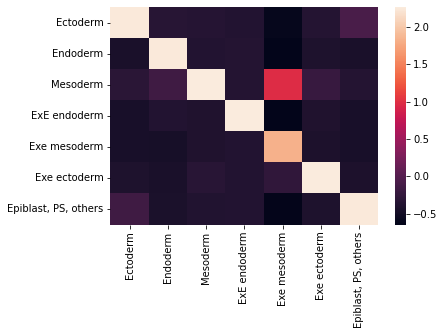

34
genes used


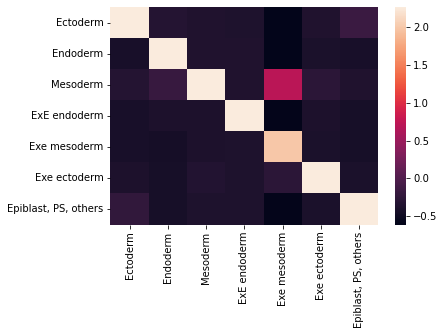

37
genes used


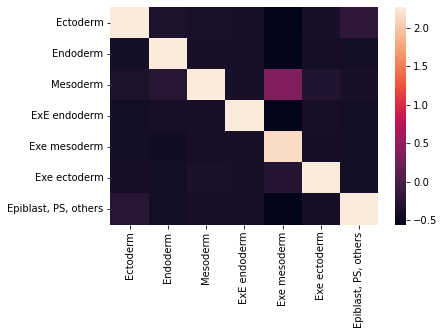

40
genes used


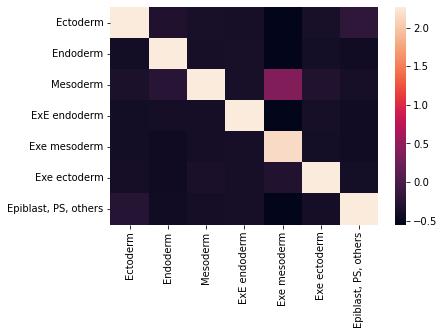

43
genes used


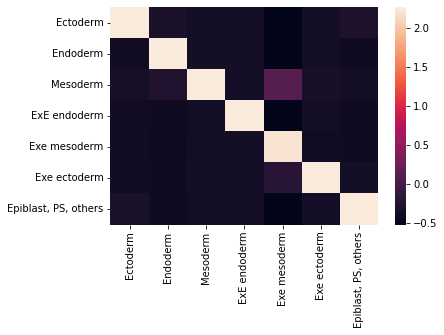

46
genes used


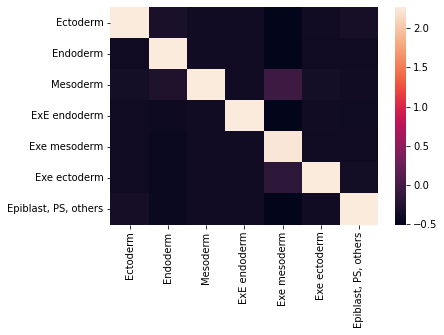

In [76]:
heatmaps(david_info[3],david_info[4], 592*200)

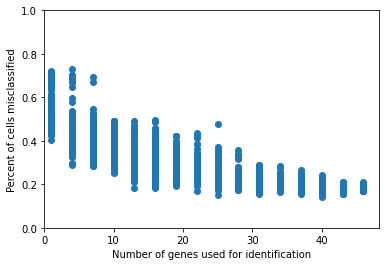

In [58]:
scatter(david_genes,david_info[0])

In [59]:
RNA_info = randomForestClassifier(RNA_genes)

26400 seconds to finish
440.0 minutes to finish
7.333333333333333 hours to finish

iteration number: 0
1 genes used
ACCURACY OF THE MODEL:  0.4189189189189189
344 cells misclassified
Total run time: 0.2533 seconds
cells misclassified:
{'Ectoderm': 101, 'Endoderm': 25, 'Mesoderm': 17, 'Exe endoderm': 98, 'Exe mesoderm': 7, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 286, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 58, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1
1 genes used
ACCURACY OF THE MODEL:  0.40878378378378377
350 cells misclassified
Total run time: 0.2414 seconds
cells misclassified:
{'Ectoderm': 96, 'Endoderm': 32, 'Mesoderm': 15, 'Exe endoderm': 88, 'Exe mesoderm': 9, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 287, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 62, 'nan': 0,

ACCURACY OF THE MODEL:  0.40709459459459457
351 cells misclassified
Total run time: 0.2551 seconds
cells misclassified:
{'Ectoderm': 97, 'Endoderm': 32, 'Mesoderm': 22, 'Exe endoderm': 93, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 289, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 56, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 19
1 genes used
ACCURACY OF THE MODEL:  0.34121621621621623
390 cells misclassified
Total run time: 0.3561 seconds
cells misclassified:
{'Ectoderm': 89, 'Endoderm': 37, 'Mesoderm': 44, 'Exe endoderm': 48, 'Exe mesoderm': 11, 'Exe ectoderm': 78, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 0, 'Mesoderm': 270, 'Exe endoderm': 52, 'Exe mesoderm': 0, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 5}

iteration number: 20
1 genes used
ACCURACY OF THE MODEL:  0.38682432432432434
363 c

ACCURACY OF THE MODEL:  0.3969594594594595
357 cells misclassified
Total run time: 0.2885 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 28, 'Mesoderm': 27, 'Exe endoderm': 112, 'Exe mesoderm': 3, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 2, 'Mesoderm': 265, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 54, 'nan': 0, 'Epiblast, PS, others': 7}

iteration number: 37
1 genes used
ACCURACY OF THE MODEL:  0.4189189189189189
344 cells misclassified
Total run time: 0.2478 seconds
cells misclassified:
{'Ectoderm': 96, 'Endoderm': 37, 'Mesoderm': 21, 'Exe endoderm': 72, 'Exe mesoderm': 7, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 89}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 277, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 57, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 38
1 genes used
ACCURACY OF THE MODEL:  0.40202702702702703
354 cell

ACCURACY OF THE MODEL:  0.4239864864864865
341 cells misclassified
Total run time: 0.2369 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 33, 'Mesoderm': 25, 'Exe endoderm': 71, 'Exe mesoderm': 9, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 87}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 275, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 63, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 55
1 genes used
ACCURACY OF THE MODEL:  0.38513513513513514
364 cells misclassified
Total run time: 0.2428 seconds
cells misclassified:
{'Ectoderm': 97, 'Endoderm': 31, 'Mesoderm': 21, 'Exe endoderm': 93, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 92}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 1, 'Mesoderm': 294, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 65, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 56
1 genes used
ACCURACY OF THE MODEL:  0.41047297297297297
349 cells

ACCURACY OF THE MODEL:  0.40540540540540543
352 cells misclassified
Total run time: 0.2386 seconds
cells misclassified:
{'Ectoderm': 90, 'Endoderm': 34, 'Mesoderm': 18, 'Exe endoderm': 90, 'Exe mesoderm': 10, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 91}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 284, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 64, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 73
1 genes used
ACCURACY OF THE MODEL:  0.42905405405405406
338 cells misclassified
Total run time: 0.2395 seconds
cells misclassified:
{'Ectoderm': 99, 'Endoderm': 23, 'Mesoderm': 20, 'Exe endoderm': 94, 'Exe mesoderm': 8, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 273, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 64, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 74
1 genes used
ACCURACY OF THE MODEL:  0.36317567567567566
377 cel

ACCURACY OF THE MODEL:  0.4155405405405405
346 cells misclassified
Total run time: 0.2368 seconds
cells misclassified:
{'Ectoderm': 97, 'Endoderm': 35, 'Mesoderm': 15, 'Exe endoderm': 93, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 276, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 68, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 91
1 genes used
ACCURACY OF THE MODEL:  0.40371621621621623
353 cells misclassified
Total run time: 0.2540 seconds
cells misclassified:
{'Ectoderm': 93, 'Endoderm': 36, 'Mesoderm': 32, 'Exe endoderm': 82, 'Exe mesoderm': 10, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 4, 'Endoderm': 1, 'Mesoderm': 257, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 54, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 92
1 genes used
ACCURACY OF THE MODEL:  0.30743243243243246
410 cel

ACCURACY OF THE MODEL:  0.4222972972972973
342 cells misclassified
Total run time: 0.2440 seconds
cells misclassified:
{'Ectoderm': 89, 'Endoderm': 32, 'Mesoderm': 32, 'Exe endoderm': 89, 'Exe mesoderm': 8, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 251, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 67, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 109
1 genes used
ACCURACY OF THE MODEL:  0.4189189189189189
344 cells misclassified
Total run time: 0.2543 seconds
cells misclassified:
{'Ectoderm': 86, 'Endoderm': 39, 'Mesoderm': 34, 'Exe endoderm': 76, 'Exe mesoderm': 8, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 258, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 110
1 genes used
ACCURACY OF THE MODEL:  0.38513513513513514
364 ce

ACCURACY OF THE MODEL:  0.4206081081081081
343 cells misclassified
Total run time: 0.2385 seconds
cells misclassified:
{'Ectoderm': 105, 'Endoderm': 29, 'Mesoderm': 17, 'Exe endoderm': 97, 'Exe mesoderm': 5, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 287, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 127
1 genes used
ACCURACY OF THE MODEL:  0.4172297297297297
345 cells misclassified
Total run time: 0.2453 seconds
cells misclassified:
{'Ectoderm': 100, 'Endoderm': 31, 'Mesoderm': 15, 'Exe endoderm': 97, 'Exe mesoderm': 3, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 85}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 283, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 128
1 genes used
ACCURACY OF THE MODEL:  0.3581081081081081
380 cel

ACCURACY OF THE MODEL:  0.42567567567567566
340 cells misclassified
Total run time: 0.2481 seconds
cells misclassified:
{'Ectoderm': 120, 'Endoderm': 30, 'Mesoderm': 17, 'Exe endoderm': 73, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 286, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 54, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 145
1 genes used
ACCURACY OF THE MODEL:  0.40202702702702703
354 cells misclassified
Total run time: 0.2421 seconds
cells misclassified:
{'Ectoderm': 111, 'Endoderm': 32, 'Mesoderm': 21, 'Exe endoderm': 103, 'Exe mesoderm': 2, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 284, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 69, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 146
1 genes used
ACCURACY OF THE MODEL:  0.38344594594594594
365

ACCURACY OF THE MODEL:  0.4189189189189189
344 cells misclassified
Total run time: 0.2357 seconds
cells misclassified:
{'Ectoderm': 105, 'Endoderm': 24, 'Mesoderm': 22, 'Exe endoderm': 81, 'Exe mesoderm': 5, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 95}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 280, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 63, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 163
1 genes used
ACCURACY OF THE MODEL:  0.4408783783783784
331 cells misclassified
Total run time: 0.2371 seconds
cells misclassified:
{'Ectoderm': 106, 'Endoderm': 26, 'Mesoderm': 27, 'Exe endoderm': 82, 'Exe mesoderm': 8, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 247, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 164
1 genes used
ACCURACY OF THE MODEL:  0.41216216216216217
348 c

ACCURACY OF THE MODEL:  0.40878378378378377
350 cells misclassified
Total run time: 0.2408 seconds
cells misclassified:
{'Ectoderm': 106, 'Endoderm': 24, 'Mesoderm': 21, 'Exe endoderm': 91, 'Exe mesoderm': 6, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 82}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 280, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 70, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 181
1 genes used
ACCURACY OF THE MODEL:  0.4189189189189189
344 cells misclassified
Total run time: 0.2553 seconds
cells misclassified:
{'Ectoderm': 95, 'Endoderm': 19, 'Mesoderm': 22, 'Exe endoderm': 89, 'Exe mesoderm': 7, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 89}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 274, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 64, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 182
1 genes used
ACCURACY OF THE MODEL:  0.4222972972972973
342 cel

ACCURACY OF THE MODEL:  0.2972972972972973
416 cells misclassified
Total run time: 0.3532 seconds
cells misclassified:
{'Ectoderm': 105, 'Endoderm': 40, 'Mesoderm': 17, 'Exe endoderm': 104, 'Exe mesoderm': 9, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 86}
cells being misclassified as:
{'Ectoderm': 16, 'Endoderm': 4, 'Mesoderm': 321, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 58, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 199
1 genes used
ACCURACY OF THE MODEL:  0.40709459459459457
351 cells misclassified
Total run time: 0.2377 seconds
cells misclassified:
{'Ectoderm': 96, 'Endoderm': 23, 'Mesoderm': 24, 'Exe endoderm': 91, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 90}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 282, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 69, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 200
4 genes used
ACCURACY OF THE MODEL:  0.36655405405405406
375

ACCURACY OF THE MODEL:  0.33614864864864863
393 cells misclassified
Total run time: 0.6525 seconds
cells misclassified:
{'Ectoderm': 94, 'Endoderm': 26, 'Mesoderm': 97, 'Exe endoderm': 62, 'Exe mesoderm': 6, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 19, 'Mesoderm': 148, 'Exe endoderm': 62, 'Exe mesoderm': 6, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 61}

iteration number: 217
4 genes used
ACCURACY OF THE MODEL:  0.3902027027027027
361 cells misclassified
Total run time: 0.3646 seconds
cells misclassified:
{'Ectoderm': 86, 'Endoderm': 29, 'Mesoderm': 45, 'Exe endoderm': 88, 'Exe mesoderm': 11, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 80}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 2, 'Mesoderm': 239, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 218
4 genes used
ACCURACY OF THE MODEL:  0.38006756756756754


ACCURACY OF THE MODEL:  0.36486486486486486
376 cells misclassified
Total run time: 0.3045 seconds
cells misclassified:
{'Ectoderm': 97, 'Endoderm': 31, 'Mesoderm': 36, 'Exe endoderm': 85, 'Exe mesoderm': 10, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 88}
cells being misclassified as:
{'Ectoderm': 11, 'Endoderm': 6, 'Mesoderm': 284, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 58, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 235
4 genes used
ACCURACY OF THE MODEL:  0.42567567567567566
340 cells misclassified
Total run time: 0.3282 seconds
cells misclassified:
{'Ectoderm': 91, 'Endoderm': 32, 'Mesoderm': 40, 'Exe endoderm': 76, 'Exe mesoderm': 15, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 5, 'Endoderm': 2, 'Mesoderm': 224, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 66, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 236
4 genes used
ACCURACY OF THE MODEL:  0.4222972972972973
342

ACCURACY OF THE MODEL:  0.4206081081081081
343 cells misclassified
Total run time: 0.3084 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 27, 'Mesoderm': 39, 'Exe endoderm': 108, 'Exe mesoderm': 6, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 12, 'Endoderm': 2, 'Mesoderm': 240, 'Exe endoderm': 3, 'Exe mesoderm': 1, 'Exe ectoderm': 57, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 253
4 genes used
ACCURACY OF THE MODEL:  0.42736486486486486
339 cells misclassified
Total run time: 0.2833 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 25, 'Mesoderm': 35, 'Exe endoderm': 84, 'Exe mesoderm': 5, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 87}
cells being misclassified as:
{'Ectoderm': 5, 'Endoderm': 2, 'Mesoderm': 243, 'Exe endoderm': 5, 'Exe mesoderm': 2, 'Exe ectoderm': 59, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 254
4 genes used
ACCURACY OF THE MODEL:  0.4408783783783784
331 

ACCURACY OF THE MODEL:  0.42905405405405406
338 cells misclassified
Total run time: 0.3220 seconds
cells misclassified:
{'Ectoderm': 87, 'Endoderm': 27, 'Mesoderm': 25, 'Exe endoderm': 94, 'Exe mesoderm': 5, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 8, 'Endoderm': 6, 'Mesoderm': 258, 'Exe endoderm': 9, 'Exe mesoderm': 0, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 271
4 genes used
ACCURACY OF THE MODEL:  0.3733108108108108
371 cells misclassified
Total run time: 0.4087 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 26, 'Mesoderm': 98, 'Exe endoderm': 90, 'Exe mesoderm': 7, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 120, 'Endoderm': 6, 'Mesoderm': 136, 'Exe endoderm': 21, 'Exe mesoderm': 3, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 272
4 genes used
ACCURACY OF THE MODEL:  0.40033783783783783
35

ACCURACY OF THE MODEL:  0.3158783783783784
405 cells misclassified
Total run time: 0.7878 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 24, 'Mesoderm': 113, 'Exe endoderm': 56, 'Exe mesoderm': 4, 'Exe ectoderm': 56, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 75, 'Endoderm': 16, 'Mesoderm': 138, 'Exe endoderm': 73, 'Exe mesoderm': 9, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 289
4 genes used
ACCURACY OF THE MODEL:  0.40202702702702703
354 cells misclassified
Total run time: 0.3346 seconds
cells misclassified:
{'Ectoderm': 93, 'Endoderm': 32, 'Mesoderm': 42, 'Exe endoderm': 85, 'Exe mesoderm': 8, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 13, 'Endoderm': 8, 'Mesoderm': 233, 'Exe endoderm': 15, 'Exe mesoderm': 3, 'Exe ectoderm': 66, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 290
4 genes used
ACCURACY OF THE MODEL:  0.40540540540540543

ACCURACY OF THE MODEL:  0.4560810810810811
322 cells misclassified
Total run time: 0.4125 seconds
cells misclassified:
{'Ectoderm': 91, 'Endoderm': 33, 'Mesoderm': 59, 'Exe endoderm': 50, 'Exe mesoderm': 9, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 3, 'Mesoderm': 208, 'Exe endoderm': 41, 'Exe mesoderm': 1, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 307
4 genes used
ACCURACY OF THE MODEL:  0.34459459459459457
388 cells misclassified
Total run time: 0.7960 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 19, 'Mesoderm': 113, 'Exe endoderm': 66, 'Exe mesoderm': 8, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 18, 'Mesoderm': 130, 'Exe endoderm': 60, 'Exe mesoderm': 2, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 61}

iteration number: 308
4 genes used
ACCURACY OF THE MODEL:  0.3969594594594595


ACCURACY OF THE MODEL:  0.42567567567567566
340 cells misclassified
Total run time: 0.3001 seconds
cells misclassified:
{'Ectoderm': 93, 'Endoderm': 33, 'Mesoderm': 27, 'Exe endoderm': 88, 'Exe mesoderm': 5, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 9, 'Endoderm': 4, 'Mesoderm': 250, 'Exe endoderm': 9, 'Exe mesoderm': 0, 'Exe ectoderm': 59, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 325
4 genes used
ACCURACY OF THE MODEL:  0.4155405405405405
346 cells misclassified
Total run time: 0.5320 seconds
cells misclassified:
{'Ectoderm': 91, 'Endoderm': 27, 'Mesoderm': 52, 'Exe endoderm': 63, 'Exe mesoderm': 5, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 15, 'Mesoderm': 183, 'Exe endoderm': 43, 'Exe mesoderm': 1, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 326
4 genes used
ACCURACY OF THE MODEL:  0.3597972972972973
379 

ACCURACY OF THE MODEL:  0.3716216216216216
372 cells misclassified
Total run time: 0.8422 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 24, 'Mesoderm': 93, 'Exe endoderm': 71, 'Exe mesoderm': 12, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 76, 'Endoderm': 16, 'Mesoderm': 143, 'Exe endoderm': 40, 'Exe mesoderm': 2, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 343
4 genes used
ACCURACY OF THE MODEL:  0.4172297297297297
345 cells misclassified
Total run time: 0.2602 seconds
cells misclassified:
{'Ectoderm': 95, 'Endoderm': 29, 'Mesoderm': 15, 'Exe endoderm': 85, 'Exe mesoderm': 9, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 96}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 288, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 57, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 344
4 genes used
ACCURACY OF THE MODEL:  0.5118243243243243
289 

ACCURACY OF THE MODEL:  0.40540540540540543
352 cells misclassified
Total run time: 0.6122 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 30, 'Mesoderm': 99, 'Exe endoderm': 52, 'Exe mesoderm': 6, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 18, 'Mesoderm': 133, 'Exe endoderm': 59, 'Exe mesoderm': 4, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 361
4 genes used
ACCURACY OF THE MODEL:  0.36317567567567566
377 cells misclassified
Total run time: 0.5240 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 32, 'Mesoderm': 105, 'Exe endoderm': 60, 'Exe mesoderm': 9, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 8, 'Mesoderm': 131, 'Exe endoderm': 81, 'Exe mesoderm': 2, 'Exe ectoderm': 54, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 362
4 genes used
ACCURACY OF THE MODEL:  0.4510135135135135

ACCURACY OF THE MODEL:  0.38006756756756754
367 cells misclassified
Total run time: 0.4084 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 41, 'Mesoderm': 52, 'Exe endoderm': 87, 'Exe mesoderm': 4, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 7, 'Mesoderm': 225, 'Exe endoderm': 28, 'Exe mesoderm': 1, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 379
4 genes used
ACCURACY OF THE MODEL:  0.38513513513513514
364 cells misclassified
Total run time: 0.6744 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 42, 'Mesoderm': 95, 'Exe endoderm': 51, 'Exe mesoderm': 4, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 12, 'Mesoderm': 143, 'Exe endoderm': 54, 'Exe mesoderm': 6, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 380
4 genes used
ACCURACY OF THE MODEL:  0.375
370 cells mis

ACCURACY OF THE MODEL:  0.4222972972972973
342 cells misclassified
Total run time: 0.2542 seconds
cells misclassified:
{'Ectoderm': 96, 'Endoderm': 44, 'Mesoderm': 13, 'Exe endoderm': 93, 'Exe mesoderm': 4, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 281, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 397
4 genes used
ACCURACY OF THE MODEL:  0.38175675675675674
366 cells misclassified
Total run time: 0.3572 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 38, 'Mesoderm': 61, 'Exe endoderm': 93, 'Exe mesoderm': 3, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 3, 'Mesoderm': 219, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 68, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 398
4 genes used
ACCURACY OF THE MODEL:  0.41385135135135137
347 

ACCURACY OF THE MODEL:  0.43074324324324326
337 cells misclassified
Total run time: 0.3732 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 29, 'Mesoderm': 63, 'Exe endoderm': 58, 'Exe mesoderm': 7, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 5, 'Mesoderm': 213, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 415
7 genes used
ACCURACY OF THE MODEL:  0.43243243243243246
336 cells misclassified
Total run time: 0.2821 seconds
cells misclassified:
{'Ectoderm': 87, 'Endoderm': 29, 'Mesoderm': 27, 'Exe endoderm': 88, 'Exe mesoderm': 8, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 77}
cells being misclassified as:
{'Ectoderm': 4, 'Endoderm': 2, 'Mesoderm': 250, 'Exe endoderm': 6, 'Exe mesoderm': 1, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 416
7 genes used
ACCURACY OF THE MODEL:  0.42567567567567566
34

ACCURACY OF THE MODEL:  0.44594594594594594
328 cells misclassified
Total run time: 0.3208 seconds
cells misclassified:
{'Ectoderm': 99, 'Endoderm': 26, 'Mesoderm': 30, 'Exe endoderm': 65, 'Exe mesoderm': 8, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 7, 'Endoderm': 2, 'Mesoderm': 246, 'Exe endoderm': 4, 'Exe mesoderm': 2, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 5}

iteration number: 433
7 genes used
ACCURACY OF THE MODEL:  0.40371621621621623
353 cells misclassified
Total run time: 0.6488 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 27, 'Mesoderm': 107, 'Exe endoderm': 42, 'Exe mesoderm': 5, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 74, 'Endoderm': 14, 'Mesoderm': 126, 'Exe endoderm': 36, 'Exe mesoderm': 5, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 434
7 genes used
ACCURACY OF THE MODEL:  0.43074324324324326
3

ACCURACY OF THE MODEL:  0.40878378378378377
350 cells misclassified
Total run time: 0.3884 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 27, 'Mesoderm': 49, 'Exe endoderm': 77, 'Exe mesoderm': 10, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 81}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 5, 'Mesoderm': 237, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 451
7 genes used
ACCURACY OF THE MODEL:  0.39864864864864863
356 cells misclassified
Total run time: 0.3379 seconds
cells misclassified:
{'Ectoderm': 88, 'Endoderm': 35, 'Mesoderm': 39, 'Exe endoderm': 75, 'Exe mesoderm': 8, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 82}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 0, 'Mesoderm': 230, 'Exe endoderm': 13, 'Exe mesoderm': 1, 'Exe ectoderm': 63, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 452
7 genes used
ACCURACY OF THE MODEL:  0.40202702702702703

ACCURACY OF THE MODEL:  0.5152027027027027
287 cells misclassified
Total run time: 0.5330 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 32, 'Mesoderm': 95, 'Exe endoderm': 8, 'Exe mesoderm': 6, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 97, 'Endoderm': 9, 'Mesoderm': 104, 'Exe endoderm': 8, 'Exe mesoderm': 1, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 469
7 genes used
ACCURACY OF THE MODEL:  0.46452702702702703
317 cells misclassified
Total run time: 0.6235 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 22, 'Mesoderm': 91, 'Exe endoderm': 32, 'Exe mesoderm': 11, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 20, 'Mesoderm': 115, 'Exe endoderm': 50, 'Exe mesoderm': 6, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 470
7 genes used
ACCURACY OF THE MODEL:  0.4222972972972973
34

ACCURACY OF THE MODEL:  0.3716216216216216
372 cells misclassified
Total run time: 0.6703 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 30, 'Mesoderm': 109, 'Exe endoderm': 58, 'Exe mesoderm': 8, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 12, 'Mesoderm': 137, 'Exe endoderm': 56, 'Exe mesoderm': 8, 'Exe ectoderm': 54, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 487
7 genes used
ACCURACY OF THE MODEL:  0.3125
407 cells misclassified
Total run time: 0.7378 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 30, 'Mesoderm': 108, 'Exe endoderm': 73, 'Exe mesoderm': 10, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 72, 'Endoderm': 21, 'Mesoderm': 131, 'Exe endoderm': 70, 'Exe mesoderm': 2, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 66}

iteration number: 488
7 genes used
ACCURACY OF THE MODEL:  0.3581081081081081
380 cells 

ACCURACY OF THE MODEL:  0.38682432432432434
363 cells misclassified
Total run time: 0.3468 seconds
cells misclassified:
{'Ectoderm': 100, 'Endoderm': 28, 'Mesoderm': 47, 'Exe endoderm': 88, 'Exe mesoderm': 6, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 4, 'Mesoderm': 257, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 61, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 505
7 genes used
ACCURACY OF THE MODEL:  0.5219594594594594
283 cells misclassified
Total run time: 0.4001 seconds
cells misclassified:
{'Ectoderm': 89, 'Endoderm': 33, 'Mesoderm': 41, 'Exe endoderm': 21, 'Exe mesoderm': 5, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 10, 'Mesoderm': 178, 'Exe endoderm': 11, 'Exe mesoderm': 1, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 506
7 genes used
ACCURACY OF THE MODEL:  0.43243243243243246


ACCURACY OF THE MODEL:  0.36993243243243246
373 cells misclassified
Total run time: 0.6755 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 33, 'Mesoderm': 75, 'Exe endoderm': 76, 'Exe mesoderm': 10, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 6, 'Mesoderm': 173, 'Exe endoderm': 34, 'Exe mesoderm': 3, 'Exe ectoderm': 58, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 523
7 genes used
ACCURACY OF THE MODEL:  0.34966216216216217
385 cells misclassified
Total run time: 0.4702 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 38, 'Mesoderm': 63, 'Exe endoderm': 76, 'Exe mesoderm': 10, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 0, 'Mesoderm': 195, 'Exe endoderm': 59, 'Exe mesoderm': 0, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 524
7 genes used
ACCURACY OF THE MODEL:  0.3935810810810811

ACCURACY OF THE MODEL:  0.375
370 cells misclassified
Total run time: 0.4896 seconds
cells misclassified:
{'Ectoderm': 91, 'Endoderm': 24, 'Mesoderm': 82, 'Exe endoderm': 72, 'Exe mesoderm': 7, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 11, 'Mesoderm': 169, 'Exe endoderm': 45, 'Exe mesoderm': 5, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 541
7 genes used
ACCURACY OF THE MODEL:  0.3733108108108108
371 cells misclassified
Total run time: 0.6068 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 27, 'Mesoderm': 99, 'Exe endoderm': 56, 'Exe mesoderm': 8, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 69, 'Endoderm': 12, 'Mesoderm': 138, 'Exe endoderm': 62, 'Exe mesoderm': 1, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 542
7 genes used
ACCURACY OF THE MODEL:  0.3885135135135135
362 cells misc

ACCURACY OF THE MODEL:  0.40878378378378377
350 cells misclassified
Total run time: 0.2532 seconds
cells misclassified:
{'Ectoderm': 90, 'Endoderm': 34, 'Mesoderm': 12, 'Exe endoderm': 83, 'Exe mesoderm': 13, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 98}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 290, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 56, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 559
7 genes used
ACCURACY OF THE MODEL:  0.5675675675675675
256 cells misclassified
Total run time: 0.7664 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 23, 'Mesoderm': 74, 'Exe endoderm': 13, 'Exe mesoderm': 6, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 14, 'Mesoderm': 69, 'Exe endoderm': 20, 'Exe mesoderm': 1, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 560
7 genes used
ACCURACY OF THE MODEL:  0.375
370 cells misclas

ACCURACY OF THE MODEL:  0.3564189189189189
381 cells misclassified
Total run time: 0.3314 seconds
cells misclassified:
{'Ectoderm': 98, 'Endoderm': 31, 'Mesoderm': 37, 'Exe endoderm': 109, 'Exe mesoderm': 9, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 7, 'Mesoderm': 270, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 64, 'nan': 0, 'Epiblast, PS, others': 3}

iteration number: 577
7 genes used
ACCURACY OF THE MODEL:  0.375
370 cells misclassified
Total run time: 0.7125 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 36, 'Mesoderm': 99, 'Exe endoderm': 47, 'Exe mesoderm': 6, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 16, 'Mesoderm': 128, 'Exe endoderm': 57, 'Exe mesoderm': 2, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 578
7 genes used
ACCURACY OF THE MODEL:  0.33783783783783783
392 cells misc

ACCURACY OF THE MODEL:  0.3783783783783784
368 cells misclassified
Total run time: 0.3899 seconds
cells misclassified:
{'Ectoderm': 90, 'Endoderm': 29, 'Mesoderm': 40, 'Exe endoderm': 98, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 84}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 7, 'Mesoderm': 247, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 61, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 595
7 genes used
ACCURACY OF THE MODEL:  0.3716216216216216
372 cells misclassified
Total run time: 0.5095 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 38, 'Mesoderm': 69, 'Exe endoderm': 58, 'Exe mesoderm': 9, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 77}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 13, 'Mesoderm': 202, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 596
7 genes used
ACCURACY OF THE MODEL:  0.36824324324324326
37

ACCURACY OF THE MODEL:  0.3614864864864865
378 cells misclassified
Total run time: 0.6535 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 36, 'Mesoderm': 88, 'Exe endoderm': 52, 'Exe mesoderm': 8, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 15, 'Mesoderm': 162, 'Exe endoderm': 68, 'Exe mesoderm': 9, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 613
10 genes used
ACCURACY OF THE MODEL:  0.4206081081081081
343 cells misclassified
Total run time: 0.4816 seconds
cells misclassified:
{'Ectoderm': 87, 'Endoderm': 29, 'Mesoderm': 63, 'Exe endoderm': 52, 'Exe mesoderm': 8, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 80}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 8, 'Mesoderm': 182, 'Exe endoderm': 29, 'Exe mesoderm': 1, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 614
10 genes used
ACCURACY OF THE MODEL:  0.44256756756756754

ACCURACY OF THE MODEL:  0.36486486486486486
376 cells misclassified
Total run time: 0.6506 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 27, 'Mesoderm': 79, 'Exe endoderm': 85, 'Exe mesoderm': 9, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 11, 'Mesoderm': 159, 'Exe endoderm': 47, 'Exe mesoderm': 5, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 53}

iteration number: 631
10 genes used
ACCURACY OF THE MODEL:  0.39864864864864863
356 cells misclassified
Total run time: 0.4453 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 39, 'Mesoderm': 71, 'Exe endoderm': 60, 'Exe mesoderm': 9, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 0, 'Mesoderm': 166, 'Exe endoderm': 53, 'Exe mesoderm': 1, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 632
10 genes used
ACCURACY OF THE MODEL:  0.383445945945945

ACCURACY OF THE MODEL:  0.4847972972972973
305 cells misclassified
Total run time: 0.4188 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 31, 'Mesoderm': 44, 'Exe endoderm': 55, 'Exe mesoderm': 6, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 7, 'Mesoderm': 191, 'Exe endoderm': 23, 'Exe mesoderm': 0, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 649
10 genes used
ACCURACY OF THE MODEL:  0.40540540540540543
352 cells misclassified
Total run time: 0.6463 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 39, 'Mesoderm': 87, 'Exe endoderm': 47, 'Exe mesoderm': 7, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 9, 'Mesoderm': 143, 'Exe endoderm': 36, 'Exe mesoderm': 3, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 59}

iteration number: 650
10 genes used
ACCURACY OF THE MODEL:  0.36993243243243246

ACCURACY OF THE MODEL:  0.3969594594594595
357 cells misclassified
Total run time: 0.4205 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 32, 'Mesoderm': 70, 'Exe endoderm': 77, 'Exe mesoderm': 10, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 7, 'Mesoderm': 204, 'Exe endoderm': 15, 'Exe mesoderm': 1, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 667
10 genes used
ACCURACY OF THE MODEL:  0.4172297297297297
345 cells misclassified
Total run time: 0.3488 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 23, 'Mesoderm': 48, 'Exe endoderm': 71, 'Exe mesoderm': 11, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 87}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 9, 'Mesoderm': 223, 'Exe endoderm': 10, 'Exe mesoderm': 1, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 668
10 genes used
ACCURACY OF THE MODEL:  0.3969594594594595

ACCURACY OF THE MODEL:  0.3733108108108108
371 cells misclassified
Total run time: 0.7496 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 31, 'Mesoderm': 116, 'Exe endoderm': 48, 'Exe mesoderm': 9, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 18, 'Mesoderm': 124, 'Exe endoderm': 44, 'Exe mesoderm': 3, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 61}

iteration number: 685
10 genes used
ACCURACY OF THE MODEL:  0.47128378378378377
313 cells misclassified
Total run time: 0.4086 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 36, 'Mesoderm': 49, 'Exe endoderm': 76, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 4, 'Mesoderm': 146, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 686
10 genes used
ACCURACY OF THE MODEL:  0.349662162162162

ACCURACY OF THE MODEL:  0.36486486486486486
376 cells misclassified
Total run time: 0.4150 seconds
cells misclassified:
{'Ectoderm': 88, 'Endoderm': 31, 'Mesoderm': 52, 'Exe endoderm': 75, 'Exe mesoderm': 10, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 6, 'Mesoderm': 239, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 703
10 genes used
ACCURACY OF THE MODEL:  0.40371621621621623
353 cells misclassified
Total run time: 0.4854 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 27, 'Mesoderm': 57, 'Exe endoderm': 77, 'Exe mesoderm': 4, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 21, 'Mesoderm': 187, 'Exe endoderm': 36, 'Exe mesoderm': 2, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 704
10 genes used
ACCURACY OF THE MODEL:  0.41554054054054

ACCURACY OF THE MODEL:  0.44932432432432434
326 cells misclassified
Total run time: 0.6104 seconds
cells misclassified:
{'Ectoderm': 94, 'Endoderm': 29, 'Mesoderm': 66, 'Exe endoderm': 57, 'Exe mesoderm': 6, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 22, 'Mesoderm': 146, 'Exe endoderm': 51, 'Exe mesoderm': 1, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 721
10 genes used
ACCURACY OF THE MODEL:  0.40371621621621623
353 cells misclassified
Total run time: 0.4827 seconds
cells misclassified:
{'Ectoderm': 90, 'Endoderm': 26, 'Mesoderm': 54, 'Exe endoderm': 74, 'Exe mesoderm': 5, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 7, 'Mesoderm': 200, 'Exe endoderm': 31, 'Exe mesoderm': 2, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 722
10 genes used
ACCURACY OF THE MODEL:  0.371621621621621

ACCURACY OF THE MODEL:  0.36317567567567566
377 cells misclassified
Total run time: 0.6863 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 32, 'Mesoderm': 109, 'Exe endoderm': 39, 'Exe mesoderm': 7, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 17, 'Mesoderm': 155, 'Exe endoderm': 27, 'Exe mesoderm': 2, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 64}

iteration number: 739
10 genes used
ACCURACY OF THE MODEL:  0.4814189189189189
307 cells misclassified
Total run time: 0.3291 seconds
cells misclassified:
{'Ectoderm': 98, 'Endoderm': 22, 'Mesoderm': 36, 'Exe endoderm': 60, 'Exe mesoderm': 8, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 8, 'Endoderm': 1, 'Mesoderm': 223, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 740
10 genes used
ACCURACY OF THE MODEL:  0.36824324324324326


ACCURACY OF THE MODEL:  0.36655405405405406
375 cells misclassified
Total run time: 0.4083 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 28, 'Mesoderm': 60, 'Exe endoderm': 104, 'Exe mesoderm': 12, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 7, 'Mesoderm': 210, 'Exe endoderm': 6, 'Exe mesoderm': 4, 'Exe ectoderm': 78, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 757
10 genes used
ACCURACY OF THE MODEL:  0.3952702702702703
358 cells misclassified
Total run time: 0.3677 seconds
cells misclassified:
{'Ectoderm': 102, 'Endoderm': 22, 'Mesoderm': 45, 'Exe endoderm': 89, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 9, 'Endoderm': 7, 'Mesoderm': 251, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 758
10 genes used
ACCURACY OF THE MODEL:  0.3817567567567567

ACCURACY OF THE MODEL:  0.47635135135135137
310 cells misclassified
Total run time: 0.3264 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 32, 'Mesoderm': 41, 'Exe endoderm': 47, 'Exe mesoderm': 7, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 3, 'Mesoderm': 217, 'Exe endoderm': 40, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 775
10 genes used
ACCURACY OF THE MODEL:  0.36655405405405406
375 cells misclassified
Total run time: 0.7533 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 23, 'Mesoderm': 115, 'Exe endoderm': 61, 'Exe mesoderm': 11, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 9, 'Mesoderm': 135, 'Exe endoderm': 59, 'Exe mesoderm': 7, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 63}

iteration number: 776
10 genes used
ACCURACY OF THE MODEL:  0.494932432432432

ACCURACY OF THE MODEL:  0.375
370 cells misclassified
Total run time: 0.5644 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 37, 'Mesoderm': 70, 'Exe endoderm': 75, 'Exe mesoderm': 6, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 5, 'Mesoderm': 179, 'Exe endoderm': 40, 'Exe mesoderm': 7, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 793
10 genes used
ACCURACY OF THE MODEL:  0.44256756756756754
330 cells misclassified
Total run time: 0.3509 seconds
cells misclassified:
{'Ectoderm': 101, 'Endoderm': 23, 'Mesoderm': 38, 'Exe endoderm': 60, 'Exe mesoderm': 7, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 7, 'Endoderm': 7, 'Mesoderm': 223, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 794
10 genes used
ACCURACY OF THE MODEL:  0.3530405405405405
383 cells mis

ACCURACY OF THE MODEL:  0.3614864864864865
378 cells misclassified
Total run time: 0.7056 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 19, 'Mesoderm': 92, 'Exe endoderm': 64, 'Exe mesoderm': 14, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 11, 'Mesoderm': 128, 'Exe endoderm': 57, 'Exe mesoderm': 4, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 66}

iteration number: 811
13 genes used
ACCURACY OF THE MODEL:  0.3260135135135135
399 cells misclassified
Total run time: 0.6815 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 29, 'Mesoderm': 110, 'Exe endoderm': 74, 'Exe mesoderm': 8, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 75, 'Endoderm': 9, 'Mesoderm': 158, 'Exe endoderm': 60, 'Exe mesoderm': 4, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 812
13 genes used
ACCURACY OF THE MODEL:  0.449324324324324

ACCURACY OF THE MODEL:  0.4189189189189189
344 cells misclassified
Total run time: 0.4939 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 25, 'Mesoderm': 49, 'Exe endoderm': 63, 'Exe mesoderm': 6, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 87}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 16, 'Mesoderm': 209, 'Exe endoderm': 23, 'Exe mesoderm': 2, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 829
13 genes used
ACCURACY OF THE MODEL:  0.39864864864864863
356 cells misclassified
Total run time: 0.5377 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 32, 'Mesoderm': 78, 'Exe endoderm': 62, 'Exe mesoderm': 5, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 5, 'Mesoderm': 156, 'Exe endoderm': 54, 'Exe mesoderm': 0, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 830
13 genes used
ACCURACY OF THE MODEL:  0.4020270270270270

ACCURACY OF THE MODEL:  0.46621621621621623
316 cells misclassified
Total run time: 0.7976 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 31, 'Mesoderm': 85, 'Exe endoderm': 48, 'Exe mesoderm': 3, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 19, 'Mesoderm': 118, 'Exe endoderm': 37, 'Exe mesoderm': 4, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 847
13 genes used
ACCURACY OF THE MODEL:  0.46452702702702703
317 cells misclassified
Total run time: 0.7624 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 38, 'Mesoderm': 88, 'Exe endoderm': 11, 'Exe mesoderm': 7, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 17, 'Mesoderm': 144, 'Exe endoderm': 7, 'Exe mesoderm': 3, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 848
13 genes used
ACCURACY OF THE MODEL:  0.413851351351351

ACCURACY OF THE MODEL:  0.3902027027027027
361 cells misclassified
Total run time: 0.8734 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 23, 'Mesoderm': 88, 'Exe endoderm': 65, 'Exe mesoderm': 3, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 11, 'Mesoderm': 150, 'Exe endoderm': 51, 'Exe mesoderm': 1, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 865
13 genes used
ACCURACY OF THE MODEL:  0.5827702702702703
247 cells misclassified
Total run time: 0.8900 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 25, 'Mesoderm': 61, 'Exe endoderm': 15, 'Exe mesoderm': 8, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 6, 'Mesoderm': 101, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 866
13 genes used
ACCURACY OF THE MODEL:  0.34966216216216217


ACCURACY OF THE MODEL:  0.36317567567567566
377 cells misclassified
Total run time: 0.7392 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 33, 'Mesoderm': 108, 'Exe endoderm': 61, 'Exe mesoderm': 8, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 14, 'Mesoderm': 118, 'Exe endoderm': 61, 'Exe mesoderm': 9, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 67}

iteration number: 883
13 genes used
ACCURACY OF THE MODEL:  0.3969594594594595
357 cells misclassified
Total run time: 0.4042 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 29, 'Mesoderm': 35, 'Exe endoderm': 90, 'Exe mesoderm': 8, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 86}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 6, 'Mesoderm': 255, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 7}

iteration number: 884
13 genes used
ACCURACY OF THE MODEL:  0.4206081081081081

ACCURACY OF THE MODEL:  0.3716216216216216
372 cells misclassified
Total run time: 0.8180 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 21, 'Mesoderm': 86, 'Exe endoderm': 71, 'Exe mesoderm': 5, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 10, 'Mesoderm': 139, 'Exe endoderm': 54, 'Exe mesoderm': 4, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 901
13 genes used
ACCURACY OF THE MODEL:  0.4408783783783784
331 cells misclassified
Total run time: 0.5852 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 41, 'Mesoderm': 85, 'Exe endoderm': 49, 'Exe mesoderm': 5, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 88, 'Endoderm': 6, 'Mesoderm': 84, 'Exe endoderm': 51, 'Exe mesoderm': 5, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 58}

iteration number: 902
13 genes used
ACCURACY OF THE MODEL:  0.34459459459459457


ACCURACY OF THE MODEL:  0.36486486486486486
376 cells misclassified
Total run time: 0.6538 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 33, 'Mesoderm': 92, 'Exe endoderm': 57, 'Exe mesoderm': 6, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 81}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 13, 'Mesoderm': 143, 'Exe endoderm': 62, 'Exe mesoderm': 2, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 919
13 genes used
ACCURACY OF THE MODEL:  0.3327702702702703
395 cells misclassified
Total run time: 0.6746 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 26, 'Mesoderm': 92, 'Exe endoderm': 68, 'Exe mesoderm': 5, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 77}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 28, 'Mesoderm': 130, 'Exe endoderm': 61, 'Exe mesoderm': 7, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 920
13 genes used
ACCURACY OF THE MODEL:  0.396959459459459

ACCURACY OF THE MODEL:  0.36317567567567566
377 cells misclassified
Total run time: 0.4837 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 38, 'Mesoderm': 63, 'Exe endoderm': 93, 'Exe mesoderm': 9, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 7, 'Mesoderm': 201, 'Exe endoderm': 32, 'Exe mesoderm': 3, 'Exe ectoderm': 71, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 937
13 genes used
ACCURACY OF THE MODEL:  0.4155405405405405
346 cells misclassified
Total run time: 0.4004 seconds
cells misclassified:
{'Ectoderm': 99, 'Endoderm': 23, 'Mesoderm': 33, 'Exe endoderm': 85, 'Exe mesoderm': 7, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 12, 'Endoderm': 6, 'Mesoderm': 229, 'Exe endoderm': 17, 'Exe mesoderm': 2, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 938
13 genes used
ACCURACY OF THE MODEL:  0.36486486486486486

ACCURACY OF THE MODEL:  0.4408783783783784
331 cells misclassified
Total run time: 0.7784 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 20, 'Mesoderm': 107, 'Exe endoderm': 31, 'Exe mesoderm': 7, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 28, 'Mesoderm': 121, 'Exe endoderm': 33, 'Exe mesoderm': 5, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 955
13 genes used
ACCURACY OF THE MODEL:  0.4358108108108108
334 cells misclassified
Total run time: 0.8629 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 40, 'Mesoderm': 77, 'Exe endoderm': 42, 'Exe mesoderm': 8, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 16, 'Mesoderm': 117, 'Exe endoderm': 43, 'Exe mesoderm': 3, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 956
13 genes used
ACCURACY OF THE MODEL:  0.418918918918918

ACCURACY OF THE MODEL:  0.3902027027027027
361 cells misclassified
Total run time: 0.4525 seconds
cells misclassified:
{'Ectoderm': 87, 'Endoderm': 33, 'Mesoderm': 54, 'Exe endoderm': 80, 'Exe mesoderm': 11, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 8, 'Mesoderm': 214, 'Exe endoderm': 30, 'Exe mesoderm': 1, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 973
13 genes used
ACCURACY OF THE MODEL:  0.3530405405405405
383 cells misclassified
Total run time: 0.7608 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 27, 'Mesoderm': 106, 'Exe endoderm': 71, 'Exe mesoderm': 7, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 82, 'Endoderm': 15, 'Mesoderm': 132, 'Exe endoderm': 52, 'Exe mesoderm': 5, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 974
13 genes used
ACCURACY OF THE MODEL:  0.405405405405405

ACCURACY OF THE MODEL:  0.3614864864864865
378 cells misclassified
Total run time: 0.7258 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 25, 'Mesoderm': 105, 'Exe endoderm': 67, 'Exe mesoderm': 4, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 19, 'Mesoderm': 118, 'Exe endoderm': 61, 'Exe mesoderm': 3, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 991
13 genes used
ACCURACY OF THE MODEL:  0.3564189189189189
381 cells misclassified
Total run time: 0.8746 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 37, 'Mesoderm': 129, 'Exe endoderm': 50, 'Exe mesoderm': 6, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 16, 'Mesoderm': 141, 'Exe endoderm': 52, 'Exe mesoderm': 8, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 64}

iteration number: 992
13 genes used
ACCURACY OF THE MODEL:  0.36655405405405

ACCURACY OF THE MODEL:  0.42905405405405406
338 cells misclassified
Total run time: 0.9112 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 24, 'Mesoderm': 96, 'Exe endoderm': 43, 'Exe mesoderm': 8, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 72, 'Endoderm': 10, 'Mesoderm': 135, 'Exe endoderm': 36, 'Exe mesoderm': 2, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 1009
16 genes used
ACCURACY OF THE MODEL:  0.3766891891891892
369 cells misclassified
Total run time: 0.8473 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 32, 'Mesoderm': 101, 'Exe endoderm': 55, 'Exe mesoderm': 8, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 17, 'Mesoderm': 131, 'Exe endoderm': 62, 'Exe mesoderm': 3, 'Exe ectoderm': 56, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 1010
16 genes used
ACCURACY OF THE MODEL:  0.393581081081

ACCURACY OF THE MODEL:  0.39864864864864863
356 cells misclassified
Total run time: 0.9522 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 32, 'Mesoderm': 79, 'Exe endoderm': 57, 'Exe mesoderm': 6, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 10, 'Mesoderm': 151, 'Exe endoderm': 36, 'Exe mesoderm': 2, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 65}

iteration number: 1027
16 genes used
ACCURACY OF THE MODEL:  0.5726351351351351
253 cells misclassified
Total run time: 0.9589 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 25, 'Mesoderm': 52, 'Exe endoderm': 31, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 3, 'Mesoderm': 96, 'Exe endoderm': 32, 'Exe mesoderm': 1, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 1028
16 genes used
ACCURACY OF THE MODEL:  0.432432432432432

ACCURACY OF THE MODEL:  0.3952702702702703
358 cells misclassified
Total run time: 0.7131 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 29, 'Mesoderm': 98, 'Exe endoderm': 63, 'Exe mesoderm': 8, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 19, 'Mesoderm': 128, 'Exe endoderm': 51, 'Exe mesoderm': 3, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 1045
16 genes used
ACCURACY OF THE MODEL:  0.38175675675675674
366 cells misclassified
Total run time: 0.6322 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 39, 'Mesoderm': 69, 'Exe endoderm': 76, 'Exe mesoderm': 8, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 9, 'Mesoderm': 171, 'Exe endoderm': 43, 'Exe mesoderm': 0, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 1046
16 genes used
ACCURACY OF THE MODEL:  0.38513513513513

ACCURACY OF THE MODEL:  0.33614864864864863
393 cells misclassified
Total run time: 0.7536 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 38, 'Mesoderm': 110, 'Exe endoderm': 58, 'Exe mesoderm': 10, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 25, 'Mesoderm': 128, 'Exe endoderm': 75, 'Exe mesoderm': 5, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 60}

iteration number: 1063
16 genes used
ACCURACY OF THE MODEL:  0.42736486486486486
339 cells misclassified
Total run time: 0.7478 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 35, 'Mesoderm': 95, 'Exe endoderm': 24, 'Exe mesoderm': 10, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 12, 'Mesoderm': 124, 'Exe endoderm': 60, 'Exe mesoderm': 2, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 1064
16 genes used
ACCURACY OF THE MODEL:  0.466216216

ACCURACY OF THE MODEL:  0.4797297297297297
308 cells misclassified
Total run time: 0.5217 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 37, 'Mesoderm': 61, 'Exe endoderm': 66, 'Exe mesoderm': 11, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 4, 'Mesoderm': 137, 'Exe endoderm': 23, 'Exe mesoderm': 2, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 1081
16 genes used
ACCURACY OF THE MODEL:  0.34459459459459457
388 cells misclassified
Total run time: 0.5590 seconds
cells misclassified:
{'Ectoderm': 86, 'Endoderm': 26, 'Mesoderm': 85, 'Exe endoderm': 69, 'Exe mesoderm': 5, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 78, 'Endoderm': 8, 'Mesoderm': 175, 'Exe endoderm': 48, 'Exe mesoderm': 2, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 1082
16 genes used
ACCURACY OF THE MODEL:  0.35979729729729

ACCURACY OF THE MODEL:  0.42736486486486486
339 cells misclassified
Total run time: 0.5349 seconds
cells misclassified:
{'Ectoderm': 95, 'Endoderm': 18, 'Mesoderm': 65, 'Exe endoderm': 57, 'Exe mesoderm': 12, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 16, 'Mesoderm': 170, 'Exe endoderm': 42, 'Exe mesoderm': 1, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 1099
16 genes used
ACCURACY OF THE MODEL:  0.49493243243243246
299 cells misclassified
Total run time: 0.9199 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 24, 'Mesoderm': 81, 'Exe endoderm': 43, 'Exe mesoderm': 7, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 11, 'Mesoderm': 118, 'Exe endoderm': 37, 'Exe mesoderm': 2, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 1100
16 genes used
ACCURACY OF THE MODEL:  0.44087837837

ACCURACY OF THE MODEL:  0.3952702702702703
358 cells misclassified
Total run time: 0.7502 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 21, 'Mesoderm': 90, 'Exe endoderm': 66, 'Exe mesoderm': 9, 'Exe ectoderm': 56, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 15, 'Mesoderm': 136, 'Exe endoderm': 60, 'Exe mesoderm': 2, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 1117
16 genes used
ACCURACY OF THE MODEL:  0.5320945945945946
277 cells misclassified
Total run time: 0.9683 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 28, 'Mesoderm': 63, 'Exe endoderm': 13, 'Exe mesoderm': 6, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 12, 'Mesoderm': 141, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 1118
16 genes used
ACCURACY OF THE MODEL:  0.444256756756756

ACCURACY OF THE MODEL:  0.38682432432432434
363 cells misclassified
Total run time: 0.4844 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 24, 'Mesoderm': 66, 'Exe endoderm': 63, 'Exe mesoderm': 10, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 90}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 6, 'Mesoderm': 200, 'Exe endoderm': 37, 'Exe mesoderm': 0, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 1135
16 genes used
ACCURACY OF THE MODEL:  0.44763513513513514
327 cells misclassified
Total run time: 0.9028 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 28, 'Mesoderm': 97, 'Exe endoderm': 47, 'Exe mesoderm': 9, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 16, 'Mesoderm': 122, 'Exe endoderm': 36, 'Exe mesoderm': 3, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 1136
16 genes used
ACCURACY OF THE MODEL:  0.461148648648

ACCURACY OF THE MODEL:  0.36993243243243246
373 cells misclassified
Total run time: 0.6524 seconds
cells misclassified:
{'Ectoderm': 90, 'Endoderm': 29, 'Mesoderm': 87, 'Exe endoderm': 56, 'Exe mesoderm': 5, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 9, 'Mesoderm': 170, 'Exe endoderm': 45, 'Exe mesoderm': 1, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 59}

iteration number: 1153
16 genes used
ACCURACY OF THE MODEL:  0.3564189189189189
381 cells misclassified
Total run time: 0.9015 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 32, 'Mesoderm': 94, 'Exe endoderm': 75, 'Exe mesoderm': 12, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 14, 'Mesoderm': 150, 'Exe endoderm': 52, 'Exe mesoderm': 3, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 1154
16 genes used
ACCURACY OF THE MODEL:  0.3986486486486

ACCURACY OF THE MODEL:  0.4577702702702703
321 cells misclassified
Total run time: 0.9501 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 28, 'Mesoderm': 88, 'Exe endoderm': 39, 'Exe mesoderm': 6, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 12, 'Mesoderm': 125, 'Exe endoderm': 50, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 1171
16 genes used
ACCURACY OF THE MODEL:  0.3969594594594595
357 cells misclassified
Total run time: 0.4534 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 34, 'Mesoderm': 37, 'Exe endoderm': 80, 'Exe mesoderm': 8, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 8, 'Mesoderm': 223, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 60, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 1172
16 genes used
ACCURACY OF THE MODEL:  0.358108108108108

ACCURACY OF THE MODEL:  0.42567567567567566
340 cells misclassified
Total run time: 0.4640 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 33, 'Mesoderm': 50, 'Exe endoderm': 74, 'Exe mesoderm': 5, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 7, 'Mesoderm': 194, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 57, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 1189
16 genes used
ACCURACY OF THE MODEL:  0.4408783783783784
331 cells misclassified
Total run time: 0.9045 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 33, 'Mesoderm': 73, 'Exe endoderm': 49, 'Exe mesoderm': 6, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 15, 'Mesoderm': 125, 'Exe endoderm': 47, 'Exe mesoderm': 1, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 1190
16 genes used
ACCURACY OF THE MODEL:  0.32939189189189

ACCURACY OF THE MODEL:  0.36486486486486486
376 cells misclassified
Total run time: 0.8739 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 29, 'Mesoderm': 99, 'Exe endoderm': 52, 'Exe mesoderm': 12, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 19, 'Mesoderm': 142, 'Exe endoderm': 60, 'Exe mesoderm': 1, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 1207
19 genes used
ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run time: 0.8795 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 11, 'Mesoderm': 66, 'Exe endoderm': 50, 'Exe mesoderm': 10, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 9, 'Mesoderm': 101, 'Exe endoderm': 38, 'Exe mesoderm': 1, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 1208
19 genes used
ACCURACY OF THE MODEL:  0.4695945945945

ACCURACY OF THE MODEL:  0.34459459459459457
388 cells misclassified
Total run time: 0.7596 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 30, 'Mesoderm': 99, 'Exe endoderm': 71, 'Exe mesoderm': 6, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 75, 'Endoderm': 10, 'Mesoderm': 143, 'Exe endoderm': 56, 'Exe mesoderm': 4, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 1225
19 genes used
ACCURACY OF THE MODEL:  0.5625
259 cells misclassified
Total run time: 0.9433 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 29, 'Mesoderm': 51, 'Exe endoderm': 38, 'Exe mesoderm': 10, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 3, 'Mesoderm': 108, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 1226
19 genes used
ACCURACY OF THE MODEL:  0.3564189189189189
381 cell

ACCURACY OF THE MODEL:  0.3902027027027027
361 cells misclassified
Total run time: 0.8262 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 24, 'Mesoderm': 107, 'Exe endoderm': 58, 'Exe mesoderm': 11, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 12, 'Mesoderm': 133, 'Exe endoderm': 60, 'Exe mesoderm': 6, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 1243
19 genes used
ACCURACY OF THE MODEL:  0.46452702702702703
317 cells misclassified
Total run time: 0.7757 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 31, 'Mesoderm': 79, 'Exe endoderm': 62, 'Exe mesoderm': 5, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 10, 'Mesoderm': 82, 'Exe endoderm': 61, 'Exe mesoderm': 2, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 1244
19 genes used
ACCURACY OF THE MODEL:  0.381756756756

ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 0.6865 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 25, 'Mesoderm': 83, 'Exe endoderm': 18, 'Exe mesoderm': 7, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 12, 'Mesoderm': 135, 'Exe endoderm': 16, 'Exe mesoderm': 6, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 1261
19 genes used
ACCURACY OF THE MODEL:  0.47466216216216217
311 cells misclassified
Total run time: 0.7540 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 25, 'Mesoderm': 66, 'Exe endoderm': 39, 'Exe mesoderm': 7, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 15, 'Mesoderm': 131, 'Exe endoderm': 32, 'Exe mesoderm': 3, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 1262
19 genes used
ACCURACY OF THE MODEL:  0.5405405405405

ACCURACY OF THE MODEL:  0.4543918918918919
323 cells misclassified
Total run time: 0.4136 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 36, 'Mesoderm': 30, 'Exe endoderm': 67, 'Exe mesoderm': 6, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 3, 'Mesoderm': 215, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1279
19 genes used
ACCURACY OF THE MODEL:  0.41216216216216217
348 cells misclassified
Total run time: 0.4520 seconds
cells misclassified:
{'Ectoderm': 89, 'Endoderm': 32, 'Mesoderm': 52, 'Exe endoderm': 69, 'Exe mesoderm': 7, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 12, 'Mesoderm': 206, 'Exe endoderm': 16, 'Exe mesoderm': 1, 'Exe ectoderm': 56, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 1280
19 genes used
ACCURACY OF THE MODEL:  0.375
370 cells 

ACCURACY OF THE MODEL:  0.4155405405405405
346 cells misclassified
Total run time: 0.5751 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 23, 'Mesoderm': 67, 'Exe endoderm': 84, 'Exe mesoderm': 3, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 11, 'Mesoderm': 173, 'Exe endoderm': 21, 'Exe mesoderm': 4, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 1297
19 genes used
ACCURACY OF THE MODEL:  0.4189189189189189
344 cells misclassified
Total run time: 0.7363 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 32, 'Mesoderm': 92, 'Exe endoderm': 62, 'Exe mesoderm': 9, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 17, 'Mesoderm': 114, 'Exe endoderm': 57, 'Exe mesoderm': 6, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 1298
19 genes used
ACCURACY OF THE MODEL:  0.37162162162162

ACCURACY OF THE MODEL:  0.5168918918918919
286 cells misclassified
Total run time: 0.6774 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 27, 'Mesoderm': 70, 'Exe endoderm': 18, 'Exe mesoderm': 9, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 7, 'Mesoderm': 146, 'Exe endoderm': 13, 'Exe mesoderm': 4, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 1315
19 genes used
ACCURACY OF THE MODEL:  0.3581081081081081
380 cells misclassified
Total run time: 0.7928 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 32, 'Mesoderm': 98, 'Exe endoderm': 65, 'Exe mesoderm': 11, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 11, 'Mesoderm': 153, 'Exe endoderm': 61, 'Exe mesoderm': 2, 'Exe ectoderm': 56, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 1316
19 genes used
ACCURACY OF THE MODEL:  0.4375
333 cells

ACCURACY OF THE MODEL:  0.44594594594594594
328 cells misclassified
Total run time: 0.7683 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 27, 'Mesoderm': 86, 'Exe endoderm': 55, 'Exe mesoderm': 8, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 13, 'Mesoderm': 113, 'Exe endoderm': 47, 'Exe mesoderm': 5, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 1333
19 genes used
ACCURACY OF THE MODEL:  0.40540540540540543
352 cells misclassified
Total run time: 0.6059 seconds
cells misclassified:
{'Ectoderm': 87, 'Endoderm': 35, 'Mesoderm': 75, 'Exe endoderm': 64, 'Exe mesoderm': 7, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 10, 'Mesoderm': 173, 'Exe endoderm': 47, 'Exe mesoderm': 3, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 1334
19 genes used
ACCURACY OF THE MODEL:  0.542229729729

ACCURACY OF THE MODEL:  0.36317567567567566
377 cells misclassified
Total run time: 0.6265 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 35, 'Mesoderm': 77, 'Exe endoderm': 79, 'Exe mesoderm': 9, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 13, 'Mesoderm': 179, 'Exe endoderm': 51, 'Exe mesoderm': 3, 'Exe ectoderm': 54, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 1351
19 genes used
ACCURACY OF THE MODEL:  0.4814189189189189
307 cells misclassified
Total run time: 0.9051 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 26, 'Mesoderm': 71, 'Exe endoderm': 37, 'Exe mesoderm': 8, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 11, 'Mesoderm': 150, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 1352
19 genes used
ACCURACY OF THE MODEL:  0.4138513513513

ACCURACY OF THE MODEL:  0.3766891891891892
369 cells misclassified
Total run time: 0.5388 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 31, 'Mesoderm': 94, 'Exe endoderm': 81, 'Exe mesoderm': 6, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 6, 'Mesoderm': 135, 'Exe endoderm': 40, 'Exe mesoderm': 0, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 102}

iteration number: 1369
19 genes used
ACCURACY OF THE MODEL:  0.47128378378378377
313 cells misclassified
Total run time: 0.8129 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 24, 'Mesoderm': 90, 'Exe endoderm': 20, 'Exe mesoderm': 5, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 10, 'Mesoderm': 132, 'Exe endoderm': 36, 'Exe mesoderm': 3, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 1370
19 genes used
ACCURACY OF THE MODEL:  0.3986486486486

ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 0.5362 seconds
cells misclassified:
{'Ectoderm': 86, 'Endoderm': 30, 'Mesoderm': 52, 'Exe endoderm': 25, 'Exe mesoderm': 10, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 10, 'Mesoderm': 177, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 1387
19 genes used
ACCURACY OF THE MODEL:  0.38175675675675674
366 cells misclassified
Total run time: 0.8967 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 32, 'Mesoderm': 98, 'Exe endoderm': 59, 'Exe mesoderm': 5, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 18, 'Mesoderm': 132, 'Exe endoderm': 67, 'Exe mesoderm': 3, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 1388
19 genes used
ACCURACY OF THE MODEL:  0.459459459459

ACCURACY OF THE MODEL:  0.40878378378378377
350 cells misclassified
Total run time: 0.7611 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 17, 'Mesoderm': 89, 'Exe endoderm': 53, 'Exe mesoderm': 7, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 20, 'Mesoderm': 151, 'Exe endoderm': 35, 'Exe mesoderm': 5, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 1405
22 genes used
ACCURACY OF THE MODEL:  0.3564189189189189
381 cells misclassified
Total run time: 0.8591 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 27, 'Mesoderm': 92, 'Exe endoderm': 66, 'Exe mesoderm': 8, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 11, 'Mesoderm': 144, 'Exe endoderm': 55, 'Exe mesoderm': 2, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 61}

iteration number: 1406
22 genes used
ACCURACY OF THE MODEL:  0.4847972972972

ACCURACY OF THE MODEL:  0.4780405405405405
309 cells misclassified
Total run time: 0.6772 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 24, 'Mesoderm': 70, 'Exe endoderm': 60, 'Exe mesoderm': 6, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 14, 'Mesoderm': 125, 'Exe endoderm': 37, 'Exe mesoderm': 3, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 1423
22 genes used
ACCURACY OF THE MODEL:  0.40202702702702703
354 cells misclassified
Total run time: 0.7482 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 23, 'Mesoderm': 97, 'Exe endoderm': 59, 'Exe mesoderm': 9, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 19, 'Mesoderm': 125, 'Exe endoderm': 57, 'Exe mesoderm': 4, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 1424
22 genes used
ACCURACY OF THE MODEL:  0.5033783783783

ACCURACY OF THE MODEL:  0.375
370 cells misclassified
Total run time: 0.7513 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 29, 'Mesoderm': 75, 'Exe endoderm': 64, 'Exe mesoderm': 4, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 15, 'Mesoderm': 145, 'Exe endoderm': 54, 'Exe mesoderm': 5, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 1441
22 genes used
ACCURACY OF THE MODEL:  0.518581081081081
285 cells misclassified
Total run time: 0.8682 seconds
cells misclassified:
{'Ectoderm': 90, 'Endoderm': 28, 'Mesoderm': 61, 'Exe endoderm': 17, 'Exe mesoderm': 9, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 11, 'Mesoderm': 134, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 1442
22 genes used
ACCURACY OF THE MODEL:  0.49324324324324326
300 cells 

ACCURACY OF THE MODEL:  0.5135135135135135
288 cells misclassified
Total run time: 0.8522 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 20, 'Mesoderm': 82, 'Exe endoderm': 27, 'Exe mesoderm': 8, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 11, 'Mesoderm': 102, 'Exe endoderm': 23, 'Exe mesoderm': 1, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 53}

iteration number: 1459
22 genes used
ACCURACY OF THE MODEL:  0.46283783783783783
318 cells misclassified
Total run time: 0.8631 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 29, 'Mesoderm': 69, 'Exe endoderm': 54, 'Exe mesoderm': 10, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 73, 'Endoderm': 12, 'Mesoderm': 110, 'Exe endoderm': 44, 'Exe mesoderm': 0, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 1460
22 genes used
ACCURACY OF THE MODEL:  0.339527027027

ACCURACY OF THE MODEL:  0.36317567567567566
377 cells misclassified
Total run time: 0.8989 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 31, 'Mesoderm': 103, 'Exe endoderm': 66, 'Exe mesoderm': 3, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 19, 'Mesoderm': 125, 'Exe endoderm': 50, 'Exe mesoderm': 6, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 71}

iteration number: 1477
22 genes used
ACCURACY OF THE MODEL:  0.3597972972972973
379 cells misclassified
Total run time: 0.8734 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 31, 'Mesoderm': 99, 'Exe endoderm': 72, 'Exe mesoderm': 5, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 69, 'Endoderm': 13, 'Mesoderm': 132, 'Exe endoderm': 48, 'Exe mesoderm': 8, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 70}

iteration number: 1478
22 genes used
ACCURACY OF THE MODEL:  0.457770270270

ACCURACY OF THE MODEL:  0.36317567567567566
377 cells misclassified
Total run time: 0.6074 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 23, 'Mesoderm': 75, 'Exe endoderm': 87, 'Exe mesoderm': 7, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 11, 'Mesoderm': 187, 'Exe endoderm': 28, 'Exe mesoderm': 1, 'Exe ectoderm': 63, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 1495
22 genes used
ACCURACY OF THE MODEL:  0.38513513513513514
364 cells misclassified
Total run time: 0.6443 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 36, 'Mesoderm': 82, 'Exe endoderm': 75, 'Exe mesoderm': 7, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 16, 'Mesoderm': 165, 'Exe endoderm': 40, 'Exe mesoderm': 8, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 1496
22 genes used
ACCURACY OF THE MODEL:  0.408783783783

ACCURACY OF THE MODEL:  0.4239864864864865
341 cells misclassified
Total run time: 0.3762 seconds
cells misclassified:
{'Ectoderm': 88, 'Endoderm': 33, 'Mesoderm': 27, 'Exe endoderm': 83, 'Exe mesoderm': 11, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 10, 'Endoderm': 1, 'Mesoderm': 263, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 1513
22 genes used
ACCURACY OF THE MODEL:  0.4847972972972973
305 cells misclassified
Total run time: 1.1078 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 28, 'Mesoderm': 72, 'Exe endoderm': 29, 'Exe mesoderm': 4, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 1, 'Mesoderm': 161, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1514
22 genes used
ACCURACY OF THE MODEL:  0.4358108108108108


ACCURACY OF THE MODEL:  0.41047297297297297
349 cells misclassified
Total run time: 0.7260 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 35, 'Mesoderm': 100, 'Exe endoderm': 55, 'Exe mesoderm': 6, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 8, 'Mesoderm': 105, 'Exe endoderm': 60, 'Exe mesoderm': 3, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 66}

iteration number: 1531
22 genes used
ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 0.8643 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 38, 'Mesoderm': 62, 'Exe endoderm': 15, 'Exe mesoderm': 7, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 4, 'Mesoderm': 136, 'Exe endoderm': 20, 'Exe mesoderm': 1, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 1532
22 genes used
ACCURACY OF THE MODEL:  0.40878378378378

ACCURACY OF THE MODEL:  0.3783783783783784
368 cells misclassified
Total run time: 0.7703 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 28, 'Mesoderm': 94, 'Exe endoderm': 46, 'Exe mesoderm': 8, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 14, 'Mesoderm': 137, 'Exe endoderm': 55, 'Exe mesoderm': 1, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 1549
22 genes used
ACCURACY OF THE MODEL:  0.3716216216216216
372 cells misclassified
Total run time: 0.7869 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 39, 'Mesoderm': 101, 'Exe endoderm': 44, 'Exe mesoderm': 9, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 12, 'Mesoderm': 139, 'Exe endoderm': 55, 'Exe mesoderm': 3, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 1550
22 genes used
ACCURACY OF THE MODEL:  0.4510135135135

ACCURACY OF THE MODEL:  0.42905405405405406
338 cells misclassified
Total run time: 0.9119 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 28, 'Mesoderm': 89, 'Exe endoderm': 62, 'Exe mesoderm': 6, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 6, 'Mesoderm': 154, 'Exe endoderm': 43, 'Exe mesoderm': 1, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 1567
22 genes used
ACCURACY OF THE MODEL:  0.4510135135135135
325 cells misclassified
Total run time: 0.8128 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 33, 'Mesoderm': 108, 'Exe endoderm': 14, 'Exe mesoderm': 7, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 75, 'Endoderm': 19, 'Mesoderm': 120, 'Exe endoderm': 27, 'Exe mesoderm': 2, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 1568
22 genes used
ACCURACY OF THE MODEL:  0.3851351351351

ACCURACY OF THE MODEL:  0.36655405405405406
375 cells misclassified
Total run time: 0.8632 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 23, 'Mesoderm': 86, 'Exe endoderm': 69, 'Exe mesoderm': 1, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 11, 'Mesoderm': 130, 'Exe endoderm': 49, 'Exe mesoderm': 3, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 62}

iteration number: 1585
22 genes used
ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 0.7215 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 29, 'Mesoderm': 91, 'Exe endoderm': 25, 'Exe mesoderm': 8, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 12, 'Mesoderm': 127, 'Exe endoderm': 27, 'Exe mesoderm': 5, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 1586
22 genes used
ACCURACY OF THE MODEL:  0.361486486486

ACCURACY OF THE MODEL:  0.49155405405405406
301 cells misclassified
Total run time: 1.0212 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 33, 'Mesoderm': 61, 'Exe endoderm': 44, 'Exe mesoderm': 6, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 1, 'Mesoderm': 157, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 1603
25 genes used
ACCURACY OF THE MODEL:  0.5135135135135135
288 cells misclassified
Total run time: 0.9892 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 32, 'Mesoderm': 62, 'Exe endoderm': 40, 'Exe mesoderm': 7, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 5, 'Mesoderm': 132, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 1604
25 genes used
ACCURACY OF THE MODEL:  0.412162162162162

ACCURACY OF THE MODEL:  0.5760135135135135
251 cells misclassified
Total run time: 0.9292 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 26, 'Mesoderm': 60, 'Exe endoderm': 16, 'Exe mesoderm': 8, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 14, 'Mesoderm': 113, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 1621
25 genes used
ACCURACY OF THE MODEL:  0.44932432432432434
326 cells misclassified
Total run time: 0.8673 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 28, 'Mesoderm': 78, 'Exe endoderm': 53, 'Exe mesoderm': 10, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 17, 'Mesoderm': 115, 'Exe endoderm': 48, 'Exe mesoderm': 5, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 1622
25 genes used
ACCURACY OF THE MODEL:  0.454391891891

ACCURACY OF THE MODEL:  0.6216216216216216
224 cells misclassified
Total run time: 0.9914 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 33, 'Mesoderm': 51, 'Exe endoderm': 3, 'Exe mesoderm': 9, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 6, 'Mesoderm': 100, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 1639
25 genes used
ACCURACY OF THE MODEL:  0.375
370 cells misclassified
Total run time: 0.9407 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 25, 'Mesoderm': 112, 'Exe endoderm': 63, 'Exe mesoderm': 5, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 12, 'Mesoderm': 125, 'Exe endoderm': 60, 'Exe mesoderm': 2, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 67}

iteration number: 1640
25 genes used
ACCURACY OF THE MODEL:  0.5168918918918919
286 cells mi

ACCURACY OF THE MODEL:  0.41216216216216217
348 cells misclassified
Total run time: 1.0646 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 29, 'Mesoderm': 89, 'Exe endoderm': 46, 'Exe mesoderm': 11, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 2, 'Mesoderm': 156, 'Exe endoderm': 44, 'Exe mesoderm': 0, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1657
25 genes used
ACCURACY OF THE MODEL:  0.6131756756756757
229 cells misclassified
Total run time: 0.7647 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 31, 'Mesoderm': 57, 'Exe endoderm': 7, 'Exe mesoderm': 6, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 10, 'Mesoderm': 101, 'Exe endoderm': 4, 'Exe mesoderm': 3, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 1658
25 genes used
ACCURACY OF THE MODEL:  0.5050675675675675

ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 1.0533 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 29, 'Mesoderm': 73, 'Exe endoderm': 26, 'Exe mesoderm': 4, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 0, 'Mesoderm': 132, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 1675
25 genes used
ACCURACY OF THE MODEL:  0.4391891891891892
332 cells misclassified
Total run time: 0.6790 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 23, 'Mesoderm': 73, 'Exe endoderm': 46, 'Exe mesoderm': 6, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 13, 'Mesoderm': 149, 'Exe endoderm': 45, 'Exe mesoderm': 4, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 1676
25 genes used
ACCURACY OF THE MODEL:  0.430743243243243

ACCURACY OF THE MODEL:  0.40202702702702703
354 cells misclassified
Total run time: 0.7918 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 29, 'Mesoderm': 97, 'Exe endoderm': 55, 'Exe mesoderm': 2, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 11, 'Mesoderm': 157, 'Exe endoderm': 35, 'Exe mesoderm': 8, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 1693
25 genes used
ACCURACY OF THE MODEL:  0.5219594594594594
283 cells misclassified
Total run time: 0.8789 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 34, 'Mesoderm': 85, 'Exe endoderm': 33, 'Exe mesoderm': 7, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 12, 'Mesoderm': 106, 'Exe endoderm': 29, 'Exe mesoderm': 2, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 1694
25 genes used
ACCURACY OF THE MODEL:  0.4645270270270

ACCURACY OF THE MODEL:  0.5793918918918919
249 cells misclassified
Total run time: 1.0599 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 29, 'Mesoderm': 59, 'Exe endoderm': 5, 'Exe mesoderm': 5, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 3, 'Mesoderm': 128, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1711
25 genes used
ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 0.8846 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 16, 'Mesoderm': 78, 'Exe endoderm': 39, 'Exe mesoderm': 15, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 14, 'Mesoderm': 119, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 66}

iteration number: 1712
25 genes used
ACCURACY OF THE MODEL:  0.4222972972972973

ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 0.6932 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 16, 'Mesoderm': 43, 'Exe endoderm': 25, 'Exe mesoderm': 14, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 10, 'Mesoderm': 84, 'Exe endoderm': 15, 'Exe mesoderm': 2, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 1729
25 genes used
ACCURACY OF THE MODEL:  0.5658783783783784
257 cells misclassified
Total run time: 0.8945 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 17, 'Mesoderm': 78, 'Exe endoderm': 1, 'Exe mesoderm': 12, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 6, 'Mesoderm': 112, 'Exe endoderm': 3, 'Exe mesoderm': 2, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 1730
25 genes used
ACCURACY OF THE MODEL:  0.3851351351351351

ACCURACY OF THE MODEL:  0.4358108108108108
334 cells misclassified
Total run time: 0.9172 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 29, 'Mesoderm': 88, 'Exe endoderm': 37, 'Exe mesoderm': 8, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 69, 'Endoderm': 13, 'Mesoderm': 134, 'Exe endoderm': 41, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 1747
25 genes used
ACCURACY OF THE MODEL:  0.4222972972972973
342 cells misclassified
Total run time: 0.9082 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 24, 'Mesoderm': 85, 'Exe endoderm': 58, 'Exe mesoderm': 12, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 21, 'Mesoderm': 106, 'Exe endoderm': 39, 'Exe mesoderm': 0, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 62}

iteration number: 1748
25 genes used
ACCURACY OF THE MODEL:  0.4442567567567

ACCURACY OF THE MODEL:  0.46452702702702703
317 cells misclassified
Total run time: 1.0079 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 33, 'Mesoderm': 82, 'Exe endoderm': 37, 'Exe mesoderm': 6, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 8, 'Mesoderm': 132, 'Exe endoderm': 47, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 1765
25 genes used
ACCURACY OF THE MODEL:  0.3969594594594595
357 cells misclassified
Total run time: 0.6471 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 42, 'Mesoderm': 63, 'Exe endoderm': 65, 'Exe mesoderm': 14, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 15, 'Mesoderm': 166, 'Exe endoderm': 37, 'Exe mesoderm': 1, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 1766
25 genes used
ACCURACY OF THE MODEL:  0.4611486486486

ACCURACY OF THE MODEL:  0.3969594594594595
357 cells misclassified
Total run time: 1.0244 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 29, 'Mesoderm': 99, 'Exe endoderm': 54, 'Exe mesoderm': 8, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 4, 'Mesoderm': 136, 'Exe endoderm': 42, 'Exe mesoderm': 1, 'Exe ectoderm': 58, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 1783
25 genes used
ACCURACY OF THE MODEL:  0.47297297297297297
312 cells misclassified
Total run time: 0.9102 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 28, 'Mesoderm': 61, 'Exe endoderm': 52, 'Exe mesoderm': 12, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 15, 'Mesoderm': 98, 'Exe endoderm': 52, 'Exe mesoderm': 1, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 1784
25 genes used
ACCURACY OF THE MODEL:  0.44425675675675

ACCURACY OF THE MODEL:  0.5523648648648649
265 cells misclassified
Total run time: 0.9113 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 27, 'Mesoderm': 69, 'Exe endoderm': 20, 'Exe mesoderm': 8, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 10, 'Mesoderm': 98, 'Exe endoderm': 14, 'Exe mesoderm': 2, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 1801
28 genes used
ACCURACY OF THE MODEL:  0.49155405405405406
301 cells misclassified
Total run time: 0.8822 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 21, 'Mesoderm': 70, 'Exe endoderm': 46, 'Exe mesoderm': 10, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 10, 'Mesoderm': 136, 'Exe endoderm': 50, 'Exe mesoderm': 2, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 1802
28 genes used
ACCURACY OF THE MODEL:  0.5016891891891

ACCURACY OF THE MODEL:  0.33952702702702703
391 cells misclassified
Total run time: 0.7163 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 25, 'Mesoderm': 80, 'Exe endoderm': 88, 'Exe mesoderm': 8, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 19, 'Mesoderm': 175, 'Exe endoderm': 44, 'Exe mesoderm': 4, 'Exe ectoderm': 59, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 1819
28 genes used
ACCURACY OF THE MODEL:  0.4560810810810811
322 cells misclassified
Total run time: 0.9087 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 22, 'Mesoderm': 81, 'Exe endoderm': 47, 'Exe mesoderm': 9, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 16, 'Mesoderm': 131, 'Exe endoderm': 34, 'Exe mesoderm': 2, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 1820
28 genes used
ACCURACY OF THE MODEL:  0.3817567567567

ACCURACY OF THE MODEL:  0.5929054054054054
241 cells misclassified
Total run time: 0.9109 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 30, 'Mesoderm': 54, 'Exe endoderm': 7, 'Exe mesoderm': 7, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 8, 'Mesoderm': 103, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 1837
28 genes used
ACCURACY OF THE MODEL:  0.5996621621621622
237 cells misclassified
Total run time: 0.9353 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 30, 'Mesoderm': 42, 'Exe endoderm': 12, 'Exe mesoderm': 7, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 7, 'Mesoderm': 97, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 1838
28 genes used
ACCURACY OF THE MODEL:  0.4814189189189189
3

ACCURACY OF THE MODEL:  0.40371621621621623
353 cells misclassified
Total run time: 0.8745 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 25, 'Mesoderm': 93, 'Exe endoderm': 62, 'Exe mesoderm': 10, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 12, 'Mesoderm': 139, 'Exe endoderm': 44, 'Exe mesoderm': 5, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 1855
28 genes used
ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 0.8809 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 35, 'Mesoderm': 76, 'Exe endoderm': 38, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 8, 'Mesoderm': 114, 'Exe endoderm': 43, 'Exe mesoderm': 5, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 1856
28 genes used
ACCURACY OF THE MODEL:  0.363175675675

ACCURACY OF THE MODEL:  0.40202702702702703
354 cells misclassified
Total run time: 0.8744 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 34, 'Mesoderm': 97, 'Exe endoderm': 42, 'Exe mesoderm': 5, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 22, 'Mesoderm': 136, 'Exe endoderm': 48, 'Exe mesoderm': 3, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 1873
28 genes used
ACCURACY OF THE MODEL:  0.4831081081081081
306 cells misclassified
Total run time: 0.9734 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 28, 'Mesoderm': 76, 'Exe endoderm': 35, 'Exe mesoderm': 8, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 5, 'Mesoderm': 105, 'Exe endoderm': 34, 'Exe mesoderm': 2, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 1874
28 genes used
ACCURACY OF THE MODEL:  0.46790540540540

ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 0.7719 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 29, 'Mesoderm': 90, 'Exe endoderm': 14, 'Exe mesoderm': 8, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 75, 'Endoderm': 11, 'Mesoderm': 108, 'Exe endoderm': 10, 'Exe mesoderm': 5, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 63}

iteration number: 1891
28 genes used
ACCURACY OF THE MODEL:  0.43243243243243246
336 cells misclassified
Total run time: 0.8874 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 36, 'Mesoderm': 83, 'Exe endoderm': 39, 'Exe mesoderm': 7, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 12, 'Mesoderm': 144, 'Exe endoderm': 25, 'Exe mesoderm': 2, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 1892
28 genes used
ACCURACY OF THE MODEL:  0.4290540540540

ACCURACY OF THE MODEL:  0.40540540540540543
352 cells misclassified
Total run time: 0.9297 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 26, 'Mesoderm': 88, 'Exe endoderm': 55, 'Exe mesoderm': 7, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 9, 'Mesoderm': 138, 'Exe endoderm': 49, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 64}

iteration number: 1909
28 genes used
ACCURACY OF THE MODEL:  0.35135135135135137
384 cells misclassified
Total run time: 0.8700 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 24, 'Mesoderm': 126, 'Exe endoderm': 53, 'Exe mesoderm': 9, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 19, 'Mesoderm': 141, 'Exe endoderm': 52, 'Exe mesoderm': 7, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 1910
28 genes used
ACCURACY OF THE MODEL:  0.498310810810

ACCURACY OF THE MODEL:  0.36824324324324326
374 cells misclassified
Total run time: 0.8050 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 31, 'Mesoderm': 96, 'Exe endoderm': 56, 'Exe mesoderm': 6, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 8, 'Mesoderm': 129, 'Exe endoderm': 50, 'Exe mesoderm': 5, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 60}

iteration number: 1927
28 genes used
ACCURACY OF THE MODEL:  0.4172297297297297
345 cells misclassified
Total run time: 0.7922 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 25, 'Mesoderm': 96, 'Exe endoderm': 60, 'Exe mesoderm': 11, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 16, 'Mesoderm': 119, 'Exe endoderm': 44, 'Exe mesoderm': 3, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 1928
28 genes used
ACCURACY OF THE MODEL:  0.4375
333 cell

ACCURACY OF THE MODEL:  0.43243243243243246
336 cells misclassified
Total run time: 0.9748 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 29, 'Mesoderm': 86, 'Exe endoderm': 55, 'Exe mesoderm': 8, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 12, 'Mesoderm': 142, 'Exe endoderm': 35, 'Exe mesoderm': 2, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 1945
28 genes used
ACCURACY OF THE MODEL:  0.33614864864864863
393 cells misclassified
Total run time: 0.8141 seconds
cells misclassified:
{'Ectoderm': 91, 'Endoderm': 33, 'Mesoderm': 95, 'Exe endoderm': 74, 'Exe mesoderm': 6, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 8, 'Mesoderm': 139, 'Exe endoderm': 53, 'Exe mesoderm': 6, 'Exe ectoderm': 62, 'nan': 0, 'Epiblast, PS, others': 61}

iteration number: 1946
28 genes used
ACCURACY OF THE MODEL:  0.4679054054054

ACCURACY OF THE MODEL:  0.5101351351351351
290 cells misclassified
Total run time: 0.8601 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 27, 'Mesoderm': 60, 'Exe endoderm': 20, 'Exe mesoderm': 12, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 13, 'Mesoderm': 106, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 1963
28 genes used
ACCURACY OF THE MODEL:  0.3885135135135135
362 cells misclassified
Total run time: 0.9510 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 25, 'Mesoderm': 103, 'Exe endoderm': 62, 'Exe mesoderm': 10, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 76, 'Endoderm': 13, 'Mesoderm': 122, 'Exe endoderm': 57, 'Exe mesoderm': 1, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 1964
28 genes used
ACCURACY OF THE MODEL:  0.55743243243

ACCURACY OF THE MODEL:  0.3766891891891892
369 cells misclassified
Total run time: 0.8878 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 25, 'Mesoderm': 97, 'Exe endoderm': 55, 'Exe mesoderm': 9, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 72, 'Endoderm': 13, 'Mesoderm': 129, 'Exe endoderm': 57, 'Exe mesoderm': 3, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 61}

iteration number: 1981
28 genes used
ACCURACY OF THE MODEL:  0.4847972972972973
305 cells misclassified
Total run time: 0.9189 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 29, 'Mesoderm': 76, 'Exe endoderm': 51, 'Exe mesoderm': 14, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 8, 'Mesoderm': 112, 'Exe endoderm': 42, 'Exe mesoderm': 1, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 1982
28 genes used
ACCURACY OF THE MODEL:  0.50675675675675

ACCURACY OF THE MODEL:  0.4983108108108108
297 cells misclassified
Total run time: 0.8637 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 24, 'Mesoderm': 90, 'Exe endoderm': 21, 'Exe mesoderm': 5, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 73, 'Endoderm': 15, 'Mesoderm': 117, 'Exe endoderm': 25, 'Exe mesoderm': 3, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 1999
28 genes used
ACCURACY OF THE MODEL:  0.47466216216216217
311 cells misclassified
Total run time: 0.9923 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 29, 'Mesoderm': 68, 'Exe endoderm': 31, 'Exe mesoderm': 8, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 7, 'Mesoderm': 149, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 2000
31 genes used
ACCURACY OF THE MODEL:  0.54729729729729

ACCURACY OF THE MODEL:  0.4206081081081081
343 cells misclassified
Total run time: 0.9200 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 32, 'Mesoderm': 83, 'Exe endoderm': 39, 'Exe mesoderm': 9, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 72, 'Endoderm': 6, 'Mesoderm': 137, 'Exe endoderm': 45, 'Exe mesoderm': 4, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 2017
31 genes used
ACCURACY OF THE MODEL:  0.5675675675675675
256 cells misclassified
Total run time: 0.8904 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 28, 'Mesoderm': 62, 'Exe endoderm': 30, 'Exe mesoderm': 9, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 3, 'Mesoderm': 106, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 2018
31 genes used
ACCURACY OF THE MODEL:  0.4256756756756756

ACCURACY OF THE MODEL:  0.49324324324324326
300 cells misclassified
Total run time: 0.6875 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 30, 'Mesoderm': 55, 'Exe endoderm': 30, 'Exe mesoderm': 10, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 18, 'Mesoderm': 151, 'Exe endoderm': 28, 'Exe mesoderm': 5, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 2035
31 genes used
ACCURACY OF THE MODEL:  0.4222972972972973
342 cells misclassified
Total run time: 0.9641 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 29, 'Mesoderm': 69, 'Exe endoderm': 55, 'Exe mesoderm': 9, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 2, 'Mesoderm': 161, 'Exe endoderm': 36, 'Exe mesoderm': 2, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 2036
31 genes used
ACCURACY OF THE MODEL:  0.5523648648648

ACCURACY OF THE MODEL:  0.3969594594594595
357 cells misclassified
Total run time: 0.7610 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 24, 'Mesoderm': 92, 'Exe endoderm': 66, 'Exe mesoderm': 5, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 15, 'Mesoderm': 128, 'Exe endoderm': 46, 'Exe mesoderm': 2, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 58}

iteration number: 2053
31 genes used
ACCURACY OF THE MODEL:  0.535472972972973
275 cells misclassified
Total run time: 0.9167 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 28, 'Mesoderm': 75, 'Exe endoderm': 9, 'Exe mesoderm': 3, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 15, 'Mesoderm': 119, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 2054
31 genes used
ACCURACY OF THE MODEL:  0.4662162162162162

ACCURACY OF THE MODEL:  0.47128378378378377
313 cells misclassified
Total run time: 0.8573 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 17, 'Mesoderm': 89, 'Exe endoderm': 61, 'Exe mesoderm': 9, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 73, 'Endoderm': 15, 'Mesoderm': 119, 'Exe endoderm': 52, 'Exe mesoderm': 4, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 2071
31 genes used
ACCURACY OF THE MODEL:  0.6554054054054054
204 cells misclassified
Total run time: 1.4756 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 20, 'Mesoderm': 39, 'Exe endoderm': 22, 'Exe mesoderm': 8, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 2, 'Mesoderm': 81, 'Exe endoderm': 22, 'Exe mesoderm': 2, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 2072
31 genes used
ACCURACY OF THE MODEL:  0.6182432432432432
2

ACCURACY OF THE MODEL:  0.5118243243243243
289 cells misclassified
Total run time: 0.9999 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 30, 'Mesoderm': 75, 'Exe endoderm': 41, 'Exe mesoderm': 11, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 4, 'Mesoderm': 121, 'Exe endoderm': 41, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 2089
31 genes used
ACCURACY OF THE MODEL:  0.4983108108108108
297 cells misclassified
Total run time: 1.0329 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 32, 'Mesoderm': 54, 'Exe endoderm': 36, 'Exe mesoderm': 6, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 3, 'Mesoderm': 159, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 2090
31 genes used
ACCURACY OF THE MODEL:  0.535472972972973

ACCURACY OF THE MODEL:  0.4594594594594595
320 cells misclassified
Total run time: 0.8821 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 32, 'Mesoderm': 95, 'Exe endoderm': 33, 'Exe mesoderm': 12, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 76, 'Endoderm': 11, 'Mesoderm': 127, 'Exe endoderm': 21, 'Exe mesoderm': 3, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 2107
31 genes used
ACCURACY OF THE MODEL:  0.4797297297297297
308 cells misclassified
Total run time: 0.8980 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 24, 'Mesoderm': 95, 'Exe endoderm': 36, 'Exe mesoderm': 7, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 15, 'Mesoderm': 121, 'Exe endoderm': 32, 'Exe mesoderm': 6, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 2108
31 genes used
ACCURACY OF THE MODEL:  0.5506756756756

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 0.9817 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 26, 'Mesoderm': 70, 'Exe endoderm': 33, 'Exe mesoderm': 9, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 7, 'Mesoderm': 112, 'Exe endoderm': 28, 'Exe mesoderm': 1, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 2125
31 genes used
ACCURACY OF THE MODEL:  0.4780405405405405
309 cells misclassified
Total run time: 0.8277 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 34, 'Mesoderm': 78, 'Exe endoderm': 15, 'Exe mesoderm': 10, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 13, 'Mesoderm': 135, 'Exe endoderm': 18, 'Exe mesoderm': 5, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 56}

iteration number: 2126
31 genes used
ACCURACY OF THE MODEL:  0.45945945945945

ACCURACY OF THE MODEL:  0.4222972972972973
342 cells misclassified
Total run time: 0.9309 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 31, 'Mesoderm': 93, 'Exe endoderm': 44, 'Exe mesoderm': 5, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 11, 'Mesoderm': 134, 'Exe endoderm': 47, 'Exe mesoderm': 2, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 2143
31 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 0.9337 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 25, 'Mesoderm': 74, 'Exe endoderm': 15, 'Exe mesoderm': 12, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 6, 'Mesoderm': 137, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 2144
31 genes used
ACCURACY OF THE MODEL:  0.47128378378378

ACCURACY OF THE MODEL:  0.4560810810810811
322 cells misclassified
Total run time: 0.9101 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 22, 'Mesoderm': 77, 'Exe endoderm': 42, 'Exe mesoderm': 14, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 13, 'Mesoderm': 122, 'Exe endoderm': 45, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 2161
31 genes used
ACCURACY OF THE MODEL:  0.5152027027027027
287 cells misclassified
Total run time: 1.0109 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 28, 'Mesoderm': 61, 'Exe endoderm': 17, 'Exe mesoderm': 10, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 2, 'Mesoderm': 141, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 2162
31 genes used
ACCURACY OF THE MODEL:  0.4543918918918

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 0.9405 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 35, 'Mesoderm': 60, 'Exe endoderm': 22, 'Exe mesoderm': 9, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 3, 'Mesoderm': 113, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 2179
31 genes used
ACCURACY OF THE MODEL:  0.4510135135135135
325 cells misclassified
Total run time: 0.9918 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 29, 'Mesoderm': 75, 'Exe endoderm': 39, 'Exe mesoderm': 7, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 69, 'Endoderm': 3, 'Mesoderm': 152, 'Exe endoderm': 47, 'Exe mesoderm': 1, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 2180
31 genes used
ACCURACY OF THE MODEL:  0.5760135135135135

ACCURACY OF THE MODEL:  0.40202702702702703
354 cells misclassified
Total run time: 0.9331 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 23, 'Mesoderm': 89, 'Exe endoderm': 59, 'Exe mesoderm': 10, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 12, 'Mesoderm': 150, 'Exe endoderm': 42, 'Exe mesoderm': 2, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 2197
31 genes used
ACCURACY OF THE MODEL:  0.4408783783783784
331 cells misclassified
Total run time: 0.9554 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 35, 'Mesoderm': 77, 'Exe endoderm': 44, 'Exe mesoderm': 6, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 9, 'Mesoderm': 132, 'Exe endoderm': 51, 'Exe mesoderm': 1, 'Exe ectoderm': 49, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 2198
31 genes used
ACCURACY OF THE MODEL:  0.4662162162162

ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 0.9205 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 33, 'Mesoderm': 92, 'Exe endoderm': 15, 'Exe mesoderm': 5, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 13, 'Mesoderm': 94, 'Exe endoderm': 23, 'Exe mesoderm': 1, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 60}

iteration number: 2215
34 genes used
ACCURACY OF THE MODEL:  0.4408783783783784
331 cells misclassified
Total run time: 0.9197 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 26, 'Mesoderm': 85, 'Exe endoderm': 38, 'Exe mesoderm': 6, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 9, 'Mesoderm': 141, 'Exe endoderm': 39, 'Exe mesoderm': 3, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 2216
34 genes used
ACCURACY OF THE MODEL:  0.5202702702702703

ACCURACY OF THE MODEL:  0.4864864864864865
304 cells misclassified
Total run time: 0.9727 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 39, 'Mesoderm': 68, 'Exe endoderm': 25, 'Exe mesoderm': 14, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 0, 'Mesoderm': 148, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 2233
34 genes used
ACCURACY OF THE MODEL:  0.49155405405405406
301 cells misclassified
Total run time: 0.9091 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 31, 'Mesoderm': 80, 'Exe endoderm': 25, 'Exe mesoderm': 7, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 5, 'Mesoderm': 153, 'Exe endoderm': 18, 'Exe mesoderm': 1, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 2234
34 genes used
ACCURACY OF THE MODEL:  0.59966216216216

ACCURACY OF THE MODEL:  0.40033783783783783
355 cells misclassified
Total run time: 0.8150 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 27, 'Mesoderm': 90, 'Exe endoderm': 67, 'Exe mesoderm': 10, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 11, 'Mesoderm': 119, 'Exe endoderm': 47, 'Exe mesoderm': 2, 'Exe ectoderm': 59, 'nan': 0, 'Epiblast, PS, others': 66}

iteration number: 2251
34 genes used
ACCURACY OF THE MODEL:  0.48986486486486486
302 cells misclassified
Total run time: 1.1028 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 32, 'Mesoderm': 79, 'Exe endoderm': 30, 'Exe mesoderm': 8, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 1, 'Mesoderm': 139, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 2252
34 genes used
ACCURACY OF THE MODEL:  0.498310810810

ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 0.9016 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 22, 'Mesoderm': 92, 'Exe endoderm': 14, 'Exe mesoderm': 9, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 10, 'Mesoderm': 100, 'Exe endoderm': 22, 'Exe mesoderm': 1, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 61}

iteration number: 2269
34 genes used
ACCURACY OF THE MODEL:  0.5
296 cells misclassified
Total run time: 1.0210 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 38, 'Mesoderm': 56, 'Exe endoderm': 24, 'Exe mesoderm': 8, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 4, 'Mesoderm': 152, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 2270
34 genes used
ACCURACY OF THE MODEL:  0.5337837837837838
276 cells mis

ACCURACY OF THE MODEL:  0.36317567567567566
377 cells misclassified
Total run time: 0.7858 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 35, 'Mesoderm': 101, 'Exe endoderm': 74, 'Exe mesoderm': 11, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 80, 'Endoderm': 13, 'Mesoderm': 136, 'Exe endoderm': 62, 'Exe mesoderm': 1, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 2287
34 genes used
ACCURACY OF THE MODEL:  0.4543918918918919
323 cells misclassified
Total run time: 0.9865 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 32, 'Mesoderm': 64, 'Exe endoderm': 49, 'Exe mesoderm': 8, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 0, 'Mesoderm': 155, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 2288
34 genes used
ACCURACY OF THE MODEL:  0.581081081081

ACCURACY OF THE MODEL:  0.40371621621621623
353 cells misclassified
Total run time: 1.0548 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 29, 'Mesoderm': 78, 'Exe endoderm': 66, 'Exe mesoderm': 6, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 1, 'Mesoderm': 171, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 54, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 2305
34 genes used
ACCURACY OF THE MODEL:  0.4239864864864865
341 cells misclassified
Total run time: 0.9761 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 27, 'Mesoderm': 91, 'Exe endoderm': 59, 'Exe mesoderm': 8, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 3, 'Mesoderm': 132, 'Exe endoderm': 54, 'Exe mesoderm': 0, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 2306
34 genes used
ACCURACY OF THE MODEL:  0.415540540540540

ACCURACY OF THE MODEL:  0.42567567567567566
340 cells misclassified
Total run time: 0.9702 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 30, 'Mesoderm': 90, 'Exe endoderm': 50, 'Exe mesoderm': 7, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 7, 'Mesoderm': 121, 'Exe endoderm': 53, 'Exe mesoderm': 0, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 2323
34 genes used
ACCURACY OF THE MODEL:  0.42905405405405406
338 cells misclassified
Total run time: 1.0048 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 23, 'Mesoderm': 85, 'Exe endoderm': 55, 'Exe mesoderm': 9, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 4, 'Mesoderm': 152, 'Exe endoderm': 48, 'Exe mesoderm': 0, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 2324
34 genes used
ACCURACY OF THE MODEL:  0.40709459459459

ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 0.8939 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 32, 'Mesoderm': 62, 'Exe endoderm': 15, 'Exe mesoderm': 11, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 14, 'Mesoderm': 90, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 2341
34 genes used
ACCURACY OF THE MODEL:  0.36824324324324326
374 cells misclassified
Total run time: 0.8518 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 29, 'Mesoderm': 101, 'Exe endoderm': 66, 'Exe mesoderm': 6, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 81, 'Endoderm': 9, 'Mesoderm': 134, 'Exe endoderm': 53, 'Exe mesoderm': 6, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 2342
34 genes used
ACCURACY OF THE MODEL:  0.4712837837837

ACCURACY OF THE MODEL:  0.44594594594594594
328 cells misclassified
Total run time: 0.9702 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 32, 'Mesoderm': 51, 'Exe endoderm': 48, 'Exe mesoderm': 13, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 10, 'Mesoderm': 177, 'Exe endoderm': 25, 'Exe mesoderm': 1, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 2359
34 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 0.9738 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 29, 'Mesoderm': 61, 'Exe endoderm': 30, 'Exe mesoderm': 5, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 1, 'Mesoderm': 132, 'Exe endoderm': 33, 'Exe mesoderm': 1, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 2360
34 genes used
ACCURACY OF THE MODEL:  0.3935810810810

ACCURACY OF THE MODEL:  0.375
370 cells misclassified
Total run time: 0.7912 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 31, 'Mesoderm': 110, 'Exe endoderm': 55, 'Exe mesoderm': 12, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 11, 'Mesoderm': 123, 'Exe endoderm': 51, 'Exe mesoderm': 3, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 77}

iteration number: 2377
34 genes used
ACCURACY OF THE MODEL:  0.5135135135135135
288 cells misclassified
Total run time: 0.9172 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 30, 'Mesoderm': 75, 'Exe endoderm': 35, 'Exe mesoderm': 6, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 5, 'Mesoderm': 127, 'Exe endoderm': 44, 'Exe mesoderm': 1, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 2378
34 genes used
ACCURACY OF THE MODEL:  0.6081081081081081
232 cells

ACCURACY OF THE MODEL:  0.44594594594594594
328 cells misclassified
Total run time: 0.8491 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 29, 'Mesoderm': 79, 'Exe endoderm': 42, 'Exe mesoderm': 10, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 8, 'Mesoderm': 114, 'Exe endoderm': 50, 'Exe mesoderm': 2, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 59}

iteration number: 2395
34 genes used
ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 0.9234 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 25, 'Mesoderm': 69, 'Exe endoderm': 25, 'Exe mesoderm': 10, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 4, 'Mesoderm': 142, 'Exe endoderm': 26, 'Exe mesoderm': 2, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 2396
34 genes used
ACCURACY OF THE MODEL:  0.5152027027027

ACCURACY OF THE MODEL:  0.40878378378378377
350 cells misclassified
Total run time: 0.8275 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 23, 'Mesoderm': 73, 'Exe endoderm': 52, 'Exe mesoderm': 6, 'Exe ectoderm': 53, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 14, 'Mesoderm': 120, 'Exe endoderm': 72, 'Exe mesoderm': 1, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 2413
37 genes used
ACCURACY OF THE MODEL:  0.49324324324324326
300 cells misclassified
Total run time: 0.9672 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 30, 'Mesoderm': 68, 'Exe endoderm': 28, 'Exe mesoderm': 7, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 6, 'Mesoderm': 122, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 2414
37 genes used
ACCURACY OF THE MODEL:  0.4358108108108

ACCURACY OF THE MODEL:  0.4155405405405405
346 cells misclassified
Total run time: 0.8287 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 30, 'Mesoderm': 95, 'Exe endoderm': 65, 'Exe mesoderm': 10, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 82, 'Endoderm': 15, 'Mesoderm': 114, 'Exe endoderm': 52, 'Exe mesoderm': 2, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 2431
37 genes used
ACCURACY OF THE MODEL:  0.5523648648648649
265 cells misclassified
Total run time: 0.9923 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 30, 'Mesoderm': 49, 'Exe endoderm': 41, 'Exe mesoderm': 10, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 7, 'Mesoderm': 121, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 2432
37 genes used
ACCURACY OF THE MODEL:  0.47128378378378

ACCURACY OF THE MODEL:  0.5084459459459459
291 cells misclassified
Total run time: 0.9993 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 36, 'Mesoderm': 60, 'Exe endoderm': 19, 'Exe mesoderm': 6, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 85, 'Endoderm': 7, 'Mesoderm': 118, 'Exe endoderm': 14, 'Exe mesoderm': 1, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 2449
37 genes used
ACCURACY OF THE MODEL:  0.5135135135135135
288 cells misclassified
Total run time: 0.9646 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 19, 'Mesoderm': 90, 'Exe endoderm': 14, 'Exe mesoderm': 13, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 16, 'Mesoderm': 109, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 53}

iteration number: 2450
37 genes used
ACCURACY OF THE MODEL:  0.41216216216216

ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 0.9969 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 19, 'Mesoderm': 84, 'Exe endoderm': 42, 'Exe mesoderm': 11, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 4, 'Mesoderm': 138, 'Exe endoderm': 27, 'Exe mesoderm': 1, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 2467
37 genes used
ACCURACY OF THE MODEL:  0.4391891891891892
332 cells misclassified
Total run time: 1.0051 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 33, 'Mesoderm': 76, 'Exe endoderm': 56, 'Exe mesoderm': 7, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 4, 'Mesoderm': 156, 'Exe endoderm': 45, 'Exe mesoderm': 4, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 2468
37 genes used
ACCURACY OF THE MODEL:  0.552364864864864

ACCURACY OF THE MODEL:  0.6283783783783784
220 cells misclassified
Total run time: 0.9574 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 34, 'Mesoderm': 52, 'Exe endoderm': 8, 'Exe mesoderm': 6, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 6, 'Mesoderm': 86, 'Exe endoderm': 14, 'Exe mesoderm': 1, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 2485
37 genes used
ACCURACY OF THE MODEL:  0.4560810810810811
322 cells misclassified
Total run time: 0.8889 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 21, 'Mesoderm': 85, 'Exe endoderm': 47, 'Exe mesoderm': 5, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 11, 'Mesoderm': 132, 'Exe endoderm': 41, 'Exe mesoderm': 4, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 2486
37 genes used
ACCURACY OF THE MODEL:  0.5219594594594594


ACCURACY OF THE MODEL:  0.4206081081081081
343 cells misclassified
Total run time: 1.0126 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 30, 'Mesoderm': 78, 'Exe endoderm': 50, 'Exe mesoderm': 5, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 11, 'Mesoderm': 140, 'Exe endoderm': 45, 'Exe mesoderm': 3, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 53}

iteration number: 2503
37 genes used
ACCURACY OF THE MODEL:  0.47466216216216217
311 cells misclassified
Total run time: 0.9818 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 21, 'Mesoderm': 87, 'Exe endoderm': 45, 'Exe mesoderm': 7, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 75, 'Endoderm': 4, 'Mesoderm': 127, 'Exe endoderm': 40, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 2504
37 genes used
ACCURACY OF THE MODEL:  0.52027027027027

ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 0.9958 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 27, 'Mesoderm': 40, 'Exe endoderm': 41, 'Exe mesoderm': 8, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 3, 'Mesoderm': 88, 'Exe endoderm': 38, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 2521
37 genes used
ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 1.2182 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 27, 'Mesoderm': 51, 'Exe endoderm': 23, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 4, 'Mesoderm': 112, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 2522
37 genes used
ACCURACY OF THE MODEL:  0.5658783783783784


ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 1.0351 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 32, 'Mesoderm': 49, 'Exe endoderm': 40, 'Exe mesoderm': 2, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 3, 'Mesoderm': 136, 'Exe endoderm': 37, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 2539
37 genes used
ACCURACY OF THE MODEL:  0.5219594594594594
283 cells misclassified
Total run time: 0.9971 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 27, 'Mesoderm': 55, 'Exe endoderm': 17, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 80}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 7, 'Mesoderm': 163, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 2540
37 genes used
ACCURACY OF THE MODEL:  0.4763513513513513

ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 0.9066 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 28, 'Mesoderm': 87, 'Exe endoderm': 10, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 6, 'Mesoderm': 119, 'Exe endoderm': 18, 'Exe mesoderm': 3, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 2557
37 genes used
ACCURACY OF THE MODEL:  0.5827702702702703
247 cells misclassified
Total run time: 1.0888 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 27, 'Mesoderm': 53, 'Exe endoderm': 26, 'Exe mesoderm': 13, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 0, 'Mesoderm': 125, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 2558
37 genes used
ACCURACY OF THE MODEL:  0.3851351351351351

ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 0.9815 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 34, 'Mesoderm': 67, 'Exe endoderm': 39, 'Exe mesoderm': 7, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 14, 'Mesoderm': 105, 'Exe endoderm': 21, 'Exe mesoderm': 5, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 62}

iteration number: 2575
37 genes used
ACCURACY OF THE MODEL:  0.42567567567567566
340 cells misclassified
Total run time: 1.0436 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 22, 'Mesoderm': 89, 'Exe endoderm': 53, 'Exe mesoderm': 10, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 6, 'Mesoderm': 133, 'Exe endoderm': 57, 'Exe mesoderm': 0, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 2576
37 genes used
ACCURACY OF THE MODEL:  0.5236486486486

ACCURACY OF THE MODEL:  0.38006756756756754
367 cells misclassified
Total run time: 0.9316 seconds
cells misclassified:
{'Ectoderm': 87, 'Endoderm': 28, 'Mesoderm': 108, 'Exe endoderm': 40, 'Exe mesoderm': 7, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 14, 'Mesoderm': 151, 'Exe endoderm': 53, 'Exe mesoderm': 1, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 2593
37 genes used
ACCURACY OF THE MODEL:  0.5168918918918919
286 cells misclassified
Total run time: 0.9661 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 35, 'Mesoderm': 64, 'Exe endoderm': 16, 'Exe mesoderm': 6, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 5, 'Mesoderm': 129, 'Exe endoderm': 21, 'Exe mesoderm': 2, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 2594
37 genes used
ACCURACY OF THE MODEL:  0.4898648648648

ACCURACY OF THE MODEL:  0.41216216216216217
348 cells misclassified
Total run time: 0.9768 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 27, 'Mesoderm': 81, 'Exe endoderm': 57, 'Exe mesoderm': 5, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 7, 'Mesoderm': 157, 'Exe endoderm': 44, 'Exe mesoderm': 3, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 2611
40 genes used
ACCURACY OF THE MODEL:  0.5287162162162162
279 cells misclassified
Total run time: 1.0092 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 31, 'Mesoderm': 75, 'Exe endoderm': 17, 'Exe mesoderm': 11, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 11, 'Mesoderm': 104, 'Exe endoderm': 42, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 2612
40 genes used
ACCURACY OF THE MODEL:  0.4966216216216

ACCURACY OF THE MODEL:  0.3902027027027027
361 cells misclassified
Total run time: 0.9479 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 30, 'Mesoderm': 108, 'Exe endoderm': 53, 'Exe mesoderm': 5, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 76, 'Endoderm': 9, 'Mesoderm': 136, 'Exe endoderm': 41, 'Exe mesoderm': 2, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 63}

iteration number: 2629
40 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 0.9818 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 28, 'Mesoderm': 83, 'Exe endoderm': 15, 'Exe mesoderm': 12, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 69, 'Endoderm': 4, 'Mesoderm': 123, 'Exe endoderm': 30, 'Exe mesoderm': 1, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 2630
40 genes used
ACCURACY OF THE MODEL:  0.97972972972972

ACCURACY OF THE MODEL:  0.4239864864864865
341 cells misclassified
Total run time: 1.0718 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 28, 'Mesoderm': 72, 'Exe endoderm': 63, 'Exe mesoderm': 6, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 2, 'Mesoderm': 152, 'Exe endoderm': 39, 'Exe mesoderm': 1, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 2647
40 genes used
ACCURACY OF THE MODEL:  0.5287162162162162
279 cells misclassified
Total run time: 0.9494 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 23, 'Mesoderm': 58, 'Exe endoderm': 27, 'Exe mesoderm': 10, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 7, 'Mesoderm': 125, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 2648
40 genes used
ACCURACY OF THE MODEL:  0.469594594594594

ACCURACY OF THE MODEL:  0.5608108108108109
260 cells misclassified
Total run time: 1.0468 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 21, 'Mesoderm': 63, 'Exe endoderm': 21, 'Exe mesoderm': 6, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 7, 'Mesoderm': 126, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 2665
40 genes used
ACCURACY OF THE MODEL:  0.4172297297297297
345 cells misclassified
Total run time: 0.9446 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 32, 'Mesoderm': 77, 'Exe endoderm': 59, 'Exe mesoderm': 5, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 12, 'Mesoderm': 148, 'Exe endoderm': 47, 'Exe mesoderm': 1, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 2666
40 genes used
ACCURACY OF THE MODEL:  0.4898648648648648

ACCURACY OF THE MODEL:  0.5574324324324325
262 cells misclassified
Total run time: 1.1336 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 34, 'Mesoderm': 57, 'Exe endoderm': 16, 'Exe mesoderm': 10, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 3, 'Mesoderm': 116, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 2683
40 genes used
ACCURACY OF THE MODEL:  0.5287162162162162
279 cells misclassified
Total run time: 0.9668 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 21, 'Mesoderm': 72, 'Exe endoderm': 10, 'Exe mesoderm': 14, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 7, 'Mesoderm': 125, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 2684
40 genes used
ACCURACY OF THE MODEL:  0.45608108108108

ACCURACY OF THE MODEL:  0.4797297297297297
308 cells misclassified
Total run time: 1.0057 seconds
cells misclassified:
{'Ectoderm': 93, 'Endoderm': 26, 'Mesoderm': 74, 'Exe endoderm': 24, 'Exe mesoderm': 8, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 9, 'Mesoderm': 144, 'Exe endoderm': 34, 'Exe mesoderm': 3, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 2701
40 genes used
ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 0.9488 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 26, 'Mesoderm': 58, 'Exe endoderm': 57, 'Exe mesoderm': 10, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 7, 'Mesoderm': 115, 'Exe endoderm': 44, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 2702
40 genes used
ACCURACY OF THE MODEL:  0.461148648648648

ACCURACY OF THE MODEL:  0.49324324324324326
300 cells misclassified
Total run time: 0.8628 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 35, 'Mesoderm': 76, 'Exe endoderm': 35, 'Exe mesoderm': 2, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 15, 'Mesoderm': 113, 'Exe endoderm': 33, 'Exe mesoderm': 2, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 55}

iteration number: 2719
40 genes used
ACCURACY OF THE MODEL:  0.4172297297297297
345 cells misclassified
Total run time: 0.9311 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 29, 'Mesoderm': 93, 'Exe endoderm': 48, 'Exe mesoderm': 6, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 13, 'Mesoderm': 137, 'Exe endoderm': 47, 'Exe mesoderm': 3, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 2720
40 genes used
ACCURACY OF THE MODEL:  0.4932432432432

ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run time: 0.9804 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 30, 'Mesoderm': 80, 'Exe endoderm': 33, 'Exe mesoderm': 6, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 2, 'Mesoderm': 101, 'Exe endoderm': 44, 'Exe mesoderm': 2, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 2737
40 genes used
ACCURACY OF THE MODEL:  0.5067567567567568
292 cells misclassified
Total run time: 1.0255 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 34, 'Mesoderm': 72, 'Exe endoderm': 18, 'Exe mesoderm': 11, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 3, 'Mesoderm': 141, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 2738
40 genes used
ACCURACY OF THE MODEL:  0.5641891891891891

ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 0.9843 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 23, 'Mesoderm': 77, 'Exe endoderm': 24, 'Exe mesoderm': 8, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 2, 'Mesoderm': 122, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 2755
40 genes used
ACCURACY OF THE MODEL:  0.40540540540540543
352 cells misclassified
Total run time: 0.9973 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 21, 'Mesoderm': 86, 'Exe endoderm': 52, 'Exe mesoderm': 10, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 6, 'Mesoderm': 138, 'Exe endoderm': 60, 'Exe mesoderm': 1, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 2756
40 genes used
ACCURACY OF THE MODEL:  0.48648648648648

ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 0.8724 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 28, 'Mesoderm': 89, 'Exe endoderm': 13, 'Exe mesoderm': 5, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 77}
cells being misclassified as:
{'Ectoderm': 84, 'Endoderm': 18, 'Mesoderm': 105, 'Exe endoderm': 5, 'Exe mesoderm': 4, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 2773
40 genes used
ACCURACY OF THE MODEL:  0.3885135135135135
362 cells misclassified
Total run time: 0.8451 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 34, 'Mesoderm': 91, 'Exe endoderm': 57, 'Exe mesoderm': 11, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 16, 'Mesoderm': 142, 'Exe endoderm': 52, 'Exe mesoderm': 3, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 2774
40 genes used
ACCURACY OF THE MODEL:  0.47972972972972

ACCURACY OF THE MODEL:  0.5844594594594594
246 cells misclassified
Total run time: 0.9523 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 34, 'Mesoderm': 36, 'Exe endoderm': 43, 'Exe mesoderm': 12, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 3, 'Mesoderm': 114, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 2791
40 genes used
ACCURACY OF THE MODEL:  0.5760135135135135
251 cells misclassified
Total run time: 0.9333 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 27, 'Mesoderm': 66, 'Exe endoderm': 4, 'Exe mesoderm': 4, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 5, 'Mesoderm': 111, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 2792
40 genes used
ACCURACY OF THE MODEL:  0.4442567567567567

ACCURACY OF THE MODEL:  0.5067567567567568
292 cells misclassified
Total run time: 0.9598 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 28, 'Mesoderm': 73, 'Exe endoderm': 31, 'Exe mesoderm': 6, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 2, 'Mesoderm': 138, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 2809
43 genes used
ACCURACY OF THE MODEL:  0.5033783783783784
294 cells misclassified
Total run time: 0.9788 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 29, 'Mesoderm': 70, 'Exe endoderm': 34, 'Exe mesoderm': 8, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 3, 'Mesoderm': 125, 'Exe endoderm': 32, 'Exe mesoderm': 1, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 2810
43 genes used
ACCURACY OF THE MODEL:  0.4138513513513513

ACCURACY OF THE MODEL:  0.44256756756756754
330 cells misclassified
Total run time: 1.0942 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 28, 'Mesoderm': 70, 'Exe endoderm': 58, 'Exe mesoderm': 4, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 8, 'Mesoderm': 144, 'Exe endoderm': 49, 'Exe mesoderm': 1, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 2827
43 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 1.0379 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 31, 'Mesoderm': 55, 'Exe endoderm': 40, 'Exe mesoderm': 8, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 3, 'Mesoderm': 118, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 2828
43 genes used
ACCURACY OF THE MODEL:  0.547297297297297

ACCURACY OF THE MODEL:  0.40540540540540543
352 cells misclassified
Total run time: 0.9418 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 31, 'Mesoderm': 75, 'Exe endoderm': 68, 'Exe mesoderm': 8, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 14, 'Mesoderm': 154, 'Exe endoderm': 47, 'Exe mesoderm': 1, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 2845
43 genes used
ACCURACY OF THE MODEL:  0.5067567567567568
292 cells misclassified
Total run time: 1.0354 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 29, 'Mesoderm': 51, 'Exe endoderm': 60, 'Exe mesoderm': 7, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 6, 'Mesoderm': 131, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 2846
43 genes used
ACCURACY OF THE MODEL:  0.4375
333 cells

ACCURACY OF THE MODEL:  0.5777027027027027
250 cells misclassified
Total run time: 0.9983 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 32, 'Mesoderm': 58, 'Exe endoderm': 13, 'Exe mesoderm': 11, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 1, 'Mesoderm': 87, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 55}

iteration number: 2863
43 genes used
ACCURACY OF THE MODEL:  0.3952702702702703
358 cells misclassified
Total run time: 0.9142 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 26, 'Mesoderm': 83, 'Exe endoderm': 57, 'Exe mesoderm': 5, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 15, 'Mesoderm': 141, 'Exe endoderm': 51, 'Exe mesoderm': 4, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 2864
43 genes used
ACCURACY OF THE MODEL:  0.501689189189189

ACCURACY OF THE MODEL:  0.4780405405405405
309 cells misclassified
Total run time: 1.0956 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 22, 'Mesoderm': 71, 'Exe endoderm': 53, 'Exe mesoderm': 7, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 8, 'Mesoderm': 148, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 2881
43 genes used
ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 1.0134 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 31, 'Mesoderm': 61, 'Exe endoderm': 37, 'Exe mesoderm': 6, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 5, 'Mesoderm': 138, 'Exe endoderm': 28, 'Exe mesoderm': 1, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 2882
43 genes used
ACCURACY OF THE MODEL:  0.5405405405405406

ACCURACY OF THE MODEL:  0.6790540540540541
190 cells misclassified
Total run time: 1.0433 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 14, 'Mesoderm': 32, 'Exe endoderm': 3, 'Exe mesoderm': 8, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 8, 'Mesoderm': 84, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 2899
43 genes used
ACCURACY OF THE MODEL:  0.5287162162162162
279 cells misclassified
Total run time: 1.0531 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 30, 'Mesoderm': 69, 'Exe endoderm': 25, 'Exe mesoderm': 10, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 9, 'Mesoderm': 132, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 2900
43 genes used
ACCURACY OF THE MODEL:  0.668918918918919
19

ACCURACY OF THE MODEL:  0.4543918918918919
323 cells misclassified
Total run time: 0.9913 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 26, 'Mesoderm': 62, 'Exe endoderm': 64, 'Exe mesoderm': 7, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 7, 'Mesoderm': 141, 'Exe endoderm': 48, 'Exe mesoderm': 1, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 2917
43 genes used
ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 1.0004 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 37, 'Mesoderm': 80, 'Exe endoderm': 39, 'Exe mesoderm': 6, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 5, 'Mesoderm': 135, 'Exe endoderm': 38, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 2918
43 genes used
ACCURACY OF THE MODEL:  0.560810810810810

ACCURACY OF THE MODEL:  0.5777027027027027
250 cells misclassified
Total run time: 0.9744 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 27, 'Mesoderm': 76, 'Exe endoderm': 6, 'Exe mesoderm': 7, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 10, 'Mesoderm': 102, 'Exe endoderm': 5, 'Exe mesoderm': 1, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 2935
43 genes used
ACCURACY OF THE MODEL:  0.5
296 cells misclassified
Total run time: 0.9750 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 30, 'Mesoderm': 81, 'Exe endoderm': 40, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 9, 'Mesoderm': 114, 'Exe endoderm': 32, 'Exe mesoderm': 5, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 2936
43 genes used
ACCURACY OF THE MODEL:  0.5608108108108109
260 cells miscl

ACCURACY OF THE MODEL:  0.47635135135135137
310 cells misclassified
Total run time: 0.9837 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 27, 'Mesoderm': 59, 'Exe endoderm': 38, 'Exe mesoderm': 10, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 6, 'Mesoderm': 139, 'Exe endoderm': 27, 'Exe mesoderm': 2, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 2953
43 genes used
ACCURACY OF THE MODEL:  0.5945945945945946
240 cells misclassified
Total run time: 0.9472 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 35, 'Mesoderm': 49, 'Exe endoderm': 33, 'Exe mesoderm': 9, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 5, 'Mesoderm': 100, 'Exe endoderm': 19, 'Exe mesoderm': 1, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 2954
43 genes used
ACCURACY OF THE MODEL:  0.47972972972972

ACCURACY OF THE MODEL:  0.4543918918918919
323 cells misclassified
Total run time: 0.9908 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 25, 'Mesoderm': 82, 'Exe endoderm': 43, 'Exe mesoderm': 6, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 5, 'Mesoderm': 135, 'Exe endoderm': 40, 'Exe mesoderm': 0, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 2971
43 genes used
ACCURACY OF THE MODEL:  0.4780405405405405
309 cells misclassified
Total run time: 0.9427 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 36, 'Mesoderm': 73, 'Exe endoderm': 40, 'Exe mesoderm': 8, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 7, 'Mesoderm': 134, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 2972
43 genes used
ACCURACY OF THE MODEL:  0.4172297297297297

ACCURACY OF THE MODEL:  0.4814189189189189
307 cells misclassified
Total run time: 0.9507 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 25, 'Mesoderm': 90, 'Exe endoderm': 29, 'Exe mesoderm': 7, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 15, 'Mesoderm': 114, 'Exe endoderm': 32, 'Exe mesoderm': 2, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 2989
43 genes used
ACCURACY OF THE MODEL:  0.49155405405405406
301 cells misclassified
Total run time: 0.9693 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 29, 'Mesoderm': 81, 'Exe endoderm': 37, 'Exe mesoderm': 7, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 5, 'Mesoderm': 120, 'Exe endoderm': 36, 'Exe mesoderm': 1, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 2990
43 genes used
ACCURACY OF THE MODEL:  0.55743243243243

ACCURACY OF THE MODEL:  0.47635135135135137
310 cells misclassified
Total run time: 0.9575 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 25, 'Mesoderm': 88, 'Exe endoderm': 54, 'Exe mesoderm': 6, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 10, 'Mesoderm': 112, 'Exe endoderm': 51, 'Exe mesoderm': 1, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 3007
46 genes used
ACCURACY OF THE MODEL:  0.36655405405405406
375 cells misclassified
Total run time: 0.9839 seconds
cells misclassified:
{'Ectoderm': 94, 'Endoderm': 37, 'Mesoderm': 92, 'Exe endoderm': 53, 'Exe mesoderm': 10, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 6, 'Mesoderm': 165, 'Exe endoderm': 41, 'Exe mesoderm': 3, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 55}

iteration number: 3008
46 genes used
ACCURACY OF THE MODEL:  0.729729729729

ACCURACY OF THE MODEL:  0.36486486486486486
376 cells misclassified
Total run time: 0.8984 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 31, 'Mesoderm': 100, 'Exe endoderm': 70, 'Exe mesoderm': 7, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 79, 'Endoderm': 8, 'Mesoderm': 130, 'Exe endoderm': 49, 'Exe mesoderm': 5, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 59}

iteration number: 3025
46 genes used
ACCURACY OF THE MODEL:  0.6030405405405406
235 cells misclassified
Total run time: 1.1065 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 21, 'Mesoderm': 48, 'Exe endoderm': 8, 'Exe mesoderm': 12, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 2, 'Mesoderm': 108, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 3026
46 genes used
ACCURACY OF THE MODEL:  0.49662162162162

ACCURACY OF THE MODEL:  0.4577702702702703
321 cells misclassified
Total run time: 0.9734 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 25, 'Mesoderm': 97, 'Exe endoderm': 43, 'Exe mesoderm': 6, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 7, 'Mesoderm': 128, 'Exe endoderm': 51, 'Exe mesoderm': 2, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 3043
46 genes used
ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 0.9214 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 27, 'Mesoderm': 63, 'Exe endoderm': 9, 'Exe mesoderm': 6, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 6, 'Mesoderm': 93, 'Exe endoderm': 12, 'Exe mesoderm': 1, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 3044
46 genes used
ACCURACY OF THE MODEL:  0.6165540540540541
2

ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 0.9713 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 25, 'Mesoderm': 71, 'Exe endoderm': 38, 'Exe mesoderm': 8, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 5, 'Mesoderm': 130, 'Exe endoderm': 53, 'Exe mesoderm': 1, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 3061
46 genes used
ACCURACY OF THE MODEL:  0.4527027027027027
324 cells misclassified
Total run time: 0.9735 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 33, 'Mesoderm': 85, 'Exe endoderm': 48, 'Exe mesoderm': 8, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 3, 'Mesoderm': 112, 'Exe endoderm': 40, 'Exe mesoderm': 0, 'Exe ectoderm': 50, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 3062
46 genes used
ACCURACY OF THE MODEL:  0.4662162162162162

ACCURACY OF THE MODEL:  0.46959459459459457
314 cells misclassified
Total run time: 1.0034 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 24, 'Mesoderm': 90, 'Exe endoderm': 38, 'Exe mesoderm': 7, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 6, 'Mesoderm': 121, 'Exe endoderm': 41, 'Exe mesoderm': 2, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 3079
46 genes used
ACCURACY OF THE MODEL:  0.4527027027027027
324 cells misclassified
Total run time: 1.0535 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 20, 'Mesoderm': 75, 'Exe endoderm': 49, 'Exe mesoderm': 9, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 3, 'Mesoderm': 155, 'Exe endoderm': 48, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 3080
46 genes used
ACCURACY OF THE MODEL:  0.523648648648648

ACCURACY OF THE MODEL:  0.5152027027027027
287 cells misclassified
Total run time: 1.0188 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 33, 'Mesoderm': 60, 'Exe endoderm': 28, 'Exe mesoderm': 7, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 3, 'Mesoderm': 134, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 3097
46 genes used
ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 1.1274 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 29, 'Mesoderm': 62, 'Exe endoderm': 26, 'Exe mesoderm': 5, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 2, 'Mesoderm': 151, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 3098
46 genes used
ACCURACY OF THE MODEL:  0.4915540540540540

ACCURACY OF THE MODEL:  0.4527027027027027
324 cells misclassified
Total run time: 1.1079 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 23, 'Mesoderm': 74, 'Exe endoderm': 53, 'Exe mesoderm': 4, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 1, 'Mesoderm': 157, 'Exe endoderm': 50, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 3115
46 genes used
ACCURACY OF THE MODEL:  0.6165540540540541
227 cells misclassified
Total run time: 0.9728 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 32, 'Mesoderm': 37, 'Exe endoderm': 24, 'Exe mesoderm': 14, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 1, 'Mesoderm': 86, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 3116
46 genes used
ACCURACY OF THE MODEL:  0.6942567567567568

ACCURACY OF THE MODEL:  0.5219594594594594
283 cells misclassified
Total run time: 0.9887 seconds
cells misclassified:
{'Ectoderm': 51, 'Endoderm': 21, 'Mesoderm': 68, 'Exe endoderm': 42, 'Exe mesoderm': 5, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 11, 'Mesoderm': 116, 'Exe endoderm': 38, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 3133
46 genes used
ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 1.0497 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 28, 'Mesoderm': 65, 'Exe endoderm': 29, 'Exe mesoderm': 10, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 3, 'Mesoderm': 139, 'Exe endoderm': 28, 'Exe mesoderm': 1, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 3134
46 genes used
ACCURACY OF THE MODEL:  0.50844594594594

ACCURACY OF THE MODEL:  0.5287162162162162
279 cells misclassified
Total run time: 0.9638 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 29, 'Mesoderm': 77, 'Exe endoderm': 27, 'Exe mesoderm': 6, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 5, 'Mesoderm': 124, 'Exe endoderm': 47, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 3151
46 genes used
ACCURACY OF THE MODEL:  0.5557432432432432
263 cells misclassified
Total run time: 1.0794 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 30, 'Mesoderm': 62, 'Exe endoderm': 19, 'Exe mesoderm': 8, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 1, 'Mesoderm': 123, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 53}

iteration number: 3152
46 genes used
ACCURACY OF THE MODEL:  0.7043918918918919
1

ACCURACY OF THE MODEL:  0.5793918918918919
249 cells misclassified
Total run time: 0.9859 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 38, 'Mesoderm': 58, 'Exe endoderm': 23, 'Exe mesoderm': 6, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 1, 'Mesoderm': 114, 'Exe endoderm': 15, 'Exe mesoderm': 1, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 3169
46 genes used
ACCURACY OF THE MODEL:  0.40540540540540543
352 cells misclassified
Total run time: 0.9774 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 35, 'Mesoderm': 79, 'Exe endoderm': 60, 'Exe mesoderm': 6, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 84}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 6, 'Mesoderm': 149, 'Exe endoderm': 48, 'Exe mesoderm': 1, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 3170
46 genes used
ACCURACY OF THE MODEL:  0.4543918918918919

ACCURACY OF THE MODEL:  0.5168918918918919
286 cells misclassified
Total run time: 1.0505 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 23, 'Mesoderm': 67, 'Exe endoderm': 32, 'Exe mesoderm': 8, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 1, 'Mesoderm': 110, 'Exe endoderm': 38, 'Exe mesoderm': 0, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 3187
46 genes used
ACCURACY OF THE MODEL:  0.5253378378378378
281 cells misclassified
Total run time: 0.9265 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 35, 'Mesoderm': 76, 'Exe endoderm': 26, 'Exe mesoderm': 6, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 6, 'Mesoderm': 94, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 3188
46 genes used
ACCURACY OF THE MODEL:  0.5945945945945946


ACCURACY OF THE MODEL:  0.6554054054054054
204 cells misclassified
Total run time: 1.0978 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 27, 'Mesoderm': 42, 'Exe endoderm': 18, 'Exe mesoderm': 9, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 5, 'Mesoderm': 52, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 3205
49 genes used
ACCURACY OF THE MODEL:  0.4847972972972973
305 cells misclassified
Total run time: 1.0480 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 34, 'Mesoderm': 78, 'Exe endoderm': 36, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 4, 'Mesoderm': 138, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 3206
49 genes used
ACCURACY OF THE MODEL:  0.46114864864864863

ACCURACY OF THE MODEL:  0.49493243243243246
299 cells misclassified
Total run time: 1.0237 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 39, 'Mesoderm': 69, 'Exe endoderm': 40, 'Exe mesoderm': 9, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 1, 'Mesoderm': 108, 'Exe endoderm': 39, 'Exe mesoderm': 3, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 58}

iteration number: 3223
49 genes used
ACCURACY OF THE MODEL:  0.4983108108108108
297 cells misclassified
Total run time: 1.0780 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 29, 'Mesoderm': 74, 'Exe endoderm': 38, 'Exe mesoderm': 8, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 1, 'Mesoderm': 139, 'Exe endoderm': 39, 'Exe mesoderm': 1, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 3224
49 genes used
ACCURACY OF THE MODEL:  0.476351351351351

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.0342 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 17, 'Mesoderm': 70, 'Exe endoderm': 25, 'Exe mesoderm': 8, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 9, 'Mesoderm': 133, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 3241
49 genes used
ACCURACY OF THE MODEL:  0.4847972972972973
305 cells misclassified
Total run time: 1.0099 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 33, 'Mesoderm': 80, 'Exe endoderm': 24, 'Exe mesoderm': 10, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 8, 'Mesoderm': 150, 'Exe endoderm': 20, 'Exe mesoderm': 2, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 3242
49 genes used
ACCURACY OF THE MODEL:  0.5422297297297297

ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 1.1007 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 23, 'Mesoderm': 71, 'Exe endoderm': 42, 'Exe mesoderm': 9, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 4, 'Mesoderm': 134, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 3259
49 genes used
ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 1.0030 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 27, 'Mesoderm': 75, 'Exe endoderm': 51, 'Exe mesoderm': 6, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 11, 'Mesoderm': 120, 'Exe endoderm': 31, 'Exe mesoderm': 2, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 3260
49 genes used
ACCURACY OF THE MODEL:  0.58277027027027

ACCURACY OF THE MODEL:  0.5135135135135135
288 cells misclassified
Total run time: 1.0528 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 31, 'Mesoderm': 73, 'Exe endoderm': 30, 'Exe mesoderm': 6, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 8, 'Mesoderm': 117, 'Exe endoderm': 39, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 3277
49 genes used
ACCURACY OF THE MODEL:  0.5067567567567568
292 cells misclassified
Total run time: 1.1426 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 29, 'Mesoderm': 59, 'Exe endoderm': 42, 'Exe mesoderm': 8, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 0, 'Mesoderm': 141, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 3278
49 genes used
ACCURACY OF THE MODEL:  0.4324324324324324

ACCURACY OF THE MODEL:  0.5337837837837838
276 cells misclassified
Total run time: 1.1291 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 26, 'Mesoderm': 64, 'Exe endoderm': 29, 'Exe mesoderm': 13, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 1, 'Mesoderm': 136, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 3295
49 genes used
ACCURACY OF THE MODEL:  0.5743243243243243
252 cells misclassified
Total run time: 1.0689 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 25, 'Mesoderm': 70, 'Exe endoderm': 7, 'Exe mesoderm': 5, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 1, 'Mesoderm': 128, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 3296
49 genes used
ACCURACY OF THE MODEL:  0.5016891891891891


ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 1.0452 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 30, 'Mesoderm': 69, 'Exe endoderm': 36, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 8, 'Mesoderm': 109, 'Exe endoderm': 37, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 3313
49 genes used
ACCURACY OF THE MODEL:  0.5050675675675675
293 cells misclassified
Total run time: 1.0927 seconds
cells misclassified:
{'Ectoderm': 86, 'Endoderm': 31, 'Mesoderm': 60, 'Exe endoderm': 36, 'Exe mesoderm': 8, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 3, 'Mesoderm': 127, 'Exe endoderm': 42, 'Exe mesoderm': 0, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 3314
49 genes used
ACCURACY OF THE MODEL:  0.4915540540540540

ACCURACY OF THE MODEL:  0.5675675675675675
256 cells misclassified
Total run time: 1.1128 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 32, 'Mesoderm': 59, 'Exe endoderm': 4, 'Exe mesoderm': 8, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 0, 'Mesoderm': 126, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 3331
49 genes used
ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 1.0648 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 31, 'Mesoderm': 56, 'Exe endoderm': 26, 'Exe mesoderm': 7, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 4, 'Mesoderm': 139, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 3332
49 genes used
ACCURACY OF THE MODEL:  0.5118243243243243
2

ACCURACY OF THE MODEL:  0.4408783783783784
331 cells misclassified
Total run time: 1.0619 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 35, 'Mesoderm': 83, 'Exe endoderm': 59, 'Exe mesoderm': 11, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 2, 'Mesoderm': 127, 'Exe endoderm': 44, 'Exe mesoderm': 0, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 63}

iteration number: 3349
49 genes used
ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 1.0260 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 16, 'Mesoderm': 72, 'Exe endoderm': 40, 'Exe mesoderm': 9, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 9, 'Mesoderm': 125, 'Exe endoderm': 44, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 3350
49 genes used
ACCURACY OF THE MODEL:  0.65878378378378

ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 1.1308 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 35, 'Mesoderm': 59, 'Exe endoderm': 39, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 4, 'Mesoderm': 145, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 3367
49 genes used
ACCURACY OF THE MODEL:  0.6570945945945946
203 cells misclassified
Total run time: 1.0357 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 35, 'Mesoderm': 27, 'Exe endoderm': 3, 'Exe mesoderm': 6, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 2, 'Mesoderm': 88, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 3368
49 genes used
ACCURACY OF THE MODEL:  0.49324324324324326


ACCURACY OF THE MODEL:  0.4814189189189189
307 cells misclassified
Total run time: 1.0270 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 27, 'Mesoderm': 71, 'Exe endoderm': 38, 'Exe mesoderm': 11, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 11, 'Mesoderm': 120, 'Exe endoderm': 49, 'Exe mesoderm': 1, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 3385
49 genes used
ACCURACY OF THE MODEL:  0.7010135135135135
177 cells misclassified
Total run time: 1.0360 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 20, 'Mesoderm': 24, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 6, 'Mesoderm': 77, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 3386
49 genes used
ACCURACY OF THE MODEL:  0.5287162162162162
27

ACCURACY OF THE MODEL:  0.5844594594594594
246 cells misclassified
Total run time: 1.0335 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 19, 'Mesoderm': 59, 'Exe endoderm': 24, 'Exe mesoderm': 9, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 8, 'Mesoderm': 90, 'Exe endoderm': 15, 'Exe mesoderm': 1, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 3403
52 genes used
ACCURACY OF THE MODEL:  0.5371621621621622
274 cells misclassified
Total run time: 1.1752 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 29, 'Mesoderm': 42, 'Exe endoderm': 46, 'Exe mesoderm': 3, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 4, 'Mesoderm': 121, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 3404
52 genes used
ACCURACY OF THE MODEL:  0.6773648648648649


ACCURACY OF THE MODEL:  0.581081081081081
248 cells misclassified
Total run time: 0.9464 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 16, 'Mesoderm': 82, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 7, 'Mesoderm': 112, 'Exe endoderm': 4, 'Exe mesoderm': 2, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 3421
52 genes used
ACCURACY OF THE MODEL:  0.606418918918919
233 cells misclassified
Total run time: 1.0778 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 37, 'Mesoderm': 37, 'Exe endoderm': 42, 'Exe mesoderm': 13, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 0, 'Mesoderm': 111, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 3422
52 genes used
ACCURACY OF THE MODEL:  0.46283783783783783
3

ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 1.0158 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 27, 'Mesoderm': 71, 'Exe endoderm': 29, 'Exe mesoderm': 11, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 8, 'Mesoderm': 134, 'Exe endoderm': 18, 'Exe mesoderm': 1, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 3439
52 genes used
ACCURACY OF THE MODEL:  0.5152027027027027
287 cells misclassified
Total run time: 1.0689 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 33, 'Mesoderm': 51, 'Exe endoderm': 37, 'Exe mesoderm': 3, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 1, 'Mesoderm': 123, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 3440
52 genes used
ACCURACY OF THE MODEL:  0.530405405405405

ACCURACY OF THE MODEL:  0.41385135135135137
347 cells misclassified
Total run time: 1.0763 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 33, 'Mesoderm': 93, 'Exe endoderm': 52, 'Exe mesoderm': 6, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 9, 'Mesoderm': 141, 'Exe endoderm': 45, 'Exe mesoderm': 1, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 3457
52 genes used
ACCURACY OF THE MODEL:  0.6165540540540541
227 cells misclassified
Total run time: 1.0869 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 24, 'Mesoderm': 32, 'Exe endoderm': 10, 'Exe mesoderm': 11, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 5, 'Mesoderm': 121, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 3458
52 genes used
ACCURACY OF THE MODEL:  0.51520270270270

ACCURACY OF THE MODEL:  0.5489864864864865
267 cells misclassified
Total run time: 1.1006 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 23, 'Mesoderm': 53, 'Exe endoderm': 25, 'Exe mesoderm': 10, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 5, 'Mesoderm': 131, 'Exe endoderm': 31, 'Exe mesoderm': 1, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 3475
52 genes used
ACCURACY OF THE MODEL:  0.6385135135135135
214 cells misclassified
Total run time: 1.2107 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 25, 'Mesoderm': 34, 'Exe endoderm': 9, 'Exe mesoderm': 9, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 3, 'Mesoderm': 107, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 3476
52 genes used
ACCURACY OF THE MODEL:  0.5050675675675675

ACCURACY OF THE MODEL:  0.625
222 cells misclassified
Total run time: 1.0091 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 21, 'Mesoderm': 42, 'Exe endoderm': 18, 'Exe mesoderm': 10, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 7, 'Mesoderm': 102, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 3493
52 genes used
ACCURACY OF THE MODEL:  0.5912162162162162
242 cells misclassified
Total run time: 1.1401 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 33, 'Mesoderm': 40, 'Exe endoderm': 15, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 0, 'Mesoderm': 131, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 3494
52 genes used
ACCURACY OF THE MODEL:  0.47466216216216217
311 cells 

ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 1.0473 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 30, 'Mesoderm': 67, 'Exe endoderm': 35, 'Exe mesoderm': 5, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 6, 'Mesoderm': 124, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 3511
52 genes used
ACCURACY OF THE MODEL:  0.5523648648648649
265 cells misclassified
Total run time: 1.1191 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 40, 'Mesoderm': 51, 'Exe endoderm': 18, 'Exe mesoderm': 9, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 2, 'Mesoderm': 137, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 3512
52 genes used
ACCURACY OF THE MODEL:  0.5574324324324325

ACCURACY OF THE MODEL:  0.49324324324324326
300 cells misclassified
Total run time: 1.0839 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 28, 'Mesoderm': 73, 'Exe endoderm': 38, 'Exe mesoderm': 5, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 7, 'Mesoderm': 132, 'Exe endoderm': 38, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 3529
52 genes used
ACCURACY OF THE MODEL:  0.5827702702702703
247 cells misclassified
Total run time: 1.0273 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 23, 'Mesoderm': 54, 'Exe endoderm': 32, 'Exe mesoderm': 10, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 6, 'Mesoderm': 82, 'Exe endoderm': 23, 'Exe mesoderm': 0, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 3530
52 genes used
ACCURACY OF THE MODEL:  0.491554054054054

ACCURACY OF THE MODEL:  0.6233108108108109
223 cells misclassified
Total run time: 1.1058 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 29, 'Mesoderm': 59, 'Exe endoderm': 17, 'Exe mesoderm': 7, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 3, 'Mesoderm': 95, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 3547
52 genes used
ACCURACY OF THE MODEL:  0.4983108108108108
297 cells misclassified
Total run time: 0.9661 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 30, 'Mesoderm': 72, 'Exe endoderm': 22, 'Exe mesoderm': 5, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 73, 'Endoderm': 5, 'Mesoderm': 110, 'Exe endoderm': 40, 'Exe mesoderm': 1, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 3548
52 genes used
ACCURACY OF THE MODEL:  0.4797297297297297


ACCURACY OF THE MODEL:  0.46621621621621623
316 cells misclassified
Total run time: 1.0818 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 28, 'Mesoderm': 50, 'Exe endoderm': 47, 'Exe mesoderm': 12, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 1, 'Mesoderm': 154, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 3565
52 genes used
ACCURACY OF THE MODEL:  0.518581081081081
285 cells misclassified
Total run time: 0.9948 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 24, 'Mesoderm': 63, 'Exe endoderm': 34, 'Exe mesoderm': 14, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 74, 'Endoderm': 8, 'Mesoderm': 116, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 3566
52 genes used
ACCURACY OF THE MODEL:  0.55236486486486

ACCURACY OF THE MODEL:  0.5456081081081081
269 cells misclassified
Total run time: 1.1106 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 30, 'Mesoderm': 64, 'Exe endoderm': 19, 'Exe mesoderm': 6, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 3, 'Mesoderm': 129, 'Exe endoderm': 28, 'Exe mesoderm': 1, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 3583
52 genes used
ACCURACY OF THE MODEL:  0.5658783783783784
257 cells misclassified
Total run time: 1.1139 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 24, 'Mesoderm': 58, 'Exe endoderm': 12, 'Exe mesoderm': 9, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 3, 'Mesoderm': 122, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 3584
52 genes used
ACCURACY OF THE MODEL:  0.5962837837837838

ACCURACY OF THE MODEL:  0.41216216216216217
348 cells misclassified
Total run time: 1.0456 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 31, 'Mesoderm': 93, 'Exe endoderm': 51, 'Exe mesoderm': 7, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 7, 'Mesoderm': 133, 'Exe endoderm': 42, 'Exe mesoderm': 3, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 3601
55 genes used
ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 1.0424 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 26, 'Mesoderm': 77, 'Exe endoderm': 18, 'Exe mesoderm': 6, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 7, 'Mesoderm': 122, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 3602
55 genes used
ACCURACY OF THE MODEL:  0.535472972972973

ACCURACY OF THE MODEL:  0.6418918918918919
212 cells misclassified
Total run time: 1.0553 seconds
cells misclassified:
{'Ectoderm': 40, 'Endoderm': 30, 'Mesoderm': 43, 'Exe endoderm': 3, 'Exe mesoderm': 10, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 3, 'Mesoderm': 79, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 3619
55 genes used
ACCURACY OF THE MODEL:  0.5608108108108109
260 cells misclassified
Total run time: 1.2339 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 36, 'Mesoderm': 50, 'Exe endoderm': 23, 'Exe mesoderm': 6, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 0, 'Mesoderm': 110, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 3620
55 genes used
ACCURACY OF THE MODEL:  0.589527027027027
24

ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 1.0869 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 24, 'Mesoderm': 55, 'Exe endoderm': 15, 'Exe mesoderm': 8, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 2, 'Mesoderm': 103, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 3637
55 genes used
ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 1.0430 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 26, 'Mesoderm': 63, 'Exe endoderm': 37, 'Exe mesoderm': 8, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 5, 'Mesoderm': 117, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 3638
55 genes used
ACCURACY OF THE MODEL:  0.518581081081081


ACCURACY OF THE MODEL:  0.6418918918918919
212 cells misclassified
Total run time: 0.9418 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 29, 'Mesoderm': 56, 'Exe endoderm': 7, 'Exe mesoderm': 6, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 4, 'Mesoderm': 75, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 3655
55 genes used
ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 1.0353 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 35, 'Mesoderm': 61, 'Exe endoderm': 27, 'Exe mesoderm': 12, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 8, 'Mesoderm': 146, 'Exe endoderm': 34, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 3656
55 genes used
ACCURACY OF THE MODEL:  0.543918918918919
270

ACCURACY OF THE MODEL:  0.722972972972973
164 cells misclassified
Total run time: 1.0217 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 14, 'Mesoderm': 35, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 7, 'Mesoderm': 64, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 3673
55 genes used
ACCURACY OF THE MODEL:  0.47128378378378377
313 cells misclassified
Total run time: 0.9928 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 33, 'Mesoderm': 69, 'Exe endoderm': 47, 'Exe mesoderm': 11, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 15, 'Mesoderm': 117, 'Exe endoderm': 37, 'Exe mesoderm': 2, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 3674
55 genes used
ACCURACY OF THE MODEL:  0.5118243243243243
2

ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 1.1600 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 27, 'Mesoderm': 54, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 4, 'Mesoderm': 113, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 3691
55 genes used
ACCURACY OF THE MODEL:  0.5371621621621622
274 cells misclassified
Total run time: 1.1088 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 29, 'Mesoderm': 45, 'Exe endoderm': 41, 'Exe mesoderm': 4, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 2, 'Mesoderm': 143, 'Exe endoderm': 37, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 3692
55 genes used
ACCURACY OF THE MODEL:  0.597972972972973
23

ACCURACY OF THE MODEL:  0.4239864864864865
341 cells misclassified
Total run time: 1.0276 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 37, 'Mesoderm': 86, 'Exe endoderm': 36, 'Exe mesoderm': 6, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 5, 'Mesoderm': 136, 'Exe endoderm': 44, 'Exe mesoderm': 2, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 58}

iteration number: 3709
55 genes used
ACCURACY OF THE MODEL:  0.5506756756756757
266 cells misclassified
Total run time: 1.1079 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 24, 'Mesoderm': 63, 'Exe endoderm': 24, 'Exe mesoderm': 7, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 4, 'Mesoderm': 115, 'Exe endoderm': 37, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 3710
55 genes used
ACCURACY OF THE MODEL:  0.4172297297297297

ACCURACY OF THE MODEL:  0.5709459459459459
254 cells misclassified
Total run time: 1.1324 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 26, 'Mesoderm': 62, 'Exe endoderm': 12, 'Exe mesoderm': 6, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 2, 'Mesoderm': 126, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 3727
55 genes used
ACCURACY OF THE MODEL:  0.6013513513513513
236 cells misclassified
Total run time: 0.9761 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 22, 'Mesoderm': 61, 'Exe endoderm': 2, 'Exe mesoderm': 5, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 4, 'Mesoderm': 108, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 55}

iteration number: 3728
55 genes used
ACCURACY OF THE MODEL:  0.5202702702702703
284

ACCURACY OF THE MODEL:  0.4864864864864865
304 cells misclassified
Total run time: 1.0409 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 28, 'Mesoderm': 78, 'Exe endoderm': 38, 'Exe mesoderm': 8, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 5, 'Mesoderm': 121, 'Exe endoderm': 40, 'Exe mesoderm': 0, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 3745
55 genes used
ACCURACY OF THE MODEL:  0.5996621621621622
237 cells misclassified
Total run time: 1.2856 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 31, 'Mesoderm': 47, 'Exe endoderm': 15, 'Exe mesoderm': 11, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 3, 'Mesoderm': 121, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 3746
55 genes used
ACCURACY OF THE MODEL:  0.599662162162162

ACCURACY OF THE MODEL:  0.6385135135135135
214 cells misclassified
Total run time: 1.0580 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 38, 'Mesoderm': 39, 'Exe endoderm': 4, 'Exe mesoderm': 12, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 3, 'Mesoderm': 74, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 3763
55 genes used
ACCURACY OF THE MODEL:  0.5641891891891891
258 cells misclassified
Total run time: 1.0986 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 23, 'Mesoderm': 45, 'Exe endoderm': 26, 'Exe mesoderm': 11, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 3, 'Mesoderm': 131, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 3764
55 genes used
ACCURACY OF THE MODEL:  0.5236486486486487

ACCURACY OF THE MODEL:  0.6165540540540541
227 cells misclassified
Total run time: 1.1689 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 33, 'Mesoderm': 40, 'Exe endoderm': 13, 'Exe mesoderm': 7, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 2, 'Mesoderm': 126, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 3781
55 genes used
ACCURACY OF THE MODEL:  0.4831081081081081
306 cells misclassified
Total run time: 1.1527 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 31, 'Mesoderm': 68, 'Exe endoderm': 29, 'Exe mesoderm': 8, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 3, 'Mesoderm': 152, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 3782
55 genes used
ACCURACY OF THE MODEL:  0.6233108108108109

ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 1.0859 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 25, 'Mesoderm': 69, 'Exe endoderm': 37, 'Exe mesoderm': 7, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 3, 'Mesoderm': 134, 'Exe endoderm': 37, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 3799
55 genes used
ACCURACY OF THE MODEL:  0.47466216216216217
311 cells misclassified
Total run time: 1.0811 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 32, 'Mesoderm': 75, 'Exe endoderm': 30, 'Exe mesoderm': 8, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 4, 'Mesoderm': 142, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 3800
58 genes used
ACCURACY OF THE MODEL:  0.518581081081081

ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 1.1214 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 26, 'Mesoderm': 60, 'Exe endoderm': 28, 'Exe mesoderm': 10, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 77}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 2, 'Mesoderm': 146, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 3817
58 genes used
ACCURACY OF THE MODEL:  0.5388513513513513
273 cells misclassified
Total run time: 1.0395 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 24, 'Mesoderm': 72, 'Exe endoderm': 20, 'Exe mesoderm': 7, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 1, 'Mesoderm': 138, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 3818
58 genes used
ACCURACY OF THE MODEL:  0.559121621621621

ACCURACY OF THE MODEL:  0.5625
259 cells misclassified
Total run time: 1.0227 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 32, 'Mesoderm': 53, 'Exe endoderm': 10, 'Exe mesoderm': 4, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 1, 'Mesoderm': 140, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 3835
58 genes used
ACCURACY OF THE MODEL:  0.5793918918918919
249 cells misclassified
Total run time: 1.0136 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 27, 'Mesoderm': 48, 'Exe endoderm': 26, 'Exe mesoderm': 6, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 8, 'Mesoderm': 113, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 3836
58 genes used
ACCURACY OF THE MODEL:  0.6773648648648649
191 cells mi

ACCURACY OF THE MODEL:  0.5523648648648649
265 cells misclassified
Total run time: 1.0530 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 19, 'Mesoderm': 73, 'Exe endoderm': 24, 'Exe mesoderm': 7, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 9, 'Mesoderm': 113, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 3853
58 genes used
ACCURACY OF THE MODEL:  0.5472972972972973
268 cells misclassified
Total run time: 1.1168 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 28, 'Mesoderm': 55, 'Exe endoderm': 17, 'Exe mesoderm': 7, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 1, 'Mesoderm': 128, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 3854
58 genes used
ACCURACY OF THE MODEL:  0.47297297297297297

ACCURACY OF THE MODEL:  0.5067567567567568
292 cells misclassified
Total run time: 1.0860 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 33, 'Mesoderm': 62, 'Exe endoderm': 43, 'Exe mesoderm': 8, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 4, 'Mesoderm': 121, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 3871
58 genes used
ACCURACY OF THE MODEL:  0.5844594594594594
246 cells misclassified
Total run time: 1.0843 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 24, 'Mesoderm': 51, 'Exe endoderm': 34, 'Exe mesoderm': 3, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 3, 'Mesoderm': 76, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 3872
58 genes used
ACCURACY OF THE MODEL:  0.5658783783783784


ACCURACY OF THE MODEL:  0.6351351351351351
216 cells misclassified
Total run time: 1.0337 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 35, 'Mesoderm': 50, 'Exe endoderm': 12, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 1, 'Mesoderm': 108, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 3889
58 genes used
ACCURACY OF THE MODEL:  0.5996621621621622
237 cells misclassified
Total run time: 1.0285 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 30, 'Mesoderm': 36, 'Exe endoderm': 45, 'Exe mesoderm': 12, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 4, 'Mesoderm': 95, 'Exe endoderm': 39, 'Exe mesoderm': 1, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 3890
58 genes used
ACCURACY OF THE MODEL:  0.535472972972973
2

ACCURACY OF THE MODEL:  0.43243243243243246
336 cells misclassified
Total run time: 1.0550 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 29, 'Mesoderm': 74, 'Exe endoderm': 57, 'Exe mesoderm': 3, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 0, 'Mesoderm': 143, 'Exe endoderm': 47, 'Exe mesoderm': 0, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 3907
58 genes used
ACCURACY OF THE MODEL:  0.518581081081081
285 cells misclassified
Total run time: 1.0222 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 40, 'Mesoderm': 48, 'Exe endoderm': 36, 'Exe mesoderm': 2, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 4, 'Mesoderm': 143, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 3908
58 genes used
ACCURACY OF THE MODEL:  0.6621621621621622

ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 1.0967 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 25, 'Mesoderm': 34, 'Exe endoderm': 9, 'Exe mesoderm': 12, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 1, 'Mesoderm': 99, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 3925
58 genes used
ACCURACY OF THE MODEL:  0.6013513513513513
236 cells misclassified
Total run time: 1.0962 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 33, 'Mesoderm': 42, 'Exe endoderm': 17, 'Exe mesoderm': 6, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 2, 'Mesoderm': 124, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 3926
58 genes used
ACCURACY OF THE MODEL:  0.5760135135135135
2

ACCURACY OF THE MODEL:  0.5337837837837838
276 cells misclassified
Total run time: 1.1801 seconds
cells misclassified:
{'Ectoderm': 86, 'Endoderm': 24, 'Mesoderm': 56, 'Exe endoderm': 27, 'Exe mesoderm': 6, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 1, 'Mesoderm': 129, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 3943
58 genes used
ACCURACY OF THE MODEL:  0.5996621621621622
237 cells misclassified
Total run time: 1.0768 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 18, 'Mesoderm': 41, 'Exe endoderm': 32, 'Exe mesoderm': 4, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 4, 'Mesoderm': 102, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 3944
58 genes used
ACCURACY OF THE MODEL:  0.5337837837837838

ACCURACY OF THE MODEL:  0.6452702702702703
210 cells misclassified
Total run time: 1.0464 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 32, 'Mesoderm': 45, 'Exe endoderm': 14, 'Exe mesoderm': 6, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 3, 'Mesoderm': 83, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 3961
58 genes used
ACCURACY OF THE MODEL:  0.4966216216216216
298 cells misclassified
Total run time: 1.0045 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 31, 'Mesoderm': 74, 'Exe endoderm': 17, 'Exe mesoderm': 8, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 3, 'Mesoderm': 148, 'Exe endoderm': 27, 'Exe mesoderm': 1, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 3962
58 genes used
ACCURACY OF THE MODEL:  0.49493243243243246


ACCURACY OF THE MODEL:  0.44594594594594594
328 cells misclassified
Total run time: 1.0929 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 26, 'Mesoderm': 85, 'Exe endoderm': 55, 'Exe mesoderm': 9, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 2, 'Mesoderm': 136, 'Exe endoderm': 43, 'Exe mesoderm': 0, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 3979
58 genes used
ACCURACY OF THE MODEL:  0.5472972972972973
268 cells misclassified
Total run time: 1.1450 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 29, 'Mesoderm': 68, 'Exe endoderm': 23, 'Exe mesoderm': 8, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 3, 'Mesoderm': 140, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 3980
58 genes used
ACCURACY OF THE MODEL:  0.442567567567567

ACCURACY OF THE MODEL:  0.5557432432432432
263 cells misclassified
Total run time: 1.1514 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 34, 'Mesoderm': 52, 'Exe endoderm': 19, 'Exe mesoderm': 5, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 2, 'Mesoderm': 137, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 3997
58 genes used
ACCURACY OF THE MODEL:  0.5540540540540541
264 cells misclassified
Total run time: 1.1213 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 33, 'Mesoderm': 57, 'Exe endoderm': 22, 'Exe mesoderm': 9, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 3, 'Mesoderm': 127, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 3998
58 genes used
ACCURACY OF THE MODEL:  0.6013513513513513

ACCURACY OF THE MODEL:  0.6537162162162162
205 cells misclassified
Total run time: 0.9948 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 34, 'Mesoderm': 39, 'Exe endoderm': 13, 'Exe mesoderm': 7, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 2, 'Mesoderm': 98, 'Exe endoderm': 16, 'Exe mesoderm': 1, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 4015
61 genes used
ACCURACY OF THE MODEL:  0.6199324324324325
225 cells misclassified
Total run time: 0.9808 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 28, 'Mesoderm': 51, 'Exe endoderm': 11, 'Exe mesoderm': 6, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 7, 'Mesoderm': 92, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 4016
61 genes used
ACCURACY OF THE MODEL:  0.47466216216216217
3

ACCURACY OF THE MODEL:  0.5
296 cells misclassified
Total run time: 1.0474 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 35, 'Mesoderm': 69, 'Exe endoderm': 29, 'Exe mesoderm': 4, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 2, 'Mesoderm': 143, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 53}

iteration number: 4033
61 genes used
ACCURACY OF THE MODEL:  0.46790540540540543
315 cells misclassified
Total run time: 1.0487 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 27, 'Mesoderm': 56, 'Exe endoderm': 25, 'Exe mesoderm': 10, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 4, 'Mesoderm': 146, 'Exe endoderm': 41, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 4034
61 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
234 cells mi

ACCURACY OF THE MODEL:  0.5405405405405406
272 cells misclassified
Total run time: 1.1284 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 23, 'Mesoderm': 55, 'Exe endoderm': 41, 'Exe mesoderm': 6, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 2, 'Mesoderm': 130, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 4051
61 genes used
ACCURACY OF THE MODEL:  0.6266891891891891
221 cells misclassified
Total run time: 1.0680 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 35, 'Mesoderm': 42, 'Exe endoderm': 1, 'Exe mesoderm': 12, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 0, 'Mesoderm': 121, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 4052
61 genes used
ACCURACY OF THE MODEL:  0.5827702702702703


ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 1.1587 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 35, 'Mesoderm': 48, 'Exe endoderm': 12, 'Exe mesoderm': 8, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 1, 'Mesoderm': 129, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 4069
61 genes used
ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run time: 1.0607 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 31, 'Mesoderm': 64, 'Exe endoderm': 32, 'Exe mesoderm': 6, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 4, 'Mesoderm': 134, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 4070
61 genes used
ACCURACY OF THE MODEL:  0.643581081081081
2

ACCURACY OF THE MODEL:  0.5152027027027027
287 cells misclassified
Total run time: 1.0095 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 26, 'Mesoderm': 77, 'Exe endoderm': 19, 'Exe mesoderm': 11, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 11, 'Mesoderm': 114, 'Exe endoderm': 20, 'Exe mesoderm': 4, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 4087
61 genes used
ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 1.0942 seconds
cells misclassified:
{'Ectoderm': 88, 'Endoderm': 26, 'Mesoderm': 70, 'Exe endoderm': 36, 'Exe mesoderm': 9, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 1, 'Mesoderm': 149, 'Exe endoderm': 44, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 4088
61 genes used
ACCURACY OF THE MODEL:  0.5168918918918

ACCURACY OF THE MODEL:  0.5422297297297297
271 cells misclassified
Total run time: 1.1517 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 23, 'Mesoderm': 46, 'Exe endoderm': 40, 'Exe mesoderm': 5, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 3, 'Mesoderm': 125, 'Exe endoderm': 38, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 4105
61 genes used
ACCURACY OF THE MODEL:  0.5388513513513513
273 cells misclassified
Total run time: 1.0327 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 25, 'Mesoderm': 70, 'Exe endoderm': 18, 'Exe mesoderm': 8, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 3, 'Mesoderm': 111, 'Exe endoderm': 25, 'Exe mesoderm': 2, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 4106
61 genes used
ACCURACY OF THE MODEL:  0.4780405405405405

ACCURACY OF THE MODEL:  0.5523648648648649
265 cells misclassified
Total run time: 1.0022 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 25, 'Mesoderm': 44, 'Exe endoderm': 32, 'Exe mesoderm': 9, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 3, 'Mesoderm': 131, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4123
61 genes used
ACCURACY OF THE MODEL:  0.6148648648648649
228 cells misclassified
Total run time: 1.1545 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 32, 'Mesoderm': 41, 'Exe endoderm': 5, 'Exe mesoderm': 10, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 1, 'Mesoderm': 135, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 4124
61 genes used
ACCURACY OF THE MODEL:  0.625
222 cells mis

ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 1.0328 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 31, 'Mesoderm': 62, 'Exe endoderm': 24, 'Exe mesoderm': 10, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 3, 'Mesoderm': 128, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 4141
61 genes used
ACCURACY OF THE MODEL:  0.5084459459459459
291 cells misclassified
Total run time: 1.0616 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 31, 'Mesoderm': 74, 'Exe endoderm': 22, 'Exe mesoderm': 7, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 7, 'Mesoderm': 116, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 4142
61 genes used
ACCURACY OF THE MODEL:  0.592905405405405

ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 1.0155 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 35, 'Mesoderm': 57, 'Exe endoderm': 30, 'Exe mesoderm': 4, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 2, 'Mesoderm': 121, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 4159
61 genes used
ACCURACY OF THE MODEL:  0.47128378378378377
313 cells misclassified
Total run time: 1.0242 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 28, 'Mesoderm': 69, 'Exe endoderm': 44, 'Exe mesoderm': 8, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 5, 'Mesoderm': 138, 'Exe endoderm': 37, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 4160
61 genes used
ACCURACY OF THE MODEL:  0.547297297297297

ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 1.0434 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 26, 'Mesoderm': 40, 'Exe endoderm': 21, 'Exe mesoderm': 7, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 6, 'Mesoderm': 117, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 4177
61 genes used
ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 1.0878 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 33, 'Mesoderm': 62, 'Exe endoderm': 35, 'Exe mesoderm': 5, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 1, 'Mesoderm': 128, 'Exe endoderm': 38, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 4178
61 genes used
ACCURACY OF THE MODEL:  0.5743243243243243

ACCURACY OF THE MODEL:  0.5
296 cells misclassified
Total run time: 1.0234 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 20, 'Mesoderm': 66, 'Exe endoderm': 39, 'Exe mesoderm': 6, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 4, 'Mesoderm': 131, 'Exe endoderm': 27, 'Exe mesoderm': 1, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 57}

iteration number: 4195
61 genes used
ACCURACY OF THE MODEL:  0.5489864864864865
267 cells misclassified
Total run time: 1.0422 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 21, 'Mesoderm': 55, 'Exe endoderm': 34, 'Exe mesoderm': 6, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 5, 'Mesoderm': 137, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 4196
61 genes used
ACCURACY OF THE MODEL:  0.7212837837837838
165 cells misc

ACCURACY OF THE MODEL:  0.5523648648648649
265 cells misclassified
Total run time: 1.1032 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 25, 'Mesoderm': 61, 'Exe endoderm': 20, 'Exe mesoderm': 6, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 5, 'Mesoderm': 124, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 4213
64 genes used
ACCURACY OF THE MODEL:  0.5912162162162162
242 cells misclassified
Total run time: 1.0858 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 27, 'Mesoderm': 55, 'Exe endoderm': 32, 'Exe mesoderm': 11, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 7, 'Mesoderm': 119, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 4214
64 genes used
ACCURACY OF THE MODEL:  0.603040540540540

ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 1.1833 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 36, 'Mesoderm': 56, 'Exe endoderm': 35, 'Exe mesoderm': 6, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 3, 'Mesoderm': 147, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 4231
64 genes used
ACCURACY OF THE MODEL:  0.4797297297297297
308 cells misclassified
Total run time: 1.0758 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 26, 'Mesoderm': 64, 'Exe endoderm': 48, 'Exe mesoderm': 7, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 7, 'Mesoderm': 123, 'Exe endoderm': 41, 'Exe mesoderm': 1, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 4232
64 genes used
ACCURACY OF THE MODEL:  0.638513513513513

ACCURACY OF THE MODEL:  0.625
222 cells misclassified
Total run time: 1.2671 seconds
cells misclassified:
{'Ectoderm': 51, 'Endoderm': 29, 'Mesoderm': 40, 'Exe endoderm': 21, 'Exe mesoderm': 13, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 1, 'Mesoderm': 99, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 4249
64 genes used
ACCURACY OF THE MODEL:  0.6030405405405406
235 cells misclassified
Total run time: 1.1600 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 36, 'Mesoderm': 33, 'Exe endoderm': 25, 'Exe mesoderm': 12, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 1, 'Mesoderm': 114, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 4250
64 genes used
ACCURACY OF THE MODEL:  0.40033783783783783
355 cells m

ACCURACY OF THE MODEL:  0.5388513513513513
273 cells misclassified
Total run time: 1.1614 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 32, 'Mesoderm': 43, 'Exe endoderm': 33, 'Exe mesoderm': 9, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 4, 'Mesoderm': 143, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 4267
64 genes used
ACCURACY OF THE MODEL:  0.5050675675675675
293 cells misclassified
Total run time: 1.0991 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 26, 'Mesoderm': 45, 'Exe endoderm': 36, 'Exe mesoderm': 9, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 2, 'Mesoderm': 145, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4268
64 genes used
ACCURACY OF THE MODEL:  0.6081081081081081

ACCURACY OF THE MODEL:  0.5084459459459459
291 cells misclassified
Total run time: 1.0768 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 34, 'Mesoderm': 72, 'Exe endoderm': 39, 'Exe mesoderm': 8, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 1, 'Mesoderm': 119, 'Exe endoderm': 43, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 4285
64 genes used
ACCURACY OF THE MODEL:  0.4391891891891892
332 cells misclassified
Total run time: 1.0826 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 22, 'Mesoderm': 85, 'Exe endoderm': 51, 'Exe mesoderm': 11, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 11, 'Mesoderm': 146, 'Exe endoderm': 41, 'Exe mesoderm': 0, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 4286
64 genes used
ACCURACY OF THE MODEL:  0.58108108108108

ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 1.0230 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 27, 'Mesoderm': 92, 'Exe endoderm': 38, 'Exe mesoderm': 7, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 11, 'Mesoderm': 115, 'Exe endoderm': 36, 'Exe mesoderm': 2, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 4303
64 genes used
ACCURACY OF THE MODEL:  0.5168918918918919
286 cells misclassified
Total run time: 1.1767 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 33, 'Mesoderm': 68, 'Exe endoderm': 29, 'Exe mesoderm': 8, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 2, 'Mesoderm': 106, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 4304
64 genes used
ACCURACY OF THE MODEL:  0.56418918918918

ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 1.0799 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 33, 'Mesoderm': 51, 'Exe endoderm': 33, 'Exe mesoderm': 5, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 3, 'Mesoderm': 119, 'Exe endoderm': 43, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 4321
64 genes used
ACCURACY OF THE MODEL:  0.5422297297297297
271 cells misclassified
Total run time: 1.1549 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 33, 'Mesoderm': 44, 'Exe endoderm': 48, 'Exe mesoderm': 7, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 2, 'Mesoderm': 131, 'Exe endoderm': 37, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 4322
64 genes used
ACCURACY OF THE MODEL:  0.4391891891891892

ACCURACY OF THE MODEL:  0.535472972972973
275 cells misclassified
Total run time: 1.1184 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 34, 'Mesoderm': 74, 'Exe endoderm': 30, 'Exe mesoderm': 8, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 1, 'Mesoderm': 107, 'Exe endoderm': 37, 'Exe mesoderm': 1, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 4339
64 genes used
ACCURACY OF THE MODEL:  0.5726351351351351
253 cells misclassified
Total run time: 1.1463 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 31, 'Mesoderm': 51, 'Exe endoderm': 36, 'Exe mesoderm': 10, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 1, 'Mesoderm': 128, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 4340
64 genes used
ACCURACY OF THE MODEL:  0.535472972972973


ACCURACY OF THE MODEL:  0.643581081081081
211 cells misclassified
Total run time: 1.1546 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 34, 'Mesoderm': 41, 'Exe endoderm': 13, 'Exe mesoderm': 8, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 1, 'Mesoderm': 96, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 4357
64 genes used
ACCURACY OF THE MODEL:  0.6722972972972973
194 cells misclassified
Total run time: 1.0823 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 29, 'Mesoderm': 35, 'Exe endoderm': 17, 'Exe mesoderm': 5, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 1, 'Mesoderm': 71, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 4358
64 genes used
ACCURACY OF THE MODEL:  0.5422297297297297
271

ACCURACY OF THE MODEL:  0.5608108108108109
260 cells misclassified
Total run time: 1.1419 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 30, 'Mesoderm': 59, 'Exe endoderm': 20, 'Exe mesoderm': 10, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 1, 'Mesoderm': 130, 'Exe endoderm': 28, 'Exe mesoderm': 1, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 4375
64 genes used
ACCURACY OF THE MODEL:  0.6570945945945946
203 cells misclassified
Total run time: 1.2149 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 27, 'Mesoderm': 45, 'Exe endoderm': 10, 'Exe mesoderm': 9, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 3, 'Mesoderm': 103, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 4376
64 genes used
ACCURACY OF THE MODEL:  0.46621621621621623

ACCURACY OF THE MODEL:  0.5168918918918919
286 cells misclassified
Total run time: 1.1508 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 31, 'Mesoderm': 57, 'Exe endoderm': 40, 'Exe mesoderm': 6, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 2, 'Mesoderm': 131, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 4393
64 genes used
ACCURACY OF THE MODEL:  0.6283783783783784
220 cells misclassified
Total run time: 0.9975 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 25, 'Mesoderm': 46, 'Exe endoderm': 28, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 6, 'Mesoderm': 104, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4394
64 genes used
ACCURACY OF THE MODEL:  0.5135135135135135
2

ACCURACY OF THE MODEL:  0.5371621621621622
274 cells misclassified
Total run time: 1.1732 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 25, 'Mesoderm': 41, 'Exe endoderm': 29, 'Exe mesoderm': 9, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 2, 'Mesoderm': 139, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4411
67 genes used
ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 1.2286 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 35, 'Mesoderm': 62, 'Exe endoderm': 9, 'Exe mesoderm': 3, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 85}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 4, 'Mesoderm': 137, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 4412
67 genes used
ACCURACY OF THE MODEL:  0.6047297297297297


ACCURACY OF THE MODEL:  0.6503378378378378
207 cells misclassified
Total run time: 1.1193 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 22, 'Mesoderm': 32, 'Exe endoderm': 29, 'Exe mesoderm': 9, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 1, 'Mesoderm': 81, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 4429
67 genes used
ACCURACY OF THE MODEL:  0.6554054054054054
204 cells misclassified
Total run time: 1.0784 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 29, 'Mesoderm': 33, 'Exe endoderm': 34, 'Exe mesoderm': 10, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 1, 'Mesoderm': 69, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 4430
67 genes used
ACCURACY OF THE MODEL:  0.597972972972973
2

ACCURACY OF THE MODEL:  0.5540540540540541
264 cells misclassified
Total run time: 1.2108 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 33, 'Mesoderm': 43, 'Exe endoderm': 23, 'Exe mesoderm': 7, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 3, 'Mesoderm': 132, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4447
67 genes used
ACCURACY OF THE MODEL:  0.5388513513513513
273 cells misclassified
Total run time: 1.1660 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 36, 'Mesoderm': 55, 'Exe endoderm': 7, 'Exe mesoderm': 5, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 1, 'Mesoderm': 154, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4448
67 genes used
ACCURACY OF THE MODEL:  0.5574324324324325


ACCURACY OF THE MODEL:  0.5692567567567568
255 cells misclassified
Total run time: 1.1969 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 32, 'Mesoderm': 67, 'Exe endoderm': 9, 'Exe mesoderm': 6, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 0, 'Mesoderm': 123, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4465
67 genes used
ACCURACY OF THE MODEL:  0.6452702702702703
210 cells misclassified
Total run time: 0.9840 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 18, 'Mesoderm': 54, 'Exe endoderm': 12, 'Exe mesoderm': 7, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 9, 'Mesoderm': 60, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 4466
67 genes used
ACCURACY OF THE MODEL:  0.6266891891891891
22

ACCURACY OF THE MODEL:  0.6385135135135135
214 cells misclassified
Total run time: 1.0788 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 41, 'Mesoderm': 36, 'Exe endoderm': 8, 'Exe mesoderm': 4, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 4, 'Mesoderm': 115, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 4483
67 genes used
ACCURACY OF THE MODEL:  0.6621621621621622
200 cells misclassified
Total run time: 1.2167 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 34, 'Mesoderm': 31, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 0, 'Mesoderm': 106, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 4484
67 genes used
ACCURACY OF THE MODEL:  0.6013513513513513
236 c

ACCURACY OF THE MODEL:  0.5777027027027027
250 cells misclassified
Total run time: 1.0792 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 41, 'Mesoderm': 43, 'Exe endoderm': 7, 'Exe mesoderm': 2, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 2, 'Mesoderm': 129, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 4501
67 genes used
ACCURACY OF THE MODEL:  0.6875
185 cells misclassified
Total run time: 1.2296 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 12, 'Mesoderm': 40, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 5, 'Mesoderm': 95, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4502
67 genes used
ACCURACY OF THE MODEL:  0.4864864864864865
304 cells misclass

ACCURACY OF THE MODEL:  0.543918918918919
270 cells misclassified
Total run time: 1.2273 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 26, 'Mesoderm': 56, 'Exe endoderm': 13, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 3, 'Mesoderm': 143, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 4519
67 genes used
ACCURACY OF THE MODEL:  0.5608108108108109
260 cells misclassified
Total run time: 1.1592 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 28, 'Mesoderm': 56, 'Exe endoderm': 19, 'Exe mesoderm': 9, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 0, 'Mesoderm': 134, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 4520
67 genes used
ACCURACY OF THE MODEL:  0.49155405405405406

ACCURACY OF THE MODEL:  0.5625
259 cells misclassified
Total run time: 1.3620 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 23, 'Mesoderm': 44, 'Exe endoderm': 17, 'Exe mesoderm': 15, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 3, 'Mesoderm': 149, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4537
67 genes used
ACCURACY OF THE MODEL:  0.6013513513513513
236 cells misclassified
Total run time: 1.1176 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 34, 'Mesoderm': 41, 'Exe endoderm': 7, 'Exe mesoderm': 8, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 0, 'Mesoderm': 124, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 4538
67 genes used
ACCURACY OF THE MODEL:  0.4831081081081081
306 cells m

ACCURACY OF THE MODEL:  0.7077702702702703
173 cells misclassified
Total run time: 1.1327 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 24, 'Mesoderm': 34, 'Exe endoderm': 16, 'Exe mesoderm': 5, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 6, 'Mesoderm': 79, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 4555
67 genes used
ACCURACY OF THE MODEL:  0.5219594594594594
283 cells misclassified
Total run time: 1.1165 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 18, 'Mesoderm': 57, 'Exe endoderm': 33, 'Exe mesoderm': 5, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 12, 'Mesoderm': 139, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 4556
67 genes used
ACCURACY OF THE MODEL:  0.589527027027027
2

ACCURACY OF THE MODEL:  0.5861486486486487
245 cells misclassified
Total run time: 1.0349 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 36, 'Mesoderm': 58, 'Exe endoderm': 18, 'Exe mesoderm': 9, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 2, 'Mesoderm': 96, 'Exe endoderm': 28, 'Exe mesoderm': 1, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 4573
67 genes used
ACCURACY OF THE MODEL:  0.5996621621621622
237 cells misclassified
Total run time: 1.2223 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 42, 'Mesoderm': 30, 'Exe endoderm': 13, 'Exe mesoderm': 8, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 2, 'Mesoderm': 130, 'Exe endoderm': 9, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4574
67 genes used
ACCURACY OF THE MODEL:  0.5608108108108109
260

ACCURACY OF THE MODEL:  0.7415540540540541
153 cells misclassified
Total run time: 1.0491 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 33, 'Mesoderm': 17, 'Exe endoderm': 7, 'Exe mesoderm': 7, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 2, 'Mesoderm': 66, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 4591
67 genes used
ACCURACY OF THE MODEL:  0.6638513513513513
199 cells misclassified
Total run time: 1.1035 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 18, 'Mesoderm': 42, 'Exe endoderm': 5, 'Exe mesoderm': 14, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 2, 'Mesoderm': 106, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 4592
67 genes used
ACCURACY OF THE MODEL:  0.5084459459459459
291 ce

ACCURACY OF THE MODEL:  0.6317567567567568
218 cells misclassified
Total run time: 1.2309 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 25, 'Mesoderm': 42, 'Exe endoderm': 11, 'Exe mesoderm': 9, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 1, 'Mesoderm': 101, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 4609
70 genes used
ACCURACY OF THE MODEL:  0.5
296 cells misclassified
Total run time: 1.1155 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 41, 'Mesoderm': 59, 'Exe endoderm': 24, 'Exe mesoderm': 10, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 2, 'Mesoderm': 156, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 4610
70 genes used
ACCURACY OF THE MODEL:  0.6148648648648649
228 cells misc

ACCURACY OF THE MODEL:  0.6875
185 cells misclassified
Total run time: 1.0884 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 24, 'Mesoderm': 29, 'Exe endoderm': 2, 'Exe mesoderm': 7, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 1, 'Mesoderm': 63, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 4627
70 genes used
ACCURACY OF THE MODEL:  0.606418918918919
233 cells misclassified
Total run time: 1.2156 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 20, 'Mesoderm': 51, 'Exe endoderm': 9, 'Exe mesoderm': 5, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 0, 'Mesoderm': 116, 'Exe endoderm': 9, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4628
70 genes used
ACCURACY OF THE MODEL:  0.5557432432432432
263 cells misclass

ACCURACY OF THE MODEL:  0.6570945945945946
203 cells misclassified
Total run time: 1.1916 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 23, 'Mesoderm': 35, 'Exe endoderm': 12, 'Exe mesoderm': 5, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 1, 'Mesoderm': 105, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 4645
70 genes used
ACCURACY OF THE MODEL:  0.5743243243243243
252 cells misclassified
Total run time: 1.1828 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 30, 'Mesoderm': 64, 'Exe endoderm': 18, 'Exe mesoderm': 10, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 72, 'Endoderm': 0, 'Mesoderm': 95, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 4646
70 genes used
ACCURACY OF THE MODEL:  0.6418918918918919
2

ACCURACY OF THE MODEL:  0.6841216216216216
187 cells misclassified
Total run time: 1.2950 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 33, 'Mesoderm': 30, 'Exe endoderm': 18, 'Exe mesoderm': 6, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 2, 'Mesoderm': 74, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 4663
70 genes used
ACCURACY OF THE MODEL:  0.5101351351351351
290 cells misclassified
Total run time: 1.1224 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 29, 'Mesoderm': 53, 'Exe endoderm': 47, 'Exe mesoderm': 6, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 2, 'Mesoderm': 123, 'Exe endoderm': 54, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 4664
70 genes used
ACCURACY OF THE MODEL:  0.589527027027027
2

ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run time: 1.2756 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 27, 'Mesoderm': 48, 'Exe endoderm': 50, 'Exe mesoderm': 9, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 0, 'Mesoderm': 150, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4681
70 genes used
ACCURACY OF THE MODEL:  0.5675675675675675
256 cells misclassified
Total run time: 1.1778 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 28, 'Mesoderm': 58, 'Exe endoderm': 16, 'Exe mesoderm': 10, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 74, 'Endoderm': 1, 'Mesoderm': 108, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 4682
70 genes used
ACCURACY OF THE MODEL:  0.5878378378378378

ACCURACY OF THE MODEL:  0.6858108108108109
186 cells misclassified
Total run time: 1.1471 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 31, 'Mesoderm': 21, 'Exe endoderm': 6, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 1, 'Mesoderm': 84, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 4699
70 genes used
ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 1.2131 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 29, 'Mesoderm': 44, 'Exe endoderm': 7, 'Exe mesoderm': 8, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 1, 'Mesoderm': 135, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 4700
70 genes used
ACCURACY OF THE MODEL:  0.5523648648648649
265 c

ACCURACY OF THE MODEL:  0.5540540540540541
264 cells misclassified
Total run time: 1.0968 seconds
cells misclassified:
{'Ectoderm': 51, 'Endoderm': 29, 'Mesoderm': 55, 'Exe endoderm': 35, 'Exe mesoderm': 5, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 3, 'Mesoderm': 127, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 4717
70 genes used
ACCURACY OF THE MODEL:  0.5219594594594594
283 cells misclassified
Total run time: 1.1426 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 36, 'Mesoderm': 72, 'Exe endoderm': 33, 'Exe mesoderm': 6, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 0, 'Mesoderm': 132, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 4718
70 genes used
ACCURACY OF THE MODEL:  0.4459459459459459

ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 1.2293 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 29, 'Mesoderm': 61, 'Exe endoderm': 26, 'Exe mesoderm': 5, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 2, 'Mesoderm': 138, 'Exe endoderm': 45, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 4735
70 genes used
ACCURACY OF THE MODEL:  0.5692567567567568
255 cells misclassified
Total run time: 1.1716 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 32, 'Mesoderm': 51, 'Exe endoderm': 25, 'Exe mesoderm': 5, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 1, 'Mesoderm': 132, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 4736
70 genes used
ACCURACY OF THE MODEL:  0.5557432432432432

ACCURACY OF THE MODEL:  0.4527027027027027
324 cells misclassified
Total run time: 1.1123 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 27, 'Mesoderm': 70, 'Exe endoderm': 47, 'Exe mesoderm': 9, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 8, 'Mesoderm': 133, 'Exe endoderm': 46, 'Exe mesoderm': 2, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4753
70 genes used
ACCURACY OF THE MODEL:  0.6131756756756757
229 cells misclassified
Total run time: 1.0453 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 28, 'Mesoderm': 50, 'Exe endoderm': 0, 'Exe mesoderm': 13, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 0, 'Mesoderm': 109, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 54}

iteration number: 4754
70 genes used
ACCURACY OF THE MODEL:  0.5912162162162162


ACCURACY OF THE MODEL:  0.49493243243243246
299 cells misclassified
Total run time: 1.2767 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 39, 'Mesoderm': 54, 'Exe endoderm': 24, 'Exe mesoderm': 7, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 1, 'Mesoderm': 175, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 4771
70 genes used
ACCURACY OF THE MODEL:  0.46114864864864863
319 cells misclassified
Total run time: 1.1378 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 38, 'Mesoderm': 64, 'Exe endoderm': 54, 'Exe mesoderm': 12, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 2, 'Mesoderm': 146, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 4772
70 genes used
ACCURACY OF THE MODEL:  0.5810810810810

ACCURACY OF THE MODEL:  0.6114864864864865
230 cells misclassified
Total run time: 1.0947 seconds
cells misclassified:
{'Ectoderm': 51, 'Endoderm': 31, 'Mesoderm': 53, 'Exe endoderm': 16, 'Exe mesoderm': 8, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 2, 'Mesoderm': 107, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 4789
70 genes used
ACCURACY OF THE MODEL:  0.6300675675675675
219 cells misclassified
Total run time: 1.2351 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 18, 'Mesoderm': 42, 'Exe endoderm': 16, 'Exe mesoderm': 9, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 1, 'Mesoderm': 127, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 4790
70 genes used
ACCURACY OF THE MODEL:  0.5608108108108109
26

ACCURACY OF THE MODEL:  0.4847972972972973
305 cells misclassified
Total run time: 1.1169 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 29, 'Mesoderm': 68, 'Exe endoderm': 48, 'Exe mesoderm': 11, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 4, 'Mesoderm': 138, 'Exe endoderm': 44, 'Exe mesoderm': 0, 'Exe ectoderm': 46, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4807
73 genes used
ACCURACY OF THE MODEL:  0.5456081081081081
269 cells misclassified
Total run time: 1.1470 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 24, 'Mesoderm': 65, 'Exe endoderm': 11, 'Exe mesoderm': 7, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 3, 'Mesoderm': 129, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 4808
73 genes used
ACCURACY OF THE MODEL:  0.707770270270270

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.2037 seconds
cells misclassified:
{'Ectoderm': 86, 'Endoderm': 27, 'Mesoderm': 31, 'Exe endoderm': 21, 'Exe mesoderm': 7, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 1, 'Mesoderm': 150, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 4825
73 genes used
ACCURACY OF THE MODEL:  0.5962837837837838
239 cells misclassified
Total run time: 1.2826 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 30, 'Mesoderm': 37, 'Exe endoderm': 16, 'Exe mesoderm': 11, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 1, 'Mesoderm': 126, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 4826
73 genes used
ACCURACY OF THE MODEL:  0.592905405405405

ACCURACY OF THE MODEL:  0.6182432432432432
226 cells misclassified
Total run time: 1.0766 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 23, 'Mesoderm': 55, 'Exe endoderm': 3, 'Exe mesoderm': 13, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 3, 'Mesoderm': 120, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 4843
73 genes used
ACCURACY OF THE MODEL:  0.7162162162162162
168 cells misclassified
Total run time: 1.0289 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 21, 'Mesoderm': 28, 'Exe endoderm': 7, 'Exe mesoderm': 6, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 4, 'Mesoderm': 43, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 4844
73 genes used
ACCURACY OF THE MODEL:  0.5540540540540541
26

ACCURACY OF THE MODEL:  0.5
296 cells misclassified
Total run time: 1.2102 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 31, 'Mesoderm': 60, 'Exe endoderm': 31, 'Exe mesoderm': 7, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 1, 'Mesoderm': 156, 'Exe endoderm': 34, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 4861
73 genes used
ACCURACY OF THE MODEL:  0.625
222 cells misclassified
Total run time: 1.0960 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 20, 'Mesoderm': 36, 'Exe endoderm': 27, 'Exe mesoderm': 6, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 2, 'Mesoderm': 91, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 4862
73 genes used
ACCURACY OF THE MODEL:  0.5861486486486487
245 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.581081081081081
248 cells misclassified
Total run time: 1.1802 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 26, 'Mesoderm': 46, 'Exe endoderm': 16, 'Exe mesoderm': 8, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 65, 'Endoderm': 0, 'Mesoderm': 122, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4879
73 genes used
ACCURACY OF THE MODEL:  0.6469594594594594
209 cells misclassified
Total run time: 1.2517 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 38, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 1, 'Mesoderm': 111, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 4880
73 genes used
ACCURACY OF THE MODEL:  0.606418918918919
233 c

ACCURACY OF THE MODEL:  0.5050675675675675
293 cells misclassified
Total run time: 1.1812 seconds
cells misclassified:
{'Ectoderm': 88, 'Endoderm': 38, 'Mesoderm': 59, 'Exe endoderm': 35, 'Exe mesoderm': 9, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 2, 'Mesoderm': 157, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 4897
73 genes used
ACCURACY OF THE MODEL:  0.6841216216216216
187 cells misclassified
Total run time: 1.3883 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 31, 'Mesoderm': 32, 'Exe endoderm': 2, 'Exe mesoderm': 7, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 0, 'Mesoderm': 89, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 4898
73 genes used
ACCURACY OF THE MODEL:  0.5050675675675675
2

ACCURACY OF THE MODEL:  0.6486486486486487
208 cells misclassified
Total run time: 1.2592 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 31, 'Mesoderm': 41, 'Exe endoderm': 11, 'Exe mesoderm': 7, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 0, 'Mesoderm': 116, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 4915
73 genes used
ACCURACY OF THE MODEL:  0.6199324324324325
225 cells misclassified
Total run time: 1.2436 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 45, 'Mesoderm': 39, 'Exe endoderm': 5, 'Exe mesoderm': 8, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 1, 'Mesoderm': 99, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 4916
73 genes used
ACCURACY OF THE MODEL:  0.6199324324324325
22

ACCURACY OF THE MODEL:  0.5456081081081081
269 cells misclassified
Total run time: 1.1349 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 32, 'Mesoderm': 58, 'Exe endoderm': 21, 'Exe mesoderm': 6, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 2, 'Mesoderm': 120, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4933
73 genes used
ACCURACY OF THE MODEL:  0.42736486486486486
339 cells misclassified
Total run time: 1.0849 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 24, 'Mesoderm': 73, 'Exe endoderm': 39, 'Exe mesoderm': 6, 'Exe ectoderm': 37, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 7, 'Mesoderm': 159, 'Exe endoderm': 42, 'Exe mesoderm': 1, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 4934
73 genes used
ACCURACY OF THE MODEL:  0.641891891891891

ACCURACY OF THE MODEL:  0.543918918918919
270 cells misclassified
Total run time: 1.2480 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 30, 'Mesoderm': 43, 'Exe endoderm': 36, 'Exe mesoderm': 12, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 1, 'Mesoderm': 131, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 4951
73 genes used
ACCURACY OF THE MODEL:  0.5692567567567568
255 cells misclassified
Total run time: 1.2518 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 29, 'Mesoderm': 51, 'Exe endoderm': 18, 'Exe mesoderm': 5, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 2, 'Mesoderm': 110, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 4952
73 genes used
ACCURACY OF THE MODEL:  0.6621621621621622

ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 1.2529 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 23, 'Mesoderm': 49, 'Exe endoderm': 28, 'Exe mesoderm': 4, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 3, 'Mesoderm': 145, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 4969
73 genes used
ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.0526 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 27, 'Mesoderm': 47, 'Exe endoderm': 28, 'Exe mesoderm': 4, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 6, 'Mesoderm': 118, 'Exe endoderm': 18, 'Exe mesoderm': 1, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 4970
73 genes used
ACCURACY OF THE MODEL:  0.6756756756756757

ACCURACY OF THE MODEL:  0.5388513513513513
273 cells misclassified
Total run time: 1.0586 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 27, 'Mesoderm': 63, 'Exe endoderm': 17, 'Exe mesoderm': 9, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 7, 'Mesoderm': 141, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 4987
73 genes used
ACCURACY OF THE MODEL:  0.5472972972972973
268 cells misclassified
Total run time: 1.1318 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 27, 'Mesoderm': 51, 'Exe endoderm': 28, 'Exe mesoderm': 3, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 3, 'Mesoderm': 134, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 4988
73 genes used
ACCURACY OF THE MODEL:  0.5456081081081081

ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 1.1755 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 28, 'Mesoderm': 66, 'Exe endoderm': 38, 'Exe mesoderm': 5, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 1, 'Mesoderm': 146, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 5005
76 genes used
ACCURACY OF THE MODEL:  0.6756756756756757
192 cells misclassified
Total run time: 1.1509 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 25, 'Mesoderm': 37, 'Exe endoderm': 4, 'Exe mesoderm': 5, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 1, 'Mesoderm': 83, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 5006
76 genes used
ACCURACY OF THE MODEL:  0.47128378378378377
3

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.2061 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 26, 'Mesoderm': 48, 'Exe endoderm': 31, 'Exe mesoderm': 7, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 4, 'Mesoderm': 114, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 5023
76 genes used
ACCURACY OF THE MODEL:  0.5793918918918919
249 cells misclassified
Total run time: 1.1670 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 29, 'Mesoderm': 42, 'Exe endoderm': 22, 'Exe mesoderm': 11, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 2, 'Mesoderm': 122, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 5024
76 genes used
ACCURACY OF THE MODEL:  0.508445945945945

ACCURACY OF THE MODEL:  0.6114864864864865
230 cells misclassified
Total run time: 1.1332 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 21, 'Mesoderm': 35, 'Exe endoderm': 10, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 5, 'Mesoderm': 146, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 5041
76 genes used
ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run time: 1.0739 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 27, 'Mesoderm': 59, 'Exe endoderm': 36, 'Exe mesoderm': 7, 'Exe ectoderm': 32, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 68, 'Endoderm': 3, 'Mesoderm': 89, 'Exe endoderm': 41, 'Exe mesoderm': 0, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 5042
76 genes used
ACCURACY OF THE MODEL:  0.5726351351351351
25

ACCURACY OF THE MODEL:  0.5692567567567568
255 cells misclassified
Total run time: 1.1251 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 28, 'Mesoderm': 41, 'Exe endoderm': 33, 'Exe mesoderm': 7, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 3, 'Mesoderm': 120, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 5059
76 genes used
ACCURACY OF THE MODEL:  0.6570945945945946
203 cells misclassified
Total run time: 1.1464 seconds
cells misclassified:
{'Ectoderm': 51, 'Endoderm': 30, 'Mesoderm': 28, 'Exe endoderm': 16, 'Exe mesoderm': 8, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 1, 'Mesoderm': 72, 'Exe endoderm': 39, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 5060
76 genes used
ACCURACY OF THE MODEL:  0.597972972972973
23

ACCURACY OF THE MODEL:  0.6351351351351351
216 cells misclassified
Total run time: 1.0521 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 24, 'Mesoderm': 33, 'Exe endoderm': 13, 'Exe mesoderm': 12, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 2, 'Mesoderm': 99, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5077
76 genes used
ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.2252 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 40, 'Mesoderm': 45, 'Exe endoderm': 28, 'Exe mesoderm': 6, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 1, 'Mesoderm': 110, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 5078
76 genes used
ACCURACY OF THE MODEL:  0.5152027027027027

ACCURACY OF THE MODEL:  0.6672297297297297
197 cells misclassified
Total run time: 1.1125 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 28, 'Mesoderm': 34, 'Exe endoderm': 8, 'Exe mesoderm': 5, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 2, 'Mesoderm': 95, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 5095
76 genes used
ACCURACY OF THE MODEL:  0.5016891891891891
295 cells misclassified
Total run time: 1.2061 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 34, 'Mesoderm': 59, 'Exe endoderm': 29, 'Exe mesoderm': 6, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 2, 'Mesoderm': 152, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 5096
76 genes used
ACCURACY OF THE MODEL:  0.4983108108108108
2

ACCURACY OF THE MODEL:  0.5726351351351351
253 cells misclassified
Total run time: 1.2605 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 28, 'Mesoderm': 42, 'Exe endoderm': 35, 'Exe mesoderm': 4, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 2, 'Mesoderm': 118, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 5113
76 genes used
ACCURACY OF THE MODEL:  0.5760135135135135
251 cells misclassified
Total run time: 1.1750 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 39, 'Mesoderm': 35, 'Exe endoderm': 28, 'Exe mesoderm': 3, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 0, 'Mesoderm': 137, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5114
76 genes used
ACCURACY OF THE MODEL:  0.4949324324324324

ACCURACY OF THE MODEL:  0.46790540540540543
315 cells misclassified
Total run time: 1.2127 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 30, 'Mesoderm': 55, 'Exe endoderm': 56, 'Exe mesoderm': 6, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 1, 'Mesoderm': 158, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 5131
76 genes used
ACCURACY OF THE MODEL:  0.5371621621621622
274 cells misclassified
Total run time: 1.1490 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 32, 'Mesoderm': 36, 'Exe endoderm': 28, 'Exe mesoderm': 7, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 2, 'Mesoderm': 169, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 5132
76 genes used
ACCURACY OF THE MODEL:  0.645270270270270

ACCURACY OF THE MODEL:  0.606418918918919
233 cells misclassified
Total run time: 1.2243 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 24, 'Mesoderm': 53, 'Exe endoderm': 8, 'Exe mesoderm': 5, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 0, 'Mesoderm': 114, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 5149
76 genes used
ACCURACY OF THE MODEL:  0.5760135135135135
251 cells misclassified
Total run time: 1.1841 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 30, 'Mesoderm': 51, 'Exe endoderm': 4, 'Exe mesoderm': 10, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 81}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 2, 'Mesoderm': 138, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 5150
76 genes used
ACCURACY OF THE MODEL:  0.5996621621621622
237

ACCURACY OF THE MODEL:  0.6300675675675675
219 cells misclassified
Total run time: 1.2767 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 21, 'Mesoderm': 37, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 3, 'Mesoderm': 123, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 5167
76 genes used
ACCURACY OF THE MODEL:  0.518581081081081
285 cells misclassified
Total run time: 1.0867 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 26, 'Mesoderm': 60, 'Exe endoderm': 42, 'Exe mesoderm': 10, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 3, 'Mesoderm': 123, 'Exe endoderm': 39, 'Exe mesoderm': 0, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5168
76 genes used
ACCURACY OF THE MODEL:  0.5625
259 cells mis

ACCURACY OF THE MODEL:  0.6182432432432432
226 cells misclassified
Total run time: 1.2461 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 31, 'Mesoderm': 44, 'Exe endoderm': 9, 'Exe mesoderm': 5, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 1, 'Mesoderm': 107, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 5185
76 genes used
ACCURACY OF THE MODEL:  0.6942567567567568
181 cells misclassified
Total run time: 1.2020 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 22, 'Mesoderm': 35, 'Exe endoderm': 16, 'Exe mesoderm': 8, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 1, 'Mesoderm': 70, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 5186
76 genes used
ACCURACY OF THE MODEL:  0.48986486486486486
3

ACCURACY OF THE MODEL:  0.5337837837837838
276 cells misclassified
Total run time: 1.1388 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 33, 'Mesoderm': 48, 'Exe endoderm': 22, 'Exe mesoderm': 10, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 1, 'Mesoderm': 129, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 5203
79 genes used
ACCURACY OF THE MODEL:  0.6570945945945946
203 cells misclassified
Total run time: 1.2700 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 23, 'Mesoderm': 54, 'Exe endoderm': 20, 'Exe mesoderm': 7, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 2, 'Mesoderm': 86, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 5204
79 genes used
ACCURACY OF THE MODEL:  0.5658783783783784


ACCURACY OF THE MODEL:  0.652027027027027
206 cells misclassified
Total run time: 1.1733 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 30, 'Mesoderm': 31, 'Exe endoderm': 13, 'Exe mesoderm': 5, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 1, 'Mesoderm': 101, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 5221
79 genes used
ACCURACY OF THE MODEL:  0.5033783783783784
294 cells misclassified
Total run time: 1.1383 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 36, 'Mesoderm': 71, 'Exe endoderm': 28, 'Exe mesoderm': 7, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 2, 'Mesoderm': 137, 'Exe endoderm': 42, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 5222
79 genes used
ACCURACY OF THE MODEL:  0.6756756756756757
19

ACCURACY OF THE MODEL:  0.5861486486486487
245 cells misclassified
Total run time: 1.2248 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 18, 'Mesoderm': 50, 'Exe endoderm': 17, 'Exe mesoderm': 7, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 3, 'Mesoderm': 119, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5239
79 genes used
ACCURACY OF THE MODEL:  0.5574324324324325
262 cells misclassified
Total run time: 1.2617 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 31, 'Mesoderm': 49, 'Exe endoderm': 15, 'Exe mesoderm': 7, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 2, 'Mesoderm': 145, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 5240
79 genes used
ACCURACY OF THE MODEL:  0.4814189189189189


ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run time: 1.0995 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 30, 'Mesoderm': 57, 'Exe endoderm': 27, 'Exe mesoderm': 9, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 2, 'Mesoderm': 146, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5257
79 genes used
ACCURACY OF THE MODEL:  0.5033783783783784
294 cells misclassified
Total run time: 1.2113 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 30, 'Mesoderm': 63, 'Exe endoderm': 30, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 0, 'Mesoderm': 136, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5258
79 genes used
ACCURACY OF THE MODEL:  0.5591216216216216


ACCURACY OF THE MODEL:  0.5641891891891891
258 cells misclassified
Total run time: 1.2329 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 30, 'Mesoderm': 61, 'Exe endoderm': 9, 'Exe mesoderm': 8, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 1, 'Mesoderm': 140, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 5275
79 genes used
ACCURACY OF THE MODEL:  0.5912162162162162
242 cells misclassified
Total run time: 1.2069 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 41, 'Mesoderm': 36, 'Exe endoderm': 23, 'Exe mesoderm': 7, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 2, 'Mesoderm': 142, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 5276
79 genes used
ACCURACY OF THE MODEL:  0.7364864864864865


ACCURACY OF THE MODEL:  0.543918918918919
270 cells misclassified
Total run time: 1.2338 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 25, 'Mesoderm': 66, 'Exe endoderm': 18, 'Exe mesoderm': 5, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 3, 'Mesoderm': 122, 'Exe endoderm': 34, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5293
79 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 1.2843 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 24, 'Mesoderm': 55, 'Exe endoderm': 13, 'Exe mesoderm': 1, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 5, 'Mesoderm': 98, 'Exe endoderm': 23, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 5294
79 genes used
ACCURACY OF THE MODEL:  0.589527027027027
24

ACCURACY OF THE MODEL:  0.5945945945945946
240 cells misclassified
Total run time: 1.1667 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 37, 'Mesoderm': 39, 'Exe endoderm': 9, 'Exe mesoderm': 8, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 0, 'Mesoderm': 139, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 5311
79 genes used
ACCURACY OF THE MODEL:  0.5118243243243243
289 cells misclassified
Total run time: 1.0608 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 27, 'Mesoderm': 51, 'Exe endoderm': 33, 'Exe mesoderm': 5, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 0, 'Mesoderm': 150, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 5312
79 genes used
ACCURACY OF THE MODEL:  0.6486486486486487
2

ACCURACY OF THE MODEL:  0.6385135135135135
214 cells misclassified
Total run time: 1.2007 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 26, 'Mesoderm': 37, 'Exe endoderm': 7, 'Exe mesoderm': 7, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 1, 'Mesoderm': 125, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 5329
79 genes used
ACCURACY OF THE MODEL:  0.6216216216216216
224 cells misclassified
Total run time: 1.1676 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 27, 'Mesoderm': 34, 'Exe endoderm': 7, 'Exe mesoderm': 6, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 1, 'Mesoderm': 112, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5330
79 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282 

ACCURACY OF THE MODEL:  0.6216216216216216
224 cells misclassified
Total run time: 1.1105 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 33, 'Mesoderm': 30, 'Exe endoderm': 5, 'Exe mesoderm': 3, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 4, 'Mesoderm': 123, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 5347
79 genes used
ACCURACY OF THE MODEL:  0.6570945945945946
203 cells misclassified
Total run time: 1.1935 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 21, 'Mesoderm': 40, 'Exe endoderm': 9, 'Exe mesoderm': 11, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 1, 'Mesoderm': 87, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 5348
79 genes used
ACCURACY OF THE MODEL:  0.543918918918919
270

ACCURACY OF THE MODEL:  0.5878378378378378
244 cells misclassified
Total run time: 1.1047 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 38, 'Mesoderm': 20, 'Exe endoderm': 25, 'Exe mesoderm': 12, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 3, 'Mesoderm': 117, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 5365
79 genes used
ACCURACY OF THE MODEL:  0.49493243243243246
299 cells misclassified
Total run time: 1.1544 seconds
cells misclassified:
{'Ectoderm': 82, 'Endoderm': 42, 'Mesoderm': 58, 'Exe endoderm': 23, 'Exe mesoderm': 4, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 6, 'Mesoderm': 152, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 5366
79 genes used
ACCURACY OF THE MODEL:  0.54222972972972

ACCURACY OF THE MODEL:  0.5540540540540541
264 cells misclassified
Total run time: 1.1940 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 29, 'Mesoderm': 52, 'Exe endoderm': 34, 'Exe mesoderm': 6, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 1, 'Mesoderm': 119, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5383
79 genes used
ACCURACY OF THE MODEL:  0.722972972972973
164 cells misclassified
Total run time: 1.1195 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 14, 'Mesoderm': 21, 'Exe endoderm': 15, 'Exe mesoderm': 10, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 0, 'Mesoderm': 64, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 5384
79 genes used
ACCURACY OF THE MODEL:  0.5912162162162162
2

ACCURACY OF THE MODEL:  0.6858108108108109
186 cells misclassified
Total run time: 1.2094 seconds
cells misclassified:
{'Ectoderm': 51, 'Endoderm': 29, 'Mesoderm': 21, 'Exe endoderm': 11, 'Exe mesoderm': 13, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 1, 'Mesoderm': 88, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 5401
82 genes used
ACCURACY OF THE MODEL:  0.6621621621621622
200 cells misclassified
Total run time: 1.0731 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 34, 'Mesoderm': 29, 'Exe endoderm': 5, 'Exe mesoderm': 14, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 2, 'Mesoderm': 89, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 5402
82 genes used
ACCURACY OF THE MODEL:  0.6655405405405406
19

ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 1.1736 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 26, 'Mesoderm': 43, 'Exe endoderm': 18, 'Exe mesoderm': 10, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 1, 'Mesoderm': 106, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 5419
82 genes used
ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.2940 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 31, 'Mesoderm': 46, 'Exe endoderm': 11, 'Exe mesoderm': 8, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 0, 'Mesoderm': 150, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 5420
82 genes used
ACCURACY OF THE MODEL:  0.591216216216216

ACCURACY OF THE MODEL:  0.5168918918918919
286 cells misclassified
Total run time: 1.2312 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 30, 'Mesoderm': 63, 'Exe endoderm': 32, 'Exe mesoderm': 5, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 2, 'Mesoderm': 146, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 5437
82 genes used
ACCURACY OF THE MODEL:  0.7094594594594594
172 cells misclassified
Total run time: 1.3057 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 26, 'Mesoderm': 28, 'Exe endoderm': 6, 'Exe mesoderm': 7, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 1, 'Mesoderm': 68, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 5438
82 genes used
ACCURACY OF THE MODEL:  0.7027027027027027
1

ACCURACY OF THE MODEL:  0.6317567567567568
218 cells misclassified
Total run time: 1.3372 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 29, 'Mesoderm': 40, 'Exe endoderm': 4, 'Exe mesoderm': 9, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 1, 'Mesoderm': 122, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 5455
82 genes used
ACCURACY OF THE MODEL:  0.5371621621621622
274 cells misclassified
Total run time: 1.3572 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 31, 'Mesoderm': 53, 'Exe endoderm': 20, 'Exe mesoderm': 7, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 2, 'Mesoderm': 155, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 5456
82 genes used
ACCURACY OF THE MODEL:  0.44763513513513514

ACCURACY OF THE MODEL:  0.4797297297297297
308 cells misclassified
Total run time: 1.1192 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 29, 'Mesoderm': 70, 'Exe endoderm': 22, 'Exe mesoderm': 6, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 7, 'Mesoderm': 122, 'Exe endoderm': 31, 'Exe mesoderm': 2, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 5473
82 genes used
ACCURACY OF THE MODEL:  0.5962837837837838
239 cells misclassified
Total run time: 1.1526 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 32, 'Mesoderm': 47, 'Exe endoderm': 21, 'Exe mesoderm': 8, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 69, 'Endoderm': 3, 'Mesoderm': 77, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 5474
82 genes used
ACCURACY OF THE MODEL:  0.7128378378378378


ACCURACY OF THE MODEL:  0.6266891891891891
221 cells misclassified
Total run time: 1.1413 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 25, 'Mesoderm': 42, 'Exe endoderm': 10, 'Exe mesoderm': 8, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 2, 'Mesoderm': 112, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 5491
82 genes used
ACCURACY OF THE MODEL:  0.589527027027027
243 cells misclassified
Total run time: 1.1092 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 33, 'Mesoderm': 47, 'Exe endoderm': 5, 'Exe mesoderm': 6, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 1, 'Mesoderm': 130, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 5492
82 genes used
ACCURACY OF THE MODEL:  0.6182432432432432
2

ACCURACY OF THE MODEL:  0.6368243243243243
215 cells misclassified
Total run time: 1.2594 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 31, 'Mesoderm': 32, 'Exe endoderm': 5, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 1, 'Mesoderm': 132, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5509
82 genes used
ACCURACY OF THE MODEL:  0.5844594594594594
246 cells misclassified
Total run time: 1.2034 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 36, 'Mesoderm': 51, 'Exe endoderm': 21, 'Exe mesoderm': 9, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 2, 'Mesoderm': 100, 'Exe endoderm': 34, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 5510
82 genes used
ACCURACY OF THE MODEL:  0.5692567567567568
255

ACCURACY OF THE MODEL:  0.6959459459459459
180 cells misclassified
Total run time: 1.3932 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 22, 'Mesoderm': 27, 'Exe endoderm': 9, 'Exe mesoderm': 5, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 2, 'Mesoderm': 91, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 5527
82 genes used
ACCURACY OF THE MODEL:  0.6722972972972973
194 cells misclassified
Total run time: 1.1899 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 26, 'Mesoderm': 31, 'Exe endoderm': 7, 'Exe mesoderm': 5, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 1, 'Mesoderm': 101, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 5528
82 genes used
ACCURACY OF THE MODEL:  0.6722972972972973
194 cel

ACCURACY OF THE MODEL:  0.5641891891891891
258 cells misclassified
Total run time: 1.2053 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 32, 'Mesoderm': 52, 'Exe endoderm': 9, 'Exe mesoderm': 10, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 2, 'Mesoderm': 140, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5545
82 genes used
ACCURACY OF THE MODEL:  0.6182432432432432
226 cells misclassified
Total run time: 1.3296 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 30, 'Mesoderm': 35, 'Exe endoderm': 27, 'Exe mesoderm': 5, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 2, 'Mesoderm': 110, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 5546
82 genes used
ACCURACY OF THE MODEL:  0.597972972972973


ACCURACY OF THE MODEL:  0.6317567567567568
218 cells misclassified
Total run time: 1.2292 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 29, 'Mesoderm': 25, 'Exe endoderm': 12, 'Exe mesoderm': 12, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 1, 'Mesoderm': 101, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 5563
82 genes used
ACCURACY OF THE MODEL:  0.5945945945945946
240 cells misclassified
Total run time: 1.1970 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 36, 'Mesoderm': 45, 'Exe endoderm': 21, 'Exe mesoderm': 6, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 2, 'Mesoderm': 127, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 5564
82 genes used
ACCURACY OF THE MODEL:  0.614864864864864

ACCURACY OF THE MODEL:  0.6334459459459459
217 cells misclassified
Total run time: 1.1681 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 30, 'Mesoderm': 31, 'Exe endoderm': 15, 'Exe mesoderm': 6, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 1, 'Mesoderm': 100, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 5581
82 genes used
ACCURACY OF THE MODEL:  0.5709459459459459
254 cells misclassified
Total run time: 1.1595 seconds
cells misclassified:
{'Ectoderm': 86, 'Endoderm': 17, 'Mesoderm': 50, 'Exe endoderm': 21, 'Exe mesoderm': 7, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 4, 'Mesoderm': 112, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 5582
82 genes used
ACCURACY OF THE MODEL:  0.972972972972973
1

ACCURACY OF THE MODEL:  0.5962837837837838
239 cells misclassified
Total run time: 1.2895 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 36, 'Mesoderm': 56, 'Exe endoderm': 15, 'Exe mesoderm': 8, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 62, 'Endoderm': 1, 'Mesoderm': 120, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 5599
82 genes used
ACCURACY OF THE MODEL:  0.6114864864864865
230 cells misclassified
Total run time: 1.3288 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 35, 'Mesoderm': 29, 'Exe endoderm': 10, 'Exe mesoderm': 7, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 1, 'Mesoderm': 111, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 5600
85 genes used
ACCURACY OF THE MODEL:  0.5726351351351351


ACCURACY OF THE MODEL:  0.5202702702702703
284 cells misclassified
Total run time: 1.2228 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 27, 'Mesoderm': 53, 'Exe endoderm': 42, 'Exe mesoderm': 6, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 0, 'Mesoderm': 153, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 5617
85 genes used
ACCURACY OF THE MODEL:  0.6452702702702703
210 cells misclassified
Total run time: 1.1495 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 28, 'Mesoderm': 37, 'Exe endoderm': 12, 'Exe mesoderm': 15, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 3, 'Mesoderm': 117, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 5618
85 genes used
ACCURACY OF THE MODEL:  0.5608108108108109


ACCURACY OF THE MODEL:  0.5929054054054054
241 cells misclassified
Total run time: 1.3568 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 31, 'Mesoderm': 46, 'Exe endoderm': 11, 'Exe mesoderm': 9, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 0, 'Mesoderm': 124, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 5635
85 genes used
ACCURACY OF THE MODEL:  0.581081081081081
248 cells misclassified
Total run time: 1.1175 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 22, 'Mesoderm': 67, 'Exe endoderm': 36, 'Exe mesoderm': 7, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 8, 'Mesoderm': 102, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 5636
85 genes used
ACCURACY OF THE MODEL:  0.5253378378378378
28

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.1734 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 27, 'Mesoderm': 56, 'Exe endoderm': 24, 'Exe mesoderm': 2, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 0, 'Mesoderm': 133, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 5653
85 genes used
ACCURACY OF THE MODEL:  0.5912162162162162
242 cells misclassified
Total run time: 1.2478 seconds
cells misclassified:
{'Ectoderm': 72, 'Endoderm': 27, 'Mesoderm': 38, 'Exe endoderm': 8, 'Exe mesoderm': 4, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 6, 'Mesoderm': 119, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 5654
85 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
2

ACCURACY OF THE MODEL:  0.6300675675675675
219 cells misclassified
Total run time: 1.3398 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 23, 'Mesoderm': 37, 'Exe endoderm': 6, 'Exe mesoderm': 9, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 0, 'Mesoderm': 123, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 5671
85 genes used
ACCURACY OF THE MODEL:  0.5118243243243243
289 cells misclassified
Total run time: 1.2158 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 24, 'Mesoderm': 63, 'Exe endoderm': 48, 'Exe mesoderm': 9, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 4, 'Mesoderm': 160, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5672
85 genes used
ACCURACY OF THE MODEL:  0.5
296 cells miscla

ACCURACY OF THE MODEL:  0.535472972972973
275 cells misclassified
Total run time: 1.1416 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 33, 'Mesoderm': 58, 'Exe endoderm': 35, 'Exe mesoderm': 6, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 2, 'Mesoderm': 126, 'Exe endoderm': 36, 'Exe mesoderm': 1, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 5689
85 genes used
ACCURACY OF THE MODEL:  0.6554054054054054
204 cells misclassified
Total run time: 1.1357 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 23, 'Mesoderm': 26, 'Exe endoderm': 9, 'Exe mesoderm': 10, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 1, 'Mesoderm': 124, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 5690
85 genes used
ACCURACY OF THE MODEL:  0.6773648648648649
19

ACCURACY OF THE MODEL:  0.7077702702702703
173 cells misclassified
Total run time: 1.4076 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 32, 'Mesoderm': 27, 'Exe endoderm': 9, 'Exe mesoderm': 7, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 1, 'Mesoderm': 73, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 5707
85 genes used
ACCURACY OF THE MODEL:  0.668918918918919
196 cells misclassified
Total run time: 1.1259 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 30, 'Mesoderm': 38, 'Exe endoderm': 3, 'Exe mesoderm': 6, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 2, 'Mesoderm': 86, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 5708
85 genes used
ACCURACY OF THE MODEL:  0.6841216216216216
187 ce

ACCURACY OF THE MODEL:  0.6486486486486487
208 cells misclassified
Total run time: 1.1456 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 23, 'Mesoderm': 27, 'Exe endoderm': 37, 'Exe mesoderm': 9, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 8, 'Mesoderm': 101, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 5725
85 genes used
ACCURACY OF THE MODEL:  0.5371621621621622
274 cells misclassified
Total run time: 1.1806 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 38, 'Mesoderm': 68, 'Exe endoderm': 23, 'Exe mesoderm': 6, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 0, 'Mesoderm': 134, 'Exe endoderm': 23, 'Exe mesoderm': 0, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5726
85 genes used
ACCURACY OF THE MODEL:  0.6976351351351351

ACCURACY OF THE MODEL:  0.722972972972973
164 cells misclassified
Total run time: 1.1666 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 26, 'Mesoderm': 37, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 3, 'Mesoderm': 90, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 5743
85 genes used
ACCURACY OF THE MODEL:  0.5962837837837838
239 cells misclassified
Total run time: 1.3922 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 31, 'Mesoderm': 62, 'Exe endoderm': 15, 'Exe mesoderm': 8, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 1, 'Mesoderm': 116, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5744
85 genes used
ACCURACY OF THE MODEL:  0.5625
259 cells miscla

ACCURACY OF THE MODEL:  0.6300675675675675
219 cells misclassified
Total run time: 1.2601 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 29, 'Mesoderm': 28, 'Exe endoderm': 3, 'Exe mesoderm': 8, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 3, 'Mesoderm': 118, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 5761
85 genes used
ACCURACY OF THE MODEL:  0.5489864864864865
267 cells misclassified
Total run time: 1.2197 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 24, 'Mesoderm': 50, 'Exe endoderm': 48, 'Exe mesoderm': 8, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 2, 'Mesoderm': 124, 'Exe endoderm': 29, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5762
85 genes used
ACCURACY OF THE MODEL:  0.5574324324324325


ACCURACY OF THE MODEL:  0.6486486486486487
208 cells misclassified
Total run time: 1.2197 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 32, 'Mesoderm': 35, 'Exe endoderm': 6, 'Exe mesoderm': 11, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 3, 'Mesoderm': 110, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 5779
85 genes used
ACCURACY OF THE MODEL:  0.7246621621621622
163 cells misclassified
Total run time: 1.1440 seconds
cells misclassified:
{'Ectoderm': 37, 'Endoderm': 21, 'Mesoderm': 29, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 3, 'Mesoderm': 62, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5780
85 genes used
ACCURACY OF THE MODEL:  0.5844594594594594
246 ce

ACCURACY OF THE MODEL:  0.6790540540540541
190 cells misclassified
Total run time: 1.1739 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 25, 'Mesoderm': 41, 'Exe endoderm': 5, 'Exe mesoderm': 7, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 3, 'Mesoderm': 80, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 5797
85 genes used
ACCURACY OF THE MODEL:  0.5793918918918919
249 cells misclassified
Total run time: 1.2697 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 23, 'Mesoderm': 58, 'Exe endoderm': 19, 'Exe mesoderm': 5, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 0, 'Mesoderm': 100, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 52}

iteration number: 5798
85 genes used
ACCURACY OF THE MODEL:  0.6790540540540541
190

ACCURACY OF THE MODEL:  0.6638513513513513
199 cells misclassified
Total run time: 1.1409 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 30, 'Mesoderm': 33, 'Exe endoderm': 9, 'Exe mesoderm': 10, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 1, 'Mesoderm': 74, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 5815
88 genes used
ACCURACY OF THE MODEL:  0.581081081081081
248 cells misclassified
Total run time: 1.2686 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 31, 'Mesoderm': 45, 'Exe endoderm': 25, 'Exe mesoderm': 5, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 0, 'Mesoderm': 131, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 5816
88 genes used
ACCURACY OF THE MODEL:  0.6266891891891891
22

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.1669 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 31, 'Mesoderm': 51, 'Exe endoderm': 28, 'Exe mesoderm': 2, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 4, 'Mesoderm': 113, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5833
88 genes used
ACCURACY OF THE MODEL:  0.6300675675675675
219 cells misclassified
Total run time: 1.1380 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 36, 'Mesoderm': 35, 'Exe endoderm': 5, 'Exe mesoderm': 10, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 1, 'Mesoderm': 107, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 5834
88 genes used
ACCURACY OF THE MODEL:  0.6807432432432432
1

ACCURACY OF THE MODEL:  0.5945945945945946
240 cells misclassified
Total run time: 1.2325 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 39, 'Mesoderm': 40, 'Exe endoderm': 27, 'Exe mesoderm': 6, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 0, 'Mesoderm': 145, 'Exe endoderm': 23, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 5851
88 genes used
ACCURACY OF THE MODEL:  0.6503378378378378
207 cells misclassified
Total run time: 1.2677 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 28, 'Mesoderm': 31, 'Exe endoderm': 8, 'Exe mesoderm': 10, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 76, 'Endoderm': 1, 'Mesoderm': 77, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 5852
88 genes used
ACCURACY OF THE MODEL:  0.6317567567567568
218

ACCURACY OF THE MODEL:  0.5793918918918919
249 cells misclassified
Total run time: 1.2202 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 35, 'Mesoderm': 54, 'Exe endoderm': 7, 'Exe mesoderm': 8, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 0, 'Mesoderm': 131, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 5869
88 genes used
ACCURACY OF THE MODEL:  0.5827702702702703
247 cells misclassified
Total run time: 1.1359 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 34, 'Mesoderm': 52, 'Exe endoderm': 15, 'Exe mesoderm': 9, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 3, 'Mesoderm': 108, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 5870
88 genes used
ACCURACY OF THE MODEL:  0.6266891891891891


ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 1.2338 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 33, 'Mesoderm': 52, 'Exe endoderm': 13, 'Exe mesoderm': 6, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 64, 'Endoderm': 0, 'Mesoderm': 111, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 5887
88 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 1.2254 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 30, 'Mesoderm': 54, 'Exe endoderm': 37, 'Exe mesoderm': 9, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 1, 'Mesoderm': 157, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 5888
88 genes used
ACCURACY OF THE MODEL:  0.6030405405405406

ACCURACY OF THE MODEL:  0.5844594594594594
246 cells misclassified
Total run time: 1.1536 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 19, 'Mesoderm': 54, 'Exe endoderm': 19, 'Exe mesoderm': 4, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 0, 'Mesoderm': 121, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 5905
88 genes used
ACCURACY OF THE MODEL:  0.5540540540540541
264 cells misclassified
Total run time: 1.3326 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 26, 'Mesoderm': 59, 'Exe endoderm': 20, 'Exe mesoderm': 6, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 1, 'Mesoderm': 145, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 5906
88 genes used
ACCURACY OF THE MODEL:  0.5625
259 cells m

ACCURACY OF THE MODEL:  0.5861486486486487
245 cells misclassified
Total run time: 1.2539 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 29, 'Mesoderm': 52, 'Exe endoderm': 30, 'Exe mesoderm': 5, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 0, 'Mesoderm': 129, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 5923
88 genes used
ACCURACY OF THE MODEL:  0.597972972972973
238 cells misclassified
Total run time: 1.1924 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 30, 'Mesoderm': 51, 'Exe endoderm': 25, 'Exe mesoderm': 8, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 3, 'Mesoderm': 89, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 5924
88 genes used
ACCURACY OF THE MODEL:  0.5472972972972973
2

ACCURACY OF THE MODEL:  0.6368243243243243
215 cells misclassified
Total run time: 1.2421 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 25, 'Mesoderm': 38, 'Exe endoderm': 21, 'Exe mesoderm': 5, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 2, 'Mesoderm': 96, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 5941
88 genes used
ACCURACY OF THE MODEL:  0.6942567567567568
181 cells misclassified
Total run time: 1.3189 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 32, 'Mesoderm': 25, 'Exe endoderm': 11, 'Exe mesoderm': 5, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 1, 'Mesoderm': 82, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 5942
88 genes used
ACCURACY OF THE MODEL:  0.5777027027027027
250

ACCURACY OF THE MODEL:  0.5827702702702703
247 cells misclassified
Total run time: 1.1966 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 32, 'Mesoderm': 52, 'Exe endoderm': 17, 'Exe mesoderm': 8, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 1, 'Mesoderm': 133, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 5959
88 genes used
ACCURACY OF THE MODEL:  0.535472972972973
275 cells misclassified
Total run time: 1.2954 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 26, 'Mesoderm': 56, 'Exe endoderm': 26, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 0, 'Mesoderm': 149, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 5960
88 genes used
ACCURACY OF THE MODEL:  0.6621621621621622
2

ACCURACY OF THE MODEL:  0.6131756756756757
229 cells misclassified
Total run time: 1.2023 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 31, 'Mesoderm': 25, 'Exe endoderm': 28, 'Exe mesoderm': 4, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 2, 'Mesoderm': 106, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 5977
88 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 1.1270 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 22, 'Mesoderm': 50, 'Exe endoderm': 29, 'Exe mesoderm': 10, 'Exe ectoderm': 28, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 5, 'Mesoderm': 62, 'Exe endoderm': 36, 'Exe mesoderm': 0, 'Exe ectoderm': 40, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 5978
88 genes used
ACCURACY OF THE MODEL:  0.5760135135135135

ACCURACY OF THE MODEL:  0.6266891891891891
221 cells misclassified
Total run time: 1.1396 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 25, 'Mesoderm': 48, 'Exe endoderm': 18, 'Exe mesoderm': 6, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 2, 'Mesoderm': 89, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 5995
88 genes used
ACCURACY OF THE MODEL:  0.6131756756756757
229 cells misclassified
Total run time: 1.1697 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 29, 'Mesoderm': 51, 'Exe endoderm': 13, 'Exe mesoderm': 9, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 2, 'Mesoderm': 120, 'Exe endoderm': 23, 'Exe mesoderm': 1, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 5996
88 genes used
ACCURACY OF THE MODEL:  0.7432432432432432
1

ACCURACY OF THE MODEL:  0.5861486486486487
245 cells misclassified
Total run time: 1.2494 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 27, 'Mesoderm': 43, 'Exe endoderm': 14, 'Exe mesoderm': 8, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 3, 'Mesoderm': 123, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 6013
91 genes used
ACCURACY OF THE MODEL:  0.7179054054054054
167 cells misclassified
Total run time: 1.2421 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 29, 'Mesoderm': 24, 'Exe endoderm': 18, 'Exe mesoderm': 12, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 1, 'Mesoderm': 73, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 6014
91 genes used
ACCURACY OF THE MODEL:  0.5962837837837838
23

ACCURACY OF THE MODEL:  0.5777027027027027
250 cells misclassified
Total run time: 1.1921 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 20, 'Mesoderm': 58, 'Exe endoderm': 9, 'Exe mesoderm': 12, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 3, 'Mesoderm': 124, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 38}

iteration number: 6031
91 genes used
ACCURACY OF THE MODEL:  0.6013513513513513
236 cells misclassified
Total run time: 1.2258 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 40, 'Mesoderm': 38, 'Exe endoderm': 16, 'Exe mesoderm': 2, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 1, 'Mesoderm': 128, 'Exe endoderm': 34, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 6032
91 genes used
ACCURACY OF THE MODEL:  0.6537162162162162

ACCURACY OF THE MODEL:  0.5912162162162162
242 cells misclassified
Total run time: 1.2937 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 38, 'Mesoderm': 37, 'Exe endoderm': 25, 'Exe mesoderm': 8, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 0, 'Mesoderm': 124, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 6049
91 genes used
ACCURACY OF THE MODEL:  0.597972972972973
238 cells misclassified
Total run time: 1.3301 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 34, 'Mesoderm': 39, 'Exe endoderm': 14, 'Exe mesoderm': 8, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 1, 'Mesoderm': 141, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6050
91 genes used
ACCURACY OF THE MODEL:  0.5135135135135135


ACCURACY OF THE MODEL:  0.7027027027027027
176 cells misclassified
Total run time: 1.1862 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 33, 'Mesoderm': 32, 'Exe endoderm': 5, 'Exe mesoderm': 7, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 5, 'Mesoderm': 63, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 6067
91 genes used
ACCURACY OF THE MODEL:  0.6706081081081081
195 cells misclassified
Total run time: 1.2346 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 26, 'Mesoderm': 33, 'Exe endoderm': 10, 'Exe mesoderm': 8, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 1, 'Mesoderm': 73, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 6068
91 genes used
ACCURACY OF THE MODEL:  0.5912162162162162
242 c

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 1.3128 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 30, 'Mesoderm': 47, 'Exe endoderm': 19, 'Exe mesoderm': 7, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 1, 'Mesoderm': 152, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 6085
91 genes used
ACCURACY OF THE MODEL:  0.6925675675675675
182 cells misclassified
Total run time: 1.2010 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 24, 'Mesoderm': 45, 'Exe endoderm': 3, 'Exe mesoderm': 6, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 0, 'Mesoderm': 88, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6086
91 genes used
ACCURACY OF THE MODEL:  0.5844594594594594
246

ACCURACY OF THE MODEL:  0.643581081081081
211 cells misclassified
Total run time: 1.2635 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 34, 'Mesoderm': 24, 'Exe endoderm': 27, 'Exe mesoderm': 7, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 3, 'Mesoderm': 93, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 6103
91 genes used
ACCURACY OF THE MODEL:  0.6081081081081081
232 cells misclassified
Total run time: 1.2583 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 30, 'Mesoderm': 31, 'Exe endoderm': 18, 'Exe mesoderm': 8, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 0, 'Mesoderm': 93, 'Exe endoderm': 32, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6104
91 genes used
ACCURACY OF THE MODEL:  0.6030405405405406
23

ACCURACY OF THE MODEL:  0.5844594594594594
246 cells misclassified
Total run time: 1.2721 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 42, 'Mesoderm': 38, 'Exe endoderm': 16, 'Exe mesoderm': 8, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 1, 'Mesoderm': 129, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 6121
91 genes used
ACCURACY OF THE MODEL:  0.6283783783783784
220 cells misclassified
Total run time: 1.2358 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 24, 'Mesoderm': 45, 'Exe endoderm': 18, 'Exe mesoderm': 6, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 63}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 4, 'Mesoderm': 99, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 6122
91 genes used
ACCURACY OF THE MODEL:  0.6993243243243243


ACCURACY OF THE MODEL:  0.5405405405405406
272 cells misclassified
Total run time: 1.1830 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 31, 'Mesoderm': 58, 'Exe endoderm': 46, 'Exe mesoderm': 7, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 0, 'Mesoderm': 103, 'Exe endoderm': 40, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 48}

iteration number: 6139
91 genes used
ACCURACY OF THE MODEL:  0.6469594594594594
209 cells misclassified
Total run time: 1.2175 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 33, 'Mesoderm': 56, 'Exe endoderm': 8, 'Exe mesoderm': 7, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 1, 'Mesoderm': 108, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 6140
91 genes used
ACCURACY OF THE MODEL:  0.6030405405405406


ACCURACY OF THE MODEL:  0.5219594594594594
283 cells misclassified
Total run time: 1.2545 seconds
cells misclassified:
{'Ectoderm': 79, 'Endoderm': 29, 'Mesoderm': 59, 'Exe endoderm': 25, 'Exe mesoderm': 5, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 2, 'Mesoderm': 165, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 6157
91 genes used
ACCURACY OF THE MODEL:  0.5388513513513513
273 cells misclassified
Total run time: 1.1371 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 35, 'Mesoderm': 58, 'Exe endoderm': 20, 'Exe mesoderm': 4, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 3, 'Mesoderm': 136, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 6158
91 genes used
ACCURACY OF THE MODEL:  0.5945945945945946

ACCURACY OF THE MODEL:  0.6368243243243243
215 cells misclassified
Total run time: 1.1628 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 27, 'Mesoderm': 37, 'Exe endoderm': 4, 'Exe mesoderm': 9, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 64}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 0, 'Mesoderm': 120, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 6175
91 genes used
ACCURACY OF THE MODEL:  0.5726351351351351
253 cells misclassified
Total run time: 1.2704 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 38, 'Mesoderm': 33, 'Exe endoderm': 12, 'Exe mesoderm': 3, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 63, 'Endoderm': 2, 'Mesoderm': 136, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 6176
91 genes used
ACCURACY OF THE MODEL:  0.5202702702702703
28

ACCURACY OF THE MODEL:  0.6233108108108109
223 cells misclassified
Total run time: 1.3423 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 21, 'Mesoderm': 41, 'Exe endoderm': 20, 'Exe mesoderm': 8, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 14, 'Mesoderm': 106, 'Exe endoderm': 13, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 6193
91 genes used
ACCURACY OF THE MODEL:  0.5929054054054054
241 cells misclassified
Total run time: 1.3219 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 24, 'Mesoderm': 56, 'Exe endoderm': 15, 'Exe mesoderm': 7, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 1, 'Mesoderm': 128, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6194
91 genes used
ACCURACY OF THE MODEL:  0.527027027027027

ACCURACY OF THE MODEL:  0.597972972972973
238 cells misclassified
Total run time: 1.3594 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 24, 'Mesoderm': 62, 'Exe endoderm': 8, 'Exe mesoderm': 4, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 71}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 0, 'Mesoderm': 111, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 6211
94 genes used
ACCURACY OF THE MODEL:  0.6131756756756757
229 cells misclassified
Total run time: 1.2869 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 28, 'Mesoderm': 28, 'Exe endoderm': 11, 'Exe mesoderm': 12, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 1, 'Mesoderm': 139, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 6212
94 genes used
ACCURACY OF THE MODEL:  0.5625
259 cells mis

ACCURACY OF THE MODEL:  0.6182432432432432
226 cells misclassified
Total run time: 1.2798 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 34, 'Mesoderm': 38, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 0, 'Mesoderm': 121, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 6229
94 genes used
ACCURACY OF THE MODEL:  0.6233108108108109
223 cells misclassified
Total run time: 1.2243 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 24, 'Mesoderm': 43, 'Exe endoderm': 18, 'Exe mesoderm': 9, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 2, 'Mesoderm': 132, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 6230
94 genes used
ACCURACY OF THE MODEL:  0.581081081081081
248

ACCURACY OF THE MODEL:  0.6469594594594594
209 cells misclassified
Total run time: 1.2975 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 32, 'Mesoderm': 45, 'Exe endoderm': 9, 'Exe mesoderm': 7, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 0, 'Mesoderm': 91, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 6247
94 genes used
ACCURACY OF THE MODEL:  0.5574324324324325
262 cells misclassified
Total run time: 1.2311 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 30, 'Mesoderm': 43, 'Exe endoderm': 9, 'Exe mesoderm': 7, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 77}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 0, 'Mesoderm': 155, 'Exe endoderm': 9, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 6248
94 genes used
ACCURACY OF THE MODEL:  0.5929054054054054
241 

ACCURACY OF THE MODEL:  0.5625
259 cells misclassified
Total run time: 1.2320 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 34, 'Mesoderm': 46, 'Exe endoderm': 22, 'Exe mesoderm': 6, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 3, 'Mesoderm': 128, 'Exe endoderm': 28, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 6265
94 genes used
ACCURACY OF THE MODEL:  0.5540540540540541
264 cells misclassified
Total run time: 1.1695 seconds
cells misclassified:
{'Ectoderm': 74, 'Endoderm': 29, 'Mesoderm': 53, 'Exe endoderm': 26, 'Exe mesoderm': 7, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 3, 'Mesoderm': 121, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 6266
94 genes used
ACCURACY OF THE MODEL:  0.6790540540540541
190 cells m

ACCURACY OF THE MODEL:  0.714527027027027
169 cells misclassified
Total run time: 1.3165 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 29, 'Mesoderm': 21, 'Exe endoderm': 10, 'Exe mesoderm': 5, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 2, 'Mesoderm': 57, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 6283
94 genes used
ACCURACY OF THE MODEL:  0.5962837837837838
239 cells misclassified
Total run time: 1.1930 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 22, 'Mesoderm': 46, 'Exe endoderm': 15, 'Exe mesoderm': 10, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 2, 'Mesoderm': 111, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 6284
94 genes used
ACCURACY OF THE MODEL:  0.6351351351351351
2

ACCURACY OF THE MODEL:  0.5945945945945946
240 cells misclassified
Total run time: 1.2224 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 32, 'Mesoderm': 40, 'Exe endoderm': 17, 'Exe mesoderm': 7, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 7, 'Mesoderm': 114, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 6301
94 genes used
ACCURACY OF THE MODEL:  0.6807432432432432
189 cells misclassified
Total run time: 1.4299 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 24, 'Mesoderm': 38, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 1, 'Mesoderm': 98, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 6302
94 genes used
ACCURACY OF THE MODEL:  0.6554054054054054
204 c

ACCURACY OF THE MODEL:  0.6030405405405406
235 cells misclassified
Total run time: 1.2377 seconds
cells misclassified:
{'Ectoderm': 76, 'Endoderm': 41, 'Mesoderm': 26, 'Exe endoderm': 19, 'Exe mesoderm': 2, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 2, 'Mesoderm': 133, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 6319
94 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
282 cells misclassified
Total run time: 1.1811 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 35, 'Mesoderm': 55, 'Exe endoderm': 16, 'Exe mesoderm': 8, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 0, 'Mesoderm': 139, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 6320
94 genes used
ACCURACY OF THE MODEL:  0.5929054054054054

ACCURACY OF THE MODEL:  0.5658783783783784
257 cells misclassified
Total run time: 1.2667 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 21, 'Mesoderm': 52, 'Exe endoderm': 19, 'Exe mesoderm': 8, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 8, 'Mesoderm': 138, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 6337
94 genes used
ACCURACY OF THE MODEL:  0.7010135135135135
177 cells misclassified
Total run time: 1.1713 seconds
cells misclassified:
{'Ectoderm': 40, 'Endoderm': 27, 'Mesoderm': 24, 'Exe endoderm': 15, 'Exe mesoderm': 5, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 1, 'Mesoderm': 86, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 6338
94 genes used
ACCURACY OF THE MODEL:  0.668918918918919
19

ACCURACY OF THE MODEL:  0.5557432432432432
263 cells misclassified
Total run time: 1.2620 seconds
cells misclassified:
{'Ectoderm': 68, 'Endoderm': 30, 'Mesoderm': 58, 'Exe endoderm': 22, 'Exe mesoderm': 7, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 61, 'Endoderm': 0, 'Mesoderm': 132, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 6355
94 genes used
ACCURACY OF THE MODEL:  0.722972972972973
164 cells misclassified
Total run time: 1.3794 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 24, 'Mesoderm': 18, 'Exe endoderm': 11, 'Exe mesoderm': 7, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 2, 'Mesoderm': 92, 'Exe endoderm': 9, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 6356
94 genes used
ACCURACY OF THE MODEL:  0.5506756756756757
266

ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 1.1718 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 36, 'Mesoderm': 31, 'Exe endoderm': 13, 'Exe mesoderm': 11, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 3, 'Mesoderm': 131, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 6373
94 genes used
ACCURACY OF THE MODEL:  0.6114864864864865
230 cells misclassified
Total run time: 1.2446 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 26, 'Mesoderm': 42, 'Exe endoderm': 15, 'Exe mesoderm': 7, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 1, 'Mesoderm': 76, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 6374
94 genes used
ACCURACY OF THE MODEL:  0.6165540540540541

ACCURACY OF THE MODEL:  0.5641891891891891
258 cells misclassified
Total run time: 1.1956 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 26, 'Mesoderm': 39, 'Exe endoderm': 16, 'Exe mesoderm': 1, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 2, 'Mesoderm': 149, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 6391
94 genes used
ACCURACY OF THE MODEL:  0.5472972972972973
268 cells misclassified
Total run time: 1.2066 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 27, 'Mesoderm': 55, 'Exe endoderm': 38, 'Exe mesoderm': 6, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 4, 'Mesoderm': 134, 'Exe endoderm': 27, 'Exe mesoderm': 1, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 6392
94 genes used
ACCURACY OF THE MODEL:  0.5625
259 cells m

ACCURACY OF THE MODEL:  0.6368243243243243
215 cells misclassified
Total run time: 1.2847 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 20, 'Mesoderm': 41, 'Exe endoderm': 12, 'Exe mesoderm': 6, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 0, 'Mesoderm': 105, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6409
97 genes used
ACCURACY OF THE MODEL:  0.5641891891891891
258 cells misclassified
Total run time: 1.2004 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 29, 'Mesoderm': 48, 'Exe endoderm': 31, 'Exe mesoderm': 7, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 2, 'Mesoderm': 111, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 6410
97 genes used
ACCURACY OF THE MODEL:  0.6283783783783784

ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 1.1574 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 24, 'Mesoderm': 33, 'Exe endoderm': 26, 'Exe mesoderm': 10, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 77}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 0, 'Mesoderm': 147, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 6427
97 genes used
ACCURACY OF THE MODEL:  0.5675675675675675
256 cells misclassified
Total run time: 1.2236 seconds
cells misclassified:
{'Ectoderm': 69, 'Endoderm': 38, 'Mesoderm': 52, 'Exe endoderm': 18, 'Exe mesoderm': 5, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 1, 'Mesoderm': 140, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 6428
97 genes used
ACCURACY OF THE MODEL:  0.5422297297297297

ACCURACY OF THE MODEL:  0.5827702702702703
247 cells misclassified
Total run time: 1.2824 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 26, 'Mesoderm': 57, 'Exe endoderm': 26, 'Exe mesoderm': 3, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 0, 'Mesoderm': 106, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 6445
97 genes used
ACCURACY OF THE MODEL:  0.5608108108108109
260 cells misclassified
Total run time: 1.2234 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 28, 'Mesoderm': 55, 'Exe endoderm': 19, 'Exe mesoderm': 6, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 70}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 2, 'Mesoderm': 141, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 6446
97 genes used
ACCURACY OF THE MODEL:  0.5793918918918919

ACCURACY OF THE MODEL:  0.5996621621621622
237 cells misclassified
Total run time: 1.1087 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 31, 'Mesoderm': 51, 'Exe endoderm': 16, 'Exe mesoderm': 6, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 1, 'Mesoderm': 105, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 46}

iteration number: 6463
97 genes used
ACCURACY OF THE MODEL:  0.6452702702702703
210 cells misclassified
Total run time: 1.2590 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 23, 'Mesoderm': 37, 'Exe endoderm': 17, 'Exe mesoderm': 11, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 0, 'Mesoderm': 75, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 6464
97 genes used
ACCURACY OF THE MODEL:  0.6047297297297297

ACCURACY OF THE MODEL:  0.6148648648648649
228 cells misclassified
Total run time: 1.2682 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 31, 'Mesoderm': 44, 'Exe endoderm': 29, 'Exe mesoderm': 6, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 0, 'Mesoderm': 105, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 6481
97 genes used
ACCURACY OF THE MODEL:  0.6385135135135135
214 cells misclassified
Total run time: 1.2327 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 30, 'Mesoderm': 27, 'Exe endoderm': 16, 'Exe mesoderm': 7, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 3, 'Mesoderm': 106, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6482
97 genes used
ACCURACY OF THE MODEL:  0.5827702702702703


ACCURACY OF THE MODEL:  0.6621621621621622
200 cells misclassified
Total run time: 1.2094 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 24, 'Mesoderm': 29, 'Exe endoderm': 25, 'Exe mesoderm': 6, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 2, 'Mesoderm': 87, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 6499
97 genes used
ACCURACY OF THE MODEL:  0.5929054054054054
241 cells misclassified
Total run time: 1.2357 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 30, 'Mesoderm': 45, 'Exe endoderm': 27, 'Exe mesoderm': 7, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 0, 'Mesoderm': 134, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 6500
97 genes used
ACCURACY OF THE MODEL:  0.5371621621621622
2

ACCURACY OF THE MODEL:  0.42905405405405406
338 cells misclassified
Total run time: 1.1878 seconds
cells misclassified:
{'Ectoderm': 80, 'Endoderm': 30, 'Mesoderm': 77, 'Exe endoderm': 43, 'Exe mesoderm': 7, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 4, 'Mesoderm': 165, 'Exe endoderm': 45, 'Exe mesoderm': 1, 'Exe ectoderm': 36, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 6517
97 genes used
ACCURACY OF THE MODEL:  0.5574324324324325
262 cells misclassified
Total run time: 1.2764 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 25, 'Mesoderm': 50, 'Exe endoderm': 18, 'Exe mesoderm': 4, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 2, 'Mesoderm': 142, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 6518
97 genes used
ACCURACY OF THE MODEL:  0.640202702702702

ACCURACY OF THE MODEL:  0.6097972972972973
231 cells misclassified
Total run time: 1.1629 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 30, 'Mesoderm': 47, 'Exe endoderm': 9, 'Exe mesoderm': 8, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 1, 'Mesoderm': 120, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6535
97 genes used
ACCURACY OF THE MODEL:  0.668918918918919
196 cells misclassified
Total run time: 1.2676 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 33, 'Mesoderm': 29, 'Exe endoderm': 11, 'Exe mesoderm': 6, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 1, 'Mesoderm': 105, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 6536
97 genes used
ACCURACY OF THE MODEL:  0.6300675675675675
21

ACCURACY OF THE MODEL:  0.5625
259 cells misclassified
Total run time: 1.1723 seconds
cells misclassified:
{'Ectoderm': 88, 'Endoderm': 25, 'Mesoderm': 50, 'Exe endoderm': 14, 'Exe mesoderm': 7, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 2, 'Mesoderm': 134, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6553
97 genes used
ACCURACY OF THE MODEL:  0.6047297297297297
234 cells misclassified
Total run time: 1.2051 seconds
cells misclassified:
{'Ectoderm': 64, 'Endoderm': 30, 'Mesoderm': 45, 'Exe endoderm': 17, 'Exe mesoderm': 8, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 1, 'Mesoderm': 108, 'Exe endoderm': 35, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 6554
97 genes used
ACCURACY OF THE MODEL:  0.5743243243243243
252 cells mi

ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 1.2403 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 37, 'Mesoderm': 58, 'Exe endoderm': 29, 'Exe mesoderm': 10, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 51}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 0, 'Mesoderm': 112, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 39, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 6571
97 genes used
ACCURACY OF THE MODEL:  0.6013513513513513
236 cells misclassified
Total run time: 1.3037 seconds
cells misclassified:
{'Ectoderm': 63, 'Endoderm': 21, 'Mesoderm': 44, 'Exe endoderm': 26, 'Exe mesoderm': 8, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 2, 'Mesoderm': 114, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 6572
97 genes used
ACCURACY OF THE MODEL:  0.611486486486486

ACCURACY OF THE MODEL:  0.6739864864864865
193 cells misclassified
Total run time: 1.1738 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 23, 'Mesoderm': 27, 'Exe endoderm': 3, 'Exe mesoderm': 7, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 2, 'Mesoderm': 103, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 6589
97 genes used
ACCURACY OF THE MODEL:  0.5641891891891891
258 cells misclassified
Total run time: 1.2122 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 27, 'Mesoderm': 57, 'Exe endoderm': 9, 'Exe mesoderm': 6, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 66}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 1, 'Mesoderm': 124, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 44}

iteration number: 6590
97 genes used
ACCURACY OF THE MODEL:  0.5591216216216216
261 

33
1
genes used


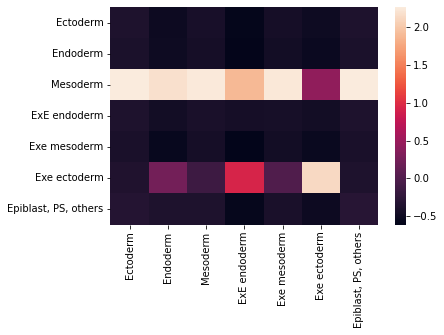

4
genes used


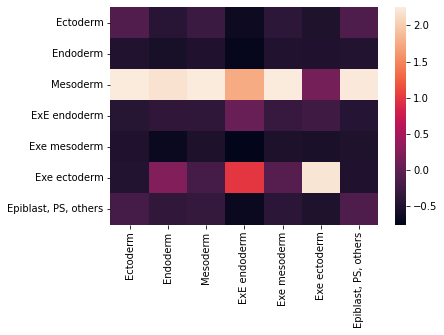

7
genes used


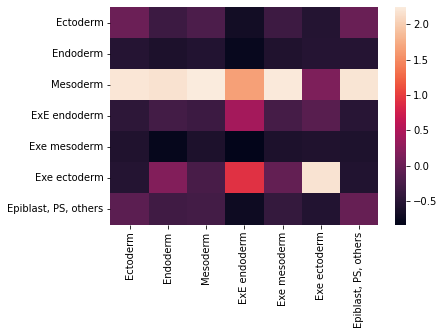

10
genes used


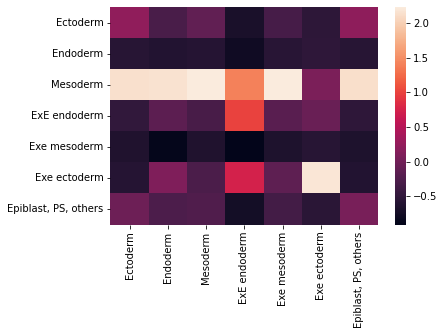

13
genes used


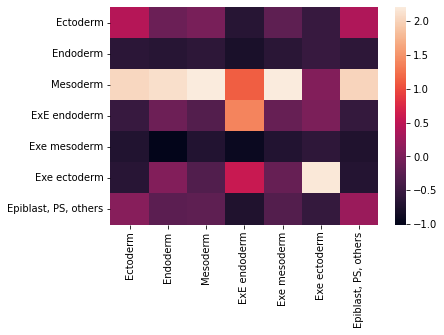

16
genes used


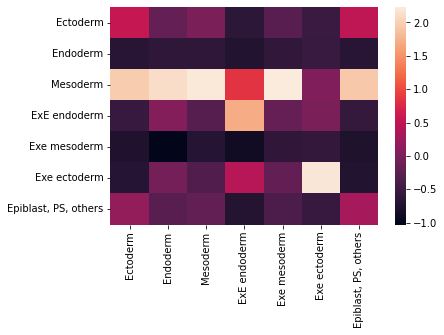

19
genes used


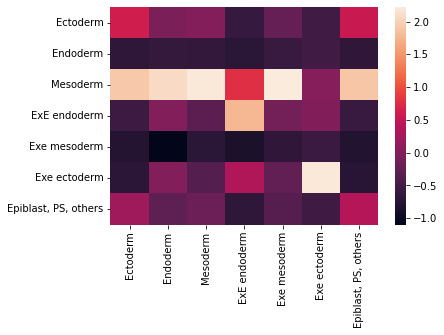

22
genes used


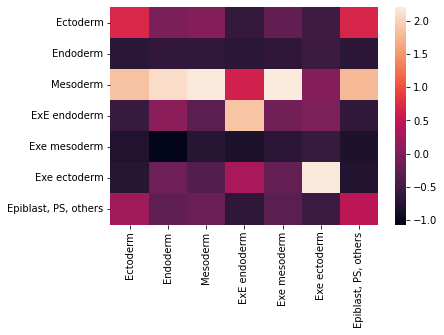

25
genes used


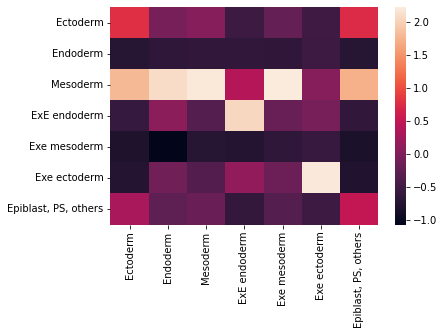

28
genes used


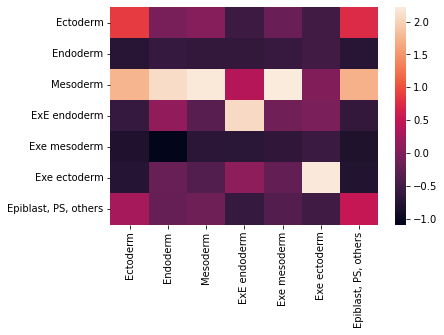

31
genes used


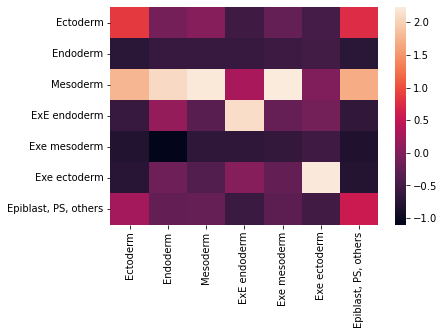

34
genes used


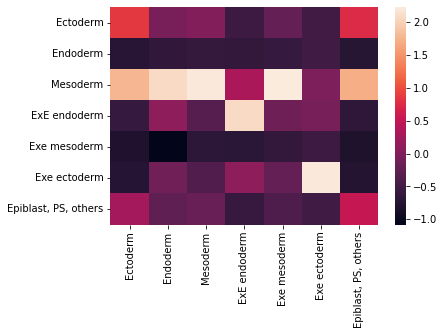

37
genes used


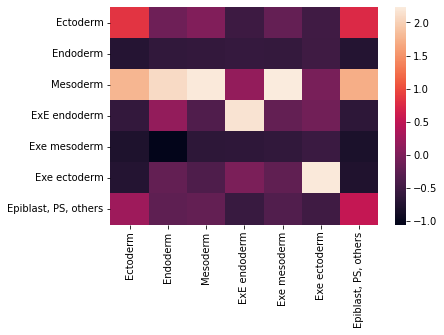

40
genes used


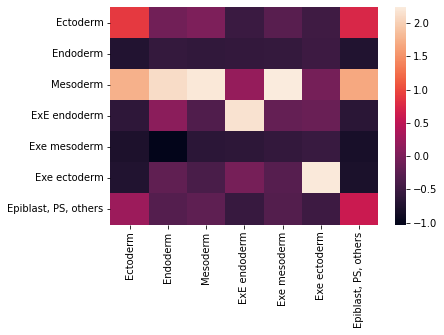

43
genes used


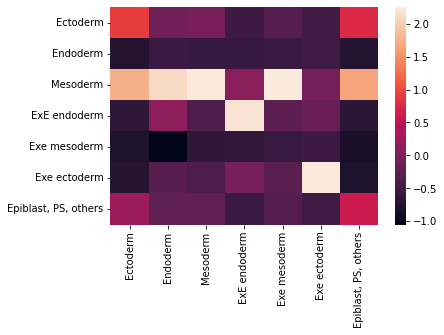

46
genes used


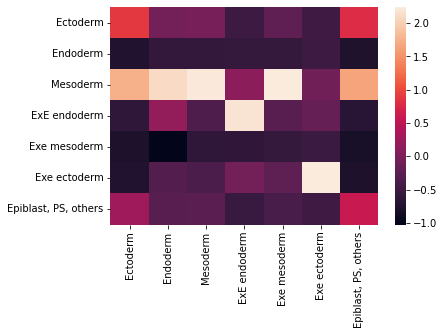

49
genes used


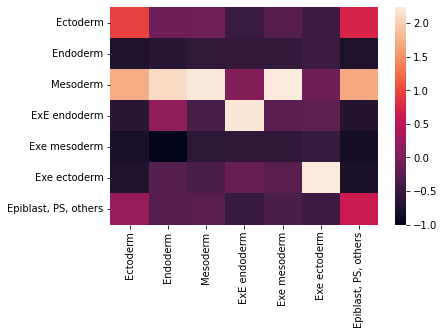

52
genes used


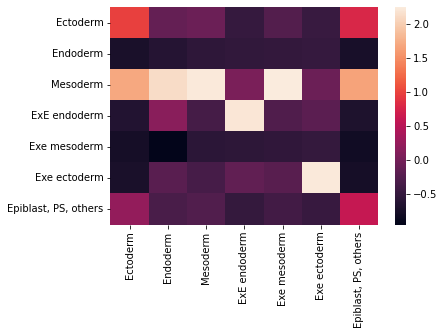

55
genes used


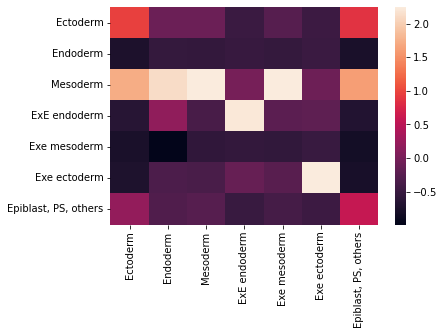

58
genes used


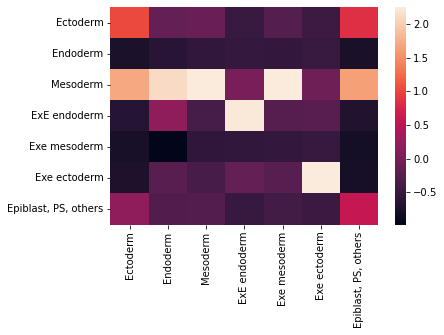

61
genes used


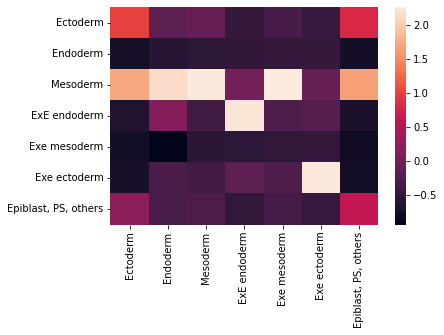

64
genes used


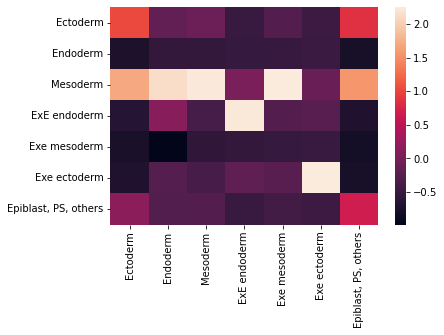

67
genes used


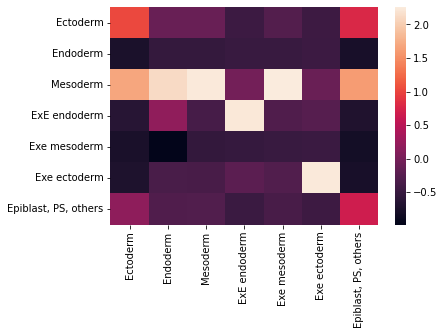

70
genes used


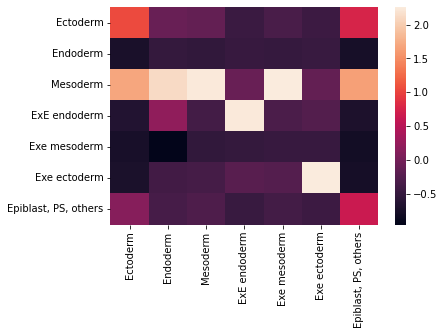

73
genes used


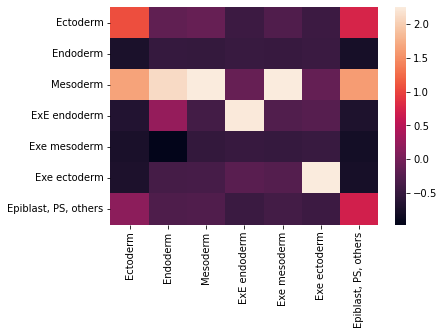

76
genes used


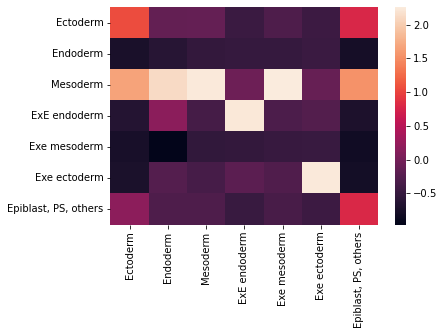

79
genes used


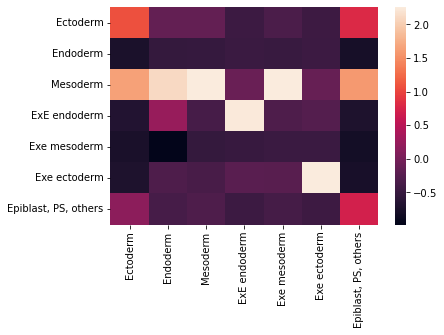

82
genes used


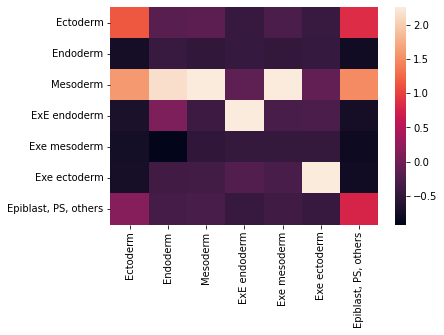

85
genes used


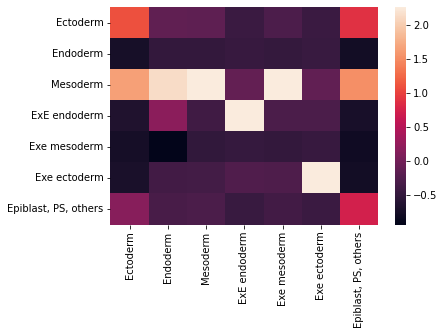

88
genes used


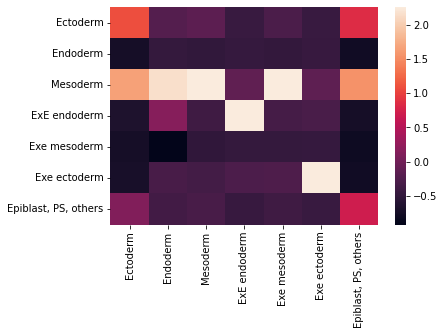

91
genes used


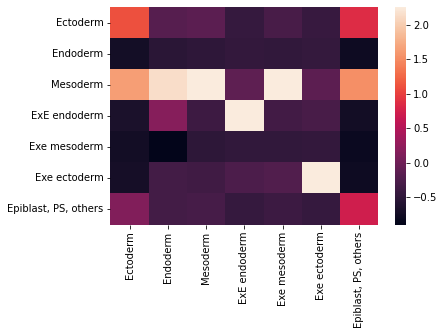

94
genes used


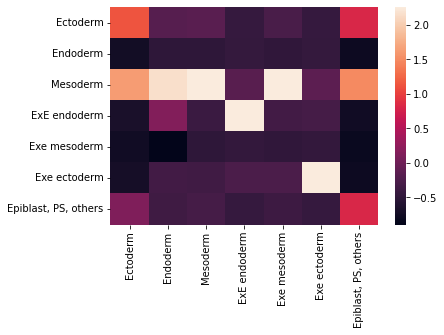

97
genes used


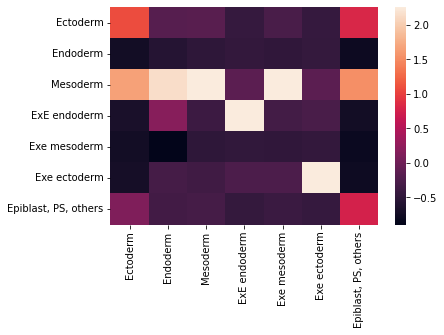

In [75]:
heatmaps(RNA_info[3],RNA_info[4],592*200)

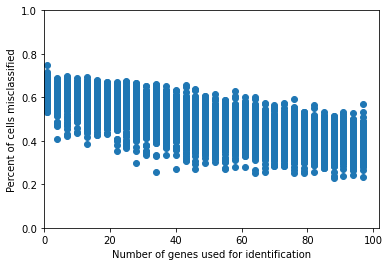

In [61]:
scatter(RNA_genes,RNA_info[0])

In [62]:
SVM_info = randomForestClassifier(SVM_genes)

26400 seconds to finish
440.0 minutes to finish
7.333333333333333 hours to finish

iteration number: 0
1 genes used
ACCURACY OF THE MODEL:  0.3733108108108108
371 cells misclassified
Total run time: 0.3527 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 28, 'Mesoderm': 34, 'Exe endoderm': 39, 'Exe mesoderm': 6, 'Exe ectoderm': 94, 'nan': 0, 'Epiblast, PS, others': 86}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 1, 'Mesoderm': 294, 'Exe endoderm': 38, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 6}

iteration number: 1
1 genes used
ACCURACY OF THE MODEL:  0.36824324324324326
374 cells misclassified
Total run time: 0.2941 seconds
cells misclassified:
{'Ectoderm': 92, 'Endoderm': 33, 'Mesoderm': 33, 'Exe endoderm': 87, 'Exe mesoderm': 12, 'Exe ectoderm': 42, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 0, 'Mesoderm': 265, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 70, 'nan':

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 0.3583 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 24, 'Mesoderm': 48, 'Exe endoderm': 40, 'Exe mesoderm': 6, 'Exe ectoderm': 30, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 97, 'Endoderm': 0, 'Mesoderm': 58, 'Exe endoderm': 52, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 19
1 genes used
ACCURACY OF THE MODEL:  0.34290540540540543
389 cells misclassified
Total run time: 0.3470 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 34, 'Mesoderm': 43, 'Exe endoderm': 71, 'Exe mesoderm': 10, 'Exe ectoderm': 68, 'nan': 0, 'Epiblast, PS, others': 79}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 6, 'Mesoderm': 258, 'Exe endoderm': 56, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 20
1 genes used
ACCURACY OF THE MODEL:  0.2905405405405405
420 

ACCURACY OF THE MODEL:  0.34628378378378377
387 cells misclassified
Total run time: 0.3478 seconds
cells misclassified:
{'Ectoderm': 108, 'Endoderm': 29, 'Mesoderm': 29, 'Exe endoderm': 79, 'Exe mesoderm': 5, 'Exe ectoderm': 55, 'nan': 0, 'Epiblast, PS, others': 82}
cells being misclassified as:
{'Ectoderm': 5, 'Endoderm': 0, 'Mesoderm': 306, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 43, 'nan': 0, 'Epiblast, PS, others': 7}

iteration number: 37
1 genes used
ACCURACY OF THE MODEL:  0.36486486486486486
376 cells misclassified
Total run time: 0.3897 seconds
cells misclassified:
{'Ectoderm': 87, 'Endoderm': 36, 'Mesoderm': 57, 'Exe endoderm': 68, 'Exe mesoderm': 8, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 1, 'Mesoderm': 266, 'Exe endoderm': 44, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 6}

iteration number: 38
1 genes used
ACCURACY OF THE MODEL:  0.3547297297297297
382 c

ACCURACY OF THE MODEL:  0.3918918918918919
360 cells misclassified
Total run time: 0.3969 seconds
cells misclassified:
{'Ectoderm': 93, 'Endoderm': 30, 'Mesoderm': 62, 'Exe endoderm': 57, 'Exe mesoderm': 11, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 1, 'Mesoderm': 241, 'Exe endoderm': 31, 'Exe mesoderm': 0, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 55
1 genes used
ACCURACY OF THE MODEL:  0.46621621621621623
316 cells misclassified
Total run time: 0.3638 seconds
cells misclassified:
{'Ectoderm': 85, 'Endoderm': 32, 'Mesoderm': 39, 'Exe endoderm': 4, 'Exe mesoderm': 9, 'Exe ectoderm': 71, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 4, 'Mesoderm': 236, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 56
1 genes used
ACCURACY OF THE MODEL:  0.28040540540540543
426

ACCURACY OF THE MODEL:  0.32094594594594594
402 cells misclassified
Total run time: 0.3131 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 35, 'Mesoderm': 29, 'Exe endoderm': 81, 'Exe mesoderm': 5, 'Exe ectoderm': 100, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 3, 'Mesoderm': 304, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 73
1 genes used
ACCURACY OF THE MODEL:  0.48817567567567566
303 cells misclassified
Total run time: 0.2864 seconds
cells misclassified:
{'Ectoderm': 90, 'Endoderm': 29, 'Mesoderm': 22, 'Exe endoderm': 67, 'Exe mesoderm': 9, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 81}
cells being misclassified as:
{'Ectoderm': 12, 'Endoderm': 0, 'Mesoderm': 222, 'Exe endoderm': 50, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 74
1 genes used
ACCURACY OF THE MODEL:  0.24662162162162163
446 c

ACCURACY OF THE MODEL:  0.4391891891891892
332 cells misclassified
Total run time: 0.3171 seconds
cells misclassified:
{'Ectoderm': 96, 'Endoderm': 36, 'Mesoderm': 39, 'Exe endoderm': 18, 'Exe mesoderm': 3, 'Exe ectoderm': 56, 'nan': 0, 'Epiblast, PS, others': 84}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 225, 'Exe endoderm': 73, 'Exe mesoderm': 0, 'Exe ectoderm': 31, 'nan': 0, 'Epiblast, PS, others': 2}

iteration number: 91
1 genes used
ACCURACY OF THE MODEL:  0.40878378378378377
350 cells misclassified
Total run time: 0.3294 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 40, 'Mesoderm': 27, 'Exe endoderm': 66, 'Exe mesoderm': 6, 'Exe ectoderm': 51, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 0, 'Mesoderm': 269, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 27, 'nan': 0, 'Epiblast, PS, others': 3}

iteration number: 92
1 genes used
ACCURACY OF THE MODEL:  0.3581081081081081
380 cel

ACCURACY OF THE MODEL:  0.34797297297297297
386 cells misclassified
Total run time: 0.2941 seconds
cells misclassified:
{'Ectoderm': 92, 'Endoderm': 35, 'Mesoderm': 36, 'Exe endoderm': 55, 'Exe mesoderm': 6, 'Exe ectoderm': 81, 'nan': 0, 'Epiblast, PS, others': 81}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 281, 'Exe endoderm': 89, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 109
1 genes used
ACCURACY OF THE MODEL:  0.4341216216216216
335 cells misclassified
Total run time: 0.3067 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 26, 'Mesoderm': 92, 'Exe endoderm': 61, 'Exe mesoderm': 12, 'Exe ectoderm': 45, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 0, 'Mesoderm': 124, 'Exe endoderm': 71, 'Exe mesoderm': 0, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 110
1 genes used
ACCURACY OF THE MODEL:  0.5101351351351351
290

ACCURACY OF THE MODEL:  0.3766891891891892
369 cells misclassified
Total run time: 0.3040 seconds
cells misclassified:
{'Ectoderm': 108, 'Endoderm': 26, 'Mesoderm': 32, 'Exe endoderm': 73, 'Exe mesoderm': 6, 'Exe ectoderm': 48, 'nan': 0, 'Epiblast, PS, others': 76}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 0, 'Mesoderm': 281, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 44, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 127
1 genes used
ACCURACY OF THE MODEL:  0.3344594594594595
394 cells misclassified
Total run time: 0.3653 seconds
cells misclassified:
{'Ectoderm': 81, 'Endoderm': 35, 'Mesoderm': 35, 'Exe endoderm': 85, 'Exe mesoderm': 5, 'Exe ectoderm': 70, 'nan': 0, 'Epiblast, PS, others': 83}
cells being misclassified as:
{'Ectoderm': 13, 'Endoderm': 0, 'Mesoderm': 304, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 57, 'nan': 0, 'Epiblast, PS, others': 3}

iteration number: 128
1 genes used
ACCURACY OF THE MODEL:  0.4780405405405405
309 

ACCURACY OF THE MODEL:  0.4527027027027027
324 cells misclassified
Total run time: 0.2924 seconds
cells misclassified:
{'Ectoderm': 89, 'Endoderm': 38, 'Mesoderm': 31, 'Exe endoderm': 73, 'Exe mesoderm': 9, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 74}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 0, 'Mesoderm': 221, 'Exe endoderm': 60, 'Exe mesoderm': 0, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 145
1 genes used
ACCURACY OF THE MODEL:  0.3125
407 cells misclassified
Total run time: 0.3919 seconds
cells misclassified:
{'Ectoderm': 95, 'Endoderm': 32, 'Mesoderm': 53, 'Exe endoderm': 41, 'Exe mesoderm': 6, 'Exe ectoderm': 102, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 0, 'Mesoderm': 270, 'Exe endoderm': 69, 'Exe mesoderm': 0, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 146
1 genes used
ACCURACY OF THE MODEL:  0.4408783783783784
331 cells miscl

ACCURACY OF THE MODEL:  0.38513513513513514
364 cells misclassified
Total run time: 0.2975 seconds
cells misclassified:
{'Ectoderm': 96, 'Endoderm': 22, 'Mesoderm': 40, 'Exe endoderm': 87, 'Exe mesoderm': 6, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 90}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 310, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 35, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 163
1 genes used
ACCURACY OF THE MODEL:  0.5304054054054054
278 cells misclassified
Total run time: 0.4511 seconds
cells misclassified:
{'Ectoderm': 75, 'Endoderm': 28, 'Mesoderm': 55, 'Exe endoderm': 12, 'Exe mesoderm': 8, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 1, 'Mesoderm': 169, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 38, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 164
1 genes used
ACCURACY OF THE MODEL:  0.36993243243243246
373 

ACCURACY OF THE MODEL:  0.34290540540540543
389 cells misclassified
Total run time: 0.3583 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 31, 'Mesoderm': 43, 'Exe endoderm': 82, 'Exe mesoderm': 6, 'Exe ectoderm': 91, 'nan': 0, 'Epiblast, PS, others': 69}
cells being misclassified as:
{'Ectoderm': 73, 'Endoderm': 1, 'Mesoderm': 250, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 181
1 genes used
ACCURACY OF THE MODEL:  0.3141891891891892
406 cells misclassified
Total run time: 0.3939 seconds
cells misclassified:
{'Ectoderm': 84, 'Endoderm': 32, 'Mesoderm': 64, 'Exe endoderm': 59, 'Exe mesoderm': 9, 'Exe ectoderm': 80, 'nan': 0, 'Epiblast, PS, others': 78}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 1, 'Mesoderm': 267, 'Exe endoderm': 74, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 182
1 genes used
ACCURACY OF THE MODEL:  0.39864864864864863
3

ACCURACY OF THE MODEL:  0.46959459459459457
314 cells misclassified
Total run time: 0.3208 seconds
cells misclassified:
{'Ectoderm': 88, 'Endoderm': 27, 'Mesoderm': 27, 'Exe endoderm': 4, 'Exe mesoderm': 8, 'Exe ectoderm': 73, 'nan': 0, 'Epiblast, PS, others': 87}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 1, 'Mesoderm': 258, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 29, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 199
1 genes used
ACCURACY OF THE MODEL:  0.3141891891891892
406 cells misclassified
Total run time: 0.3121 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 29, 'Mesoderm': 79, 'Exe endoderm': 54, 'Exe mesoderm': 6, 'Exe ectoderm': 97, 'nan': 0, 'Epiblast, PS, others': 84}
cells being misclassified as:
{'Ectoderm': 80, 'Endoderm': 5, 'Mesoderm': 240, 'Exe endoderm': 68, 'Exe mesoderm': 0, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 200
4 genes used
ACCURACY OF THE MODEL:  0.4527027027027027
324 ce

ACCURACY OF THE MODEL:  0.6317567567567568
218 cells misclassified
Total run time: 0.8214 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 15, 'Mesoderm': 72, 'Exe endoderm': 11, 'Exe mesoderm': 8, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 47}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 8, 'Mesoderm': 76, 'Exe endoderm': 16, 'Exe mesoderm': 2, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 217
4 genes used
ACCURACY OF THE MODEL:  0.48986486486486486
302 cells misclassified
Total run time: 0.8684 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 26, 'Mesoderm': 62, 'Exe endoderm': 44, 'Exe mesoderm': 11, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 66, 'Endoderm': 8, 'Mesoderm': 102, 'Exe endoderm': 58, 'Exe mesoderm': 2, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 50}

iteration number: 218
4 genes used
ACCURACY OF THE MODEL:  0.581081081081081
248

ACCURACY OF THE MODEL:  0.652027027027027
206 cells misclassified
Total run time: 0.8454 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 22, 'Mesoderm': 35, 'Exe endoderm': 21, 'Exe mesoderm': 8, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 71, 'Endoderm': 8, 'Mesoderm': 48, 'Exe endoderm': 22, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 235
4 genes used
ACCURACY OF THE MODEL:  0.6537162162162162
205 cells misclassified
Total run time: 0.8184 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 27, 'Mesoderm': 49, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 61}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 3, 'Mesoderm': 91, 'Exe endoderm': 4, 'Exe mesoderm': 1, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 236
4 genes used
ACCURACY OF THE MODEL:  0.5675675675675675
256 cells 

ACCURACY OF THE MODEL:  0.6706081081081081
195 cells misclassified
Total run time: 0.8753 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 18, 'Mesoderm': 48, 'Exe endoderm': 4, 'Exe mesoderm': 7, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 8, 'Mesoderm': 66, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 51}

iteration number: 253
4 genes used
ACCURACY OF THE MODEL:  0.5405405405405406
272 cells misclassified
Total run time: 0.8813 seconds
cells misclassified:
{'Ectoderm': 66, 'Endoderm': 17, 'Mesoderm': 78, 'Exe endoderm': 25, 'Exe mesoderm': 4, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 81}
cells being misclassified as:
{'Ectoderm': 70, 'Endoderm': 12, 'Mesoderm': 130, 'Exe endoderm': 27, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 254
4 genes used
ACCURACY OF THE MODEL:  0.7280405405405406
161 cel

ACCURACY OF THE MODEL:  0.6891891891891891
184 cells misclassified
Total run time: 0.7920 seconds
cells misclassified:
{'Ectoderm': 55, 'Endoderm': 18, 'Mesoderm': 47, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 24, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 8, 'Mesoderm': 58, 'Exe endoderm': 2, 'Exe mesoderm': 2, 'Exe ectoderm': 34, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 271
4 genes used
ACCURACY OF THE MODEL:  0.643581081081081
211 cells misclassified
Total run time: 0.9394 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 24, 'Mesoderm': 51, 'Exe endoderm': 7, 'Exe mesoderm': 12, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 55}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 9, 'Mesoderm': 98, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 272
4 genes used
ACCURACY OF THE MODEL:  0.5067567567567568
292 cells m

ACCURACY OF THE MODEL:  0.5591216216216216
261 cells misclassified
Total run time: 0.8189 seconds
cells misclassified:
{'Ectoderm': 61, 'Endoderm': 27, 'Mesoderm': 80, 'Exe endoderm': 44, 'Exe mesoderm': 8, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 53, 'Endoderm': 14, 'Mesoderm': 93, 'Exe endoderm': 38, 'Exe mesoderm': 2, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 289
4 genes used
ACCURACY OF THE MODEL:  0.6081081081081081
232 cells misclassified
Total run time: 0.9948 seconds
cells misclassified:
{'Ectoderm': 60, 'Endoderm': 27, 'Mesoderm': 54, 'Exe endoderm': 14, 'Exe mesoderm': 4, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 5, 'Mesoderm': 113, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 290
4 genes used
ACCURACY OF THE MODEL:  0.6182432432432432
226 ce

ACCURACY OF THE MODEL:  0.5506756756756757
266 cells misclassified
Total run time: 0.9809 seconds
cells misclassified:
{'Ectoderm': 71, 'Endoderm': 30, 'Mesoderm': 49, 'Exe endoderm': 21, 'Exe mesoderm': 7, 'Exe ectoderm': 21, 'nan': 0, 'Epiblast, PS, others': 67}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 5, 'Mesoderm': 112, 'Exe endoderm': 22, 'Exe mesoderm': 1, 'Exe ectoderm': 25, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 307
4 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.3869 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 308
4 genes used
ACCURACY OF THE MODEL:  0.527027027027027
280 cells misclassified
Total run

ACCURACY OF THE MODEL:  0.38513513513513514
364 cells misclassified
Total run time: 1.1080 seconds
cells misclassified:
{'Ectoderm': 83, 'Endoderm': 28, 'Mesoderm': 77, 'Exe endoderm': 18, 'Exe mesoderm': 8, 'Exe ectoderm': 78, 'nan': 0, 'Epiblast, PS, others': 72}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 10, 'Mesoderm': 162, 'Exe endoderm': 30, 'Exe mesoderm': 2, 'Exe ectoderm': 47, 'nan': 0, 'Epiblast, PS, others': 66}

iteration number: 325
4 genes used
ACCURACY OF THE MODEL:  0.5320945945945946
277 cells misclassified
Total run time: 0.8735 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 25, 'Mesoderm': 86, 'Exe endoderm': 2, 'Exe mesoderm': 5, 'Exe ectoderm': 52, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 12, 'Mesoderm': 111, 'Exe endoderm': 4, 'Exe mesoderm': 4, 'Exe ectoderm': 41, 'nan': 0, 'Epiblast, PS, others': 49}

iteration number: 326
4 genes used
ACCURACY OF THE MODEL:  0.5236486486486487
28

ACCURACY OF THE MODEL:  0.6334459459459459
217 cells misclassified
Total run time: 0.7926 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 22, 'Mesoderm': 35, 'Exe endoderm': 42, 'Exe mesoderm': 5, 'Exe ectoderm': 11, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 10, 'Mesoderm': 69, 'Exe endoderm': 42, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 343
4 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.3813 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 344
4 genes used
ACCURACY OF THE MODEL:  0.6114864864864865
230 cells misclassified
Total run

ACCURACY OF THE MODEL:  0.6554054054054054
204 cells misclassified
Total run time: 0.8960 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 13, 'Mesoderm': 62, 'Exe endoderm': 8, 'Exe mesoderm': 4, 'Exe ectoderm': 13, 'nan': 0, 'Epiblast, PS, others': 58}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 10, 'Mesoderm': 80, 'Exe endoderm': 17, 'Exe mesoderm': 0, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 361
4 genes used
ACCURACY OF THE MODEL:  0.5253378378378378
281 cells misclassified
Total run time: 0.8509 seconds
cells misclassified:
{'Ectoderm': 77, 'Endoderm': 15, 'Mesoderm': 70, 'Exe endoderm': 42, 'Exe mesoderm': 7, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 11, 'Mesoderm': 78, 'Exe endoderm': 70, 'Exe mesoderm': 4, 'Exe ectoderm': 23, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 362
4 genes used
ACCURACY OF THE MODEL:  0.5337837837837838
276 

ACCURACY OF THE MODEL:  0.6013513513513513
236 cells misclassified
Total run time: 0.8721 seconds
cells misclassified:
{'Ectoderm': 73, 'Endoderm': 21, 'Mesoderm': 65, 'Exe endoderm': 3, 'Exe mesoderm': 6, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 65}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 7, 'Mesoderm': 117, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 47}

iteration number: 379
4 genes used
ACCURACY OF THE MODEL:  0.6756756756756757
192 cells misclassified
Total run time: 0.8027 seconds
cells misclassified:
{'Ectoderm': 52, 'Endoderm': 22, 'Mesoderm': 53, 'Exe endoderm': 3, 'Exe mesoderm': 9, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 3, 'Mesoderm': 78, 'Exe endoderm': 12, 'Exe mesoderm': 2, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 380
4 genes used
ACCURACY OF THE MODEL:  0.6993243243243243
178 cells 

ACCURACY OF THE MODEL:  0.5050675675675675
293 cells misclassified
Total run time: 0.9904 seconds
cells misclassified:
{'Ectoderm': 70, 'Endoderm': 32, 'Mesoderm': 70, 'Exe endoderm': 20, 'Exe mesoderm': 7, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 68}
cells being misclassified as:
{'Ectoderm': 56, 'Endoderm': 2, 'Mesoderm': 143, 'Exe endoderm': 33, 'Exe mesoderm': 0, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 397
4 genes used
ACCURACY OF THE MODEL:  0.6469594594594594
209 cells misclassified
Total run time: 0.8665 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 17, 'Mesoderm': 33, 'Exe endoderm': 36, 'Exe mesoderm': 9, 'Exe ectoderm': 20, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 16, 'Mesoderm': 62, 'Exe endoderm': 46, 'Exe mesoderm': 1, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 398
4 genes used
ACCURACY OF THE MODEL:  0.46621621621621623
31

ACCURACY OF THE MODEL:  0.75
148 cells misclassified
Total run time: 0.8027 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 16, 'Mesoderm': 28, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 7, 'Mesoderm': 58, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 42}

iteration number: 415
7 genes used
ACCURACY OF THE MODEL:  0.7550675675675675
145 cells misclassified
Total run time: 0.8643 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 21, 'Mesoderm': 22, 'Exe endoderm': 2, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 3, 'Mesoderm': 55, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 416
7 genes used
ACCURACY OF THE MODEL:  0.6976351351351351
179 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.7347972972972973
157 cells misclassified
Total run time: 0.8621 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 19, 'Mesoderm': 31, 'Exe endoderm': 9, 'Exe mesoderm': 6, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 8, 'Mesoderm': 78, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 433
7 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.4711 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 434
7 genes used
ACCURACY OF THE MODEL:  0.7331081081081081
158 cells misclassi

ACCURACY OF THE MODEL:  0.625
222 cells misclassified
Total run time: 0.9203 seconds
cells misclassified:
{'Ectoderm': 67, 'Endoderm': 38, 'Mesoderm': 31, 'Exe endoderm': 18, 'Exe mesoderm': 15, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 2, 'Mesoderm': 112, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 451
7 genes used
ACCURACY OF THE MODEL:  0.597972972972973
238 cells misclassified
Total run time: 0.9562 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 26, 'Mesoderm': 57, 'Exe endoderm': 47, 'Exe mesoderm': 4, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 57}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 4, 'Mesoderm': 112, 'Exe endoderm': 55, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 452
7 genes used
ACCURACY OF THE MODEL:  0.7567567567567568
144 cells misclas

ACCURACY OF THE MODEL:  0.8209459459459459
106 cells misclassified
Total run time: 0.7020 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 14, 'Mesoderm': 15, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 9, 'Mesoderm': 37, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 469
7 genes used
ACCURACY OF THE MODEL:  0.7381756756756757
155 cells misclassified
Total run time: 0.8337 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 13, 'Mesoderm': 43, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 4, 'Mesoderm': 57, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 43}

iteration number: 470
7 genes used
ACCURACY OF THE MODEL:  0.7702702702702703
136 cells mis

ACCURACY OF THE MODEL:  0.7364864864864865
156 cells misclassified
Total run time: 0.8540 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 23, 'Mesoderm': 38, 'Exe endoderm': 2, 'Exe mesoderm': 6, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 5, 'Mesoderm': 79, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 487
7 genes used
ACCURACY OF THE MODEL:  0.6739864864864865
193 cells misclassified
Total run time: 0.8782 seconds
cells misclassified:
{'Ectoderm': 78, 'Endoderm': 19, 'Mesoderm': 28, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 5, 'Mesoderm': 100, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 39}

iteration number: 488
7 genes used
ACCURACY OF THE MODEL:  0.722972972972973
164 cells mis

ACCURACY OF THE MODEL:  0.6081081081081081
232 cells misclassified
Total run time: 0.9595 seconds
cells misclassified:
{'Ectoderm': 56, 'Endoderm': 20, 'Mesoderm': 57, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 26, 'nan': 0, 'Epiblast, PS, others': 62}
cells being misclassified as:
{'Ectoderm': 67, 'Endoderm': 7, 'Mesoderm': 102, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 22, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 505
7 genes used
ACCURACY OF THE MODEL:  0.6773648648648649
191 cells misclassified
Total run time: 0.9502 seconds
cells misclassified:
{'Ectoderm': 59, 'Endoderm': 20, 'Mesoderm': 42, 'Exe endoderm': 4, 'Exe mesoderm': 9, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 5, 'Mesoderm': 91, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 41}

iteration number: 506
7 genes used
ACCURACY OF THE MODEL:  0.6655405405405406
198 cells

ACCURACY OF THE MODEL:  0.6469594594594594
209 cells misclassified
Total run time: 0.8911 seconds
cells misclassified:
{'Ectoderm': 58, 'Endoderm': 17, 'Mesoderm': 38, 'Exe endoderm': 38, 'Exe mesoderm': 8, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 5, 'Mesoderm': 90, 'Exe endoderm': 30, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 523
7 genes used
ACCURACY OF THE MODEL:  0.7652027027027027
139 cells misclassified
Total run time: 0.9129 seconds
cells misclassified:
{'Ectoderm': 45, 'Endoderm': 19, 'Mesoderm': 26, 'Exe endoderm': 17, 'Exe mesoderm': 6, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 9, 'Mesoderm': 53, 'Exe endoderm': 19, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 524
7 genes used
ACCURACY OF THE MODEL:  0.6655405405405406
198 cel

ACCURACY OF THE MODEL:  0.6672297297297297
197 cells misclassified
Total run time: 0.9229 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 10, 'Mesoderm': 53, 'Exe endoderm': 17, 'Exe mesoderm': 7, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 9, 'Mesoderm': 64, 'Exe endoderm': 18, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 40}

iteration number: 541
7 genes used
ACCURACY OF THE MODEL:  0.7787162162162162
131 cells misclassified
Total run time: 0.8700 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 18, 'Mesoderm': 26, 'Exe endoderm': 2, 'Exe mesoderm': 5, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 4, 'Mesoderm': 42, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 542
7 genes used
ACCURACY OF THE MODEL:  0.7567567567567568
144 cells

ACCURACY OF THE MODEL:  0.6334459459459459
217 cells misclassified
Total run time: 0.9427 seconds
cells misclassified:
{'Ectoderm': 65, 'Endoderm': 25, 'Mesoderm': 65, 'Exe endoderm': 6, 'Exe mesoderm': 10, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 58, 'Endoderm': 6, 'Mesoderm': 95, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 14, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 559
7 genes used
ACCURACY OF THE MODEL:  0.6334459459459459
217 cells misclassified
Total run time: 0.9221 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 30, 'Mesoderm': 48, 'Exe endoderm': 16, 'Exe mesoderm': 5, 'Exe ectoderm': 18, 'nan': 0, 'Epiblast, PS, others': 56}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 7, 'Mesoderm': 87, 'Exe endoderm': 16, 'Exe mesoderm': 0, 'Exe ectoderm': 33, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 560
7 genes used
ACCURACY OF THE MODEL:  0.7466216216216216
150 ce

ACCURACY OF THE MODEL:  0.7719594594594594
135 cells misclassified
Total run time: 0.8604 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 9, 'Mesoderm': 28, 'Exe endoderm': 2, 'Exe mesoderm': 6, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 59, 'Endoderm': 5, 'Mesoderm': 38, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 577
7 genes used
ACCURACY OF THE MODEL:  0.6148648648648649
228 cells misclassified
Total run time: 0.9664 seconds
cells misclassified:
{'Ectoderm': 53, 'Endoderm': 25, 'Mesoderm': 64, 'Exe endoderm': 17, 'Exe mesoderm': 6, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 59}
cells being misclassified as:
{'Ectoderm': 72, 'Endoderm': 7, 'Mesoderm': 92, 'Exe endoderm': 26, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 578
7 genes used
ACCURACY OF THE MODEL:  0.6672297297297297
197 cells mi

ACCURACY OF THE MODEL:  0.7077702702702703
173 cells misclassified
Total run time: 0.8676 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 17, 'Mesoderm': 35, 'Exe endoderm': 2, 'Exe mesoderm': 13, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 52}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 5, 'Mesoderm': 79, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 595
7 genes used
ACCURACY OF THE MODEL:  0.6807432432432432
189 cells misclassified
Total run time: 0.9136 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 18, 'Mesoderm': 54, 'Exe endoderm': 19, 'Exe mesoderm': 7, 'Exe ectoderm': 15, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 7, 'Mesoderm': 69, 'Exe endoderm': 24, 'Exe mesoderm': 0, 'Exe ectoderm': 12, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 596
7 genes used
ACCURACY OF THE MODEL:  0.7381756756756757
155 cell

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.5327 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 613
10 genes used
ACCURACY OF THE MODEL:  0.8243243243243243
104 cells misclassified
Total run time: 1.0587 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 8, 'Mesoderm': 28, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 4, 'Mesoderm': 32, 'Exe endoderm': 2, 'Exe mesoderm': 1, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 614
10 genes used
ACCURACY OF THE MODEL:  0.7871621621621622
126 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.7179054054054054
167 cells misclassified
Total run time: 1.1421 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 22, 'Mesoderm': 37, 'Exe endoderm': 4, 'Exe mesoderm': 8, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 5, 'Mesoderm': 64, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 631
10 genes used
ACCURACY OF THE MODEL:  0.7550675675675675
145 cells misclassified
Total run time: 1.0972 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 22, 'Mesoderm': 32, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 1, 'Mesoderm': 58, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 632
10 genes used
ACCURACY OF THE MODEL:  0.7010135135135135
177 cells 

ACCURACY OF THE MODEL:  0.7364864864864865
156 cells misclassified
Total run time: 1.1182 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 22, 'Mesoderm': 38, 'Exe endoderm': 18, 'Exe mesoderm': 9, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 3, 'Mesoderm': 58, 'Exe endoderm': 25, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 29}

iteration number: 649
10 genes used
ACCURACY OF THE MODEL:  0.831081081081081
100 cells misclassified
Total run time: 0.9990 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 9, 'Mesoderm': 14, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 4, 'Mesoderm': 36, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 650
10 genes used
ACCURACY OF THE MODEL:  0.8006756756756757
118 cells m

ACCURACY OF THE MODEL:  0.714527027027027
169 cells misclassified
Total run time: 1.1400 seconds
cells misclassified:
{'Ectoderm': 47, 'Endoderm': 14, 'Mesoderm': 34, 'Exe endoderm': 6, 'Exe mesoderm': 4, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 60}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 10, 'Mesoderm': 75, 'Exe endoderm': 9, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 667
10 genes used
ACCURACY OF THE MODEL:  0.6165540540540541
227 cells misclassified
Total run time: 1.2383 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 25, 'Mesoderm': 41, 'Exe endoderm': 14, 'Exe mesoderm': 7, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 73}
cells being misclassified as:
{'Ectoderm': 46, 'Endoderm': 3, 'Mesoderm': 114, 'Exe endoderm': 21, 'Exe mesoderm': 0, 'Exe ectoderm': 16, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 668
10 genes used
ACCURACY OF THE MODEL:  0.7601351351351351
142 ce

ACCURACY OF THE MODEL:  0.6976351351351351
179 cells misclassified
Total run time: 1.0726 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 25, 'Mesoderm': 50, 'Exe endoderm': 3, 'Exe mesoderm': 8, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 50, 'Endoderm': 1, 'Mesoderm': 76, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 45}

iteration number: 685
10 genes used
ACCURACY OF THE MODEL:  0.731418918918919
159 cells misclassified
Total run time: 1.1618 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 28, 'Mesoderm': 42, 'Exe endoderm': 5, 'Exe mesoderm': 5, 'Exe ectoderm': 19, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 57, 'Endoderm': 4, 'Mesoderm': 52, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 686
10 genes used
ACCURACY OF THE MODEL:  0.7449324324324325
151 cells

ACCURACY OF THE MODEL:  0.8141891891891891
110 cells misclassified
Total run time: 1.0398 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 15, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 0, 'Mesoderm': 42, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 703
10 genes used
ACCURACY OF THE MODEL:  0.7972972972972973
120 cells misclassified
Total run time: 1.0232 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 18, 'Mesoderm': 17, 'Exe endoderm': 5, 'Exe mesoderm': 10, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 3, 'Mesoderm': 38, 'Exe endoderm': 23, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 704
10 genes used
ACCURACY OF THE MODEL:  0.7618243243243243
141 cells

ACCURACY OF THE MODEL:  0.7635135135135135
140 cells misclassified
Total run time: 1.0892 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 13, 'Mesoderm': 25, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 3, 'Mesoderm': 54, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 721
10 genes used
ACCURACY OF THE MODEL:  0.7567567567567568
144 cells misclassified
Total run time: 1.0410 seconds
cells misclassified:
{'Ectoderm': 44, 'Endoderm': 23, 'Mesoderm': 17, 'Exe endoderm': 7, 'Exe mesoderm': 6, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 5, 'Mesoderm': 72, 'Exe endoderm': 11, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 722
10 genes used
ACCURACY OF THE MODEL:  0.7179054054054054
167 cells

ACCURACY OF THE MODEL:  0.7837837837837838
128 cells misclassified
Total run time: 1.0897 seconds
cells misclassified:
{'Ectoderm': 39, 'Endoderm': 20, 'Mesoderm': 16, 'Exe endoderm': 2, 'Exe mesoderm': 4, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 4, 'Mesoderm': 40, 'Exe endoderm': 14, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 739
10 genes used
ACCURACY OF THE MODEL:  0.7837837837837838
128 cells misclassified
Total run time: 1.0671 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 8, 'Mesoderm': 22, 'Exe endoderm': 9, 'Exe mesoderm': 10, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 3, 'Mesoderm': 43, 'Exe endoderm': 15, 'Exe mesoderm': 0, 'Exe ectoderm': 10, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 740
10 genes used
ACCURACY OF THE MODEL:  0.7888513513513513
125 cell

ACCURACY OF THE MODEL:  0.7432432432432432
152 cells misclassified
Total run time: 1.1260 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 28, 'Mesoderm': 27, 'Exe endoderm': 4, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 49, 'Endoderm': 4, 'Mesoderm': 72, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 757
10 genes used
ACCURACY OF THE MODEL:  0.7668918918918919
138 cells misclassified
Total run time: 1.0865 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 25, 'Mesoderm': 26, 'Exe endoderm': 4, 'Exe mesoderm': 8, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 1, 'Mesoderm': 56, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 758
10 genes used
ACCURACY OF THE MODEL:  0.7905405405405406
124 cells 

ACCURACY OF THE MODEL:  0.7077702702702703
173 cells misclassified
Total run time: 1.1970 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 18, 'Mesoderm': 45, 'Exe endoderm': 15, 'Exe mesoderm': 9, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 6, 'Mesoderm': 75, 'Exe endoderm': 20, 'Exe mesoderm': 0, 'Exe ectoderm': 17, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 775
10 genes used
ACCURACY OF THE MODEL:  0.668918918918919
196 cells misclassified
Total run time: 1.1012 seconds
cells misclassified:
{'Ectoderm': 62, 'Endoderm': 16, 'Mesoderm': 29, 'Exe endoderm': 3, 'Exe mesoderm': 9, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 75}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 4, 'Mesoderm': 90, 'Exe endoderm': 10, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 776
10 genes used
ACCURACY OF THE MODEL:  0.7398648648648649
154 cell

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.6228 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 793
10 genes used
ACCURACY OF THE MODEL:  0.7516891891891891
147 cells misclassified
Total run time: 1.0829 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 21, 'Mesoderm': 31, 'Exe endoderm': 5, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 43}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 8, 'Mesoderm': 62, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 794
10 genes used
ACCURACY OF THE MODEL:  0.8125
111 cells misclassified
Total run time: 0.9465 

ACCURACY OF THE MODEL:  0.8108108108108109
112 cells misclassified
Total run time: 1.0820 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 15, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 4, 'Mesoderm': 45, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 811
13 genes used
ACCURACY OF THE MODEL:  0.8277027027027027
102 cells misclassified
Total run time: 0.9320 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 13, 'Mesoderm': 12, 'Exe endoderm': 5, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 45, 'Endoderm': 5, 'Mesoderm': 31, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 812
13 genes used
ACCURACY OF THE MODEL:  0.8091216216216216
113 cells m

ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Total run time: 1.0313 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 24, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 44}
cells being misclassified as:
{'Ectoderm': 47, 'Endoderm': 2, 'Mesoderm': 40, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 829
13 genes used
ACCURACY OF THE MODEL:  0.8344594594594594
98 cells misclassified
Total run time: 0.9821 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 17, 'Mesoderm': 9, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 4, 'Mesoderm': 38, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 830
13 genes used
ACCURACY OF THE MODEL:  0.777027027027027
132 cells misc

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.7044 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 847
13 genes used
ACCURACY OF THE MODEL:  0.839527027027027
95 cells misclassified
Total run time: 0.9908 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 10, 'Mesoderm': 18, 'Exe endoderm': 2, 'Exe mesoderm': 5, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 5, 'Mesoderm': 42, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 848
13 genes used
ACCURACY OF THE MODEL:  0.8226351351351351
105 cells misclassifie

ACCURACY OF THE MODEL:  0.8209459459459459
106 cells misclassified
Total run time: 0.9717 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 12, 'Mesoderm': 20, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 4, 'Mesoderm': 43, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 865
13 genes used
ACCURACY OF THE MODEL:  0.7280405405405406
161 cells misclassified
Total run time: 1.1026 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 16, 'Mesoderm': 25, 'Exe endoderm': 3, 'Exe mesoderm': 17, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 52, 'Endoderm': 6, 'Mesoderm': 62, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 37}

iteration number: 866
13 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.8158783783783784
109 cells misclassified
Total run time: 1.0543 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 18, 'Mesoderm': 18, 'Exe endoderm': 3, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 5, 'Mesoderm': 40, 'Exe endoderm': 12, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 883
13 genes used
ACCURACY OF THE MODEL:  0.8277027027027027
102 cells misclassified
Total run time: 0.9460 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 10, 'Mesoderm': 19, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 49, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 884
13 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells mi

ACCURACY OF THE MODEL:  0.7027027027027027
176 cells misclassified
Total run time: 1.2696 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 29, 'Mesoderm': 36, 'Exe endoderm': 1, 'Exe mesoderm': 12, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 54}
cells being misclassified as:
{'Ectoderm': 55, 'Endoderm': 1, 'Mesoderm': 93, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 901
13 genes used
ACCURACY OF THE MODEL:  0.8057432432432432
115 cells misclassified
Total run time: 1.1022 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 16, 'Mesoderm': 18, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 3, 'Mesoderm': 45, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 902
13 genes used
ACCURACY OF THE MODEL:  0.8091216216216216
113 cells 

ACCURACY OF THE MODEL:  0.8175675675675675
108 cells misclassified
Total run time: 1.0175 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 22, 'Mesoderm': 12, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 5, 'Mesoderm': 40, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 5, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 919
13 genes used
ACCURACY OF THE MODEL:  0.7618243243243243
141 cells misclassified
Total run time: 1.1670 seconds
cells misclassified:
{'Ectoderm': 48, 'Endoderm': 9, 'Mesoderm': 30, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 4, 'Mesoderm': 68, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 36}

iteration number: 920
13 genes used
ACCURACY OF THE MODEL:  0.7804054054054054
130 cells mi

ACCURACY OF THE MODEL:  0.8175675675675675
108 cells misclassified
Total run time: 0.9871 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 10, 'Mesoderm': 20, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 3, 'Mesoderm': 51, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 937
13 genes used
ACCURACY OF THE MODEL:  0.8496621621621622
89 cells misclassified
Total run time: 0.9849 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 10, 'Mesoderm': 14, 'Exe endoderm': 2, 'Exe mesoderm': 15, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 3, 'Mesoderm': 36, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 938
13 genes used
ACCURACY OF THE MODEL:  0.7922297297297297
123 cells m

ACCURACY OF THE MODEL:  0.7516891891891891
147 cells misclassified
Total run time: 1.0868 seconds
cells misclassified:
{'Ectoderm': 54, 'Endoderm': 11, 'Mesoderm': 23, 'Exe endoderm': 3, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 49}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 2, 'Mesoderm': 70, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 955
13 genes used
ACCURACY OF THE MODEL:  0.8091216216216216
113 cells misclassified
Total run time: 1.0882 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 19, 'Mesoderm': 15, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 2, 'Mesoderm': 45, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 956
13 genes used
ACCURACY OF THE MODEL:  0.75
148 cells misclassified
T

ACCURACY OF THE MODEL:  0.831081081081081
100 cells misclassified
Total run time: 1.0754 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 13, 'Mesoderm': 10, 'Exe endoderm': 3, 'Exe mesoderm': 9, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 5, 'Mesoderm': 48, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 973
13 genes used
ACCURACY OF THE MODEL:  0.7956081081081081
121 cells misclassified
Total run time: 1.0334 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 13, 'Mesoderm': 31, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 4, 'Mesoderm': 41, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 974
13 genes used
ACCURACY OF THE MODEL:  0.7905405405405406
124 cells mi

ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Total run time: 1.0660 seconds
cells misclassified:
{'Ectoderm': 49, 'Endoderm': 17, 'Mesoderm': 14, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 5, 'Mesoderm': 53, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 991
13 genes used
ACCURACY OF THE MODEL:  0.8412162162162162
94 cells misclassified
Total run time: 1.0748 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 11, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 2, 'Mesoderm': 37, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 992
13 genes used
ACCURACY OF THE MODEL:  0.8023648648648649
117 cells mi

ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Total run time: 1.3206 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 14, 'Mesoderm': 23, 'Exe endoderm': 1, 'Exe mesoderm': 13, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 40}
cells being misclassified as:
{'Ectoderm': 54, 'Endoderm': 3, 'Mesoderm': 43, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 1009
16 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.7625 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1010
16 genes used
ACCURACY OF THE MODEL:  0.8074324324324325
114 cells misclassified
Total ru

ACCURACY OF THE MODEL:  0.8378378378378378
96 cells misclassified
Total run time: 1.3125 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 21, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 3, 'Mesoderm': 31, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 1027
16 genes used
ACCURACY OF THE MODEL:  0.8057432432432432
115 cells misclassified
Total run time: 1.2330 seconds
cells misclassified:
{'Ectoderm': 50, 'Endoderm': 7, 'Mesoderm': 14, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 1, 'Mesoderm': 52, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1028
16 genes used
ACCURACY OF THE MODEL:  0.8175675675675675
108 cells m

ACCURACY OF THE MODEL:  0.7956081081081081
121 cells misclassified
Total run time: 1.3244 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 16, 'Mesoderm': 19, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 2, 'Mesoderm': 55, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 1045
16 genes used
ACCURACY OF THE MODEL:  0.8378378378378378
96 cells misclassified
Total run time: 1.2887 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 21, 'Mesoderm': 9, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 1, 'Mesoderm': 51, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 1046
16 genes used
ACCURACY OF THE MODEL:  0.8445945945945946
92 cells mi

ACCURACY OF THE MODEL:  0.8496621621621622
89 cells misclassified
Total run time: 1.3305 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 21, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 4, 'Mesoderm': 38, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1063
16 genes used
ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.3149 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 9, 'Mesoderm': 11, 'Exe endoderm': 4, 'Exe mesoderm': 6, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 2, 'Mesoderm': 28, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1064
16 genes used
ACCURACY OF THE MODEL:  0.8175675675675675
108 cells mi

ACCURACY OF THE MODEL:  0.7787162162162162
131 cells misclassified
Total run time: 1.3715 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 17, 'Mesoderm': 25, 'Exe endoderm': 3, 'Exe mesoderm': 11, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 42, 'Endoderm': 2, 'Mesoderm': 47, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 9, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 1081
16 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.7878 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1082
16 genes used
ACCURACY OF THE MODEL:  0.7432432432432432
152 cells misclassified
Total ru

ACCURACY OF THE MODEL:  0.8175675675675675
108 cells misclassified
Total run time: 1.4005 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 15, 'Mesoderm': 25, 'Exe endoderm': 8, 'Exe mesoderm': 8, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 39, 'Endoderm': 5, 'Mesoderm': 41, 'Exe endoderm': 6, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 1099
16 genes used
ACCURACY OF THE MODEL:  0.7719594594594594
135 cells misclassified
Total run time: 1.3060 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 14, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 51, 'Endoderm': 1, 'Mesoderm': 49, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1100
16 genes used
ACCURACY OF THE MODEL:  0.7905405405405406
124 cells

ACCURACY OF THE MODEL:  0.7601351351351351
142 cells misclassified
Total run time: 1.3678 seconds
cells misclassified:
{'Ectoderm': 46, 'Endoderm': 14, 'Mesoderm': 19, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 53}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 6, 'Mesoderm': 62, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 1117
16 genes used
ACCURACY OF THE MODEL:  0.777027027027027
132 cells misclassified
Total run time: 1.3529 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 25, 'Mesoderm': 16, 'Exe endoderm': 1, 'Exe mesoderm': 13, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 40, 'Endoderm': 1, 'Mesoderm': 63, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1118
16 genes used
ACCURACY OF THE MODEL:  0.7972972972972973
120 cells

ACCURACY OF THE MODEL:  0.8040540540540541
116 cells misclassified
Total run time: 1.3181 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 13, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 11, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 43, 'Endoderm': 3, 'Mesoderm': 46, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1135
16 genes used
ACCURACY OF THE MODEL:  0.8277027027027027
102 cells misclassified
Total run time: 1.2395 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 8, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 2, 'Mesoderm': 43, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1136
16 genes used
ACCURACY OF THE MODEL:  0.7820945945945946
129 cells

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.7664 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1153
16 genes used
ACCURACY OF THE MODEL:  0.7837837837837838
128 cells misclassified
Total run time: 1.3042 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 21, 'Mesoderm': 27, 'Exe endoderm': 5, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 46}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 3, 'Mesoderm': 61, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 1154
16 genes used
ACCURACY OF THE MODEL:  0.8665540540540541
79 cells misclassified
Total run 

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.7671 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1171
16 genes used
ACCURACY OF THE MODEL:  0.785472972972973
127 cells misclassified
Total run time: 1.3967 seconds
cells misclassified:
{'Ectoderm': 57, 'Endoderm': 12, 'Mesoderm': 17, 'Exe endoderm': 4, 'Exe mesoderm': 5, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 3, 'Mesoderm': 60, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 1172
16 genes used
ACCURACY OF THE MODEL:  0.8665540540540541
79 cells misclassif

ACCURACY OF THE MODEL:  0.768581081081081
137 cells misclassified
Total run time: 1.4516 seconds
cells misclassified:
{'Ectoderm': 42, 'Endoderm': 16, 'Mesoderm': 30, 'Exe endoderm': 3, 'Exe mesoderm': 11, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 5, 'Mesoderm': 61, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 7, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 1189
16 genes used
ACCURACY OF THE MODEL:  0.8699324324324325
77 cells misclassified
Total run time: 1.3483 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 8, 'Mesoderm': 7, 'Exe endoderm': 3, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 8, 'Mesoderm': 31, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 1190
16 genes used
ACCURACY OF THE MODEL:  0.8327702702702703
99 cells mis

ACCURACY OF THE MODEL:  0.8260135135135135
103 cells misclassified
Total run time: 1.3178 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 8, 'Mesoderm': 16, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 3, 'Mesoderm': 46, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1207
19 genes used
ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.2030 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 12, 'Mesoderm': 8, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 2, 'Mesoderm': 32, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 1208
19 genes used
ACCURACY OF THE MODEL:  0.7956081081081081
121 cells m

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.8122 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1225
19 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.8086 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1226
19 genes used
ACCURACY OF THE MODEL:  0.8361486486486487
97 cells misclassified
Total run time: 1.2359 seconds
cel

ACCURACY OF THE MODEL:  0.856418918918919
85 cells misclassified
Total run time: 1.3024 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 16, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 4, 'Mesoderm': 25, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1243
19 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.8259 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1244
19 genes used
ACCURACY OF THE MODEL:  0.8040540540540541
116 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.847972972972973
90 cells misclassified
Total run time: 1.2815 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 10, 'Mesoderm': 13, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 5, 'Mesoderm': 36, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 1261
19 genes used
ACCURACY OF THE MODEL:  0.831081081081081
100 cells misclassified
Total run time: 1.3263 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 8, 'Mesoderm': 17, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 3, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1262
19 genes used
ACCURACY OF THE MODEL:  0.8040540540540541
116 cells m

ACCURACY OF THE MODEL:  0.8462837837837838
91 cells misclassified
Total run time: 1.2911 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 18, 'Mesoderm': 9, 'Exe endoderm': 2, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 0, 'Mesoderm': 28, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1279
19 genes used
ACCURACY OF THE MODEL:  0.8496621621621622
89 cells misclassified
Total run time: 1.2360 seconds
cells misclassified:
{'Ectoderm': 37, 'Endoderm': 16, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 1, 'Mesoderm': 33, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 1280
19 genes used
ACCURACY OF THE MODEL:  0.856418918918919
85 cells miscl

ACCURACY OF THE MODEL:  0.8209459459459459
106 cells misclassified
Total run time: 1.3140 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 9, 'Mesoderm': 16, 'Exe endoderm': 3, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 42}
cells being misclassified as:
{'Ectoderm': 41, 'Endoderm': 4, 'Mesoderm': 35, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1297
19 genes used
ACCURACY OF THE MODEL:  0.8175675675675675
108 cells misclassified
Total run time: 1.2558 seconds
cells misclassified:
{'Ectoderm': 40, 'Endoderm': 8, 'Mesoderm': 22, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 7, 'Mesoderm': 47, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 35}

iteration number: 1298
19 genes used
ACCURACY OF THE MODEL:  0.8243243243243243
104 cells 

ACCURACY OF THE MODEL:  0.8462837837837838
91 cells misclassified
Total run time: 1.3690 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 5, 'Mesoderm': 18, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 4, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1315
19 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run time: 1.2049 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 15, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 2, 'Mesoderm': 25, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1316
19 genes used
ACCURACY OF THE MODEL:  0.8023648648648649
117 cells mi

ACCURACY OF THE MODEL:  0.7989864864864865
119 cells misclassified
Total run time: 1.3107 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 8, 'Mesoderm': 19, 'Exe endoderm': 0, 'Exe mesoderm': 14, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 2, 'Mesoderm': 59, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 1333
19 genes used
ACCURACY OF THE MODEL:  0.831081081081081
100 cells misclassified
Total run time: 1.2733 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 21, 'Mesoderm': 14, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 2, 'Mesoderm': 34, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 1334
19 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells mi

ACCURACY OF THE MODEL:  0.8057432432432432
115 cells misclassified
Total run time: 1.4332 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 11, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 5, 'Mesoderm': 53, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 1351
19 genes used
ACCURACY OF THE MODEL:  0.7702702702702703
136 cells misclassified
Total run time: 1.3704 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 26, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 50}
cells being misclassified as:
{'Ectoderm': 60, 'Endoderm': 0, 'Mesoderm': 42, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 33}

iteration number: 1352
19 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells m

ACCURACY OF THE MODEL:  0.8006756756756757
118 cells misclassified
Total run time: 1.3887 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 13, 'Mesoderm': 20, 'Exe endoderm': 2, 'Exe mesoderm': 11, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 41}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 3, 'Mesoderm': 50, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 1369
19 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.8290 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1370
19 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run 

ACCURACY OF THE MODEL:  0.8344594594594594
98 cells misclassified
Total run time: 1.2747 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 20, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 4, 'Mesoderm': 41, 'Exe endoderm': 8, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1387
19 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run time: 1.3170 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 13, 'Mesoderm': 10, 'Exe endoderm': 4, 'Exe mesoderm': 6, 'Exe ectoderm': 8, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 17, 'Endoderm': 3, 'Mesoderm': 45, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1388
19 genes used
ACCURACY OF THE MODEL:  0.8226351351351351
105 cells m

ACCURACY OF THE MODEL:  0.7837837837837838
128 cells misclassified
Total run time: 1.2817 seconds
cells misclassified:
{'Ectoderm': 41, 'Endoderm': 11, 'Mesoderm': 19, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 48}
cells being misclassified as:
{'Ectoderm': 48, 'Endoderm': 2, 'Mesoderm': 47, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1405
22 genes used
ACCURACY OF THE MODEL:  0.8581081081081081
84 cells misclassified
Total run time: 1.3347 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 9, 'Mesoderm': 14, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 3, 'Mesoderm': 25, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 34}

iteration number: 1406
22 genes used
ACCURACY OF THE MODEL:  0.8918918918918919
64 cells mi

ACCURACY OF THE MODEL:  0.7871621621621622
126 cells misclassified
Total run time: 1.4088 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 13, 'Mesoderm': 22, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 45}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 5, 'Mesoderm': 66, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 31}

iteration number: 1423
22 genes used
ACCURACY OF THE MODEL:  0.8260135135135135
103 cells misclassified
Total run time: 1.2947 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 14, 'Mesoderm': 17, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 3, 'Mesoderm': 45, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 1424
22 genes used
ACCURACY OF THE MODEL:  0.8885135135135135
66 cells 

ACCURACY OF THE MODEL:  0.856418918918919
85 cells misclassified
Total run time: 1.3193 seconds
cells misclassified:
{'Ectoderm': 38, 'Endoderm': 9, 'Mesoderm': 8, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 2, 'Mesoderm': 40, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1441
22 genes used
ACCURACY OF THE MODEL:  0.8226351351351351
105 cells misclassified
Total run time: 1.2580 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 9, 'Mesoderm': 20, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 44, 'Endoderm': 7, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 1442
22 genes used
ACCURACY OF THE MODEL:  0.8091216216216216
113 cells misc

ACCURACY OF THE MODEL:  0.8733108108108109
75 cells misclassified
Total run time: 1.2615 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 9, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 0, 'Mesoderm': 34, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 1459
22 genes used
ACCURACY OF THE MODEL:  0.8631756756756757
81 cells misclassified
Total run time: 1.2355 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 9, 'Mesoderm': 9, 'Exe endoderm': 4, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 8, 'Mesoderm': 27, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1460
22 genes used
ACCURACY OF THE MODEL:  0.7989864864864865
119 cells miscl

ACCURACY OF THE MODEL:  0.8226351351351351
105 cells misclassified
Total run time: 1.3140 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 12, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 4, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 2, 'Mesoderm': 42, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1477
22 genes used
ACCURACY OF THE MODEL:  0.8631756756756757
81 cells misclassified
Total run time: 1.2208 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 14, 'Mesoderm': 13, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 0, 'Mesoderm': 27, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 1478
22 genes used
ACCURACY OF THE MODEL:  0.8023648648648649
117 cells 

ACCURACY OF THE MODEL:  0.8513513513513513
88 cells misclassified
Total run time: 1.3468 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 5, 'Mesoderm': 15, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 5, 'Mesoderm': 35, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 1495
22 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.8594 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1496
22 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.8378378378378378
96 cells misclassified
Total run time: 1.2652 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 14, 'Mesoderm': 13, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 3, 'Mesoderm': 40, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1513
22 genes used
ACCURACY OF THE MODEL:  0.8513513513513513
88 cells misclassified
Total run time: 1.3578 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 10, 'Mesoderm': 16, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 3, 'Mesoderm': 34, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 6, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1514
22 genes used
ACCURACY OF THE MODEL:  0.847972972972973
90 cells mi

ACCURACY OF THE MODEL:  0.8445945945945946
92 cells misclassified
Total run time: 1.2524 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 13, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 4, 'Mesoderm': 29, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}

iteration number: 1531
22 genes used
ACCURACY OF THE MODEL:  0.8192567567567568
107 cells misclassified
Total run time: 1.2870 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 16, 'Mesoderm': 16, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 4, 'Mesoderm': 53, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1532
22 genes used
ACCURACY OF THE MODEL:  0.8597972972972973
83 cells 

ACCURACY OF THE MODEL:  0.8530405405405406
87 cells misclassified
Total run time: 1.3050 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 11, 'Mesoderm': 13, 'Exe endoderm': 2, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 37}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 3, 'Mesoderm': 26, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 1549
22 genes used
ACCURACY OF THE MODEL:  0.8243243243243243
104 cells misclassified
Total run time: 1.3222 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 14, 'Mesoderm': 16, 'Exe endoderm': 3, 'Exe mesoderm': 6, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 6, 'Mesoderm': 39, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1550
22 genes used
ACCURACY OF THE MODEL:  0.8125
111 cells misclassifie

ACCURACY OF THE MODEL:  0.847972972972973
90 cells misclassified
Total run time: 1.3353 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 13, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 1, 'Mesoderm': 37, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1567
22 genes used
ACCURACY OF THE MODEL:  0.8530405405405406
87 cells misclassified
Total run time: 1.2747 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 15, 'Mesoderm': 18, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 6, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1568
22 genes used
ACCURACY OF THE MODEL:  0.8412162162162162
94 cells mis

ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 1.2612 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 10, 'Mesoderm': 10, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 6, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 1585
22 genes used
ACCURACY OF THE MODEL:  0.8378378378378378
96 cells misclassified
Total run time: 1.2950 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 13, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 1, 'Mesoderm': 40, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 1586
22 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells mis

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0008 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1603
25 genes used
ACCURACY OF THE MODEL:  0.847972972972973
90 cells misclassified
Total run time: 1.4450 seconds
cells misclassified:
{'Ectoderm': 35, 'Endoderm': 12, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 2, 'Mesoderm': 34, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 1604
25 genes used
ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.9158 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1621
25 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassified
Total run time: 1.4826 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 9, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 3, 'Mesoderm': 16, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1622
25 genes used
ACCURACY OF THE MODEL:  0.8378378378378378
96 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.9818 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1639
25 genes used
ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 1.4541 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 13, 'Mesoderm': 11, 'Exe endoderm': 1, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 2, 'Mesoderm': 20, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 1640
25 genes used
ACCURACY OF THE MODEL:  0.8141891891891891
110 cells misclassified
Total run 

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 0.9720 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1657
25 genes used
ACCURACY OF THE MODEL:  0.8648648648648649
80 cells misclassified
Total run time: 1.4667 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 8, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 2, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1658
25 genes used
ACCURACY OF THE MODEL:  0.8496621621621622
89 cells misclassifi

ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.4002 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 12, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 4, 'Mesoderm': 25, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1675
25 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.8794 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1676
25 genes used
ACCURACY OF THE MODEL:  0.8631756756756757
81 cells misclassified
Total run t

ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Total run time: 1.4518 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 3, 'Mesoderm': 23, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 1693
25 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.0128 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 1694
25 genes used
ACCURACY OF THE MODEL:  0.839527027027027
95 cells misclassified

ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run time: 1.4325 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 22, 'Mesoderm': 11, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 2, 'Mesoderm': 32, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 1711
25 genes used
ACCURACY OF THE MODEL:  0.8412162162162162
94 cells misclassified
Total run time: 1.4411 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 17, 'Mesoderm': 9, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 2, 'Mesoderm': 37, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 1712
25 genes used
ACCURACY OF THE MODEL:  0.8513513513513513
88 cells mis

ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 1.5150 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 9, 'Mesoderm': 17, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 1, 'Mesoderm': 24, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1729
25 genes used
ACCURACY OF THE MODEL:  0.8175675675675675
108 cells misclassified
Total run time: 1.4697 seconds
cells misclassified:
{'Ectoderm': 43, 'Endoderm': 9, 'Mesoderm': 6, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 3, 'Mesoderm': 34, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 32}

iteration number: 1730
25 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.5448 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 12, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 3, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 1747
25 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run time: 1.5136 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 6, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 2, 'Mesoderm': 23, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}

iteration number: 1748
25 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.8909 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1765
25 genes used
ACCURACY OF THE MODEL:  0.8141891891891891
110 cells misclassified
Total run time: 1.5767 seconds
cells misclassified:
{'Ectoderm': 37, 'Endoderm': 10, 'Mesoderm': 14, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 39}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 1, 'Mesoderm': 53, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1766
25 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 0.9340 se

ACCURACY OF THE MODEL:  0.8530405405405406
87 cells misclassified
Total run time: 1.5658 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 11, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 3, 'Mesoderm': 36, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 1783
25 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run time: 1.4234 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 7, 'Mesoderm': 10, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 2, 'Mesoderm': 42, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 1784
25 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.856418918918919
85 cells misclassified
Total run time: 1.5884 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 7, 'Mesoderm': 17, 'Exe endoderm': 2, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 3, 'Mesoderm': 38, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1801
28 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0139 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1802
28 genes used
ACCURACY OF THE MODEL:  0.856418918918919
85 cells misclassified
Total run time

ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 1.4139 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 5, 'Mesoderm': 5, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 3, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1819
28 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.0190 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1820
28 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time:

ACCURACY OF THE MODEL:  0.8344594594594594
98 cells misclassified
Total run time: 1.5058 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 12, 'Mesoderm': 16, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 38}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 4, 'Mesoderm': 54, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 1837
28 genes used
ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Total run time: 1.4251 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 7, 'Mesoderm': 10, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 3, 'Mesoderm': 27, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 1838
28 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 1.4926 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 1, 'Mesoderm': 27, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 1855
28 genes used
ACCURACY OF THE MODEL:  0.8530405405405406
87 cells misclassified
Total run time: 1.5769 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 10, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 36}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 4, 'Mesoderm': 29, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 1856
28 genes used
ACCURACY OF THE MODEL:  0.8699324324324325
77 cells miscl

ACCURACY OF THE MODEL:  0.847972972972973
90 cells misclassified
Total run time: 1.6172 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 10, 'Mesoderm': 23, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 3, 'Mesoderm': 29, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 1873
28 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0132 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1874
28 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.8581081081081081
84 cells misclassified
Total run time: 1.4694 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 11, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 11, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 4, 'Mesoderm': 34, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 1891
28 genes used
ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 1.5562 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 6, 'Mesoderm': 15, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 2, 'Mesoderm': 22, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1892
28 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells mis

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0195 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1909
28 genes used
ACCURACY OF THE MODEL:  0.8631756756756757
81 cells misclassified
Total run time: 1.4439 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 8, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 3, 'Mesoderm': 28, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 1910
28 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.5282 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 10, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 3, 'Mesoderm': 36, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 1927
28 genes used
ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 1.5275 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 12, 'Mesoderm': 15, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 1, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 1928
28 genes used
ACCURACY OF THE MODEL:  0.856418918918919
85 cells mis

ACCURACY OF THE MODEL:  0.8581081081081081
84 cells misclassified
Total run time: 1.5493 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 12, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 33, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 1945
28 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.0748 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 1946
28 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  0.8462837837837838
91 cells misclassified
Total run time: 1.4532 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 11, 'Mesoderm': 15, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 4, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 1963
28 genes used
ACCURACY OF THE MODEL:  0.8209459459459459
106 cells misclassified
Total run time: 1.6315 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 19, 'Mesoderm': 13, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 1, 'Mesoderm': 47, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1964
28 genes used
ACCURACY OF THE MODEL:  0.8260135135135135
103 cells 

ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.5538 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 7, 'Mesoderm': 9, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 3, 'Mesoderm': 30, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 1981
28 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassified
Total run time: 1.5244 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 9, 'Mesoderm': 11, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 2, 'Mesoderm': 35, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 1982
28 genes used
ACCURACY OF THE MODEL:  0.8412162162162162
94 cells miscla

ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassified
Total run time: 1.4189 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 7, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 3, 'Mesoderm': 26, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 1999
28 genes used
ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 1.5349 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 7, 'Mesoderm': 10, 'Exe endoderm': 2, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 4, 'Mesoderm': 29, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 2000
31 genes used
ACCURACY OF THE MODEL:  0.8496621621621622
89 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.0240 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2017
31 genes used
ACCURACY OF THE MODEL:  0.8530405405405406
87 cells misclassified
Total run time: 1.5356 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 6, 'Mesoderm': 17, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 36, 'Endoderm': 5, 'Mesoderm': 30, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2018
31 genes used
ACCURACY OF THE MODEL:  0.8496621621621622
89 cells misclassifi

ACCURACY OF THE MODEL:  0.8733108108108109
75 cells misclassified
Total run time: 1.5317 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 6, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 2, 'Mesoderm': 34, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2035
31 genes used
ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 1.5265 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 14, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 1, 'Mesoderm': 28, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2036
31 genes used
ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
To

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0418 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2053
31 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0355 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2054
31 genes used
ACCURACY OF THE MODEL:  0.8445945945945946
92 cells misclassified
Total run time: 1.5909 seconds
cel

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0293 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2071
31 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0887 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2072
31 genes used
ACCURACY OF THE MODEL:  0.8699324324324325
77 cells misclassified
Total run time: 1.5058 seconds
cel

ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run time: 1.5420 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 9, 'Mesoderm': 13, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 1, 'Mesoderm': 37, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 2089
31 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.0067 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2090
31 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassifie

ACCURACY OF THE MODEL:  0.8699324324324325
77 cells misclassified
Total run time: 1.4701 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 10, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 3, 'Mesoderm': 20, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 2107
31 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.1139 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2108
31 genes used
ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Total run t

ACCURACY OF THE MODEL:  0.847972972972973
90 cells misclassified
Total run time: 1.4982 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 21, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 4, 'Mesoderm': 37, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 2125
31 genes used
ACCURACY OF THE MODEL:  0.847972972972973
90 cells misclassified
Total run time: 1.6703 seconds
cells misclassified:
{'Ectoderm': 36, 'Endoderm': 12, 'Mesoderm': 11, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 1, 'Mesoderm': 42, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 2126
31 genes used
ACCURACY OF THE MODEL:  0.8631756756756757
81 cells mis

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0428 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2143
31 genes used
ACCURACY OF THE MODEL:  0.8513513513513513
88 cells misclassified
Total run time: 1.5086 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 20, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 2, 'Mesoderm': 41, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 2144
31 genes used
ACCURACY OF THE MODEL:  0.8699324324324325
77 cells misclassified
Total run t

ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 1.4511 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 7, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 6, 'Mesoderm': 29, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2161
31 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0164 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2162
31 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0359 seconds
cells miscl

ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 1.5697 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 6, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 2, 'Mesoderm': 22, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2179
31 genes used
ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 1.5248 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 11, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 1, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 2180
31 genes used
ACCURACY OF THE MODEL:  0.8868243243243243
67 cells mis

ACCURACY OF THE MODEL:  0.847972972972973
90 cells misclassified
Total run time: 1.5826 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 13, 'Mesoderm': 16, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 34}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 3, 'Mesoderm': 37, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2197
31 genes used
ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.5172 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 7, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 3, 'Mesoderm': 33, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2198
31 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells miscl

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.1364 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2215
34 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.1033 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2216
34 genes used
ACCURACY OF THE MODEL:  0.8462837837837838
91 cells misclassified
Total run time: 1.5

ACCURACY OF THE MODEL:  0.8682432432432432
78 cells misclassified
Total run time: 1.5742 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 9, 'Mesoderm': 16, 'Exe endoderm': 2, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 7, 'Mesoderm': 22, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2233
34 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.1164 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2234
34 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassifi

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.0612 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2251
34 genes used
ACCURACY OF THE MODEL:  0.831081081081081
100 cells misclassified
Total run time: 1.5472 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 14, 'Mesoderm': 13, 'Exe endoderm': 1, 'Exe mesoderm': 14, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 2, 'Mesoderm': 40, 'Exe endoderm': 5, 'Exe mesoderm': 0, 'Exe ectoderm': 3, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2252
34 genes used
ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassi

ACCURACY OF THE MODEL:  0.8496621621621622
89 cells misclassified
Total run time: 1.6154 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 8, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 35}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 1, 'Mesoderm': 31, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2269
34 genes used
ACCURACY OF THE MODEL:  0.8462837837837838
91 cells misclassified
Total run time: 1.5247 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 8, 'Mesoderm': 15, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 7, 'Mesoderm': 25, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 2270
34 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misc

ACCURACY OF THE MODEL:  0.8581081081081081
84 cells misclassified
Total run time: 1.4596 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 9, 'Mesoderm': 16, 'Exe endoderm': 2, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 5, 'Mesoderm': 25, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2287
34 genes used
ACCURACY OF THE MODEL:  0.8733108108108109
75 cells misclassified
Total run time: 1.5002 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 9, 'Mesoderm': 15, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 30, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2288
34 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total 

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.0987 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2305
34 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.0688 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2306
34 genes used
ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.0684 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2323
34 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run time: 1.4503 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 7, 'Mesoderm': 13, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 2, 'Mesoderm': 30, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 2324
34 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassifie

ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassified
Total run time: 1.4681 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 11, 'Mesoderm': 4, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 3, 'Mesoderm': 22, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 2341
34 genes used
ACCURACY OF THE MODEL:  0.8665540540540541
79 cells misclassified
Total run time: 1.4768 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 17, 'Mesoderm': 16, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 1, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2342
34 genes used
ACCURACY OF THE MODEL:  0.8868243243243243
67 cells mis

ACCURACY OF THE MODEL:  0.8462837837837838
91 cells misclassified
Total run time: 1.5175 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 11, 'Mesoderm': 14, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 37, 'Endoderm': 5, 'Mesoderm': 24, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 2359
34 genes used
ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 1.4534 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 6, 'Mesoderm': 29, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 2360
34 genes used
ACCURACY OF THE MODEL:  0.8158783783783784
109 cells mi

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.0571 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2377
34 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.0853 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2378
34 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 0.99

ACCURACY OF THE MODEL:  0.8293918918918919
101 cells misclassified
Total run time: 1.5483 seconds
cells misclassified:
{'Ectoderm': 37, 'Endoderm': 15, 'Mesoderm': 13, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 3, 'Mesoderm': 37, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}

iteration number: 2395
34 genes used
ACCURACY OF THE MODEL:  0.8733108108108109
75 cells misclassified
Total run time: 1.4867 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 11, 'Mesoderm': 10, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 4, 'Mesoderm': 32, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 2396
34 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells mi

ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 1.6795 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 1, 'Mesoderm': 21, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2413
37 genes used
ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 1.6832 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 7, 'Mesoderm': 14, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 2, 'Mesoderm': 32, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2414
37 genes used
ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Tota

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3326 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2431
37 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.6411 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2432
37 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4398 seconds
cells misclassified

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.2188 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2449
37 genes used
ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 1.7061 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 5, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 4, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 2450
37 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified

ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 1.8450 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 10, 'Mesoderm': 13, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 5, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 2467
37 genes used
ACCURACY OF THE MODEL:  0.9070945945945946
55 cells misclassified
Total run time: 1.7674 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 6, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}
cells being misclassified as:
{'Ectoderm': 13, 'Endoderm': 3, 'Mesoderm': 27, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 2468
37 genes used
ACCURACY OF THE MODEL:  0.8952702702702703
62 cells misc

ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 2.2217 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 11, 'Mesoderm': 6, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 3, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 2485
37 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3166 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2486
37 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4619 seco

ACCURACY OF THE MODEL:  0.8547297297297297
86 cells misclassified
Total run time: 1.8514 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 7, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 3, 'Mesoderm': 30, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2503
37 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4914 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2504
37 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.1990 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2521
37 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.2188 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2522
37 genes used
ACCURACY OF THE MODEL:  0.8445945945945946
92 cells misclassified
Total run time: 1.8

ACCURACY OF THE MODEL:  0.8581081081081081
84 cells misclassified
Total run time: 1.8285 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 6, 'Mesoderm': 13, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 2, 'Mesoderm': 30, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2539
37 genes used
ACCURACY OF THE MODEL:  0.8733108108108109
75 cells misclassified
Total run time: 1.8280 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 14, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 1, 'Mesoderm': 37, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2540
37 genes used
ACCURACY OF THE MODEL:  0.8648648648648649
80 cells mis

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.2901 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2557
37 genes used
ACCURACY OF THE MODEL:  0.9054054054054054
56 cells misclassified
Total run time: 1.8072 seconds
cells misclassified:
{'Ectoderm': 13, 'Endoderm': 6, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}
cells being misclassified as:
{'Ectoderm': 17, 'Endoderm': 4, 'Mesoderm': 20, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 2558
37 genes used
ACCURACY OF THE MODEL:  0.8412162162162162
94 cells misclassified
Total run t

ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassified
Total run time: 1.7692 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 5, 'Mesoderm': 15, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 5, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 2575
37 genes used
ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 1.8275 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 8, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 1, 'Mesoderm': 25, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 2576
37 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total r

ACCURACY OF THE MODEL:  0.8699324324324325
77 cells misclassified
Total run time: 1.8026 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 6, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 6, 'Mesoderm': 23, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 2593
37 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.2583 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2594
37 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassifie

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.2652 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2611
40 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3299 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2612
40 genes used
ACCURACY OF THE MODEL:  0.8733108108108109
75 cells misclassified
Total run time: 1.7687 seconds
cel

ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 1.8626 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 6, 'Mesoderm': 10, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 5, 'Mesoderm': 29, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2629
40 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.2825 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2630
40 genes used
ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Total run

ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 1.8236 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 8, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 3, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2647
40 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3701 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2648
40 genes used
ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.8682432432432432
78 cells misclassified
Total run time: 1.8402 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 12, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 1, 'Mesoderm': 31, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2665
40 genes used
ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 1.7493 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 7, 'Mesoderm': 9, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 33}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 4, 'Mesoderm': 27, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2666
40 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misc

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.2960 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2683
40 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.1830 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2684
40 genes used
ACCURACY OF THE MODEL:  0.8631756756756757
81 cells misclassified
Total run time: 1.8652 seconds
cel

ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 1.7882 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 12, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 1, 'Mesoderm': 20, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2701
40 genes used
ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Total run time: 1.8233 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 5, 'Mesoderm': 6, 'Exe endoderm': 2, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 17, 'Endoderm': 6, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 2702
40 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total ru

ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 1.8155 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 8, 'Mesoderm': 14, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 4, 'Mesoderm': 34, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 2719
40 genes used
ACCURACY OF THE MODEL:  0.8733108108108109
75 cells misclassified
Total run time: 1.7602 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 6, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 4, 'Mesoderm': 19, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2720
40 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misc

ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 1.7618 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 6, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 16, 'Endoderm': 3, 'Mesoderm': 25, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 2737
40 genes used
ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 1.8536 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 10, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 5, 'Mesoderm': 25, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 2738
40 genes used
ACCURACY OF THE MODEL:  0.8682432432432432
78 cells misc

ACCURACY OF THE MODEL:  0.8665540540540541
79 cells misclassified
Total run time: 2.2318 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 0, 'Mesoderm': 37, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 2755
40 genes used
ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 1.8716 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 13, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 35, 'Endoderm': 0, 'Mesoderm': 22, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 2756
40 genes used
ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misc

ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misclassified
Total run time: 1.8052 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 7, 'Mesoderm': 7, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 4, 'Mesoderm': 24, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 2773
40 genes used
ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Total run time: 1.8463 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 5, 'Mesoderm': 7, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 5, 'Mesoderm': 25, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 2774
40 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total ru

ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 1.8399 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 7, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 4, 'Mesoderm': 21, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 2791
40 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.2868 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2792
40 genes used
ACCURACY OF THE MODEL:  0.8918918918918919
64 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassified
Total run time: 1.8740 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 2, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 14, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 17, 'Endoderm': 4, 'Mesoderm': 27, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 2809
43 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.2955 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2810
43 genes used
ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Total run time: 1.8431 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 4, 'Mesoderm': 17, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 5, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2827
43 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassified
Total run time: 1.8095 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 3, 'Mesoderm': 11, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 2, 'Mesoderm': 22, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 2828
43 genes used
ACCURACY OF THE MODEL:  0.8800675675675675
71 cells mis

ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 1.9490 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 14, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 1, 'Mesoderm': 38, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 2845
43 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassified
Total run time: 1.8710 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 12, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}
cells being misclassified as:
{'Ectoderm': 12, 'Endoderm': 2, 'Mesoderm': 25, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2846
43 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 1.8341 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 8, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 4, 'Mesoderm': 30, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 2863
43 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.3772 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2864
43 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassifie

ACCURACY OF THE MODEL:  0.9037162162162162
57 cells misclassified
Total run time: 1.8766 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 3, 'Mesoderm': 6, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 3, 'Mesoderm': 19, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 2881
43 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.3146 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2882
43 genes used
ACCURACY OF THE MODEL:  0.8952702702702703
62 cells misclassifie

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.2709 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2899
43 genes used
ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 1.7967 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 8, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 32}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 1, 'Mesoderm': 29, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 2900
43 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time

ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassified
Total run time: 1.9052 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 9, 'Mesoderm': 15, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 14}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 1, 'Mesoderm': 17, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 2917
43 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3008 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2918
43 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.2593 secon

ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 1.8102 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 2, 'Mesoderm': 26, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 2935
43 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3219 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2936
43 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time

ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.8088 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 13, 'Mesoderm': 4, 'Exe endoderm': 2, 'Exe mesoderm': 14, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 35, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 2953
43 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 1.3352 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 2954
43 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassifi

ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 1.8113 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 9, 'Mesoderm': 18, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 6, 'Mesoderm': 22, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 2971
43 genes used
ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 1.9286 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 11, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 11, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 2, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2972
43 genes used
ACCURACY OF THE MODEL:  0.8766891891891891
73 cells mis

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.3225 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 2989
43 genes used
ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.8979 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 11, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 6, 'Mesoderm': 29, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 2990
43 genes used
ACCURACY OF THE MODEL:  0.9087837837837838
54 cells misclassif

ACCURACY OF THE MODEL:  0.9121621621621622
52 cells misclassified
Total run time: 1.8412 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 8, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 4, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 1, 'Mesoderm': 19, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 3007
46 genes used
ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassified
Total run time: 1.8871 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 12, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 14, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 2, 'Mesoderm': 32, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 3008
46 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total 

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.3461 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3025
46 genes used
ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 1.8375 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 6, 'Mesoderm': 10, 'Exe endoderm': 3, 'Exe mesoderm': 8, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 7, 'Mesoderm': 27, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 7}

iteration number: 3026
46 genes used
ACCURACY OF THE MODEL:  0.9003378378378378
59 cells misclassifie

ACCURACY OF THE MODEL:  0.8631756756756757
81 cells misclassified
Total run time: 1.7985 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 6, 'Mesoderm': 15, 'Exe endoderm': 0, 'Exe mesoderm': 12, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 3, 'Mesoderm': 27, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 3043
46 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.4130 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 3044
46 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassifi

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.3649 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3061
46 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3790 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3062
46 genes used
ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Total run time: 1.7

ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 1.8222 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 5, 'Mesoderm': 19, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 38, 'Endoderm': 3, 'Mesoderm': 14, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 3079
46 genes used
ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 1.8181 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 9, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 1, 'Mesoderm': 21, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3080
46 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.4122 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3097
46 genes used
ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misclassified
Total run time: 1.8272 seconds
cells misclassified:
{'Ectoderm': 14, 'Endoderm': 9, 'Mesoderm': 8, 'Exe endoderm': 2, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 2, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 3098
46 genes used
ACCURACY OF THE MODEL:  0.910472972972973
53 cells misclassifie

ACCURACY OF THE MODEL:  0.8597972972972973
83 cells misclassified
Total run time: 1.8646 seconds
cells misclassified:
{'Ectoderm': 30, 'Endoderm': 13, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 3, 'Mesoderm': 36, 'Exe endoderm': 4, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3115
46 genes used
ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 1.8409 seconds
cells misclassified:
{'Ectoderm': 32, 'Endoderm': 4, 'Mesoderm': 9, 'Exe endoderm': 1, 'Exe mesoderm': 12, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 30, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 25}

iteration number: 3116
46 genes used
ACCURACY OF THE MODEL:  0.9054054054054054
56 cells misc

ACCURACY OF THE MODEL:  0.8682432432432432
78 cells misclassified
Total run time: 1.9132 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 8, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 2, 'Mesoderm': 34, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 3133
46 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.3547 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3134
46 genes used
ACCURACY OF THE MODEL:  0.8952702702702703
62 cells misclassifi

ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 1.8405 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 7, 'Mesoderm': 11, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 1, 'Mesoderm': 25, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 3151
46 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3310 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3152
46 genes used
ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassified
Total run time: 1.8378 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 12, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 2, 'Mesoderm': 22, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 3169
46 genes used
ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 1.8227 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 6, 'Mesoderm': 9, 'Exe endoderm': 1, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 1, 'Mesoderm': 23, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3170
46 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total r

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.3059 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3187
46 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.3772 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3188
46 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.34

ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Total run time: 2.0609 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 3, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 17, 'Endoderm': 3, 'Mesoderm': 22, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}

iteration number: 3205
49 genes used
ACCURACY OF THE MODEL:  0.8918918918918919
64 cells misclassified
Total run time: 1.9577 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 8, 'Mesoderm': 5, 'Exe endoderm': 2, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 3206
49 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total ru

ACCURACY OF THE MODEL:  0.8952702702702703
62 cells misclassified
Total run time: 2.0075 seconds
cells misclassified:
{'Ectoderm': 13, 'Endoderm': 8, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 0, 'Mesoderm': 23, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 3223
49 genes used
ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.0684 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 5, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 3, 'Mesoderm': 21, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 3224
49 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misc

ACCURACY OF THE MODEL:  0.8665540540540541
79 cells misclassified
Total run time: 2.1720 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 11, 'Mesoderm': 13, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 6, 'Mesoderm': 29, 'Exe endoderm': 7, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3241
49 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4935 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3242
49 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5075 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3259
49 genes used
ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Total run time: 2.1083 seconds
cells misclassified:
{'Ectoderm': 11, 'Endoderm': 7, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 12, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 2, 'Mesoderm': 28, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 8}

iteration number: 3260
49 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4288 second

ACCURACY OF THE MODEL:  0.8918918918918919
64 cells misclassified
Total run time: 2.0517 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 5, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 27, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 3277
49 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.5404 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3278
49 genes used
ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misclassifie

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4535 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3295
49 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.4793 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3296
49 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassified
Total run time: 2.0

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.4209 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3313
49 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.5301 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3314
49 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassified
Tota

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4547 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3331
49 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassified
Total run time: 2.0763 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 10, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 14, 'Endoderm': 2, 'Mesoderm': 28, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 3332
49 genes used
ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.8665540540540541
79 cells misclassified
Total run time: 2.0763 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 8, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 2, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 26}

iteration number: 3349
49 genes used
ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.0658 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 7, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 29}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 2, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 3350
49 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells miscl

ACCURACY OF THE MODEL:  0.8885135135135135
66 cells misclassified
Total run time: 2.0882 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 6, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 6, 'Mesoderm': 16, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3367
49 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5433 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3368
49 genes used
ACCURACY OF THE MODEL:  0.9037162162162162
57 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 2.1190 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 7, 'Mesoderm': 2, 'Exe endoderm': 2, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 3, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 3385
49 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.5473 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3386
49 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.5601 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3403
52 genes used
ACCURACY OF THE MODEL:  0.8614864864864865
82 cells misclassified
Total run time: 2.0761 seconds
cells misclassified:
{'Ectoderm': 34, 'Endoderm': 6, 'Mesoderm': 14, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 2, 'Mesoderm': 36, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 3404
52 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.4627 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3421
52 genes used
ACCURACY OF THE MODEL:  0.902027027027027
58 cells misclassified
Total run time: 2.0645 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 2, 'Mesoderm': 3, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 2, 'Mesoderm': 17, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 3422
52 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time

ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassified
Total run time: 2.0242 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 10, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 4, 'Mesoderm': 27, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 3439
52 genes used
ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Total run time: 2.0711 seconds
cells misclassified:
{'Ectoderm': 28, 'Endoderm': 9, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 14, 'Endoderm': 3, 'Mesoderm': 25, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}

iteration number: 3440
52 genes used
ACCURACY OF THE MODEL:  0.8547297297297297
86 cells mis

ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Total run time: 2.0473 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 11, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 2, 'Mesoderm': 26, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 3457
52 genes used
ACCURACY OF THE MODEL:  0.910472972972973
53 cells misclassified
Total run time: 2.0968 seconds
cells misclassified:
{'Ectoderm': 14, 'Endoderm': 8, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 2, 'Mesoderm': 20, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 3458
52 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells miscla

ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.2068 seconds
cells misclassified:
{'Ectoderm': 13, 'Endoderm': 11, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 2, 'Mesoderm': 23, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 3475
52 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.6220 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3476
52 genes used
ACCURACY OF THE MODEL:  0.8885135135135135
66 cells misclassif

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.4714 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3493
52 genes used
ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 1.9930 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 9, 'Mesoderm': 14, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 3, 'Mesoderm': 20, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 3494
52 genes used
ACCURACY OF THE MODEL:  0.9037162162162162
57 cells misclassifi

ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.0753 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 7, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 3, 'Mesoderm': 28, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 3511
52 genes used
ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 2.0384 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 8, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 31, 'Endoderm': 4, 'Mesoderm': 23, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 3512
52 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9222972972972973
46 cells misclassified
Total run time: 2.0718 seconds
cells misclassified:
{'Ectoderm': 14, 'Endoderm': 6, 'Mesoderm': 10, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 2, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 3529
52 genes used
ACCURACY OF THE MODEL:  0.8766891891891891
73 cells misclassified
Total run time: 2.0839 seconds
cells misclassified:
{'Ectoderm': 29, 'Endoderm': 5, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 1, 'Mesoderm': 31, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 3530
52 genes used
ACCURACY OF THE MODEL:  0.8868243243243243
67 cells mis

ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 2.0564 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 10, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 3, 'Mesoderm': 29, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 3547
52 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4763 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3548
52 genes used
ACCURACY OF THE MODEL:  0.8952702702702703
62 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  0.8682432432432432
78 cells misclassified
Total run time: 2.0255 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 9, 'Mesoderm': 13, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 32, 'Endoderm': 2, 'Mesoderm': 27, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3565
52 genes used
ACCURACY OF THE MODEL:  0.8631756756756757
81 cells misclassified
Total run time: 2.0582 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 11, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 5, 'Mesoderm': 33, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 3566
52 genes used
ACCURACY OF THE MODEL:  0.9070945945945946
55 cells mi

ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.0307 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 11, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 0, 'Mesoderm': 27, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 3583
52 genes used
ACCURACY OF THE MODEL:  0.8885135135135135
66 cells misclassified
Total run time: 2.1472 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 12, 'Mesoderm': 6, 'Exe endoderm': 2, 'Exe mesoderm': 6, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 3, 'Mesoderm': 27, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 3584
52 genes used
ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misc

ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Total run time: 2.0578 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 30, 'Endoderm': 1, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3601
55 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.6020 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3602
55 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5116 second

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5342 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3619
55 genes used
ACCURACY OF THE MODEL:  0.902027027027027
58 cells misclassified
Total run time: 2.0030 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 6, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 2, 'Mesoderm': 23, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 3620
55 genes used
ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time

ACCURACY OF THE MODEL:  0.902027027027027
58 cells misclassified
Total run time: 2.0867 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 9, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 1, 'Mesoderm': 21, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 3637
55 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5240 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3638
55 genes used
ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 2.0508 seco

ACCURACY OF THE MODEL:  0.8800675675675675
71 cells misclassified
Total run time: 2.1688 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 6, 'Mesoderm': 12, 'Exe endoderm': 2, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 5, 'Mesoderm': 22, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 3655
55 genes used
ACCURACY OF THE MODEL:  0.8648648648648649
80 cells misclassified
Total run time: 2.0271 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 13, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 34, 'Endoderm': 2, 'Mesoderm': 28, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3656
55 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misc

ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassified
Total run time: 2.0451 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 34, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 3673
55 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.5485 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3674
55 genes used
ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassifi

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4416 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3691
55 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.5738 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 3692
55 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.52

ACCURACY OF THE MODEL:  0.8952702702702703
62 cells misclassified
Total run time: 2.0879 seconds
cells misclassified:
{'Ectoderm': 11, 'Endoderm': 14, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 1, 'Mesoderm': 30, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 3709
55 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.5374 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3710
55 genes used
ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassif

ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 2.0323 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 3, 'Mesoderm': 23, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 3727
55 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassified
Total run time: 2.1100 seconds
cells misclassified:
{'Ectoderm': 12, 'Endoderm': 9, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 2, 'Mesoderm': 29, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 8}

iteration number: 3728
55 genes used
ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total 

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.5860 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3745
55 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.4648 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3746
55 genes used
ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 2

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5246 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3763
55 genes used
ACCURACY OF THE MODEL:  0.8631756756756757
81 cells misclassified
Total run time: 2.0919 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 14, 'Mesoderm': 17, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 1, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 3764
55 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4873 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3781
55 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.4886 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3782
55 genes used
ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 2.2000 seconds
cel

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.5341 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3799
55 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.4447 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3800
58 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.5405 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3817
58 genes used
ACCURACY OF THE MODEL:  0.910472972972973
53 cells misclassified
Total run time: 2.0307 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 7, 'Mesoderm': 3, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 1, 'Mesoderm': 21, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 3818
58 genes used
ACCURACY OF THE MODEL:  0.9070945945945946
55 cells misclassified


ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5618 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3835
58 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5416 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3836
58 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.5265 seconds
cell

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.5813 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3853
58 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.5316 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3854
58 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.902027027027027
58 cells misclassified
Total run time: 2.1128 seconds
cells misclassified:
{'Ectoderm': 13, 'Endoderm': 10, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 1, 'Mesoderm': 20, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 3871
58 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassified
Total run time: 1.9978 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 7, 'Mesoderm': 13, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 19, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 3872
58 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells miscl

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.6175 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3889
58 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.5509 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3890
58 genes used
ACCURACY OF THE MODEL:  0.9037162162162162
57 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.910472972972973
53 cells misclassified
Total run time: 2.1399 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 4, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 14, 'Endoderm': 1, 'Mesoderm': 29, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 3907
58 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5923 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3908
58 genes used
ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 

ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.1409 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 1, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 2, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 3925
58 genes used
ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Total run time: 2.2049 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 17, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 28, 'Endoderm': 0, 'Mesoderm': 24, 'Exe endoderm': 3, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 3926
58 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 2.0708 seconds
cells misclassified:
{'Ectoderm': 33, 'Endoderm': 6, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}
cells being misclassified as:
{'Ectoderm': 16, 'Endoderm': 4, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 27}

iteration number: 3943
58 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5432 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3944
58 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.5798 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3961
58 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.6300 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3962
58 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.4896 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 3979
58 genes used
ACCURACY OF THE MODEL:  0.902027027027027
58 cells misclassified
Total run time: 2.0391 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 9, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 4, 'Mesoderm': 18, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 3980
58 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified


ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Total run time: 2.0850 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 6, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 2, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 3997
58 genes used
ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 2.0255 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 9, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 1, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 3998
58 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells miscla

ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.0989 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 11, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 4, 'Mesoderm': 32, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 4015
61 genes used
ACCURACY OF THE MODEL:  0.9070945945945946
55 cells misclassified
Total run time: 2.0651 seconds
cells misclassified:
{'Ectoderm': 11, 'Endoderm': 7, 'Mesoderm': 8, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 4, 'Mesoderm': 18, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 8}

iteration number: 4016
61 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells miscl

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.5614 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4033
61 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.6262 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4034
61 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.52

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.5402 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4051
61 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.5705 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4052
61 genes used
ACCURACY OF THE MODEL:  0.9070945945945946
55 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassified
Total run time: 2.0830 seconds
cells misclassified:
{'Ectoderm': 14, 'Endoderm': 6, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 2, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 4069
61 genes used
ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassified
Total run time: 2.1419 seconds
cells misclassified:
{'Ectoderm': 14, 'Endoderm': 10, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 12, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 0, 'Mesoderm': 30, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 4070
61 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9256756756756757
44 cells misclassified
Total run time: 2.0843 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 4, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}
cells being misclassified as:
{'Ectoderm': 14, 'Endoderm': 0, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 4087
61 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.5997 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4088
61 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time

ACCURACY OF THE MODEL:  0.8885135135135135
66 cells misclassified
Total run time: 2.0707 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 8, 'Mesoderm': 7, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 16, 'Endoderm': 5, 'Mesoderm': 34, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 4105
61 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.6271 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4106
61 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.5932 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4123
61 genes used
ACCURACY OF THE MODEL:  0.8918918918918919
64 cells misclassified
Total run time: 2.0367 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 8, 'Mesoderm': 11, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 2, 'Mesoderm': 23, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 4124
61 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.6110 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4141
61 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.5574 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4142
61 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.910472972972973
53 cells misclassified
Total run time: 2.0563 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 4, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 2, 'Mesoderm': 13, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 4159
61 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.6191 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4160
61 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified


ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 2.0318 seconds
cells misclassified:
{'Ectoderm': 22, 'Endoderm': 9, 'Mesoderm': 14, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 2, 'Mesoderm': 26, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}

iteration number: 4177
61 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.5754 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4178
61 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassifie

ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 2.0081 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 3, 'Mesoderm': 7, 'Exe endoderm': 1, 'Exe mesoderm': 12, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 5, 'Mesoderm': 23, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 4195
61 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.6432 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4196
61 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassifie

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7147 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4213
64 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.6687 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4214
64 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7217 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4231
64 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.6992 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4232
64 genes used
ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.6883 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4249
64 genes used
ACCURACY OF THE MODEL:  0.8716216216216216
76 cells misclassified
Total run time: 2.3548 seconds
cells misclassified:
{'Ectoderm': 24, 'Endoderm': 4, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 27}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 1, 'Mesoderm': 31, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 4250
64 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassifi

ACCURACY OF THE MODEL:  0.9054054054054054
56 cells misclassified
Total run time: 2.2889 seconds
cells misclassified:
{'Ectoderm': 12, 'Endoderm': 10, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 2, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 4267
64 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.6453 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4268
64 genes used
ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7472 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4285
64 genes used
ACCURACY OF THE MODEL:  0.9087837837837838
54 cells misclassified
Total run time: 2.3101 seconds
cells misclassified:
{'Ectoderm': 12, 'Endoderm': 5, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 1, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 4286
64 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassifi

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.6906 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4303
64 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7338 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4304
64 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.6902 seconds
cell

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7257 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4321
64 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.6862 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4322
64 genes used
ACCURACY OF THE MODEL:  0.8952702702702703
62 cells misclassified
Total run time: 2.3

ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.3374 seconds
cells misclassified:
{'Ectoderm': 27, 'Endoderm': 5, 'Mesoderm': 11, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 23, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 4339
64 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7200 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 3, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4340
64 genes used
ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassifi

ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 2.2665 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 15, 'Mesoderm': 12, 'Exe endoderm': 1, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 1, 'Mesoderm': 22, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 4357
64 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassified
Total run time: 2.2695 seconds
cells misclassified:
{'Ectoderm': 25, 'Endoderm': 11, 'Mesoderm': 8, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 3, 'Mesoderm': 28, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 4358
64 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells miscl

ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misclassified
Total run time: 2.3706 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 6, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 13, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 3, 'Mesoderm': 30, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 4375
64 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7355 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4376
64 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassif

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7065 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4393
64 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.6604 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4394
64 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.74

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7914 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4411
67 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8790 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4412
67 genes used
ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.8817567567567568
70 cells misclassified
Total run time: 2.2927 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 9, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 2, 'Mesoderm': 33, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 4429
67 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7291 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4430
67 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassifie

ACCURACY OF THE MODEL:  0.902027027027027
58 cells misclassified
Total run time: 2.3073 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 10, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 1, 'Mesoderm': 18, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 14}

iteration number: 4447
67 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7722 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4448
67 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassifi

ACCURACY OF THE MODEL:  0.8682432432432432
78 cells misclassified
Total run time: 2.3062 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 14, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 2, 'Mesoderm': 34, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 4465
67 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7426 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4466
67 genes used
ACCURACY OF THE MODEL:  0.9138513513513513
51 cells misclassifi

ACCURACY OF THE MODEL:  0.9003378378378378
59 cells misclassified
Total run time: 2.2615 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 5, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 5, 'Mesoderm': 20, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 4483
67 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7443 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4484
67 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassifie

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.7400 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4501
67 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7583 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4502
67 genes used
ACCURACY OF THE MODEL:  0.8885135135135135
66 cells misclassified
Tota

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7032 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4519
67 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.7170 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 4520
67 genes used
ACCURACY OF THE MODEL:  0.902027027027027
58 cells misclassified
Total run time: 2.33

ACCURACY OF THE MODEL:  0.9138513513513513
51 cells misclassified
Total run time: 2.3012 seconds
cells misclassified:
{'Ectoderm': 12, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 1, 'Mesoderm': 19, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 4537
67 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7026 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4538
67 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified


ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7614 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4555
67 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.7628 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4556
67 genes used
ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.6560 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4573
67 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.6426 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4574
67 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.75

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7351 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4591
67 genes used
ACCURACY OF THE MODEL:  0.8918918918918919
64 cells misclassified
Total run time: 2.3210 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 3, 'Mesoderm': 6, 'Exe endoderm': 2, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 28}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 5, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 4592
67 genes used
ACCURACY OF THE MODEL:  0.9037162162162162
57 cells misclassified
Total run tim

ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.2933 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 5, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 22}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 3, 'Mesoderm': 22, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 4609
70 genes used
ACCURACY OF THE MODEL:  0.9003378378378378
59 cells misclassified
Total run time: 2.2989 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 3, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 4, 'Mesoderm': 25, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 4610
70 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclas

ACCURACY OF THE MODEL:  0.9054054054054054
56 cells misclassified
Total run time: 2.3657 seconds
cells misclassified:
{'Ectoderm': 12, 'Endoderm': 3, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 19, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 4627
70 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7376 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4628
70 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassifie

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7662 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4645
70 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7386 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4646
70 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.7580 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4663
70 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 1.7798 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 4664
70 genes used
ACCURACY OF THE MODEL:  0.918918918918919
48 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9121621621621622
52 cells misclassified
Total run time: 2.3334 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 4, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}
cells being misclassified as:
{'Ectoderm': 13, 'Endoderm': 3, 'Mesoderm': 17, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 4681
70 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7339 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4682
70 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8510 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4699
70 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7906 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4700
70 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7814 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4717
70 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.8171 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4718
70 genes used
ACCURACY OF THE MODEL:  0.9003378378378378
59 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7388 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4735
70 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassified
Total run time: 2.3546 seconds
cells misclassified:
{'Ectoderm': 12, 'Endoderm': 13, 'Mesoderm': 11, 'Exe endoderm': 2, 'Exe mesoderm': 3, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 26, 'Endoderm': 3, 'Mesoderm': 23, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 8}

iteration number: 4736
70 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassifie

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7866 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4753
70 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7402 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4754
70 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.69

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7781 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4771
70 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.7952 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4772
70 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Total run time: 2.3489 seconds
cells misclassified:
{'Ectoderm': 26, 'Endoderm': 6, 'Mesoderm': 6, 'Exe endoderm': 1, 'Exe mesoderm': 11, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 2, 'Mesoderm': 29, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 4789
70 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassified
Total run time: 2.3056 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 11, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 14, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 26}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 38, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 4790
70 genes used
ACCURACY OF THE MODEL:  0.875
74 cells misclassified
Tot

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7217 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4807
73 genes used
ACCURACY OF THE MODEL:  0.8885135135135135
66 cells misclassified
Total run time: 2.2972 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 8, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 4, 'Mesoderm': 25, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 4808
73 genes used
ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassifi

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7933 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4825
73 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.8742 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4826
73 genes used
ACCURACY OF THE MODEL:  0.9290540540540541
42 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7403 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4843
73 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7455 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4844
73 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7487 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4861
73 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7632 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4862
73 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.79

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.7542 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4879
73 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7849 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4880
73 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7771 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4897
73 genes used
ACCURACY OF THE MODEL:  0.8969594594594594
61 cells misclassified
Total run time: 2.2965 seconds
cells misclassified:
{'Ectoderm': 31, 'Endoderm': 6, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 1, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}

iteration number: 4898
73 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time

ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassified
Total run time: 2.4082 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 6, 'Mesoderm': 7, 'Exe endoderm': 2, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 4, 'Mesoderm': 22, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 4915
73 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7635 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4916
73 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.8105 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4933
73 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.8517 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4934
73 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9003378378378378
59 cells misclassified
Total run time: 2.2951 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 12, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 17, 'Endoderm': 0, 'Mesoderm': 25, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 4951
73 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.7501 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4952
73 genes used
ACCURACY OF THE MODEL:  0.8733108108108109
75 cells misclassifi

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.7910 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4969
73 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.6888 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4970
73 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7565 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4987
73 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.7488 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 4988
73 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7950 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5005
76 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7866 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5006
76 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.8156 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5023
76 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.8240 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5024
76 genes used
ACCURACY OF THE MODEL:  0.8783783783783784
72 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7669 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5041
76 genes used
ACCURACY OF THE MODEL:  0.8952702702702703
62 cells misclassified
Total run time: 2.2641 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 8, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 3, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 13}

iteration number: 5042
76 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassifie

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7337 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5059
76 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7438 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5060
76 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7399 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5077
76 genes used
ACCURACY OF THE MODEL:  0.918918918918919
48 cells misclassified
Total run time: 2.2754 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 5, 'Mesoderm': 6, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 14}
cells being misclassified as:
{'Ectoderm': 15, 'Endoderm': 2, 'Mesoderm': 19, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 5078
76 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time:

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7623 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5095
76 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8534 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5096
76 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7385 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5113
76 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8021 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5114
76 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9222972972972973
46 cells misclassified
Total run time: 2.2325 seconds
cells misclassified:
{'Ectoderm': 10, 'Endoderm': 7, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 1, 'Mesoderm': 20, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 6}

iteration number: 5131
76 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 1.7420 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 6, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5132
76 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified


ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.7955 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 5, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5149
76 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.8049 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5150
76 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7732 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5167
76 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7559 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5168
76 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9138513513513513
51 cells misclassified
Total run time: 2.2182 seconds
cells misclassified:
{'Ectoderm': 12, 'Endoderm': 2, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}
cells being misclassified as:
{'Ectoderm': 16, 'Endoderm': 4, 'Mesoderm': 20, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 5185
76 genes used
ACCURACY OF THE MODEL:  0.9121621621621622
52 cells misclassified
Total run time: 2.2570 seconds
cells misclassified:
{'Ectoderm': 13, 'Endoderm': 5, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 25, 'Endoderm': 2, 'Mesoderm': 12, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 5186
76 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells miscl

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7407 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5203
79 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7721 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5204
79 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.74

ACCURACY OF THE MODEL:  0.9003378378378378
59 cells misclassified
Total run time: 2.2639 seconds
cells misclassified:
{'Ectoderm': 9, 'Endoderm': 10, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 23, 'Endoderm': 3, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 5221
79 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.7258 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5222
79 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.8062 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5239
79 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7305 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5240
79 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7890 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5257
79 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7395 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5258
79 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7576 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5275
79 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.7841 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5276
79 genes used
ACCURACY OF THE MODEL:  0.9121621621621622
52 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9037162162162162
57 cells misclassified
Total run time: 2.2110 seconds
cells misclassified:
{'Ectoderm': 15, 'Endoderm': 8, 'Mesoderm': 8, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 13, 'Endoderm': 3, 'Mesoderm': 30, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 5293
79 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7675 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5294
79 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified

ACCURACY OF THE MODEL:  0.9070945945945946
55 cells misclassified
Total run time: 2.2639 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 5, 'Mesoderm': 6, 'Exe endoderm': 1, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 1, 'Mesoderm': 19, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 5311
79 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7911 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5312
79 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified

ACCURACY OF THE MODEL:  0.9138513513513513
51 cells misclassified
Total run time: 2.2925 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 8, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 16, 'Endoderm': 0, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 11}

iteration number: 5329
79 genes used
ACCURACY OF THE MODEL:  0.9037162162162162
57 cells misclassified
Total run time: 2.2589 seconds
cells misclassified:
{'Ectoderm': 10, 'Endoderm': 15, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 3, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 5330
79 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells miscla

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.8017 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 2, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5347
79 genes used
ACCURACY OF THE MODEL:  0.902027027027027
58 cells misclassified
Total run time: 2.2556 seconds
cells misclassified:
{'Ectoderm': 13, 'Endoderm': 4, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 12, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 23}
cells being misclassified as:
{'Ectoderm': 24, 'Endoderm': 3, 'Mesoderm': 23, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 8}

iteration number: 5348
79 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified


ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.7559 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5365
79 genes used
ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 2.2487 seconds
cells misclassified:
{'Ectoderm': 20, 'Endoderm': 6, 'Mesoderm': 14, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 20, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}

iteration number: 5366
79 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.7470 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5383
79 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.7886 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5384
79 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.8404 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5401
82 genes used
ACCURACY OF THE MODEL:  0.8851351351351351
68 cells misclassified
Total run time: 2.4741 seconds
cells misclassified:
{'Ectoderm': 11, 'Endoderm': 10, 'Mesoderm': 10, 'Exe endoderm': 0, 'Exe mesoderm': 6, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 31}
cells being misclassified as:
{'Ectoderm': 33, 'Endoderm': 0, 'Mesoderm': 25, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 5402
82 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run ti

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.8902 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5419
82 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.8889 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5420
82 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8868243243243243
67 cells misclassified
Total run time: 2.4758 seconds
cells misclassified:
{'Ectoderm': 19, 'Endoderm': 3, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 24}
cells being misclassified as:
{'Ectoderm': 27, 'Endoderm': 1, 'Mesoderm': 24, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 5437
82 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 1.9447 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5438
82 genes used
ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassifi

ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.8941 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5455
82 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.8901 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5456
82 genes used
ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 2.4660 seconds
cell

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.8242 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5473
82 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.8748 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5474
82 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9533 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5491
82 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.7945 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5492
82 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.82

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8571 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5509
82 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.8537 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5510
82 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.89

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9755 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5527
82 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9511 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5528
82 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9155 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5545
82 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9043 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5546
82 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.8853 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5563
82 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.8498 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5564
82 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9453 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5581
82 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9025 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5582
82 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9062 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5599
82 genes used
ACCURACY OF THE MODEL:  0.918918918918919
48 cells misclassified
Total run time: 2.4689 seconds
cells misclassified:
{'Ectoderm': 13, 'Endoderm': 3, 'Mesoderm': 4, 'Exe endoderm': 1, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 20}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 2, 'Mesoderm': 18, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 8}

iteration number: 5600
85 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
T

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9267 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5617
85 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9266 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5618
85 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.90

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9092 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5635
85 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9149 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5636
85 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8991 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5653
85 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 1.9115 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 5654
85 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8790 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5671
85 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8570 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5672
85 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9156 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5689
85 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9385 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5690
85 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8583 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5707
85 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9056 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5708
85 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9152 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5725
85 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8923 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5726
85 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8412 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5743
85 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9159 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5744
85 genes used
ACCURACY OF THE MODEL:  0.9003378378378378
59 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.8701 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5761
85 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9411 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5762
85 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8672 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5779
85 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9554 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5780
85 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassified
Total run time: 2.5113 seconds
cells misclassified:
{'Ectoderm': 17, 'Endoderm': 6, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 25}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 1, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}

iteration number: 5797
85 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9070 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5798
85 genes used
ACCURACY OF THE MODEL:  0.8986486486486487
60 cells misclassifie

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 2.0396 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5815
88 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9441 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5816
88 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9121621621621622
52 cells misclassified
Total run time: 2.5275 seconds
cells misclassified:
{'Ectoderm': 14, 'Endoderm': 9, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 7, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 1, 'Mesoderm': 21, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 10}

iteration number: 5833
88 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9211 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5834
88 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9095 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5851
88 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.8467 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5852
88 genes used
ACCURACY OF THE MODEL:  0.8834459459459459
69 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9056 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5869
88 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.9665 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5870
88 genes used
ACCURACY OF THE MODEL:  0.9070945945945946
55 cells misclassified
Total run time: 2.4

ACCURACY OF THE MODEL:  0.9037162162162162
57 cells misclassified
Total run time: 2.4840 seconds
cells misclassified:
{'Ectoderm': 18, 'Endoderm': 8, 'Mesoderm': 11, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 6, 'Mesoderm': 17, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 16}

iteration number: 5887
88 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9525 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5888
88 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassifie

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9336 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5905
88 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9564 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5906
88 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total run time: 2.5230 seconds
cells misclassified:
{'Ectoderm': 9, 'Endoderm': 3, 'Mesoderm': 12, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 30}
cells being misclassified as:
{'Ectoderm': 29, 'Endoderm': 3, 'Mesoderm': 24, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 6}

iteration number: 5923
88 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.8796 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 4, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5924
88 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
T

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9713 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5941
88 genes used
ACCURACY OF THE MODEL:  0.9121621621621622
52 cells misclassified
Total run time: 2.4948 seconds
cells misclassified:
{'Ectoderm': 9, 'Endoderm': 8, 'Mesoderm': 5, 'Exe endoderm': 1, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 18, 'Endoderm': 3, 'Mesoderm': 26, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 5}

iteration number: 5942
88 genes used
ACCURACY OF THE MODEL:  0.9256756756756757
44 cells misclassified


ACCURACY OF THE MODEL:  0.9831081081081081
10 cells misclassified
Total run time: 1.9189 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 8, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5959
88 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9090 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5960
88 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.9

ACCURACY OF THE MODEL:  0.8902027027027027
65 cells misclassified
Total run time: 2.5708 seconds
cells misclassified:
{'Ectoderm': 21, 'Endoderm': 8, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 10, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 19, 'Endoderm': 2, 'Mesoderm': 25, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 18}

iteration number: 5977
88 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9067 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5978
88 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassifie

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9374 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5995
88 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 1.9448 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 1, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 5996
88 genes used
ACCURACY OF THE MODEL:  0.893581081081081
63 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9289 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6013
91 genes used
ACCURACY OF THE MODEL:  0.9138513513513513
51 cells misclassified
Total run time: 2.5179 seconds
cells misclassified:
{'Ectoderm': 11, 'Endoderm': 6, 'Mesoderm': 7, 'Exe endoderm': 1, 'Exe mesoderm': 5, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 22, 'Endoderm': 3, 'Mesoderm': 14, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 12}

iteration number: 6014
91 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9399 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6031
91 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9463 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6032
91 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9155405405405406
50 cells misclassified
Total run time: 2.4764 seconds
cells misclassified:
{'Ectoderm': 16, 'Endoderm': 4, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 9, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 15}
cells being misclassified as:
{'Ectoderm': 11, 'Endoderm': 3, 'Mesoderm': 27, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 6049
91 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9513 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6050
91 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified


ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.9789 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 5, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6067
91 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9564 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6068
91 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 1.9330 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 5, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 6, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6085
91 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9528 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6086
91 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9117 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6103
91 genes used
ACCURACY OF THE MODEL:  0.8885135135135135
66 cells misclassified
Total run time: 2.5395 seconds
cells misclassified:
{'Ectoderm': 23, 'Endoderm': 5, 'Mesoderm': 9, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 21}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 4, 'Mesoderm': 23, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 19}

iteration number: 6104
91 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified

ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 1.9709 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 5, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6121
91 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.8925 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6122
91 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9337 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6139
91 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 2.0005 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6140
91 genes used
ACCURACY OF THE MODEL:  0.9121621621621622
52 cells misclassified
Tota

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9388 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6157
91 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9521 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6158
91 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9337 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6175
91 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9483 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6176
91 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9314 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6193
91 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9172 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6194
91 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.95

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9326 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6211
94 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.9766 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 6212
94 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9310 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6229
94 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 1.9407 seconds
cells misclassified:
{'Ectoderm': 1, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6230
94 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9492 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6247
94 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9607 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6248
94 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9273 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6265
94 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9554 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6266
94 genes used
ACCURACY OF THE MODEL:  1.0
0 cells misclassified
Total run time: 1.98

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9741 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6283
94 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9663 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6284
94 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9407 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6301
94 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 2.0383 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6302
94 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9953 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 6319
94 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9374 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6320
94 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9138513513513513
51 cells misclassified
Total run time: 2.4909 seconds
cells misclassified:
{'Ectoderm': 13, 'Endoderm': 6, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 8, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 17}
cells being misclassified as:
{'Ectoderm': 20, 'Endoderm': 2, 'Mesoderm': 18, 'Exe endoderm': 2, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 9}

iteration number: 6337
94 genes used
ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 1.9988 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 5, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6338
94 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified


ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9595 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6355
94 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 2.0249 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6356
94 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 2.0034 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6373
94 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 2.0006 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6374
94 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9599 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6391
94 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9283 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6392
94 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9607 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6409
97 genes used
ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total run time: 2.0041 seconds
cells misclassified:
{'Ectoderm': 2, 'Endoderm': 7, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 1, 'Mesoderm': 5, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6410
97 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9736 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6427
97 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total run time: 2.0273 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6428
97 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9652 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 1, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6445
97 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 2.0164 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6446
97 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9515 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6463
97 genes used
ACCURACY OF THE MODEL:  0.9847972972972973
9 cells misclassified
Total run time: 1.9868 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 6, 'Mesoderm': 1, 'Exe endoderm': 1, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 4, 'Endoderm': 2, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6464
97 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 1.9626 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 4}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6481
97 genes used
ACCURACY OF THE MODEL:  0.9864864864864865
8 cells misclassified
Total run time: 2.0346 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 2, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 7, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6482
97 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9948 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6499
97 genes used
ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9186 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 1, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6500
97 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9966216216216216
2 cells misclassified
Total run time: 1.9568 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6517
97 genes used
ACCURACY OF THE MODEL:  0.9881756756756757
7 cells misclassified
Total run time: 1.9811 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 6, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 3, 'Endoderm': 0, 'Mesoderm': 4, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6518
97 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9881 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}

iteration number: 6535
97 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9719 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 2}
cells being misclassified as:
{'Ectoderm': 2, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6536
97 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total run time: 1.9721 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6553
97 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total run time: 1.9953 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 1, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6554
97 genes used
ACCURACY OF THE MODEL:  0.9949324324324325
3 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9898648648648649
6 cells misclassified
Total run time: 1.9934 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 5, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 4, 'Endoderm': 0, 'Mesoderm': 2, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6571
97 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9887 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 4, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6572
97 genes used
ACCURACY OF THE MODEL:  0.9915540540540541
5 cells misclassified
Total

ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9461 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 2, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 1}
cells being misclassified as:
{'Ectoderm': 0, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 1, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6589
97 genes used
ACCURACY OF THE MODEL:  0.9932432432432432
4 cells misclassified
Total run time: 1.9917 seconds
cells misclassified:
{'Ectoderm': 0, 'Endoderm': 3, 'Mesoderm': 0, 'Exe endoderm': 0, 'Exe mesoderm': 1, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}
cells being misclassified as:
{'Ectoderm': 1, 'Endoderm': 0, 'Mesoderm': 3, 'Exe endoderm': 0, 'Exe mesoderm': 0, 'Exe ectoderm': 0, 'nan': 0, 'Epiblast, PS, others': 0}

iteration number: 6590
97 genes used
ACCURACY OF THE MODEL:  0.9983108108108109
1 cells misclassified
Total

33
1
genes used


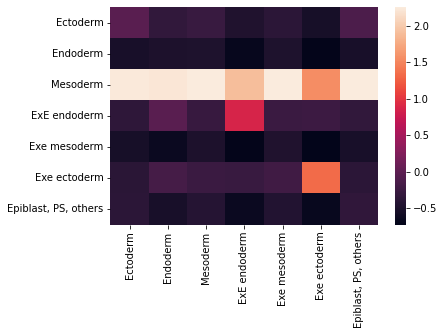

4
genes used


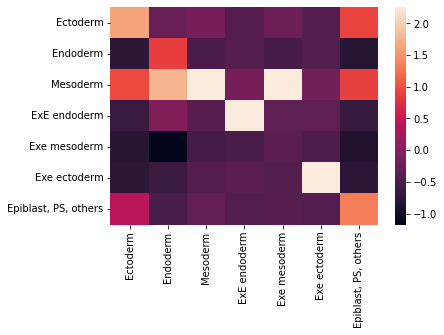

7
genes used


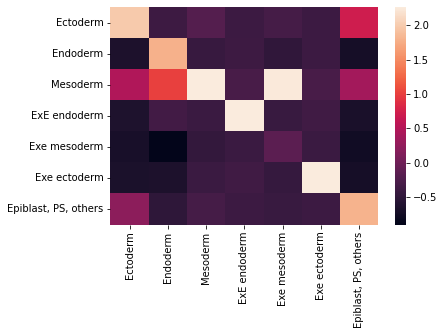

10
genes used


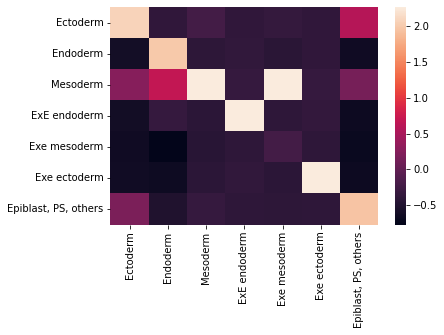

13
genes used


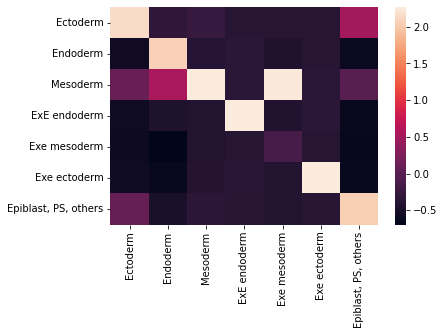

16
genes used


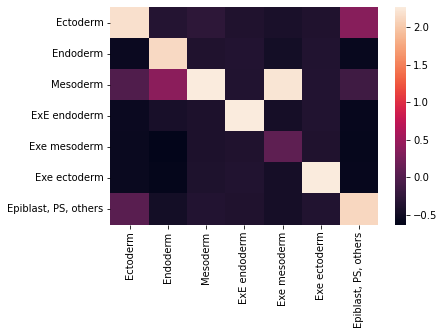

19
genes used


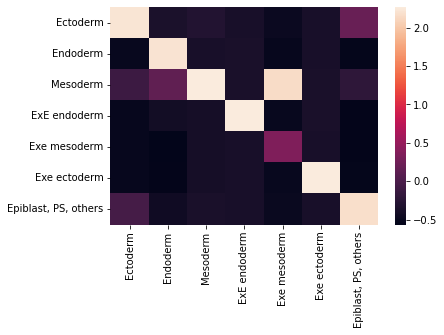

22
genes used


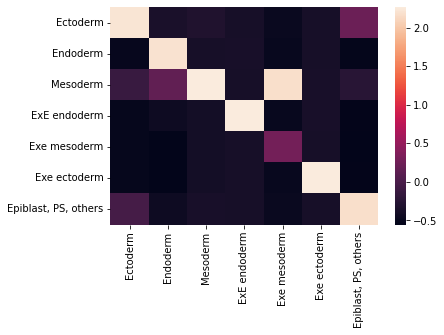

25
genes used


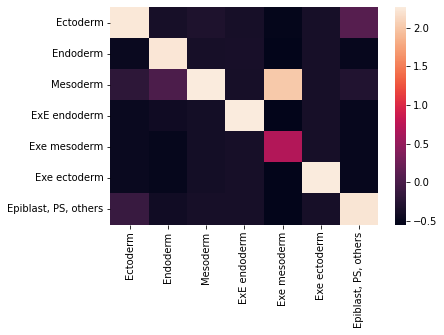

28
genes used


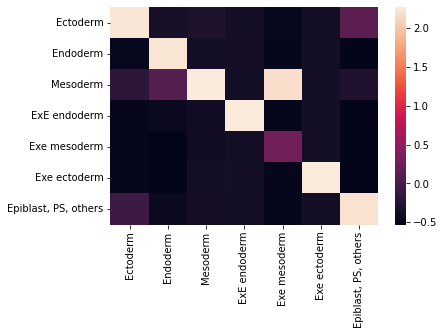

31
genes used


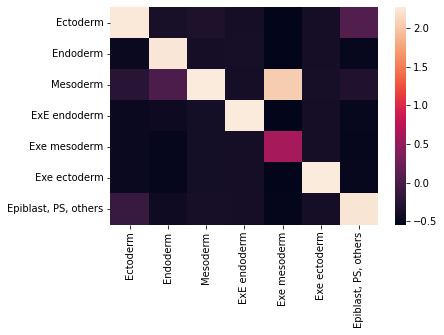

34
genes used


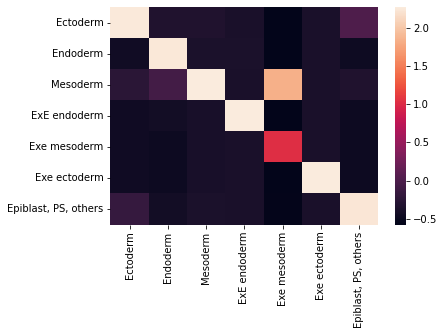

37
genes used


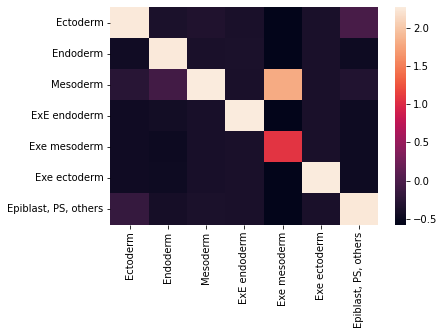

40
genes used


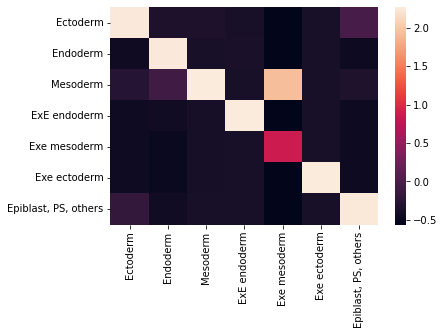

43
genes used


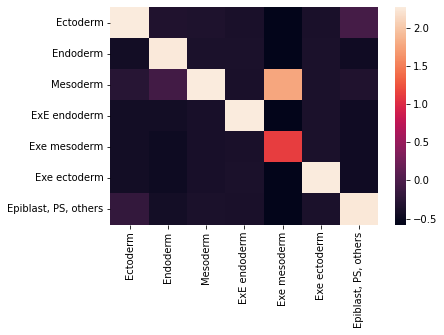

46
genes used


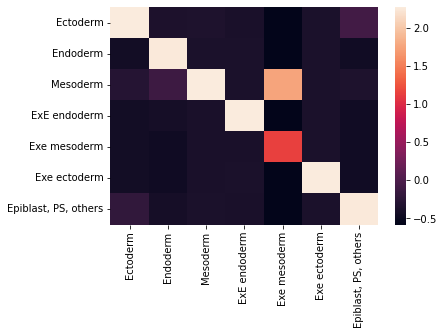

49
genes used


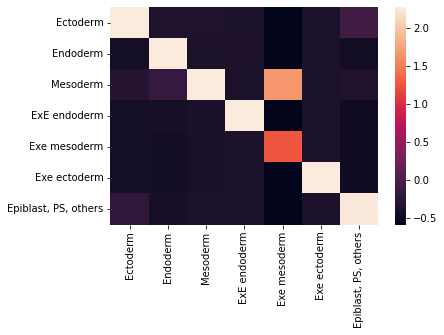

52
genes used


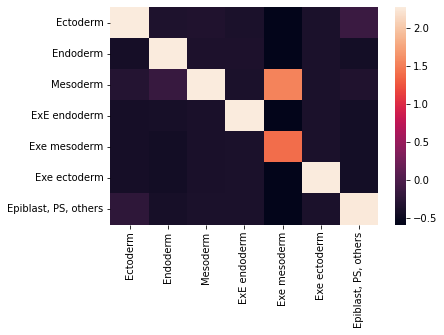

55
genes used


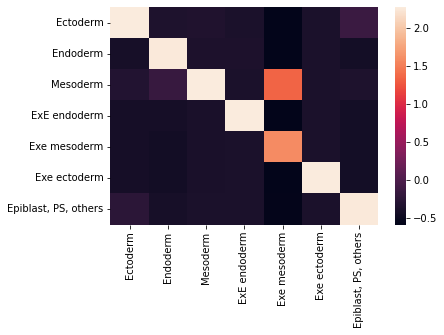

58
genes used


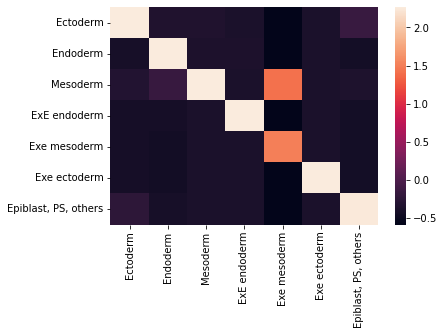

61
genes used


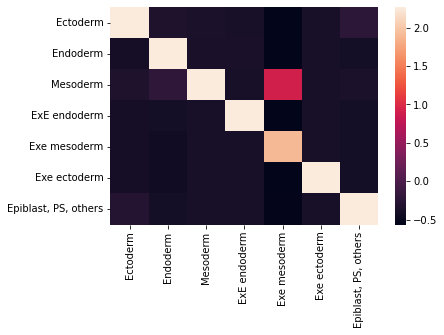

64
genes used


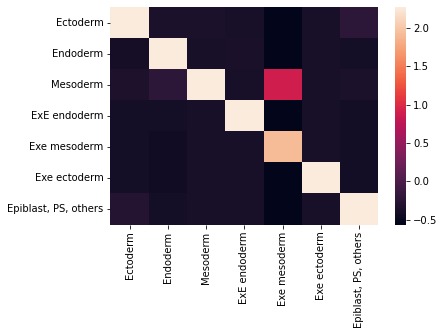

67
genes used


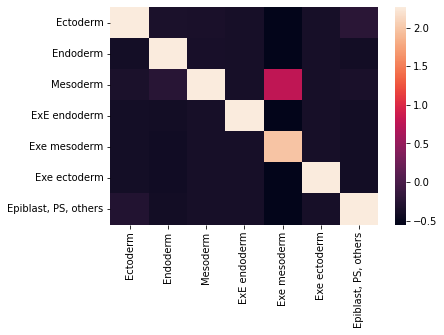

70
genes used


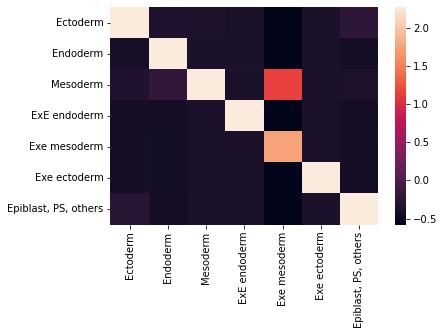

73
genes used


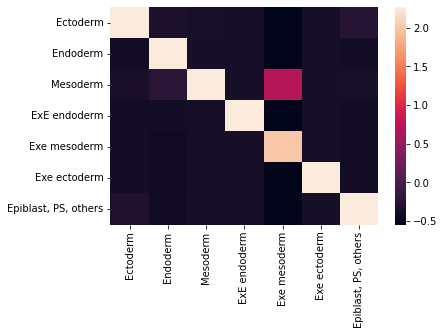

76
genes used


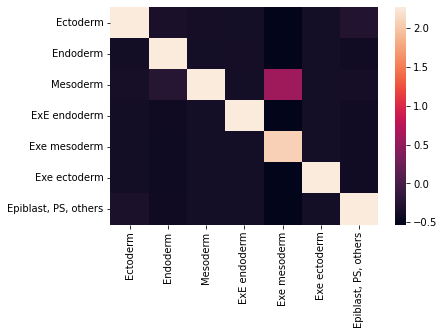

79
genes used


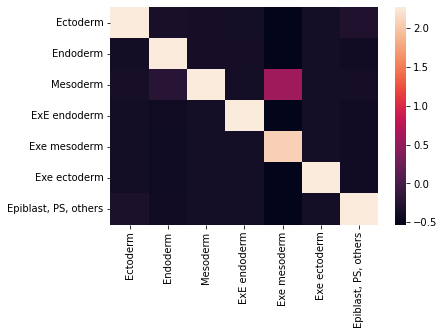

82
genes used


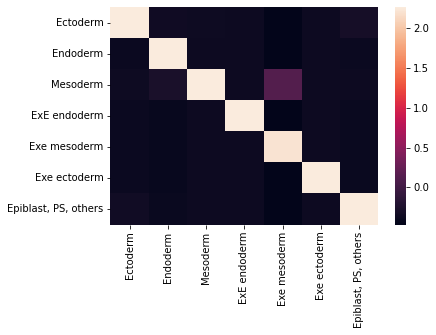

85
genes used


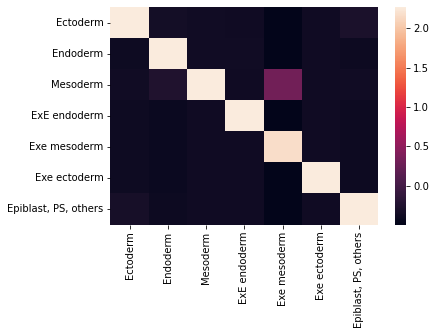

88
genes used


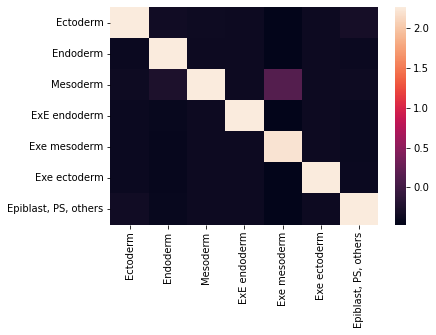

91
genes used


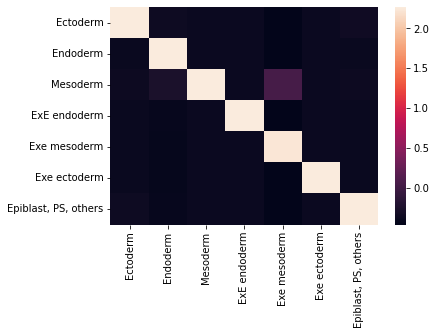

94
genes used


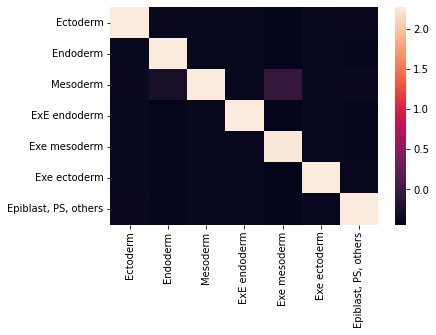

97
genes used


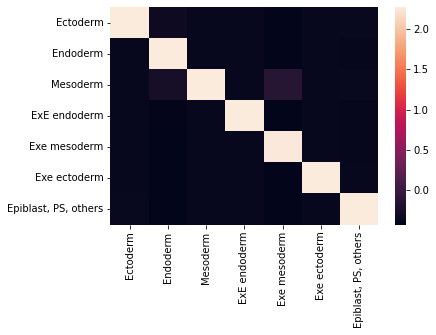

In [74]:
heatmaps(SVM_info[3],SVM_info[4], 592*200)

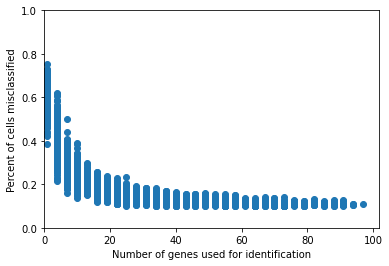

In [64]:
scatter(SVM_genes,SVM_info[0])